### References

https://www.thepythoncode.com/article/stock-price-prediction-in-python-using-tensorflow-2-and-keras

# Train models

Train and save models

### Google Drive Connect

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### GPU Detect

In [2]:
import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


### Import dependencies

In [3]:
!pip install pandas numpy matplotlib yahoo_fin sklearn
from IPython.display import clear_output 
clear_output()

In [4]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout, Bidirectional
from tensorflow.keras.callbacks import ModelCheckpoint, TensorBoard
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from yahoo_fin import stock_info as si
from collections import deque
import tensorflow.keras.metrics
import os
import numpy as np
import pandas as pd
import random
import os
import time
from tensorflow.keras.layers import LSTM
tensorflow.random.set_seed(2)
import matplotlib.pyplot as plt
from keras.models import Sequential, load_model
from keras.layers.core import Dense
from keras.layers.recurrent import LSTM
from keras import optimizers
from keras.callbacks import EarlyStopping
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, r2_score
from math import sqrt
import datetime
import progressbar
import warnings
import concurrent.futures
warnings.filterwarnings("ignore")
plt.style.use('ggplot')
import matplotlib.pyplot as plt
# set seed, so we can get the same results after rerunning several times
np.random.seed(314)
tf.random.set_seed(314)
random.seed(314)

## Prepare Dataset

In [5]:
def shuffle_in_unison(a, b):
    # shuffle two arrays in the same way
    state = np.random.get_state()
    np.random.shuffle(a)
    np.random.set_state(state)
    np.random.shuffle(b)

def load_data(ticker, n_steps=50, scale=True, shuffle=True, lookup_step=1, split_by_date=True,
                test_size=0.2, feature_columns=['adj_close', 'volume', 'open', 'high', 'low'], filename=os.path.join("/content/drive/My Drive/Master Project/Dataset/stock_market_datasets/market_historic/{}.csv".format("PLTR"))):
    """
    Loads data from Yahoo Finance source, as well as scaling, shuffling, normalizing and splitting.
    Params:
        ticker (str/pd.DataFrame): the ticker you want to load, examples include AAPL, TSLA, etc.
        n_steps (int): the historical sequence length (i.e window size) used to predict, default is 50
        scale (bool): whether to scale prices from 0 to 1, default is True
        shuffle (bool): whether to shuffle the dataset (both training & testing), default is True
        lookup_step (int): the future lookup step to predict, default is 1 (e.g next day)
        split_by_date (bool): whether we split the dataset into training/testing by date, setting it 
            to False will split datasets in a random way
        test_size (float): ratio for test data, default is 0.2 (20% testing data)
        feature_columns (list): the list of features to use to feed into the model, default is everything grabbed from yahoo_fin
    """
    # see if ticker is already a loaded stock from yahoo finance
    #if isinstance(ticker, str):
        # load it from yahoo_fin library
        #df = si.get_data(ticker)
        #df=pd.read_csv(filename)
    #elif isinstance(ticker, pd.DataFrame):
        # already loaded, use it directly
        #df = ticker
    #else:
        #raise TypeError("ticker can be either a str or a `pd.DataFrame` instances")
    # this will contain all the elements we want to return from this function
    df=pd.read_csv(filename)
    df['9-day'] = df['adj_close'].rolling(9).mean()
    df['21-day'] = df['adj_close'].rolling(21).mean()
    df['50-day'] = df['adj_close'].rolling(50).mean()
    df['200-day'] = df['adj_close'].rolling(200).mean()
    #feature_columns=df.columns
    result = {}
    # we will also return the original dataframe itself
    result['df'] = df.copy()
    # make sure that the passed feature_columns exist in the dataframe
    for col in feature_columns:
        assert col in df.columns, f"'{col}' does not exist in the dataframe."
    # add date as a column
    #if "date" not in df.columns:
    df["date"] = df.index
    if scale:
        column_scaler = {}
        # scale the data (prices) from 0 to 1
        for column in feature_columns:
            scaler = preprocessing.MinMaxScaler()
            df[column] = scaler.fit_transform(np.expand_dims(df[column].values, axis=1))
            column_scaler[column] = scaler
        # add the MinMaxScaler instances to the result returned
        result["column_scaler"] = column_scaler
    # add the target column (label) by shifting by `lookup_step`
    df['future'] = df['adj_close'].shift(-lookup_step)
    # last `lookup_step` columns contains NaN in future column
    # get them before droping NaNs
    last_sequence = np.array(df[feature_columns].tail(lookup_step))
    # drop NaNs
    df.dropna(inplace=True)
    sequence_data = []
    sequences = deque(maxlen=n_steps)
    for entry, target in zip(df[feature_columns + ["date"]].values, df['future'].values):
        sequences.append(entry)
        if len(sequences) == n_steps:
            sequence_data.append([np.array(sequences), target])
    # get the last sequence by appending the last `n_step` sequence with `lookup_step` sequence
    # for instance, if n_steps=50 and lookup_step=10, last_sequence should be of 60 (that is 50+10) length
    # this last_sequence will be used to predict future stock prices that are not available in the dataset
    last_sequence = list([s[:len(feature_columns)] for s in sequences]) + list(last_sequence)
    last_sequence = np.array(last_sequence).astype(np.float32)
    # add to result
    result['last_sequence'] = last_sequence
    # construct the X's and y's
    X, y = [], []
    for seq, target in sequence_data:
        X.append(seq)
        y.append(target)
    # convert to numpy arrays
    X = np.array(X)
    y = np.array(y)
    if split_by_date:
        # split the dataset into training & testing sets by date (not randomly splitting)
        train_samples = int((1 - test_size) * len(X))
        result["X_train"] = X[:train_samples]
        result["y_train"] = y[:train_samples]
        result["X_test"]  = X[train_samples:]
        result["y_test"]  = y[train_samples:]
        if shuffle:
            # shuffle the datasets for training (if shuffle parameter is set)
            shuffle_in_unison(result["X_train"], result["y_train"])
            shuffle_in_unison(result["X_test"], result["y_test"])
    else:    
        # split the dataset randomly
        result["X_train"], result["X_test"], result["y_train"], result["y_test"] = train_test_split(X, y, 
                                                                                test_size=test_size, shuffle=shuffle)
    # get the list of test set dates
    dates = result["X_test"][:, -1, -1]
    # retrieve test features from the original dataframe
    result["test_df"] = result["df"].loc[dates]
    # remove duplicated dates in the testing dataframe
    result["test_df"] = result["test_df"][~result["test_df"].index.duplicated(keep='first')]
    # remove dates from the training/testing sets & convert to float32
    result["X_train"] = result["X_train"][:, :, :len(feature_columns)].astype(np.float32)
    result["X_test"] = result["X_test"][:, :, :len(feature_columns)].astype(np.float32)
    return result

## Model

In [6]:
def create_model(sequence_length, n_features, units=256, cell=LSTM, n_layers=2, dropout=0.3,
                loss="mean_absolute_error", optimizer="rmsprop", bidirectional=False):
    model = Sequential()
    for i in range(n_layers):
        if i == 0:
            # first layer
            if bidirectional:
                model.add(Bidirectional(cell(units, return_sequences=True), batch_input_shape=(None, sequence_length, n_features)))
            else:
                model.add(cell(units, return_sequences=True, batch_input_shape=(None, sequence_length, n_features)))
        elif i == n_layers - 1:
            # last layer
            if bidirectional:
                model.add(Bidirectional(cell(units, return_sequences=False)))
            else:
                model.add(cell(units, return_sequences=False))
        else:
            # hidden layers
            if bidirectional:
                model.add(Bidirectional(cell(units, return_sequences=True)))
            else:
                model.add(cell(units, return_sequences=True))
        # add dropout after each layer
        model.add(Dropout(dropout))
    model.add(Dense(1, activation="linear"))
    model.compile(loss=loss, metrics=["mean_absolute_error"], optimizer=optimizer)
    return model

### Set Status

In [7]:
def set_status(ticker_number,fname,func_type):
  ticker_number=str(ticker_number)
  with open(f'/content/drive/My Drive/Master Project/Dataset/logs/{fname}_{func_type}_stat.txt', 'w') as writefile:
      writefile.write(ticker_number)
def get_status(fname,func_type):
  ticker_number=0
  try:
    with open(f'/content/drive/My Drive/Master Project/Dataset/logs/{fname}_{func_type}_stat.txt', 'r') as logfile:
      ticker_number=int(logfile.read())
  except:
    pass
  return ticker_number

## Train Model

In [8]:
def plot_graph(test_df,LOOKUP_STEP=1,ticker="EBAY"):
    """
    This function plots true close price along with predicted close price
    with blue and red colors respectively
    """
    plt.figure(figsize=(14,6))
    #plt.autoscale()
    #plt.plot(test_df[f'true_adj_close_{LOOKUP_STEP}'], c='b')
    plt.plot(test_df[f'true_adj_close_{LOOKUP_STEP}_days'], c='b')
    plt.plot(test_df[f'adj_close_{LOOKUP_STEP}_days'], c='r')
    plt.plot(test_df['50-day'], c='g')
    #plt.plot(test_df['200-day'])
    plt.xlabel("Date")
    plt.ylabel("Price")
    plt.legend(["Actual Price","Predicted Price", "50 day MA"])
    plt.title(f"{ticker} predictions chart")
    plt.savefig(f"/content/drive/My Drive/Master Project/Dataset/stock_market_datasets/market_historic_forecast_images/{ticker}.png")
    #plt.legend(["Actual Price","Predicted Price"])
    #plt.legend(["Predicted Price", "50 day MA"])
    #plt.legend(["50 day MA", "200 day MA"]) 
    #plt.show()
def get_final_df(model, data,SCALE=True, LOOKUP_STEP=1):
    """
    This function takes the `model` and `data` dict to 
    construct a final dataframe that includes the features along 
    with true and predicted prices of the testing dataset
    """
    # if predicted future price is higher than the current, 
    # then calculate the true future price minus the current price, to get the buy profit
    buy_profit  = lambda current, true_future, pred_future: true_future - current if pred_future > current else 0
    # if the predicted future price is lower than the current price,
    # then subtract the true future price from the current price
    sell_profit = lambda current, true_future, pred_future: current - true_future if pred_future < current else 0
    X_test = data["X_test"]
    y_test = data["y_test"]
    # perform prediction and get prices
    y_pred = model.predict(X_test)
    if SCALE:
        y_test = np.squeeze(data["column_scaler"]["adj_close"].inverse_transform(np.expand_dims(y_test, axis=0)))
        y_pred = np.squeeze(data["column_scaler"]["adj_close"].inverse_transform(y_pred))
    test_df = data["test_df"]
    # add predicted future prices to the dataframe
    test_df[f"adj_close_{LOOKUP_STEP}_days"] = y_pred
    # add true future prices to the dataframe
    test_df[f"true_adj_close_{LOOKUP_STEP}_days"] = y_test
    # add percent change
    test_df["percent_change"]=((test_df[f"adj_close_{LOOKUP_STEP}_days"]-test_df["close"])/test_df["close"])*100
    # sort the dataframe by date
    test_df.sort_index(inplace=True)
    final_df = test_df
    # add the buy profit column
    final_df["buy_profit"] = list(map(buy_profit, 
                                    final_df["adj_close"], 
                                    final_df[f"adj_close_{LOOKUP_STEP}_days"], 
                                    final_df[f"true_adj_close_{LOOKUP_STEP}_days"])
                                    # since we don't have profit for last sequence, add 0's
                                    )
    # add the sell profit column
    final_df["sell_profit"] = list(map(sell_profit, 
                                    final_df["adj_close"], 
                                    final_df[f"adj_close_{LOOKUP_STEP}_days"], 
                                    final_df[f"true_adj_close_{LOOKUP_STEP}_days"])
                                    # since we don't have profit for last sequence, add 0's
                                    )
    return final_df
def predict(model, data,SCALE=True,N_STEPS=5):
    # retrieve the last sequence from data
    last_sequence = data["last_sequence"][-N_STEPS:]
    # expand dimension
    last_sequence = np.expand_dims(last_sequence, axis=0)
    # get the prediction (scaled from 0 to 1)
    prediction = model.predict(last_sequence)
    # get the price (by inverting the scaling)
    if SCALE:
        predicted_price = data["column_scaler"]["adj_close"].inverse_transform(prediction)[0][0]
    else:
        predicted_price = prediction[0][0]
    return predicted_price

In [9]:
def train_model(ticker_symbol="EBAY",LOOKUP_STEP=1):
  # Stock Name
  ticker = ticker_symbol
  # Window size or the sequence length
  N_STEPS = 5*LOOKUP_STEP
  # Lookup step, 1 is the next day
  #LOOKUP_STEP = 1
  # whether to scale feature columns & output price as well
  SCALE = True
  scale_str = f"sc-{int(SCALE)}"
  # whether to shuffle the dataset
  SHUFFLE = True
  shuffle_str = f"sh-{int(SHUFFLE)}"
  # whether to split the training/testing set by date
  SPLIT_BY_DATE = True
  split_by_date_str = f"sbd-{int(SPLIT_BY_DATE)}"
  # test ratio size, 0.2 is 20%
  TEST_SIZE = 0.3
  # features to use
  FEATURE_COLUMNS = ["open","high","low","volume","adj_close"]
  # date now
  date_now = time.strftime("%Y-%m-%d")
  ### model parameters
  N_LAYERS = 2
  # LSTM cell
  CELL = LSTM
  # 256 LSTM neurons
  UNITS = 256
  # 40% dropout
  DROPOUT = 0.4
  # whether to use bidirectional RNNs
  BIDIRECTIONAL = True
  ### training parameters
  # mean absolute error loss
  #LOSS = "mae" #importance to outlier
  #LOSS = "mse" #ignored outliers
  LOSS = "huber_loss" #balanced
  #LOSS = "mse"
  OPTIMIZER = "adam"
  BATCH_SIZE = 250
  EPOCHS = 100
  #ticker_data_filename = os.path.join("/content/drive/My Drive/Master Project/Dataset/data", f"{ticker}_{date_now}.csv")
  ticker_data_filename = os.path.join("/content/drive/My Drive/Master Project/Dataset/stock_market_datasets/market_historic/{}.csv".format(ticker))
  # model name to save, making it as unique as possible based on parameters
  model_name = ticker
  #model_name = f"{date_now}_{ticker}-{shuffle_str}-{scale_str}-{split_by_date_str}-\
  #{LOSS}-{OPTIMIZER}-{CELL.__name__}-seq-{N_STEPS}-step-{LOOKUP_STEP}-layers-{N_LAYERS}-units-{UNITS}"
  #if BIDIRECTIONAL:
      #model_name += "_b"
  %load_ext tensorboard
  # Setting up an early stop
  earlystop = EarlyStopping(monitor='val_loss', min_delta=0.00001, patience=10,  verbose=1, mode='min', restore_best_weights=True)
  # load the data
  data = load_data(ticker, N_STEPS, scale=SCALE, split_by_date=SPLIT_BY_DATE, 
                  shuffle=SHUFFLE, lookup_step=LOOKUP_STEP, test_size=TEST_SIZE, 
                  feature_columns=FEATURE_COLUMNS,filename=ticker_data_filename)
  # save the dataframe
  #data["df"].to_csv(ticker_data_filename)
  # construct the model
  model = create_model(N_STEPS, len(FEATURE_COLUMNS), loss=LOSS, units=UNITS, cell=CELL, n_layers=N_LAYERS,
                      dropout=DROPOUT, optimizer=OPTIMIZER, bidirectional=BIDIRECTIONAL)
  # some tensorflow callbacks
  %reload_ext tensorboard
  !rm -rf ./logs/
  log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
  #tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)
  checkpointer = ModelCheckpoint(os.path.join("/content/drive/My Drive/Master Project/Dataset/models/historic", model_name + ".h5"), save_weights_only=True, save_best_only=True, verbose=1)
  tensorboard = TensorBoard(log_dir=os.path.join("/content/drive/My Drive/Master Project/Dataset/logs/Tensorboard", model_name),histogram_freq=1)
  # train the model and save the weights whenever we see 
  # a new optimal model using ModelCheckpoint
  history = model.fit(data["X_train"], data["y_train"],
                      batch_size=BATCH_SIZE,
                      epochs=EPOCHS,
                      validation_data=(data["X_test"], data["y_test"]),
                      callbacks=[tensorboard,checkpointer,earlystop],
                      verbose=1)
  #%tensorboard --logdir logs/fit
  # load optimal model weights from results folder
  model_path = os.path.join("/content/drive/My Drive/Master Project/Dataset/models/historic", model_name) + ".h5"
  model.load_weights(model_path)
  # evaluate the model
  loss, mae = model.evaluate(data["X_test"], data["y_test"], verbose=0)
  # calculate the mean absolute error (inverse scaling)
  if SCALE:
      mean_absolute_error = data["column_scaler"]["adj_close"].inverse_transform([[mae]])[0][0]
  else:
      mean_absolute_error = mae
  # get the final dataframe for the testing set
  final_df = get_final_df(model, data, LOOKUP_STEP)
  # predict the future price
  future_price = predict(model, data, N_STEPS)
  # previous close calculation
  previous_close=data['df']['close'][data['df'].last_valid_index()]
  previous_close_date=data['df']['date'][data['df'].last_valid_index()]
  previous_close_date=datetime.date.fromisoformat(previous_close_date)
  # calculate next business day by excluding holidays
  next_business_day = previous_close_date + datetime.timedelta(days=1)
  while next_business_day.isoweekday()>=6:
    next_business_day += datetime.timedelta(days=1)
  # we calculate the accuracy by counting the number of positive profits
  accuracy_score = (len(final_df[final_df['sell_profit'] > 0]) + len(final_df[final_df['buy_profit'] > 0])) / len(final_df)
  # calculating total buy & sell profit
  total_buy_profit  = final_df["buy_profit"].sum()
  total_sell_profit = final_df["sell_profit"].sum()
  # total profit by adding sell & buy together
  total_profit = total_buy_profit + total_sell_profit
  # dividing total profit by number of testing samples (number of trades)
  profit_per_trade = total_profit / len(final_df)
  # percentage return
  percent_return=((future_price-previous_close)/previous_close)*100

  # printing metrics
  print(f"Future price after {LOOKUP_STEP} day on {next_business_day} is ${future_price:.4f}")
  print(f"Previous close on {previous_close_date} is ${previous_close}")
  print(f"Percentage returns after {LOOKUP_STEP} business day is {percent_return:.2f}%")
  print(f"{LOSS} loss:", loss)
  print("Mean Absolute Error:", mean_absolute_error)
  print("Accuracy score:", accuracy_score)
  print("Total buy profit:", total_buy_profit)
  print("Total sell profit:", total_sell_profit)
  print("Total profit:", total_profit)
  print("Profit per trade:", profit_per_trade)
  #print("accuracy:",acc)

  # add last prediction data to dataframe
  pred_data={'prediction':[future_price],'next_date':[next_business_day],'percent_return':[percent_return]}
  predictions = pd.DataFrame(pred_data)
  predictions_results_folder = "/content/drive/My Drive/Master Project/Dataset/stock_market_datasets/predictions"
  pred_csv_filename = os.path.join(predictions_results_folder, ticker + ".csv")
  predictions.to_csv(pred_csv_filename)
  org_data=data['df'].loc[len(data['df'].index)-1].values
  org_data=org_data.tolist()
  org_data.extend([future_price,None,percent_return,None,None])
  final_df.loc[len(final_df.index)]=org_data

  # save the final dataframe to csv-results folder
  final_df['date']=pd.to_datetime(final_df['date'])
  final_df=final_df.set_index(final_df['date'])
  final_df=final_df.drop(columns='date')
  csv_results_folder = "/content/drive/My Drive/Master Project/Dataset/stock_market_datasets/market_historic_forecast"
  if not os.path.isdir(csv_results_folder):
      os.mkdir(csv_results_folder)
  csv_filename = os.path.join(csv_results_folder, ticker + ".csv")
  final_df.to_csv(csv_filename)
  print(final_df)

  # plot true/pred prices graph
  plot_graph(final_df, LOOKUP_STEP, ticker)

In [10]:
def train_model_master(letter="sp500"):
  symbols=pd.read_csv('/content/drive/My Drive/Master Project/Dataset/stocks_ticker_list_latest/symbols.csv')
  if letter == "all":
    symbols=pd.read_csv('/content/drive/My Drive/Master Project/Dataset/stocks_ticker_list_latest/symbols.csv')
  elif letter == "sp500":
    symbols=pd.read_csv('/content/drive/My Drive/Master Project/Dataset/stocks_ticker_list_latest/S&P500.csv')
  elif letter == "my_list":
    symbols=pd.read_csv('/content/drive/My Drive/Master Project/Dataset/stocks_ticker_list_latest/my_list.csv')
  else:
    symbols=symbols[[x.startswith(letter) for x in symbols['Symbol']]]

  list_type="train_model"
  bar = progressbar.ProgressBar(
      widgets=[
          progressbar.Counter(format='Training Model | %(value)5d/%(max_value)d | %(dynamic_messages)6s | '),
          progressbar.Timer(format= 'Elapsed: %(elapsed)s '),
          progressbar.Bar('*'),
          ' ',
          progressbar.AdaptiveETA(),
      ],
  )
  log_start=get_status(letter,list_type)
  shift=0

  for symbol in bar(symbols['Symbol'][log_start:]):
    try:
      bar.dynamic_messages=symbol
      train_model(symbol)
      time.sleep(1)
      shift+=1
      val=(log_start+shift)%symbols.last_valid_index()
      set_status(val,letter,list_type)
    except:
      pass

  set_status(0,letter,list_type)
  #clear_output()

### Check Tensorboard

In [11]:
%load_ext tensorboard
%tensorboard --logdir content/drive/My Drive/Master Project/Dataset/logs/Tensorboard/AAPL/logs/fit

ERROR: Failed to launch TensorBoard (exited with 2).
Contents of stderr:
2021-05-06 01:00:44.663206: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
usage: tensorboard [-h] [--helpfull] [--logdir PATH] [--logdir_spec PATH_SPEC]
                   [--host ADDR] [--bind_all] [--port PORT]
                   [--purge_orphaned_data BOOL] [--db URI] [--db_import]
                   [--inspect] [--version_tb] [--tag TAG] [--event_file PATH]
                   [--path_prefix PATH] [--window_title TEXT]
                   [--max_reload_threads COUNT] [--reload_interval SECONDS]
                   [--reload_task TYPE] [--reload_multifile BOOL]
                   [--reload_multifile_inactive_secs SECONDS]
                   [--generic_data TYPE]
                   [--samples_per_plugin SAMPLES_PER_PLUGIN]
                   [--whatif-use-unsafe-custom-prediction YOUR_CUSTOM_PREDICT_FUNCTION.py]
                   [--whatif-dat

### Train

Training Model |     0/386 |     {} | Elapsed: 0:00:00 |       | ETA:  --:--:--

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 10s 105ms/step - loss: 0.0060 - mean_absolute_error: 0.0690 - val_loss: 0.0077 - val_mean_absolute_error: 0.1049

Epoch 00001: val_loss improved from inf to 0.00769, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/CMA.h5
Epoch 2/100
29/29 [==============================] - 0s 16ms/step - loss: 3.9011e-04 - mean_absolute_error: 0.0201 - val_loss: 0.0044 - val_mean_absolute_error: 0.0749

Epoch 00002: val_loss improved from 0.00769 to 0.00440, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/CMA.h5
Epoch 3/100
29/29 [==============================] - 0s 13ms/step - loss: 2.3081e-04 - mean_absolute_error: 0.0148 - val_loss: 0.0021 - val_mean_absolute_error: 0.0507

Epoch 00003: val_loss improved from 0.00440 to 0.00205, saving model to /content/drive/My Drive/Master Project/Dataset/models

Training Model |     1/386 |    CMA | Elapsed: 0:00:24 |       | ETA:   2:36:26

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 122ms/step - loss: 0.0042 - mean_absolute_error: 0.0625 - val_loss: 0.0117 - val_mean_absolute_error: 0.1305

Epoch 00001: val_loss improved from inf to 0.01168, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/CAG.h5
Epoch 2/100
29/29 [==============================] - 0s 16ms/step - loss: 3.1196e-04 - mean_absolute_error: 0.0190 - val_loss: 0.0095 - val_mean_absolute_error: 0.1166

Epoch 00002: val_loss improved from 0.01168 to 0.00945, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/CAG.h5
Epoch 3/100
29/29 [==============================] - 0s 13ms/step - loss: 1.4547e-04 - mean_absolute_error: 0.0124 - val_loss: 0.0040 - val_mean_absolute_error: 0.0751

Epoch 00003: val_loss improved from 0.00945 to 0.00404, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |     2/386 |    CAG | Elapsed: 0:00:52 |       | ETA:   3:01:57

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
28/28 [==============================] - 8s 119ms/step - loss: 0.0034 - mean_absolute_error: 0.0499 - val_loss: 0.0079 - val_mean_absolute_error: 0.1097

Epoch 00001: val_loss improved from inf to 0.00787, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/COP.h5
Epoch 2/100
28/28 [==============================] - 0s 17ms/step - loss: 1.6183e-04 - mean_absolute_error: 0.0117 - val_loss: 0.0105 - val_mean_absolute_error: 0.1308

Epoch 00002: val_loss did not improve from 0.00787
Epoch 3/100
28/28 [==============================] - 0s 13ms/step - loss: 1.2181e-04 - mean_absolute_error: 0.0096 - val_loss: 0.0111 - val_mean_absolute_error: 0.1355

Epoch 00003: val_loss did not improve from 0.00787
Epoch 4/100
28/28 [==============================] - 0s 13ms/step - loss: 1.0718e-04 - mean_absolute_error: 0.0092 - val_loss: 0.0088 - val_mean_absolute_error: 0.119

Training Model |     3/386 |    COP | Elapsed: 0:01:24 |       | ETA:   3:19:23

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
42/42 [==============================] - 8s 84ms/step - loss: 7.5480e-04 - mean_absolute_error: 0.0255 - val_loss: 0.0198 - val_mean_absolute_error: 0.1713

Epoch 00001: val_loss improved from inf to 0.01981, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ED.h5
Epoch 2/100
42/42 [==============================] - 1s 14ms/step - loss: 6.2852e-05 - mean_absolute_error: 0.0079 - val_loss: 6.2758e-05 - val_mean_absolute_error: 0.0071

Epoch 00002: val_loss improved from 0.01981 to 0.00006, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ED.h5
Epoch 3/100
42/42 [==============================] - 1s 13ms/step - loss: 1.6989e-05 - mean_absolute_error: 0.0037 - val_loss: 5.6075e-05 - val_mean_absolute_error: 0.0065

Epoch 00003: val_loss improved from 0.00006 to 0.00006, saving model to /content/drive/My Drive/Master Project/Datase

Training Model |     4/386 |     ED | Elapsed: 0:01:51 |       | ETA:   2:52:35

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
20/20 [==============================] - 8s 172ms/step - loss: 4.0792e-04 - mean_absolute_error: 0.0215 - val_loss: 0.0012 - val_mean_absolute_error: 0.0414

Epoch 00001: val_loss improved from inf to 0.00125, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/STZ.h5
Epoch 2/100
20/20 [==============================] - 0s 20ms/step - loss: 2.4735e-05 - mean_absolute_error: 0.0057 - val_loss: 6.1526e-04 - val_mean_absolute_error: 0.0252

Epoch 00002: val_loss improved from 0.00125 to 0.00062, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/STZ.h5
Epoch 3/100
20/20 [==============================] - 0s 15ms/step - loss: 9.2496e-06 - mean_absolute_error: 0.0031 - val_loss: 8.6019e-04 - val_mean_absolute_error: 0.0314

Epoch 00003: val_loss did not improve from 0.00062
Epoch 4/100
20/20 [==============================] - 0s 14ms/st

Training Model |     5/386 |    STZ | Elapsed: 0:02:22 |       | ETA:   3:17:46

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
27/27 [==============================] - 8s 121ms/step - loss: 6.9258e-04 - mean_absolute_error: 0.0265 - val_loss: 2.4155e-04 - val_mean_absolute_error: 0.0155

Epoch 00001: val_loss improved from inf to 0.00024, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/COO.h5
Epoch 2/100
27/27 [==============================] - 0s 18ms/step - loss: 2.9528e-05 - mean_absolute_error: 0.0060 - val_loss: 1.9759e-04 - val_mean_absolute_error: 0.0146

Epoch 00002: val_loss improved from 0.00024 to 0.00020, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/COO.h5
Epoch 3/100
27/27 [==============================] - 0s 13ms/step - loss: 1.3290e-05 - mean_absolute_error: 0.0036 - val_loss: 1.4039e-04 - val_mean_absolute_error: 0.0118

Epoch 00003: val_loss improved from 0.00020 to 0.00014, saving model to /content/drive/My Drive/Master Project

Training Model |     6/386 |    COO | Elapsed: 0:02:52 |       | ETA:   3:13:47

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
19/19 [==============================] - 8s 166ms/step - loss: 3.8511e-04 - mean_absolute_error: 0.0211 - val_loss: 8.8114e-04 - val_mean_absolute_error: 0.0341

Epoch 00001: val_loss improved from inf to 0.00088, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/CPRT.h5
Epoch 2/100
19/19 [==============================] - 0s 20ms/step - loss: 2.8554e-05 - mean_absolute_error: 0.0063 - val_loss: 1.3125e-04 - val_mean_absolute_error: 0.0118

Epoch 00002: val_loss improved from 0.00088 to 0.00013, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/CPRT.h5
Epoch 3/100
19/19 [==============================] - 0s 16ms/step - loss: 9.9695e-06 - mean_absolute_error: 0.0033 - val_loss: 3.5444e-04 - val_mean_absolute_error: 0.0185

Epoch 00003: val_loss did not improve from 0.00013
Epoch 4/100
19/19 [==============================] - 0s 1

Training Model |     7/386 |   CPRT | Elapsed: 0:03:18 |       | ETA:   2:38:44

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
28/28 [==============================] - 8s 136ms/step - loss: 0.0028 - mean_absolute_error: 0.0435 - val_loss: 5.5954e-04 - val_mean_absolute_error: 0.0245

Epoch 00001: val_loss improved from inf to 0.00056, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GLW.h5
Epoch 2/100
28/28 [==============================] - 0s 17ms/step - loss: 1.5325e-04 - mean_absolute_error: 0.0110 - val_loss: 6.4514e-04 - val_mean_absolute_error: 0.0279

Epoch 00002: val_loss did not improve from 0.00056
Epoch 3/100
28/28 [==============================] - 0s 13ms/step - loss: 1.3586e-04 - mean_absolute_error: 0.0093 - val_loss: 6.8042e-04 - val_mean_absolute_error: 0.0288

Epoch 00003: val_loss did not improve from 0.00056
Epoch 4/100
28/28 [==============================] - 0s 14ms/step - loss: 1.2916e-04 - mean_absolute_error: 0.0092 - val_loss: 5.2007e-04 - val_mean_absol

Training Model |     8/386 |    GLW | Elapsed: 0:03:47 |       | ETA:   3:04:04

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
1/1 [==============================] - 7s 7s/step - loss: 0.0552 - mean_absolute_error: 0.2918 - val_loss: 0.0497 - val_mean_absolute_error: 0.3109

Epoch 00001: val_loss improved from inf to 0.04966, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/CTVA.h5
Epoch 2/100
1/1 [==============================] - 1s 1s/step - loss: 0.0077 - mean_absolute_error: 0.1019 - val_loss: 0.0193 - val_mean_absolute_error: 0.1901

Epoch 00002: val_loss improved from 0.04966 to 0.01930, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/CTVA.h5
Epoch 3/100
1/1 [==============================] - 0s 76ms/step - loss: 0.0060 - mean_absolute_error: 0.0963 - val_loss: 0.0649 - val_mean_absolute_error: 0.3550

Epoch 00003: val_loss did not improve from 0.01930
Epoch 4/100
1/1 [==============================] - 0s 71ms/step - loss: 0.0154 - mean_absolu

Training Model |     9/386 |   CTVA | Elapsed: 0:04:08 |       | ETA:   2:12:44

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
25/25 [==============================] - 8s 123ms/step - loss: 5.9825e-04 - mean_absolute_error: 0.0250 - val_loss: 0.0083 - val_mean_absolute_error: 0.1037

Epoch 00001: val_loss improved from inf to 0.00834, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/COST.h5
Epoch 2/100
25/25 [==============================] - 0s 18ms/step - loss: 2.0685e-05 - mean_absolute_error: 0.0050 - val_loss: 0.0050 - val_mean_absolute_error: 0.0777

Epoch 00002: val_loss improved from 0.00834 to 0.00499, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/COST.h5
Epoch 3/100
25/25 [==============================] - 0s 14ms/step - loss: 1.1489e-05 - mean_absolute_error: 0.0033 - val_loss: 0.0044 - val_mean_absolute_error: 0.0724

Epoch 00003: val_loss improved from 0.00499 to 0.00443, saving model to /content/drive/My Drive/Master Project/Dataset/m

Training Model |    10/386 |   COST | Elapsed: 0:04:43 |       | ETA:   3:42:00

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
16/16 [==============================] - 8s 204ms/step - loss: 0.0040 - mean_absolute_error: 0.0636 - val_loss: 9.2404e-04 - val_mean_absolute_error: 0.0340

Epoch 00001: val_loss improved from inf to 0.00092, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/CCI.h5
Epoch 2/100
16/16 [==============================] - 0s 19ms/step - loss: 2.9030e-04 - mean_absolute_error: 0.0196 - val_loss: 0.0017 - val_mean_absolute_error: 0.0420

Epoch 00002: val_loss did not improve from 0.00092
Epoch 3/100
16/16 [==============================] - 0s 18ms/step - loss: 9.8680e-05 - mean_absolute_error: 0.0103 - val_loss: 0.0031 - val_mean_absolute_error: 0.0604

Epoch 00003: val_loss did not improve from 0.00092
Epoch 4/100
16/16 [==============================] - 0s 16ms/step - loss: 5.7411e-05 - mean_absolute_error: 0.0075 - val_loss: 0.0039 - val_mean_absolute_error: 0

Training Model |    11/386 |    CCI | Elapsed: 0:05:03 |       | ETA:   2:00:00

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 155ms/step - loss: 2.7526e-04 - mean_absolute_error: 0.0165 - val_loss: 0.0067 - val_mean_absolute_error: 0.0916

Epoch 00001: val_loss improved from inf to 0.00675, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/CSX.h5
Epoch 2/100
29/29 [==============================] - 0s 16ms/step - loss: 1.5794e-05 - mean_absolute_error: 0.0039 - val_loss: 0.0042 - val_mean_absolute_error: 0.0695

Epoch 00002: val_loss improved from 0.00675 to 0.00423, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/CSX.h5
Epoch 3/100
29/29 [==============================] - 0s 13ms/step - loss: 8.0408e-06 - mean_absolute_error: 0.0029 - val_loss: 0.0036 - val_mean_absolute_error: 0.0648

Epoch 00003: val_loss improved from 0.00423 to 0.00361, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |    12/386 |    CSX | Elapsed: 0:05:42 |       | ETA:   4:05:42

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 96ms/step - loss: 9.1108e-05 - mean_absolute_error: 0.0099 - val_loss: 0.0068 - val_mean_absolute_error: 0.0923

Epoch 00001: val_loss improved from inf to 0.00677, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/CMI.h5
Epoch 2/100
34/34 [==============================] - 1s 16ms/step - loss: 4.4830e-06 - mean_absolute_error: 0.0023 - val_loss: 0.0045 - val_mean_absolute_error: 0.0723

Epoch 00002: val_loss improved from 0.00677 to 0.00447, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/CMI.h5
Epoch 3/100
34/34 [==============================] - 0s 13ms/step - loss: 2.9381e-06 - mean_absolute_error: 0.0018 - val_loss: 0.0042 - val_mean_absolute_error: 0.0706

Epoch 00003: val_loss improved from 0.00447 to 0.00418, saving model to /content/drive/My Drive/Master Project/Dataset/mode

Training Model |    13/386 |    CMI | Elapsed: 0:06:20 |       | ETA:   3:58:01

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 96ms/step - loss: 8.9401e-04 - mean_absolute_error: 0.0286 - val_loss: 0.0039 - val_mean_absolute_error: 0.0746

Epoch 00001: val_loss improved from inf to 0.00388, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/CVS.h5
Epoch 2/100
34/34 [==============================] - 1s 16ms/step - loss: 5.5151e-05 - mean_absolute_error: 0.0082 - val_loss: 0.0014 - val_mean_absolute_error: 0.0415

Epoch 00002: val_loss improved from 0.00388 to 0.00141, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/CVS.h5
Epoch 3/100
34/34 [==============================] - 0s 13ms/step - loss: 3.2971e-05 - mean_absolute_error: 0.0061 - val_loss: 8.9923e-04 - val_mean_absolute_error: 0.0333

Epoch 00003: val_loss improved from 0.00141 to 0.00090, saving model to /content/drive/My Drive/Master Project/Dataset/

Training Model |    14/386 |    CVS | Elapsed: 0:06:46 |       | ETA:   2:41:50

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
20/20 [==============================] - 8s 192ms/step - loss: 0.0018 - mean_absolute_error: 0.0426 - val_loss: 0.0043 - val_mean_absolute_error: 0.0774

Epoch 00001: val_loss improved from inf to 0.00428, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DHI.h5
Epoch 2/100
20/20 [==============================] - 0s 19ms/step - loss: 1.2573e-04 - mean_absolute_error: 0.0109 - val_loss: 0.0027 - val_mean_absolute_error: 0.0613

Epoch 00002: val_loss improved from 0.00428 to 0.00265, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DHI.h5
Epoch 3/100
20/20 [==============================] - 0s 15ms/step - loss: 5.4690e-05 - mean_absolute_error: 0.0070 - val_loss: 0.0015 - val_mean_absolute_error: 0.0439

Epoch 00003: val_loss improved from 0.00265 to 0.00154, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |    15/386 |    DHI | Elapsed: 0:07:32 |       | ETA:   4:42:10

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
30/30 [==============================] - 8s 104ms/step - loss: 1.4950e-04 - mean_absolute_error: 0.0120 - val_loss: 0.0050 - val_mean_absolute_error: 0.0584

Epoch 00001: val_loss improved from inf to 0.00495, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DHR.h5
Epoch 2/100
30/30 [==============================] - 0s 16ms/step - loss: 4.3153e-06 - mean_absolute_error: 0.0021 - val_loss: 0.0047 - val_mean_absolute_error: 0.0568

Epoch 00002: val_loss improved from 0.00495 to 0.00472, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DHR.h5
Epoch 3/100
30/30 [==============================] - 0s 13ms/step - loss: 1.9814e-06 - mean_absolute_error: 0.0012 - val_loss: 0.0055 - val_mean_absolute_error: 0.0616

Epoch 00003: val_loss did not improve from 0.00472
Epoch 4/100
30/30 [==============================] - 0s 13ms/step - los

Training Model |    16/386 |    DHR | Elapsed: 0:07:54 |       | ETA:   2:15:17

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
18/18 [==============================] - 8s 172ms/step - loss: 0.0020 - mean_absolute_error: 0.0459 - val_loss: 0.0059 - val_mean_absolute_error: 0.0939

Epoch 00001: val_loss improved from inf to 0.00591, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DRI.h5
Epoch 2/100
18/18 [==============================] - 0s 19ms/step - loss: 1.2475e-04 - mean_absolute_error: 0.0120 - val_loss: 0.0087 - val_mean_absolute_error: 0.1165

Epoch 00002: val_loss did not improve from 0.00591
Epoch 3/100
18/18 [==============================] - 0s 16ms/step - loss: 7.7933e-05 - mean_absolute_error: 0.0089 - val_loss: 0.0060 - val_mean_absolute_error: 0.0950

Epoch 00003: val_loss did not improve from 0.00591
Epoch 4/100
18/18 [==============================] - 0s 15ms/step - loss: 5.2388e-05 - mean_absolute_error: 0.0073 - val_loss: 0.0048 - val_mean_absolute_error: 0.084

Training Model |    17/386 |    DRI | Elapsed: 0:08:25 |       | ETA:   3:12:13

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
18/18 [==============================] - 8s 189ms/step - loss: 0.0051 - mean_absolute_error: 0.0700 - val_loss: 2.3733e-04 - val_mean_absolute_error: 0.0176

Epoch 00001: val_loss improved from inf to 0.00024, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DVA.h5
Epoch 2/100
18/18 [==============================] - 0s 18ms/step - loss: 2.6919e-04 - mean_absolute_error: 0.0165 - val_loss: 6.5639e-04 - val_mean_absolute_error: 0.0320

Epoch 00002: val_loss did not improve from 0.00024
Epoch 3/100
18/18 [==============================] - 0s 17ms/step - loss: 1.3560e-04 - mean_absolute_error: 0.0116 - val_loss: 3.7510e-04 - val_mean_absolute_error: 0.0227

Epoch 00003: val_loss did not improve from 0.00024
Epoch 4/100
18/18 [==============================] - 0s 15ms/step - loss: 9.6244e-05 - mean_absolute_error: 0.0089 - val_loss: 1.4995e-04 - val_mean_absol

Training Model |    18/386 |    DVA | Elapsed: 0:08:49 |       | ETA:   2:23:27

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 9s 111ms/step - loss: 1.1585e-04 - mean_absolute_error: 0.0105 - val_loss: 0.0018 - val_mean_absolute_error: 0.0419

Epoch 00001: val_loss improved from inf to 0.00178, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DE.h5
Epoch 2/100
34/34 [==============================] - 1s 16ms/step - loss: 4.3278e-06 - mean_absolute_error: 0.0022 - val_loss: 0.0015 - val_mean_absolute_error: 0.0367

Epoch 00002: val_loss improved from 0.00178 to 0.00151, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DE.h5
Epoch 3/100
34/34 [==============================] - 0s 13ms/step - loss: 2.6685e-06 - mean_absolute_error: 0.0016 - val_loss: 0.0017 - val_mean_absolute_error: 0.0394

Epoch 00003: val_loss did not improve from 0.00151
Epoch 4/100
34/34 [==============================] - 0s 13ms/step - loss:

Training Model |    19/386 |     DE | Elapsed: 0:09:33 |       | ETA:   4:32:38

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
10/10 [==============================] - 8s 319ms/step - loss: 0.0279 - mean_absolute_error: 0.1592 - val_loss: 0.0378 - val_mean_absolute_error: 0.2673

Epoch 00001: val_loss improved from inf to 0.03784, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DAL.h5
Epoch 2/100
10/10 [==============================] - 0s 23ms/step - loss: 0.0038 - mean_absolute_error: 0.0605 - val_loss: 6.4941e-04 - val_mean_absolute_error: 0.0275

Epoch 00002: val_loss improved from 0.03784 to 0.00065, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DAL.h5
Epoch 3/100
10/10 [==============================] - 0s 20ms/step - loss: 8.6861e-04 - mean_absolute_error: 0.0293 - val_loss: 0.0019 - val_mean_absolute_error: 0.0542

Epoch 00003: val_loss did not improve from 0.00065
Epoch 4/100
10/10 [==============================] - 0s 20ms/step - loss: 5

Training Model |    20/386 |    DAL | Elapsed: 0:09:52 |       | ETA:   1:54:18

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
24/24 [==============================] - 8s 138ms/step - loss: 0.0082 - mean_absolute_error: 0.0819 - val_loss: 0.0067 - val_mean_absolute_error: 0.1112

Epoch 00001: val_loss improved from inf to 0.00672, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/XRAY.h5
Epoch 2/100
24/24 [==============================] - 0s 18ms/step - loss: 3.3771e-04 - mean_absolute_error: 0.0179 - val_loss: 4.7035e-04 - val_mean_absolute_error: 0.0238

Epoch 00002: val_loss improved from 0.00672 to 0.00047, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/XRAY.h5
Epoch 3/100
24/24 [==============================] - 0s 15ms/step - loss: 1.4692e-04 - mean_absolute_error: 0.0114 - val_loss: 9.4489e-04 - val_mean_absolute_error: 0.0371

Epoch 00003: val_loss did not improve from 0.00047
Epoch 4/100
24/24 [==============================] - 0s 14ms/step

Training Model |    21/386 |   XRAY | Elapsed: 0:10:24 |       | ETA:   3:14:54

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
25/25 [==============================] - 8s 123ms/step - loss: 0.0081 - mean_absolute_error: 0.0753 - val_loss: 8.0953e-04 - val_mean_absolute_error: 0.0372

Epoch 00001: val_loss improved from inf to 0.00081, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DVN.h5
Epoch 2/100
25/25 [==============================] - 0s 17ms/step - loss: 3.3759e-04 - mean_absolute_error: 0.0168 - val_loss: 6.5728e-04 - val_mean_absolute_error: 0.0330

Epoch 00002: val_loss improved from 0.00081 to 0.00066, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DVN.h5
Epoch 3/100
25/25 [==============================] - 0s 14ms/step - loss: 2.4723e-04 - mean_absolute_error: 0.0138 - val_loss: 5.6569e-04 - val_mean_absolute_error: 0.0304

Epoch 00003: val_loss improved from 0.00066 to 0.00057, saving model to /content/drive/My Drive/Master Project/Dat

Training Model |    22/386 |    DVN | Elapsed: 0:10:53 |       | ETA:   2:57:09

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
11/11 [==============================] - 8s 338ms/step - loss: 0.0014 - mean_absolute_error: 0.0370 - val_loss: 3.7886e-04 - val_mean_absolute_error: 0.0193

Epoch 00001: val_loss improved from inf to 0.00038, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DXCM.h5
Epoch 2/100
11/11 [==============================] - 0s 22ms/step - loss: 9.3476e-05 - mean_absolute_error: 0.0105 - val_loss: 0.0041 - val_mean_absolute_error: 0.0722

Epoch 00002: val_loss did not improve from 0.00038
Epoch 3/100
11/11 [==============================] - 0s 21ms/step - loss: 7.8448e-05 - mean_absolute_error: 0.0087 - val_loss: 2.6138e-04 - val_mean_absolute_error: 0.0144

Epoch 00003: val_loss improved from 0.00038 to 0.00026, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DXCM.h5
Epoch 4/100
11/11 [==============================] - 0s 18ms/step

Training Model |    23/386 |   DXCM | Elapsed: 0:11:15 |       | ETA:   2:13:21

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
6/6 [==============================] - 8s 595ms/step - loss: 0.0839 - mean_absolute_error: 0.3432 - val_loss: 0.0029 - val_mean_absolute_error: 0.0633

Epoch 00001: val_loss improved from inf to 0.00287, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FANG.h5
Epoch 2/100
6/6 [==============================] - 0s 29ms/step - loss: 0.0109 - mean_absolute_error: 0.1258 - val_loss: 0.0016 - val_mean_absolute_error: 0.0459

Epoch 00002: val_loss improved from 0.00287 to 0.00158, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FANG.h5
Epoch 3/100
6/6 [==============================] - 0s 28ms/step - loss: 0.0032 - mean_absolute_error: 0.0628 - val_loss: 0.0029 - val_mean_absolute_error: 0.0680

Epoch 00003: val_loss did not improve from 0.00158
Epoch 4/100
6/6 [==============================] - 0s 28ms/step - loss: 0.0027 - mean_a

Training Model |    24/386 |   FANG | Elapsed: 0:11:38 |       | ETA:   2:18:16

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
12/12 [==============================] - 8s 315ms/step - loss: 0.0102 - mean_absolute_error: 0.1076 - val_loss: 0.0192 - val_mean_absolute_error: 0.1873

Epoch 00001: val_loss improved from inf to 0.01920, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DLR.h5
Epoch 2/100
12/12 [==============================] - 0s 22ms/step - loss: 8.3988e-04 - mean_absolute_error: 0.0337 - val_loss: 0.0188 - val_mean_absolute_error: 0.1864

Epoch 00002: val_loss improved from 0.01920 to 0.01879, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DLR.h5
Epoch 3/100
12/12 [==============================] - 0s 19ms/step - loss: 6.6243e-04 - mean_absolute_error: 0.0257 - val_loss: 0.0031 - val_mean_absolute_error: 0.0698

Epoch 00003: val_loss improved from 0.01879 to 0.00308, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |    25/386 |    DLR | Elapsed: 0:12:04 |       | ETA:   2:33:08

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
10/10 [==============================] - 8s 313ms/step - loss: 0.0185 - mean_absolute_error: 0.1429 - val_loss: 0.0227 - val_mean_absolute_error: 0.2055

Epoch 00001: val_loss improved from inf to 0.02272, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DFS.h5
Epoch 2/100
10/10 [==============================] - 0s 23ms/step - loss: 0.0021 - mean_absolute_error: 0.0496 - val_loss: 0.0012 - val_mean_absolute_error: 0.0393

Epoch 00002: val_loss improved from 0.02272 to 0.00121, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DFS.h5
Epoch 3/100
10/10 [==============================] - 0s 20ms/step - loss: 5.1026e-04 - mean_absolute_error: 0.0232 - val_loss: 0.0012 - val_mean_absolute_error: 0.0393

Epoch 00003: val_loss improved from 0.00121 to 0.00119, saving model to /content/drive/My Drive/Master Project/Dataset/models/hist

Training Model |    26/386 |    DFS | Elapsed: 0:12:23 |       | ETA:   1:57:32

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
11/11 [==============================] - 8s 288ms/step - loss: 0.0145 - mean_absolute_error: 0.1257 - val_loss: 0.0026 - val_mean_absolute_error: 0.0645

Epoch 00001: val_loss improved from inf to 0.00263, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DISCA.h5
Epoch 2/100
11/11 [==============================] - 0s 22ms/step - loss: 0.0012 - mean_absolute_error: 0.0369 - val_loss: 8.0478e-04 - val_mean_absolute_error: 0.0309

Epoch 00002: val_loss improved from 0.00263 to 0.00080, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DISCA.h5
Epoch 3/100
11/11 [==============================] - 0s 20ms/step - loss: 6.7811e-04 - mean_absolute_error: 0.0269 - val_loss: 5.8749e-04 - val_mean_absolute_error: 0.0261

Epoch 00003: val_loss improved from 0.00080 to 0.00059, saving model to /content/drive/My Drive/Master Project/Dataset

Training Model |    27/386 |  DISCA | Elapsed: 0:12:45 |       | ETA:   2:10:24

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
9/9 [==============================] - 8s 402ms/step - loss: 0.0292 - mean_absolute_error: 0.1924 - val_loss: 0.0077 - val_mean_absolute_error: 0.1144

Epoch 00001: val_loss improved from inf to 0.00771, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DISCK.h5
Epoch 2/100
9/9 [==============================] - 0s 24ms/step - loss: 0.0052 - mean_absolute_error: 0.0853 - val_loss: 0.0028 - val_mean_absolute_error: 0.0697

Epoch 00002: val_loss improved from 0.00771 to 0.00282, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DISCK.h5
Epoch 3/100
9/9 [==============================] - 0s 23ms/step - loss: 0.0016 - mean_absolute_error: 0.0477 - val_loss: 0.0014 - val_mean_absolute_error: 0.0415

Epoch 00003: val_loss improved from 0.00282 to 0.00140, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/D

Training Model |    28/386 |  DISCK | Elapsed: 0:13:09 |       | ETA:   2:26:09

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
18/18 [==============================] - 8s 187ms/step - loss: 0.0132 - mean_absolute_error: 0.1167 - val_loss: 0.0013 - val_mean_absolute_error: 0.0413

Epoch 00001: val_loss improved from inf to 0.00125, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DISH.h5
Epoch 2/100
18/18 [==============================] - 0s 20ms/step - loss: 0.0012 - mean_absolute_error: 0.0360 - val_loss: 0.0027 - val_mean_absolute_error: 0.0658

Epoch 00002: val_loss did not improve from 0.00125
Epoch 3/100
18/18 [==============================] - 0s 16ms/step - loss: 5.9923e-04 - mean_absolute_error: 0.0245 - val_loss: 0.0035 - val_mean_absolute_error: 0.0773

Epoch 00003: val_loss did not improve from 0.00125
Epoch 4/100
18/18 [==============================] - 0s 16ms/step - loss: 3.8696e-04 - mean_absolute_error: 0.0193 - val_loss: 0.0016 - val_mean_absolute_error: 0.0509



Training Model |    29/386 |   DISH | Elapsed: 0:13:43 |       | ETA:   3:20:38

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
8/8 [==============================] - 8s 411ms/step - loss: 0.0078 - mean_absolute_error: 0.0977 - val_loss: 0.0323 - val_mean_absolute_error: 0.2397

Epoch 00001: val_loss improved from inf to 0.03226, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DG.h5
Epoch 2/100
8/8 [==============================] - 0s 24ms/step - loss: 0.0015 - mean_absolute_error: 0.0445 - val_loss: 5.6836e-04 - val_mean_absolute_error: 0.0300

Epoch 00002: val_loss improved from 0.03226 to 0.00057, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DG.h5
Epoch 3/100
8/8 [==============================] - 0s 26ms/step - loss: 5.2630e-04 - mean_absolute_error: 0.0271 - val_loss: 0.0073 - val_mean_absolute_error: 0.1123

Epoch 00003: val_loss did not improve from 0.00057
Epoch 4/100
8/8 [==============================] - 0s 25ms/step - loss: 2.8733e-04 

Training Model |    30/386 |     DG | Elapsed: 0:14:02 |       | ETA:   1:54:30

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
18/18 [==============================] - 8s 203ms/step - loss: 0.0034 - mean_absolute_error: 0.0553 - val_loss: 6.3206e-04 - val_mean_absolute_error: 0.0302

Epoch 00001: val_loss improved from inf to 0.00063, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DLTR.h5
Epoch 2/100
18/18 [==============================] - 0s 20ms/step - loss: 1.4637e-04 - mean_absolute_error: 0.0119 - val_loss: 0.0012 - val_mean_absolute_error: 0.0443

Epoch 00002: val_loss did not improve from 0.00063
Epoch 3/100
18/18 [==============================] - 0s 17ms/step - loss: 7.5397e-05 - mean_absolute_error: 0.0081 - val_loss: 4.2000e-04 - val_mean_absolute_error: 0.0227

Epoch 00003: val_loss improved from 0.00063 to 0.00042, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DLTR.h5
Epoch 4/100
18/18 [==============================] - 0s 16ms/step

Training Model |    31/386 |   DLTR | Elapsed: 0:14:25 |       | ETA:   2:13:23

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 147ms/step - loss: 0.0020 - mean_absolute_error: 0.0431 - val_loss: 0.0090 - val_mean_absolute_error: 0.1153

Epoch 00001: val_loss improved from inf to 0.00898, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/D.h5
Epoch 2/100
29/29 [==============================] - 0s 17ms/step - loss: 1.2996e-04 - mean_absolute_error: 0.0123 - val_loss: 0.0048 - val_mean_absolute_error: 0.0845

Epoch 00002: val_loss improved from 0.00898 to 0.00479, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/D.h5
Epoch 3/100
29/29 [==============================] - 0s 13ms/step - loss: 6.2940e-05 - mean_absolute_error: 0.0083 - val_loss: 9.6349e-04 - val_mean_absolute_error: 0.0360

Epoch 00003: val_loss improved from 0.00479 to 0.00096, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |    32/386 |      D | Elapsed: 0:14:51 |       | ETA:   2:36:18

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
12/12 [==============================] - 8s 258ms/step - loss: 0.0023 - mean_absolute_error: 0.0484 - val_loss: 9.8983e-04 - val_mean_absolute_error: 0.0399

Epoch 00001: val_loss improved from inf to 0.00099, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DPZ.h5
Epoch 2/100
12/12 [==============================] - 0s 39ms/step - loss: 1.8181e-04 - mean_absolute_error: 0.0139 - val_loss: 0.0037 - val_mean_absolute_error: 0.0786

Epoch 00002: val_loss did not improve from 0.00099
Epoch 3/100
12/12 [==============================] - 0s 20ms/step - loss: 8.0864e-05 - mean_absolute_error: 0.0096 - val_loss: 6.5471e-04 - val_mean_absolute_error: 0.0293

Epoch 00003: val_loss improved from 0.00099 to 0.00065, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DPZ.h5
Epoch 4/100
12/12 [==============================] - 0s 17ms/step -

Training Model |    33/386 |    DPZ | Elapsed: 0:15:15 |       | ETA:   2:21:11

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 130ms/step - loss: 7.7403e-04 - mean_absolute_error: 0.0278 - val_loss: 0.0030 - val_mean_absolute_error: 0.0555

Epoch 00001: val_loss improved from inf to 0.00295, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DOV.h5
Epoch 2/100
29/29 [==============================] - 1s 17ms/step - loss: 3.3891e-05 - mean_absolute_error: 0.0060 - val_loss: 0.0038 - val_mean_absolute_error: 0.0665

Epoch 00002: val_loss did not improve from 0.00295
Epoch 3/100
29/29 [==============================] - 0s 13ms/step - loss: 1.9059e-05 - mean_absolute_error: 0.0044 - val_loss: 0.0038 - val_mean_absolute_error: 0.0684

Epoch 00003: val_loss did not improve from 0.00295
Epoch 4/100
29/29 [==============================] - 0s 14ms/step - loss: 1.7151e-05 - mean_absolute_error: 0.0040 - val_loss: 0.0035 - val_mean_absolute_error: 0

Training Model |    34/386 |    DOV | Elapsed: 0:16:09 |       | ETA:   5:15:37

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
1/1 [==============================] - 6s 6s/step - loss: 0.1081 - mean_absolute_error: 0.4359 - val_loss: 0.0375 - val_mean_absolute_error: 0.2705

Epoch 00001: val_loss improved from inf to 0.03754, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DOW.h5
Epoch 2/100
1/1 [==============================] - 2s 2s/step - loss: 0.0094 - mean_absolute_error: 0.1210 - val_loss: 0.0398 - val_mean_absolute_error: 0.2788

Epoch 00002: val_loss did not improve from 0.03754
Epoch 3/100
1/1 [==============================] - 0s 68ms/step - loss: 0.0247 - mean_absolute_error: 0.2052 - val_loss: 0.0509 - val_mean_absolute_error: 0.3159

Epoch 00003: val_loss did not improve from 0.03754
Epoch 4/100
1/1 [==============================] - 0s 69ms/step - loss: 0.0293 - mean_absolute_error: 0.2277 - val_loss: 0.0098 - val_mean_absolute_error: 0.1349

Epoch 00004: val_loss 

Training Model |    35/386 |    DOW | Elapsed: 0:16:31 |       | ETA:   2:06:19

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
42/42 [==============================] - 8s 75ms/step - loss: 4.8713e-04 - mean_absolute_error: 0.0214 - val_loss: 0.0105 - val_mean_absolute_error: 0.1166

Epoch 00001: val_loss improved from inf to 0.01051, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DTE.h5
Epoch 2/100
42/42 [==============================] - 1s 15ms/step - loss: 3.5840e-05 - mean_absolute_error: 0.0067 - val_loss: 0.0018 - val_mean_absolute_error: 0.0465

Epoch 00002: val_loss improved from 0.01051 to 0.00179, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DTE.h5
Epoch 3/100
42/42 [==============================] - 1s 13ms/step - loss: 1.1942e-05 - mean_absolute_error: 0.0035 - val_loss: 6.0913e-05 - val_mean_absolute_error: 0.0069

Epoch 00003: val_loss improved from 0.00179 to 0.00006, saving model to /content/drive/My Drive/Master Project/Dataset/

Training Model |    36/386 |    DTE | Elapsed: 0:16:57 |       | ETA:   2:30:19

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 10s 203ms/step - loss: 0.0032 - mean_absolute_error: 0.0560 - val_loss: 0.0154 - val_mean_absolute_error: 0.1529

Epoch 00001: val_loss improved from inf to 0.01543, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DUK.h5
Epoch 2/100
29/29 [==============================] - 0s 17ms/step - loss: 2.6764e-04 - mean_absolute_error: 0.0174 - val_loss: 0.0098 - val_mean_absolute_error: 0.1234

Epoch 00002: val_loss improved from 0.01543 to 0.00984, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DUK.h5
Epoch 3/100
29/29 [==============================] - 0s 14ms/step - loss: 1.0652e-04 - mean_absolute_error: 0.0096 - val_loss: 0.0023 - val_mean_absolute_error: 0.0583

Epoch 00003: val_loss improved from 0.00984 to 0.00229, saving model to /content/drive/My Drive/Master Project/Dataset/models

Training Model |    37/386 |    DUK | Elapsed: 0:17:27 |       | ETA:   2:59:39

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
25/25 [==============================] - 8s 127ms/step - loss: 0.0045 - mean_absolute_error: 0.0684 - val_loss: 0.0088 - val_mean_absolute_error: 0.1201

Epoch 00001: val_loss improved from inf to 0.00885, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DRE.h5
Epoch 2/100
25/25 [==============================] - 0s 18ms/step - loss: 4.2549e-04 - mean_absolute_error: 0.0227 - val_loss: 0.0037 - val_mean_absolute_error: 0.0743

Epoch 00002: val_loss improved from 0.00885 to 0.00366, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DRE.h5
Epoch 3/100
25/25 [==============================] - 0s 15ms/step - loss: 1.3130e-04 - mean_absolute_error: 0.0120 - val_loss: 6.7130e-04 - val_mean_absolute_error: 0.0294

Epoch 00003: val_loss improved from 0.00366 to 0.00067, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |    38/386 |    DRE | Elapsed: 0:17:51 |       | ETA:   2:19:13

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 99ms/step - loss: 0.0035 - mean_absolute_error: 0.0552 - val_loss: 0.0082 - val_mean_absolute_error: 0.1095

Epoch 00001: val_loss improved from inf to 0.00822, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DD.h5
Epoch 2/100
34/34 [==============================] - 1s 16ms/step - loss: 2.0210e-04 - mean_absolute_error: 0.0154 - val_loss: 0.0076 - val_mean_absolute_error: 0.1097

Epoch 00002: val_loss improved from 0.00822 to 0.00764, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DD.h5
Epoch 3/100
34/34 [==============================] - 0s 14ms/step - loss: 1.1370e-04 - mean_absolute_error: 0.0112 - val_loss: 0.0018 - val_mean_absolute_error: 0.0523

Epoch 00003: val_loss improved from 0.00764 to 0.00176, saving model to /content/drive/My Drive/Master Project/Dataset/models/his

Training Model |    39/386 |     DD | Elapsed: 0:18:17 |       | ETA:   2:25:02

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
28/28 [==============================] - 8s 130ms/step - loss: 0.0019 - mean_absolute_error: 0.0405 - val_loss: 0.0071 - val_mean_absolute_error: 0.0762

Epoch 00001: val_loss improved from inf to 0.00705, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DXC.h5
Epoch 2/100
28/28 [==============================] - 0s 18ms/step - loss: 6.1775e-05 - mean_absolute_error: 0.0074 - val_loss: 0.0084 - val_mean_absolute_error: 0.0855

Epoch 00002: val_loss did not improve from 0.00705
Epoch 3/100
28/28 [==============================] - 0s 14ms/step - loss: 3.2785e-05 - mean_absolute_error: 0.0052 - val_loss: 0.0081 - val_mean_absolute_error: 0.0834

Epoch 00003: val_loss did not improve from 0.00705
Epoch 4/100
28/28 [==============================] - 0s 13ms/step - loss: 3.3828e-05 - mean_absolute_error: 0.0052 - val_loss: 0.0078 - val_mean_absolute_error: 0.081

Training Model |    40/386 |    DXC | Elapsed: 0:18:38 |       | ETA:   2:04:02

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
19/19 [==============================] - 8s 163ms/step - loss: 0.0031 - mean_absolute_error: 0.0556 - val_loss: 0.0037 - val_mean_absolute_error: 0.0793

Epoch 00001: val_loss improved from inf to 0.00371, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EMN.h5
Epoch 2/100
19/19 [==============================] - 0s 20ms/step - loss: 2.9598e-04 - mean_absolute_error: 0.0192 - val_loss: 0.0015 - val_mean_absolute_error: 0.0463

Epoch 00002: val_loss improved from 0.00371 to 0.00148, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EMN.h5
Epoch 3/100
19/19 [==============================] - 0s 18ms/step - loss: 1.1893e-04 - mean_absolute_error: 0.0115 - val_loss: 0.0012 - val_mean_absolute_error: 0.0411

Epoch 00003: val_loss improved from 0.00148 to 0.00115, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |    41/386 |    EMN | Elapsed: 0:19:02 |       | ETA:   2:15:14

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 94ms/step - loss: 4.0231e-04 - mean_absolute_error: 0.0196 - val_loss: 0.0059 - val_mean_absolute_error: 0.0880

Epoch 00001: val_loss improved from inf to 0.00590, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ETN.h5
Epoch 2/100
34/34 [==============================] - 1s 16ms/step - loss: 2.5201e-05 - mean_absolute_error: 0.0054 - val_loss: 0.0037 - val_mean_absolute_error: 0.0672

Epoch 00002: val_loss improved from 0.00590 to 0.00369, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ETN.h5
Epoch 3/100
34/34 [==============================] - 0s 13ms/step - loss: 1.5230e-05 - mean_absolute_error: 0.0040 - val_loss: 0.0027 - val_mean_absolute_error: 0.0583

Epoch 00003: val_loss improved from 0.00369 to 0.00268, saving model to /content/drive/My Drive/Master Project/Dataset/mode

Training Model |    42/386 |    ETN | Elapsed: 0:19:31 |       | ETA:   2:46:59

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
16/16 [==============================] - 8s 192ms/step - loss: 0.0054 - mean_absolute_error: 0.0791 - val_loss: 0.0011 - val_mean_absolute_error: 0.0448

Epoch 00001: val_loss improved from inf to 0.00113, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EBAY.h5
Epoch 2/100
16/16 [==============================] - 0s 20ms/step - loss: 3.9007e-04 - mean_absolute_error: 0.0225 - val_loss: 3.2620e-04 - val_mean_absolute_error: 0.0222

Epoch 00002: val_loss improved from 0.00113 to 0.00033, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EBAY.h5
Epoch 3/100
16/16 [==============================] - 0s 18ms/step - loss: 1.5849e-04 - mean_absolute_error: 0.0137 - val_loss: 2.0630e-04 - val_mean_absolute_error: 0.0143

Epoch 00003: val_loss improved from 0.00033 to 0.00021, saving model to /content/drive/My Drive/Master Project/Datas

Training Model |    43/386 |   EBAY | Elapsed: 0:19:51 |       | ETA:   1:56:06

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 7s 94ms/step - loss: 2.2834e-04 - mean_absolute_error: 0.0144 - val_loss: 0.0019 - val_mean_absolute_error: 0.0449

Epoch 00001: val_loss improved from inf to 0.00195, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ECL.h5
Epoch 2/100
34/34 [==============================] - 1s 16ms/step - loss: 1.0346e-05 - mean_absolute_error: 0.0032 - val_loss: 0.0018 - val_mean_absolute_error: 0.0433

Epoch 00002: val_loss improved from 0.00195 to 0.00175, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ECL.h5
Epoch 3/100
34/34 [==============================] - 0s 13ms/step - loss: 6.3449e-06 - mean_absolute_error: 0.0022 - val_loss: 0.0017 - val_mean_absolute_error: 0.0427

Epoch 00003: val_loss improved from 0.00175 to 0.00168, saving model to /content/drive/My Drive/Master Project/Dataset/mode

Training Model |    44/386 |    ECL | Elapsed: 0:20:31 |       | ETA:   3:47:29

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 113ms/step - loss: 0.0016 - mean_absolute_error: 0.0380 - val_loss: 0.0070 - val_mean_absolute_error: 0.1045

Epoch 00001: val_loss improved from inf to 0.00698, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EIX.h5
Epoch 2/100
34/34 [==============================] - 1s 17ms/step - loss: 8.3817e-05 - mean_absolute_error: 0.0097 - val_loss: 1.2808e-04 - val_mean_absolute_error: 0.0108

Epoch 00002: val_loss improved from 0.00698 to 0.00013, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EIX.h5
Epoch 3/100
34/34 [==============================] - 0s 13ms/step - loss: 3.5979e-05 - mean_absolute_error: 0.0057 - val_loss: 1.1659e-04 - val_mean_absolute_error: 0.0096

Epoch 00003: val_loss improved from 0.00013 to 0.00012, saving model to /content/drive/My Drive/Master Project/Dataset

Training Model |    45/386 |    EIX | Elapsed: 0:20:58 |       | ETA:   2:32:52

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
15/15 [==============================] - 8s 216ms/step - loss: 0.0013 - mean_absolute_error: 0.0377 - val_loss: 0.0053 - val_mean_absolute_error: 0.0956

Epoch 00001: val_loss improved from inf to 0.00528, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EW.h5
Epoch 2/100
15/15 [==============================] - 0s 21ms/step - loss: 1.3167e-04 - mean_absolute_error: 0.0121 - val_loss: 2.1496e-04 - val_mean_absolute_error: 0.0162

Epoch 00002: val_loss improved from 0.00528 to 0.00021, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EW.h5
Epoch 3/100
15/15 [==============================] - 0s 18ms/step - loss: 4.3926e-05 - mean_absolute_error: 0.0074 - val_loss: 4.2081e-04 - val_mean_absolute_error: 0.0240

Epoch 00003: val_loss did not improve from 0.00021
Epoch 4/100
15/15 [==============================] - 0s 16ms/step - l

Training Model |    46/386 |     EW | Elapsed: 0:21:19 |       | ETA:   1:57:59

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
22/22 [==============================] - 9s 195ms/step - loss: 0.0051 - mean_absolute_error: 0.0692 - val_loss: 0.0027 - val_mean_absolute_error: 0.0623

Epoch 00001: val_loss improved from inf to 0.00265, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EA.h5
Epoch 2/100
22/22 [==============================] - 0s 19ms/step - loss: 2.9531e-04 - mean_absolute_error: 0.0174 - val_loss: 2.3540e-04 - val_mean_absolute_error: 0.0150

Epoch 00002: val_loss improved from 0.00265 to 0.00024, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EA.h5
Epoch 3/100
22/22 [==============================] - 0s 14ms/step - loss: 1.0901e-04 - mean_absolute_error: 0.0096 - val_loss: 2.6898e-04 - val_mean_absolute_error: 0.0161

Epoch 00003: val_loss did not improve from 0.00024
Epoch 4/100
22/22 [==============================] - 0s 14ms/step - l

Training Model |    47/386 |     EA | Elapsed: 0:21:44 |       | ETA:   2:24:08

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 99ms/step - loss: 0.0011 - mean_absolute_error: 0.0314 - val_loss: 0.0145 - val_mean_absolute_error: 0.1489

Epoch 00001: val_loss improved from inf to 0.01451, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EMR.h5
Epoch 2/100
34/34 [==============================] - 1s 16ms/step - loss: 7.2247e-05 - mean_absolute_error: 0.0079 - val_loss: 0.0077 - val_mean_absolute_error: 0.1030

Epoch 00002: val_loss improved from 0.01451 to 0.00768, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EMR.h5
Epoch 3/100
34/34 [==============================] - 0s 14ms/step - loss: 4.6870e-05 - mean_absolute_error: 0.0066 - val_loss: 0.0059 - val_mean_absolute_error: 0.0913

Epoch 00003: val_loss improved from 0.00768 to 0.00595, saving model to /content/drive/My Drive/Master Project/Dataset/models/h

Training Model |    48/386 |    EMR | Elapsed: 0:22:14 |       | ETA:   2:49:58

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
6/6 [==============================] - 7s 576ms/step - loss: 2.5282e-04 - mean_absolute_error: 0.0178 - val_loss: 0.0142 - val_mean_absolute_error: 0.1208

Epoch 00001: val_loss improved from inf to 0.01424, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ENPH.h5
Epoch 2/100
6/6 [==============================] - 0s 28ms/step - loss: 6.7793e-05 - mean_absolute_error: 0.0093 - val_loss: 5.2564e-04 - val_mean_absolute_error: 0.0189

Epoch 00002: val_loss improved from 0.01424 to 0.00053, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ENPH.h5
Epoch 3/100
6/6 [==============================] - 0s 28ms/step - loss: 1.9404e-05 - mean_absolute_error: 0.0052 - val_loss: 0.0013 - val_mean_absolute_error: 0.0308

Epoch 00003: val_loss did not improve from 0.00053
Epoch 4/100
6/6 [==============================] - 0s 29ms/step - loss:

Training Model |    49/386 |   ENPH | Elapsed: 0:22:34 |       | ETA:   1:52:43

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 99ms/step - loss: 0.0014 - mean_absolute_error: 0.0341 - val_loss: 0.0124 - val_mean_absolute_error: 0.1298

Epoch 00001: val_loss improved from inf to 0.01238, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ETR.h5
Epoch 2/100
34/34 [==============================] - 1s 17ms/step - loss: 7.9867e-05 - mean_absolute_error: 0.0094 - val_loss: 0.0062 - val_mean_absolute_error: 0.0862

Epoch 00002: val_loss improved from 0.01238 to 0.00618, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ETR.h5
Epoch 3/100
34/34 [==============================] - 0s 13ms/step - loss: 5.3897e-05 - mean_absolute_error: 0.0075 - val_loss: 0.0035 - val_mean_absolute_error: 0.0653

Epoch 00003: val_loss improved from 0.00618 to 0.00346, saving model to /content/drive/My Drive/Master Project/Dataset/models/h

Training Model |    50/386 |    ETR | Elapsed: 0:23:06 |       | ETA:   2:57:49

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
22/22 [==============================] - 9s 196ms/step - loss: 0.0044 - mean_absolute_error: 0.0602 - val_loss: 0.0033 - val_mean_absolute_error: 0.0751

Epoch 00001: val_loss improved from inf to 0.00327, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EOG.h5
Epoch 2/100
22/22 [==============================] - 0s 18ms/step - loss: 2.3169e-04 - mean_absolute_error: 0.0141 - val_loss: 0.0022 - val_mean_absolute_error: 0.0608

Epoch 00002: val_loss improved from 0.00327 to 0.00224, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EOG.h5
Epoch 3/100
22/22 [==============================] - 0s 15ms/step - loss: 9.4725e-05 - mean_absolute_error: 0.0080 - val_loss: 5.5805e-04 - val_mean_absolute_error: 0.0264

Epoch 00003: val_loss improved from 0.00224 to 0.00056, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |    51/386 |    EOG | Elapsed: 0:23:28 |       | ETA:   1:59:57

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 108ms/step - loss: 6.1396e-04 - mean_absolute_error: 0.0250 - val_loss: 0.0016 - val_mean_absolute_error: 0.0453

Epoch 00001: val_loss improved from inf to 0.00163, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EFX.h5
Epoch 2/100
29/29 [==============================] - 0s 17ms/step - loss: 4.6428e-05 - mean_absolute_error: 0.0072 - val_loss: 1.6373e-04 - val_mean_absolute_error: 0.0118

Epoch 00002: val_loss improved from 0.00163 to 0.00016, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EFX.h5
Epoch 3/100
29/29 [==============================] - 0s 13ms/step - loss: 1.1432e-05 - mean_absolute_error: 0.0033 - val_loss: 1.1054e-04 - val_mean_absolute_error: 0.0093

Epoch 00003: val_loss improved from 0.00016 to 0.00011, saving model to /content/drive/My Drive/Master Project/Dat

Training Model |    52/386 |    EFX | Elapsed: 0:23:52 |       | ETA:   2:14:43

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
15/15 [==============================] - 8s 216ms/step - loss: 0.0020 - mean_absolute_error: 0.0456 - val_loss: 3.4328e-04 - val_mean_absolute_error: 0.0222

Epoch 00001: val_loss improved from inf to 0.00034, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EQIX.h5
Epoch 2/100
15/15 [==============================] - 0s 20ms/step - loss: 1.8388e-04 - mean_absolute_error: 0.0152 - val_loss: 0.0013 - val_mean_absolute_error: 0.0386

Epoch 00002: val_loss did not improve from 0.00034
Epoch 3/100
15/15 [==============================] - 0s 19ms/step - loss: 6.4330e-05 - mean_absolute_error: 0.0086 - val_loss: 0.0023 - val_mean_absolute_error: 0.0553

Epoch 00003: val_loss did not improve from 0.00034
Epoch 4/100
15/15 [==============================] - 0s 18ms/step - loss: 3.6187e-05 - mean_absolute_error: 0.0060 - val_loss: 0.0025 - val_mean_absolute_error: 

Training Model |    53/386 |   EQIX | Elapsed: 0:24:11 |       | ETA:   1:46:11

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
19/19 [==============================] - 8s 170ms/step - loss: 0.0053 - mean_absolute_error: 0.0715 - val_loss: 0.0194 - val_mean_absolute_error: 0.1799

Epoch 00001: val_loss improved from inf to 0.01943, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EQR.h5
Epoch 2/100
19/19 [==============================] - 0s 19ms/step - loss: 4.5951e-04 - mean_absolute_error: 0.0220 - val_loss: 0.0145 - val_mean_absolute_error: 0.1544

Epoch 00002: val_loss improved from 0.01943 to 0.01452, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EQR.h5
Epoch 3/100
19/19 [==============================] - 0s 16ms/step - loss: 2.4012e-04 - mean_absolute_error: 0.0161 - val_loss: 0.0074 - val_mean_absolute_error: 0.1051

Epoch 00003: val_loss improved from 0.01452 to 0.00738, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |    54/386 |    EQR | Elapsed: 0:24:34 |       | ETA:   2:08:19

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
19/19 [==============================] - 8s 157ms/step - loss: 0.0037 - mean_absolute_error: 0.0594 - val_loss: 0.0076 - val_mean_absolute_error: 0.1135

Epoch 00001: val_loss improved from inf to 0.00763, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ESS.h5
Epoch 2/100
19/19 [==============================] - 0s 21ms/step - loss: 3.0265e-04 - mean_absolute_error: 0.0179 - val_loss: 0.0075 - val_mean_absolute_error: 0.1138

Epoch 00002: val_loss improved from 0.00763 to 0.00755, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ESS.h5
Epoch 3/100
19/19 [==============================] - 0s 16ms/step - loss: 1.6858e-04 - mean_absolute_error: 0.0129 - val_loss: 0.0030 - val_mean_absolute_error: 0.0675

Epoch 00003: val_loss improved from 0.00755 to 0.00297, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |    55/386 |    ESS | Elapsed: 0:24:58 |       | ETA:   2:12:49

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
18/18 [==============================] - 7s 165ms/step - loss: 8.3647e-04 - mean_absolute_error: 0.0292 - val_loss: 0.0010 - val_mean_absolute_error: 0.0363

Epoch 00001: val_loss improved from inf to 0.00104, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EL.h5
Epoch 2/100
18/18 [==============================] - 0s 20ms/step - loss: 4.5268e-05 - mean_absolute_error: 0.0071 - val_loss: 0.0010 - val_mean_absolute_error: 0.0366

Epoch 00002: val_loss improved from 0.00104 to 0.00101, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EL.h5
Epoch 3/100
18/18 [==============================] - 0s 18ms/step - loss: 2.1692e-05 - mean_absolute_error: 0.0048 - val_loss: 4.1629e-04 - val_mean_absolute_error: 0.0199

Epoch 00003: val_loss improved from 0.00101 to 0.00042, saving model to /content/drive/My Drive/Master Project/Dataset/m

Training Model |    56/386 |     EL | Elapsed: 0:25:21 |*      | ETA:   2:02:56

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
4/4 [==============================] - 7s 886ms/step - loss: 0.0046 - mean_absolute_error: 0.0700 - val_loss: 0.0011 - val_mean_absolute_error: 0.0392

Epoch 00001: val_loss improved from inf to 0.00108, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ETSY.h5
Epoch 2/100
4/4 [==============================] - 0s 33ms/step - loss: 5.1936e-04 - mean_absolute_error: 0.0269 - val_loss: 0.0125 - val_mean_absolute_error: 0.1380

Epoch 00002: val_loss did not improve from 0.00108
Epoch 3/100
4/4 [==============================] - 0s 34ms/step - loss: 8.5143e-04 - mean_absolute_error: 0.0347 - val_loss: 6.4645e-04 - val_mean_absolute_error: 0.0255

Epoch 00003: val_loss improved from 0.00108 to 0.00065, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ETSY.h5
Epoch 4/100
4/4 [==============================] - 0s 35ms/step - loss: 2.1

Training Model |    57/386 |   ETSY | Elapsed: 0:25:40 |*      | ETA:   1:48:27

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 100ms/step - loss: 0.0011 - mean_absolute_error: 0.0329 - val_loss: 0.0099 - val_mean_absolute_error: 0.1176

Epoch 00001: val_loss improved from inf to 0.00994, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EVRG.h5
Epoch 2/100
34/34 [==============================] - 1s 16ms/step - loss: 4.9177e-05 - mean_absolute_error: 0.0070 - val_loss: 9.6239e-05 - val_mean_absolute_error: 0.0087

Epoch 00002: val_loss improved from 0.00994 to 0.00010, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EVRG.h5
Epoch 3/100
34/34 [==============================] - 0s 13ms/step - loss: 2.1614e-05 - mean_absolute_error: 0.0047 - val_loss: 8.7591e-05 - val_mean_absolute_error: 0.0081

Epoch 00003: val_loss improved from 0.00010 to 0.00009, saving model to /content/drive/My Drive/Master Project/Datas

Training Model |    58/386 |   EVRG | Elapsed: 0:26:06 |*      | ETA:   2:17:17

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 118ms/step - loss: 8.9442e-04 - mean_absolute_error: 0.0303 - val_loss: 0.0117 - val_mean_absolute_error: 0.1266

Epoch 00001: val_loss improved from inf to 0.01168, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ES.h5
Epoch 2/100
34/34 [==============================] - 1s 17ms/step - loss: 5.3691e-05 - mean_absolute_error: 0.0077 - val_loss: 8.3488e-05 - val_mean_absolute_error: 0.0087

Epoch 00002: val_loss improved from 0.01168 to 0.00008, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ES.h5
Epoch 3/100
34/34 [==============================] - 0s 14ms/step - loss: 1.0759e-05 - mean_absolute_error: 0.0034 - val_loss: 6.0753e-05 - val_mean_absolute_error: 0.0062

Epoch 00003: val_loss improved from 0.00008 to 0.00006, saving model to /content/drive/My Drive/Master Project/Datas

Training Model |    59/386 |     ES | Elapsed: 0:26:29 |*      | ETA:   2:09:44

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
18/18 [==============================] - 8s 208ms/step - loss: 0.0047 - mean_absolute_error: 0.0718 - val_loss: 0.0026 - val_mean_absolute_error: 0.0601

Epoch 00001: val_loss improved from inf to 0.00257, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/RE.h5
Epoch 2/100
18/18 [==============================] - 0s 21ms/step - loss: 2.6415e-04 - mean_absolute_error: 0.0174 - val_loss: 0.0037 - val_mean_absolute_error: 0.0771

Epoch 00002: val_loss did not improve from 0.00257
Epoch 3/100
18/18 [==============================] - 0s 17ms/step - loss: 1.3452e-04 - mean_absolute_error: 0.0125 - val_loss: 0.0041 - val_mean_absolute_error: 0.0825

Epoch 00003: val_loss did not improve from 0.00257
Epoch 4/100
18/18 [==============================] - 0s 16ms/step - loss: 1.1452e-04 - mean_absolute_error: 0.0113 - val_loss: 0.0027 - val_mean_absolute_error: 0.0648

Training Model |    60/386 |     RE | Elapsed: 0:26:58 |*      | ETA:   2:36:12

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 9s 123ms/step - loss: 0.0033 - mean_absolute_error: 0.0473 - val_loss: 0.0122 - val_mean_absolute_error: 0.1382

Epoch 00001: val_loss improved from inf to 0.01216, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EXC.h5
Epoch 2/100
34/34 [==============================] - 1s 17ms/step - loss: 1.2388e-04 - mean_absolute_error: 0.0105 - val_loss: 0.0077 - val_mean_absolute_error: 0.1061

Epoch 00002: val_loss improved from 0.01216 to 0.00768, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EXC.h5
Epoch 3/100
34/34 [==============================] - 0s 13ms/step - loss: 8.8713e-05 - mean_absolute_error: 0.0088 - val_loss: 0.0057 - val_mean_absolute_error: 0.0918

Epoch 00003: val_loss improved from 0.00768 to 0.00568, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |    61/386 |    EXC | Elapsed: 0:27:26 |*      | ETA:   2:31:49

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
11/11 [==============================] - 8s 341ms/step - loss: 0.0164 - mean_absolute_error: 0.1296 - val_loss: 0.0137 - val_mean_absolute_error: 0.1612

Epoch 00001: val_loss improved from inf to 0.01370, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EXPE.h5
Epoch 2/100
11/11 [==============================] - 0s 22ms/step - loss: 0.0017 - mean_absolute_error: 0.0437 - val_loss: 0.0044 - val_mean_absolute_error: 0.0905

Epoch 00002: val_loss improved from 0.01370 to 0.00440, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EXPE.h5
Epoch 3/100
11/11 [==============================] - 0s 19ms/step - loss: 9.9095e-04 - mean_absolute_error: 0.0331 - val_loss: 0.0012 - val_mean_absolute_error: 0.0422

Epoch 00003: val_loss improved from 0.00440 to 0.00119, saving model to /content/drive/My Drive/Master Project/Dataset/models/hi

Training Model |    62/386 |   EXPE | Elapsed: 0:27:53 |*      | ETA:   2:25:57

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
26/26 [==============================] - 8s 145ms/step - loss: 0.0024 - mean_absolute_error: 0.0419 - val_loss: 0.0039 - val_mean_absolute_error: 0.0760

Epoch 00001: val_loss improved from inf to 0.00385, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EXPD.h5
Epoch 2/100
26/26 [==============================] - 0s 17ms/step - loss: 8.2534e-05 - mean_absolute_error: 0.0082 - val_loss: 0.0020 - val_mean_absolute_error: 0.0512

Epoch 00002: val_loss improved from 0.00385 to 0.00197, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EXPD.h5
Epoch 3/100
26/26 [==============================] - 0s 14ms/step - loss: 5.8536e-05 - mean_absolute_error: 0.0061 - val_loss: 0.0017 - val_mean_absolute_error: 0.0468

Epoch 00003: val_loss improved from 0.00197 to 0.00171, saving model to /content/drive/My Drive/Master Project/Dataset/model

Training Model |    63/386 |   EXPD | Elapsed: 0:28:38 |*      | ETA:   4:02:30

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
12/12 [==============================] - 8s 313ms/step - loss: 0.0085 - mean_absolute_error: 0.0862 - val_loss: 0.0093 - val_mean_absolute_error: 0.1285

Epoch 00001: val_loss improved from inf to 0.00935, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EXR.h5
Epoch 2/100
12/12 [==============================] - 0s 22ms/step - loss: 4.6419e-04 - mean_absolute_error: 0.0213 - val_loss: 0.0087 - val_mean_absolute_error: 0.1239

Epoch 00002: val_loss improved from 0.00935 to 0.00870, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/EXR.h5
Epoch 3/100
12/12 [==============================] - 0s 19ms/step - loss: 3.5204e-04 - mean_absolute_error: 0.0196 - val_loss: 0.0015 - val_mean_absolute_error: 0.0444

Epoch 00003: val_loss improved from 0.00870 to 0.00152, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |    64/386 |    EXR | Elapsed: 0:29:11 |*      | ETA:   2:53:56

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
42/42 [==============================] - 9s 83ms/step - loss: 0.0010 - mean_absolute_error: 0.0278 - val_loss: 0.0109 - val_mean_absolute_error: 0.1263

Epoch 00001: val_loss improved from inf to 0.01087, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/XOM.h5
Epoch 2/100
42/42 [==============================] - 1s 15ms/step - loss: 5.7112e-05 - mean_absolute_error: 0.0073 - val_loss: 0.0077 - val_mean_absolute_error: 0.1066

Epoch 00002: val_loss improved from 0.01087 to 0.00773, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/XOM.h5
Epoch 3/100
42/42 [==============================] - 1s 13ms/step - loss: 4.2469e-05 - mean_absolute_error: 0.0060 - val_loss: 0.0054 - val_mean_absolute_error: 0.0902

Epoch 00003: val_loss improved from 0.00773 to 0.00540, saving model to /content/drive/My Drive/Master Project/Dataset/models/h

Training Model |    65/386 |    XOM | Elapsed: 0:29:50 |*      | ETA:   3:30:35

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
15/15 [==============================] - 8s 211ms/step - loss: 0.0100 - mean_absolute_error: 0.0928 - val_loss: 0.0053 - val_mean_absolute_error: 0.1010

Epoch 00001: val_loss improved from inf to 0.00534, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FFIV.h5
Epoch 2/100
15/15 [==============================] - 0s 21ms/step - loss: 9.0694e-04 - mean_absolute_error: 0.0303 - val_loss: 0.0013 - val_mean_absolute_error: 0.0472

Epoch 00002: val_loss improved from 0.00534 to 0.00127, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FFIV.h5
Epoch 3/100
15/15 [==============================] - 0s 19ms/step - loss: 3.8214e-04 - mean_absolute_error: 0.0181 - val_loss: 2.1225e-04 - val_mean_absolute_error: 0.0159

Epoch 00003: val_loss improved from 0.00127 to 0.00021, saving model to /content/drive/My Drive/Master Project/Dataset/m

Training Model |    66/386 |   FFIV | Elapsed: 0:30:11 |*      | ETA:   1:54:42

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
6/6 [==============================] - 8s 549ms/step - loss: 0.0225 - mean_absolute_error: 0.1692 - val_loss: 0.0079 - val_mean_absolute_error: 0.1182

Epoch 00001: val_loss improved from inf to 0.00785, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FB.h5
Epoch 2/100
6/6 [==============================] - 0s 28ms/step - loss: 0.0037 - mean_absolute_error: 0.0697 - val_loss: 0.0035 - val_mean_absolute_error: 0.0762

Epoch 00002: val_loss improved from 0.00785 to 0.00351, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FB.h5
Epoch 3/100
6/6 [==============================] - 0s 28ms/step - loss: 0.0010 - mean_absolute_error: 0.0354 - val_loss: 0.0013 - val_mean_absolute_error: 0.0464

Epoch 00003: val_loss improved from 0.00351 to 0.00130, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FB.h5
E

Training Model |    67/386 |     FB | Elapsed: 0:30:32 |*      | ETA:   1:46:37

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
24/24 [==============================] - 8s 134ms/step - loss: 0.0010 - mean_absolute_error: 0.0318 - val_loss: 0.0096 - val_mean_absolute_error: 0.1201

Epoch 00001: val_loss improved from inf to 0.00960, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FAST.h5
Epoch 2/100
24/24 [==============================] - 0s 18ms/step - loss: 5.6172e-05 - mean_absolute_error: 0.0076 - val_loss: 0.0032 - val_mean_absolute_error: 0.0599

Epoch 00002: val_loss improved from 0.00960 to 0.00316, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FAST.h5
Epoch 3/100
24/24 [==============================] - 0s 15ms/step - loss: 2.4957e-05 - mean_absolute_error: 0.0045 - val_loss: 0.0034 - val_mean_absolute_error: 0.0634

Epoch 00003: val_loss did not improve from 0.00316
Epoch 4/100
24/24 [==============================] - 0s 14ms/step - loss:

Training Model |    68/386 |   FAST | Elapsed: 0:31:13 |*      | ETA:   3:41:28

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 101ms/step - loss: 9.6034e-04 - mean_absolute_error: 0.0294 - val_loss: 0.0056 - val_mean_absolute_error: 0.0938

Epoch 00001: val_loss improved from inf to 0.00563, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FRT.h5
Epoch 2/100
34/34 [==============================] - 1s 17ms/step - loss: 6.1976e-05 - mean_absolute_error: 0.0088 - val_loss: 1.2743e-04 - val_mean_absolute_error: 0.0113

Epoch 00002: val_loss improved from 0.00563 to 0.00013, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FRT.h5
Epoch 3/100
34/34 [==============================] - 0s 14ms/step - loss: 1.7454e-05 - mean_absolute_error: 0.0032 - val_loss: 1.3135e-04 - val_mean_absolute_error: 0.0111

Epoch 00003: val_loss did not improve from 0.00013
Epoch 4/100
34/34 [==============================] - 0s 13ms/st

Training Model |    69/386 |    FRT | Elapsed: 0:31:38 |*      | ETA:   2:10:42

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
30/30 [==============================] - 8s 111ms/step - loss: 0.0021 - mean_absolute_error: 0.0402 - val_loss: 4.0636e-04 - val_mean_absolute_error: 0.0191

Epoch 00001: val_loss improved from inf to 0.00041, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FDX.h5
Epoch 2/100
30/30 [==============================] - 1s 17ms/step - loss: 6.2045e-05 - mean_absolute_error: 0.0077 - val_loss: 9.4987e-04 - val_mean_absolute_error: 0.0328

Epoch 00002: val_loss did not improve from 0.00041
Epoch 3/100
30/30 [==============================] - 0s 14ms/step - loss: 3.6568e-05 - mean_absolute_error: 0.0051 - val_loss: 5.6615e-04 - val_mean_absolute_error: 0.0238

Epoch 00003: val_loss did not improve from 0.00041
Epoch 4/100
30/30 [==============================] - 0s 14ms/step - loss: 3.2290e-05 - mean_absolute_error: 0.0047 - val_loss: 7.6797e-04 - val_mean_absol

Training Model |    70/386 |    FDX | Elapsed: 0:32:00 |*      | ETA:   1:54:06

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
14/14 [==============================] - 7s 222ms/step - loss: 0.0041 - mean_absolute_error: 0.0669 - val_loss: 0.0022 - val_mean_absolute_error: 0.0616

Epoch 00001: val_loss improved from inf to 0.00216, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FIS.h5
Epoch 2/100
14/14 [==============================] - 0s 21ms/step - loss: 4.3595e-04 - mean_absolute_error: 0.0234 - val_loss: 7.1309e-04 - val_mean_absolute_error: 0.0314

Epoch 00002: val_loss improved from 0.00216 to 0.00071, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FIS.h5
Epoch 3/100
14/14 [==============================] - 0s 19ms/step - loss: 8.9413e-05 - mean_absolute_error: 0.0104 - val_loss: 0.0010 - val_mean_absolute_error: 0.0410

Epoch 00003: val_loss did not improve from 0.00071
Epoch 4/100
14/14 [==============================] - 0s 17ms/step - los

Training Model |    71/386 |    FIS | Elapsed: 0:32:20 |*      | ETA:   1:45:43

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 112ms/step - loss: 0.0187 - mean_absolute_error: 0.1130 - val_loss: 0.0065 - val_mean_absolute_error: 0.0974

Epoch 00001: val_loss improved from inf to 0.00647, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FITB.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 7.1335e-04 - mean_absolute_error: 0.0256 - val_loss: 0.0048 - val_mean_absolute_error: 0.0815

Epoch 00002: val_loss improved from 0.00647 to 0.00484, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FITB.h5
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 5.0817e-04 - mean_absolute_error: 0.0216 - val_loss: 0.0035 - val_mean_absolute_error: 0.0679

Epoch 00003: val_loss improved from 0.00484 to 0.00350, saving model to /content/drive/My Drive/Master Project/Dataset/model

Training Model |    72/386 |   FITB | Elapsed: 0:32:48 |*      | ETA:   2:27:23

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
16/16 [==============================] - 7s 203ms/step - loss: 0.0261 - mean_absolute_error: 0.1643 - val_loss: 0.0045 - val_mean_absolute_error: 0.0859

Epoch 00001: val_loss improved from inf to 0.00454, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FE.h5
Epoch 2/100
16/16 [==============================] - 0s 21ms/step - loss: 0.0027 - mean_absolute_error: 0.0611 - val_loss: 0.0019 - val_mean_absolute_error: 0.0544

Epoch 00002: val_loss improved from 0.00454 to 0.00187, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FE.h5
Epoch 3/100
16/16 [==============================] - 0s 18ms/step - loss: 7.9264e-04 - mean_absolute_error: 0.0309 - val_loss: 8.3514e-04 - val_mean_absolute_error: 0.0358

Epoch 00003: val_loss improved from 0.00187 to 0.00084, saving model to /content/drive/My Drive/Master Project/Dataset/models/hi

Training Model |    73/386 |     FE | Elapsed: 0:33:16 |*      | ETA:   2:27:14

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
7/7 [==============================] - 8s 514ms/step - loss: 0.0165 - mean_absolute_error: 0.1360 - val_loss: 0.0119 - val_mean_absolute_error: 0.1468

Epoch 00001: val_loss improved from inf to 0.01192, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FRC.h5
Epoch 2/100
7/7 [==============================] - 0s 26ms/step - loss: 0.0027 - mean_absolute_error: 0.0582 - val_loss: 2.7263e-04 - val_mean_absolute_error: 0.0174

Epoch 00002: val_loss improved from 0.01192 to 0.00027, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FRC.h5
Epoch 3/100
7/7 [==============================] - 0s 25ms/step - loss: 8.0000e-04 - mean_absolute_error: 0.0341 - val_loss: 9.0691e-04 - val_mean_absolute_error: 0.0348

Epoch 00003: val_loss did not improve from 0.00027
Epoch 4/100
7/7 [==============================] - 0s 26ms/step - loss: 3.975

Training Model |    74/386 |    FRC | Elapsed: 0:33:36 |*      | ETA:   1:42:07

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
24/24 [==============================] - 7s 130ms/step - loss: 4.9049e-04 - mean_absolute_error: 0.0232 - val_loss: 8.2277e-04 - val_mean_absolute_error: 0.0317

Epoch 00001: val_loss improved from inf to 0.00082, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FISV.h5
Epoch 2/100
24/24 [==============================] - 0s 19ms/step - loss: 2.0067e-05 - mean_absolute_error: 0.0050 - val_loss: 2.3607e-04 - val_mean_absolute_error: 0.0158

Epoch 00002: val_loss improved from 0.00082 to 0.00024, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FISV.h5
Epoch 3/100
24/24 [==============================] - 0s 15ms/step - loss: 8.4556e-06 - mean_absolute_error: 0.0029 - val_loss: 1.4226e-04 - val_mean_absolute_error: 0.0107

Epoch 00003: val_loss improved from 0.00024 to 0.00014, saving model to /content/drive/My Drive/Master Proje

Training Model |    75/386 |   FISV | Elapsed: 0:34:01 |*      | ETA:   2:11:06

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
7/7 [==============================] - 7s 444ms/step - loss: 0.0290 - mean_absolute_error: 0.1876 - val_loss: 0.0235 - val_mean_absolute_error: 0.2119

Epoch 00001: val_loss improved from inf to 0.02345, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FLT.h5
Epoch 2/100
7/7 [==============================] - 0s 26ms/step - loss: 0.0049 - mean_absolute_error: 0.0826 - val_loss: 6.2354e-04 - val_mean_absolute_error: 0.0271

Epoch 00002: val_loss improved from 0.02345 to 0.00062, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FLT.h5
Epoch 3/100
7/7 [==============================] - 0s 26ms/step - loss: 0.0016 - mean_absolute_error: 0.0493 - val_loss: 0.0033 - val_mean_absolute_error: 0.0745

Epoch 00003: val_loss did not improve from 0.00062
Epoch 4/100
7/7 [==============================] - 0s 28ms/step - loss: 8.5150e-04 - 

Training Model |    76/386 |    FLT | Elapsed: 0:34:21 |*      | ETA:   1:44:05

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
20/20 [==============================] - 7s 156ms/step - loss: 0.0094 - mean_absolute_error: 0.0887 - val_loss: 5.4793e-04 - val_mean_absolute_error: 0.0277

Epoch 00001: val_loss improved from inf to 0.00055, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FLIR.h5
Epoch 2/100
20/20 [==============================] - 0s 19ms/step - loss: 3.4790e-04 - mean_absolute_error: 0.0181 - val_loss: 0.0023 - val_mean_absolute_error: 0.0557

Epoch 00002: val_loss did not improve from 0.00055
Epoch 3/100
20/20 [==============================] - 0s 15ms/step - loss: 1.5753e-04 - mean_absolute_error: 0.0106 - val_loss: 0.0025 - val_mean_absolute_error: 0.0592

Epoch 00003: val_loss did not improve from 0.00055
Epoch 4/100
20/20 [==============================] - 0s 15ms/step - loss: 1.3944e-04 - mean_absolute_error: 0.0100 - val_loss: 0.0022 - val_mean_absolute_error: 

Training Model |    77/386 |   FLIR | Elapsed: 0:34:41 |*      | ETA:   1:40:26

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 110ms/step - loss: 5.5653e-04 - mean_absolute_error: 0.0237 - val_loss: 0.0026 - val_mean_absolute_error: 0.0602

Epoch 00001: val_loss improved from inf to 0.00256, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FMC.h5
Epoch 2/100
29/29 [==============================] - 0s 17ms/step - loss: 3.5614e-05 - mean_absolute_error: 0.0058 - val_loss: 2.8141e-04 - val_mean_absolute_error: 0.0181

Epoch 00002: val_loss improved from 0.00256 to 0.00028, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FMC.h5
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 9.5190e-06 - mean_absolute_error: 0.0028 - val_loss: 1.3364e-04 - val_mean_absolute_error: 0.0115

Epoch 00003: val_loss improved from 0.00028 to 0.00013, saving model to /content/drive/My Drive/Master Project/Dat

Training Model |    78/386 |    FMC | Elapsed: 0:35:08 |*      | ETA:   2:19:28

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 109ms/step - loss: 0.0110 - mean_absolute_error: 0.0869 - val_loss: 0.0024 - val_mean_absolute_error: 0.0614

Epoch 00001: val_loss improved from inf to 0.00243, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/F.h5
Epoch 2/100
34/34 [==============================] - 1s 17ms/step - loss: 5.4455e-04 - mean_absolute_error: 0.0231 - val_loss: 0.0015 - val_mean_absolute_error: 0.0486

Epoch 00002: val_loss improved from 0.00243 to 0.00147, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/F.h5
Epoch 3/100
34/34 [==============================] - 0s 14ms/step - loss: 2.9880e-04 - mean_absolute_error: 0.0158 - val_loss: 1.1656e-04 - val_mean_absolute_error: 0.0118

Epoch 00003: val_loss improved from 0.00147 to 0.00012, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |    79/386 |      F | Elapsed: 0:35:36 |*      | ETA:   2:23:10

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
8/8 [==============================] - 7s 397ms/step - loss: 0.0026 - mean_absolute_error: 0.0578 - val_loss: 0.0218 - val_mean_absolute_error: 0.1937

Epoch 00001: val_loss improved from inf to 0.02185, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FTNT.h5
Epoch 2/100
8/8 [==============================] - 0s 25ms/step - loss: 5.8468e-04 - mean_absolute_error: 0.0285 - val_loss: 3.3378e-04 - val_mean_absolute_error: 0.0188

Epoch 00002: val_loss improved from 0.02185 to 0.00033, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FTNT.h5
Epoch 3/100
8/8 [==============================] - 0s 24ms/step - loss: 2.0608e-04 - mean_absolute_error: 0.0174 - val_loss: 0.0042 - val_mean_absolute_error: 0.0821

Epoch 00003: val_loss did not improve from 0.00033
Epoch 4/100
8/8 [==============================] - 0s 23ms/step - loss: 1.0

Training Model |    80/386 |   FTNT | Elapsed: 0:35:54 |*      | ETA:   1:32:45

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
3/3 [==============================] - 7s 1s/step - loss: 0.1420 - mean_absolute_error: 0.4709 - val_loss: 0.0595 - val_mean_absolute_error: 0.3284

Epoch 00001: val_loss improved from inf to 0.05951, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FTV.h5
Epoch 2/100
3/3 [==============================] - 0s 43ms/step - loss: 0.0417 - mean_absolute_error: 0.2645 - val_loss: 0.0047 - val_mean_absolute_error: 0.0862

Epoch 00002: val_loss improved from 0.05951 to 0.00466, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FTV.h5
Epoch 3/100
3/3 [==============================] - 0s 47ms/step - loss: 0.0093 - mean_absolute_error: 0.1138 - val_loss: 0.0273 - val_mean_absolute_error: 0.2189

Epoch 00003: val_loss did not improve from 0.00466
Epoch 4/100
3/3 [==============================] - 0s 49ms/step - loss: 0.0197 - mean_absolu

Training Model |    81/386 |    FTV | Elapsed: 0:36:19 |*      | ETA:   2:04:20

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
7/7 [==============================] - 7s 486ms/step - loss: 0.0292 - mean_absolute_error: 0.2002 - val_loss: 0.0189 - val_mean_absolute_error: 0.1788

Epoch 00001: val_loss improved from inf to 0.01887, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FBHS.h5
Epoch 2/100
7/7 [==============================] - 0s 27ms/step - loss: 0.0061 - mean_absolute_error: 0.0973 - val_loss: 5.9853e-04 - val_mean_absolute_error: 0.0281

Epoch 00002: val_loss improved from 0.01887 to 0.00060, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FBHS.h5
Epoch 3/100
7/7 [==============================] - 0s 26ms/step - loss: 0.0018 - mean_absolute_error: 0.0526 - val_loss: 0.0036 - val_mean_absolute_error: 0.0705

Epoch 00003: val_loss did not improve from 0.00060
Epoch 4/100
7/7 [==============================] - 0s 26ms/step - loss: 0.0010 - me

Training Model |    82/386 |   FBHS | Elapsed: 0:36:37 |*      | ETA:   1:31:23

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
1/1 [==============================] - 6s 6s/step - loss: 0.0752 - mean_absolute_error: 0.3463 - val_loss: 0.0344 - val_mean_absolute_error: 0.2407

Epoch 00001: val_loss improved from inf to 0.03441, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FOXA.h5
Epoch 2/100
1/1 [==============================] - 1s 1s/step - loss: 0.0107 - mean_absolute_error: 0.1199 - val_loss: 0.0110 - val_mean_absolute_error: 0.1320

Epoch 00002: val_loss improved from 0.03441 to 0.01096, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FOXA.h5
Epoch 3/100
1/1 [==============================] - 0s 71ms/step - loss: 0.0090 - mean_absolute_error: 0.1170 - val_loss: 0.0329 - val_mean_absolute_error: 0.2394

Epoch 00003: val_loss did not improve from 0.01096
Epoch 4/100
1/1 [==============================] - 0s 70ms/step - loss: 0.0213 - mean_absolu

Training Model |    83/386 |   FOXA | Elapsed: 0:36:58 |*      | ETA:   1:47:23

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
1/1 [==============================] - 6s 6s/step - loss: 0.0772 - mean_absolute_error: 0.3535 - val_loss: 0.0194 - val_mean_absolute_error: 0.1781

Epoch 00001: val_loss improved from inf to 0.01943, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FOX.h5
Epoch 2/100
1/1 [==============================] - 1s 1s/step - loss: 0.0068 - mean_absolute_error: 0.0951 - val_loss: 0.0279 - val_mean_absolute_error: 0.2201

Epoch 00002: val_loss did not improve from 0.01943
Epoch 3/100
1/1 [==============================] - 0s 68ms/step - loss: 0.0212 - mean_absolute_error: 0.1823 - val_loss: 0.0297 - val_mean_absolute_error: 0.2281

Epoch 00003: val_loss did not improve from 0.01943
Epoch 4/100
1/1 [==============================] - 0s 72ms/step - loss: 0.0224 - mean_absolute_error: 0.1883 - val_loss: 0.0060 - val_mean_absolute_error: 0.0968

Epoch 00004: val_loss 

Training Model |    84/386 |    FOX | Elapsed: 0:37:19 |*      | ETA:   1:44:03

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
26/26 [==============================] - 8s 121ms/step - loss: 0.0063 - mean_absolute_error: 0.0677 - val_loss: 0.0090 - val_mean_absolute_error: 0.1277

Epoch 00001: val_loss improved from inf to 0.00899, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/BEN.h5
Epoch 2/100
26/26 [==============================] - 0s 18ms/step - loss: 2.4059e-04 - mean_absolute_error: 0.0144 - val_loss: 0.0062 - val_mean_absolute_error: 0.1037

Epoch 00002: val_loss improved from 0.00899 to 0.00617, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/BEN.h5
Epoch 3/100
26/26 [==============================] - 0s 14ms/step - loss: 1.7734e-04 - mean_absolute_error: 0.0117 - val_loss: 0.0051 - val_mean_absolute_error: 0.0928

Epoch 00003: val_loss improved from 0.00617 to 0.00506, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |    85/386 |    BEN | Elapsed: 0:38:06 |*      | ETA:   3:58:37

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
18/18 [==============================] - 8s 224ms/step - loss: 0.0265 - mean_absolute_error: 0.1485 - val_loss: 2.0952e-04 - val_mean_absolute_error: 0.0144

Epoch 00001: val_loss improved from inf to 0.00021, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/FCX.h5
Epoch 2/100
18/18 [==============================] - 0s 21ms/step - loss: 0.0019 - mean_absolute_error: 0.0438 - val_loss: 0.0012 - val_mean_absolute_error: 0.0449

Epoch 00002: val_loss did not improve from 0.00021
Epoch 3/100
18/18 [==============================] - 0s 17ms/step - loss: 8.4227e-04 - mean_absolute_error: 0.0294 - val_loss: 0.0018 - val_mean_absolute_error: 0.0544

Epoch 00003: val_loss did not improve from 0.00021
Epoch 4/100
18/18 [==============================] - 0s 16ms/step - loss: 7.0198e-04 - mean_absolute_error: 0.0265 - val_loss: 0.0015 - val_mean_absolute_error: 0.048

Training Model |    86/386 |    FCX | Elapsed: 0:38:33 |*      | ETA:   2:12:04

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 147ms/step - loss: 0.0079 - mean_absolute_error: 0.0751 - val_loss: 0.0052 - val_mean_absolute_error: 0.0903

Epoch 00001: val_loss improved from inf to 0.00525, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GPS.h5
Epoch 2/100
29/29 [==============================] - 0s 16ms/step - loss: 3.1697e-04 - mean_absolute_error: 0.0146 - val_loss: 0.0051 - val_mean_absolute_error: 0.0892

Epoch 00002: val_loss improved from 0.00525 to 0.00515, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GPS.h5
Epoch 3/100
29/29 [==============================] - 0s 14ms/step - loss: 2.4415e-04 - mean_absolute_error: 0.0131 - val_loss: 0.0052 - val_mean_absolute_error: 0.0902

Epoch 00003: val_loss did not improve from 0.00515
Epoch 4/100
29/29 [==============================] - 0s 14ms/step - loss: 2

Training Model |    87/386 |    GPS | Elapsed: 0:39:10 |*      | ETA:   3:07:54

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
14/14 [==============================] - 7s 231ms/step - loss: 0.0055 - mean_absolute_error: 0.0761 - val_loss: 0.0046 - val_mean_absolute_error: 0.0763

Epoch 00001: val_loss improved from inf to 0.00458, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GRMN.h5
Epoch 2/100
14/14 [==============================] - 0s 23ms/step - loss: 6.0092e-04 - mean_absolute_error: 0.0271 - val_loss: 0.0075 - val_mean_absolute_error: 0.1052

Epoch 00002: val_loss did not improve from 0.00458
Epoch 3/100
14/14 [==============================] - 0s 20ms/step - loss: 2.6841e-04 - mean_absolute_error: 0.0166 - val_loss: 0.0062 - val_mean_absolute_error: 0.0957

Epoch 00003: val_loss did not improve from 0.00458
Epoch 4/100
14/14 [==============================] - 0s 19ms/step - loss: 1.7606e-04 - mean_absolute_error: 0.0133 - val_loss: 0.0044 - val_mean_absolute_error: 0.07

Training Model |    88/386 |   GRMN | Elapsed: 0:39:40 |*      | ETA:   2:27:34

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
19/19 [==============================] - 8s 170ms/step - loss: 0.0013 - mean_absolute_error: 0.0375 - val_loss: 6.8574e-04 - val_mean_absolute_error: 0.0329

Epoch 00001: val_loss improved from inf to 0.00069, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IT.h5
Epoch 2/100
19/19 [==============================] - 0s 19ms/step - loss: 7.9262e-05 - mean_absolute_error: 0.0098 - val_loss: 7.5737e-04 - val_mean_absolute_error: 0.0350

Epoch 00002: val_loss did not improve from 0.00069
Epoch 3/100
19/19 [==============================] - 0s 16ms/step - loss: 3.2373e-05 - mean_absolute_error: 0.0058 - val_loss: 1.1162e-04 - val_mean_absolute_error: 0.0090

Epoch 00003: val_loss improved from 0.00069 to 0.00011, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IT.h5
Epoch 4/100
19/19 [==============================] - 0s 15ms/step

Training Model |    89/386 |     IT | Elapsed: 0:40:00 |*      | ETA:   1:38:47

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
8/8 [==============================] - 8s 393ms/step - loss: 0.0016 - mean_absolute_error: 0.0450 - val_loss: 0.0138 - val_mean_absolute_error: 0.1319

Epoch 00001: val_loss improved from inf to 0.01377, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GNRC.h5
Epoch 2/100
8/8 [==============================] - 0s 25ms/step - loss: 4.0345e-04 - mean_absolute_error: 0.0235 - val_loss: 2.4803e-04 - val_mean_absolute_error: 0.0152

Epoch 00002: val_loss improved from 0.01377 to 0.00025, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GNRC.h5
Epoch 3/100
8/8 [==============================] - 0s 24ms/step - loss: 1.2801e-04 - mean_absolute_error: 0.0134 - val_loss: 8.7671e-04 - val_mean_absolute_error: 0.0327

Epoch 00003: val_loss did not improve from 0.00025
Epoch 4/100
8/8 [==============================] - 0s 23ms/step - loss:

Training Model |    90/386 |   GNRC | Elapsed: 0:40:18 |*      | ETA:   1:30:25

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
31/31 [==============================] - 10s 188ms/step - loss: 0.0011 - mean_absolute_error: 0.0305 - val_loss: 0.0024 - val_mean_absolute_error: 0.0520

Epoch 00001: val_loss improved from inf to 0.00243, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GD.h5
Epoch 2/100
31/31 [==============================] - 1s 17ms/step - loss: 4.0174e-05 - mean_absolute_error: 0.0065 - val_loss: 0.0042 - val_mean_absolute_error: 0.0724

Epoch 00002: val_loss did not improve from 0.00243
Epoch 3/100
31/31 [==============================] - 0s 14ms/step - loss: 2.4202e-05 - mean_absolute_error: 0.0048 - val_loss: 0.0047 - val_mean_absolute_error: 0.0775

Epoch 00003: val_loss did not improve from 0.00243
Epoch 4/100
31/31 [==============================] - 0s 14ms/step - loss: 2.1265e-05 - mean_absolute_error: 0.0046 - val_loss: 0.0037 - val_mean_absolute_error: 0.068

Training Model |    91/386 |     GD | Elapsed: 0:40:52 |*      | ETA:   2:44:20

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
42/42 [==============================] - 8s 86ms/step - loss: 0.0049 - mean_absolute_error: 0.0473 - val_loss: 0.0073 - val_mean_absolute_error: 0.1039

Epoch 00001: val_loss improved from inf to 0.00728, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GE.h5
Epoch 2/100
42/42 [==============================] - 1s 15ms/step - loss: 1.9759e-04 - mean_absolute_error: 0.0098 - val_loss: 0.0074 - val_mean_absolute_error: 0.1060

Epoch 00002: val_loss did not improve from 0.00728
Epoch 3/100
42/42 [==============================] - 1s 13ms/step - loss: 1.5189e-04 - mean_absolute_error: 0.0084 - val_loss: 0.0075 - val_mean_absolute_error: 0.1082

Epoch 00003: val_loss did not improve from 0.00728
Epoch 4/100
42/42 [==============================] - 1s 13ms/step - loss: 1.4933e-04 - mean_absolute_error: 0.0081 - val_loss: 0.0071 - val_mean_absolute_error: 0.1055


Training Model |    92/386 |     GE | Elapsed: 0:41:29 |*      | ETA:   3:04:40

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 112ms/step - loss: 0.0028 - mean_absolute_error: 0.0510 - val_loss: 0.0087 - val_mean_absolute_error: 0.1116

Epoch 00001: val_loss improved from inf to 0.00871, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GIS.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 1.3386e-04 - mean_absolute_error: 0.0128 - val_loss: 0.0101 - val_mean_absolute_error: 0.1240

Epoch 00002: val_loss did not improve from 0.00871
Epoch 3/100
29/29 [==============================] - 0s 14ms/step - loss: 8.6355e-05 - mean_absolute_error: 0.0101 - val_loss: 0.0074 - val_mean_absolute_error: 0.1055

Epoch 00003: val_loss improved from 0.00871 to 0.00739, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GIS.h5
Epoch 4/100
29/29 [==============================] - 0s 15ms/step - loss: 6

Training Model |    93/386 |    GIS | Elapsed: 0:42:00 |*      | ETA:   2:27:05

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
7/7 [==============================] - 7s 448ms/step - loss: 0.0194 - mean_absolute_error: 0.1558 - val_loss: 0.0264 - val_mean_absolute_error: 0.2121

Epoch 00001: val_loss improved from inf to 0.02645, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GM.h5
Epoch 2/100
7/7 [==============================] - 0s 26ms/step - loss: 0.0049 - mean_absolute_error: 0.0793 - val_loss: 0.0021 - val_mean_absolute_error: 0.0508

Epoch 00002: val_loss improved from 0.02645 to 0.00209, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GM.h5
Epoch 3/100
7/7 [==============================] - 0s 26ms/step - loss: 0.0018 - mean_absolute_error: 0.0531 - val_loss: 0.0070 - val_mean_absolute_error: 0.1065

Epoch 00003: val_loss did not improve from 0.00209
Epoch 4/100
7/7 [==============================] - 0s 25ms/step - loss: 0.0011 - mean_absol

Training Model |    94/386 |     GM | Elapsed: 0:42:37 |*      | ETA:   3:00:20

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 148ms/step - loss: 0.0017 - mean_absolute_error: 0.0417 - val_loss: 0.0043 - val_mean_absolute_error: 0.0765

Epoch 00001: val_loss improved from inf to 0.00426, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GPC.h5
Epoch 2/100
29/29 [==============================] - 0s 17ms/step - loss: 1.0292e-04 - mean_absolute_error: 0.0114 - val_loss: 0.0056 - val_mean_absolute_error: 0.0905

Epoch 00002: val_loss did not improve from 0.00426
Epoch 3/100
29/29 [==============================] - 0s 14ms/step - loss: 5.5000e-05 - mean_absolute_error: 0.0081 - val_loss: 0.0037 - val_mean_absolute_error: 0.0737

Epoch 00003: val_loss improved from 0.00426 to 0.00366, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GPC.h5
Epoch 4/100
29/29 [==============================] - 0s 14ms/step - loss: 3

Training Model |    95/386 |    GPC | Elapsed: 0:43:05 |*      | ETA:   2:16:05

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
21/21 [==============================] - 8s 156ms/step - loss: 0.0017 - mean_absolute_error: 0.0401 - val_loss: 0.0056 - val_mean_absolute_error: 0.1015

Epoch 00001: val_loss improved from inf to 0.00564, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GILD.h5
Epoch 2/100
21/21 [==============================] - 0s 20ms/step - loss: 9.7257e-05 - mean_absolute_error: 0.0100 - val_loss: 8.2803e-04 - val_mean_absolute_error: 0.0324

Epoch 00002: val_loss improved from 0.00564 to 0.00083, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GILD.h5
Epoch 3/100
21/21 [==============================] - 0s 17ms/step - loss: 2.5959e-05 - mean_absolute_error: 0.0046 - val_loss: 6.9871e-04 - val_mean_absolute_error: 0.0290

Epoch 00003: val_loss improved from 0.00083 to 0.00070, saving model to /content/drive/My Drive/Master Project/Datas

Training Model |    96/386 |   GILD | Elapsed: 0:43:28 |*      | ETA:   1:53:46

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 117ms/step - loss: 0.0011 - mean_absolute_error: 0.0330 - val_loss: 4.7659e-04 - val_mean_absolute_error: 0.0221

Epoch 00001: val_loss improved from inf to 0.00048, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GL.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 7.2678e-05 - mean_absolute_error: 0.0092 - val_loss: 7.1186e-04 - val_mean_absolute_error: 0.0296

Epoch 00002: val_loss did not improve from 0.00048
Epoch 3/100
29/29 [==============================] - 0s 16ms/step - loss: 3.7016e-05 - mean_absolute_error: 0.0063 - val_loss: 7.6562e-04 - val_mean_absolute_error: 0.0325

Epoch 00003: val_loss did not improve from 0.00048
Epoch 4/100
29/29 [==============================] - 0s 15ms/step - loss: 2.8594e-05 - mean_absolute_error: 0.0054 - val_loss: 3.6601e-04 - val_mean_absolu

Training Model |    97/386 |     GL | Elapsed: 0:43:58 |*      | ETA:   2:21:53

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
14/14 [==============================] - 7s 215ms/step - loss: 0.0011 - mean_absolute_error: 0.0375 - val_loss: 4.2483e-04 - val_mean_absolute_error: 0.0248

Epoch 00001: val_loss improved from inf to 0.00042, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GPN.h5
Epoch 2/100
14/14 [==============================] - 0s 23ms/step - loss: 1.5380e-04 - mean_absolute_error: 0.0151 - val_loss: 8.9086e-04 - val_mean_absolute_error: 0.0373

Epoch 00002: val_loss did not improve from 0.00042
Epoch 3/100
14/14 [==============================] - 0s 20ms/step - loss: 4.9969e-05 - mean_absolute_error: 0.0079 - val_loss: 1.9575e-04 - val_mean_absolute_error: 0.0137

Epoch 00003: val_loss improved from 0.00042 to 0.00020, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GPN.h5
Epoch 4/100
14/14 [==============================] - 0s 18ms/st

Training Model |    98/386 |    GPN | Elapsed: 0:44:18 |*      | ETA:   1:38:45

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
15/15 [==============================] - 8s 223ms/step - loss: 0.0081 - mean_absolute_error: 0.0941 - val_loss: 3.9750e-04 - val_mean_absolute_error: 0.0226

Epoch 00001: val_loss improved from inf to 0.00040, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GS.h5
Epoch 2/100
15/15 [==============================] - 0s 23ms/step - loss: 8.2916e-04 - mean_absolute_error: 0.0324 - val_loss: 5.5478e-04 - val_mean_absolute_error: 0.0239

Epoch 00002: val_loss did not improve from 0.00040
Epoch 3/100
15/15 [==============================] - 0s 19ms/step - loss: 3.3574e-04 - mean_absolute_error: 0.0197 - val_loss: 0.0010 - val_mean_absolute_error: 0.0362

Epoch 00003: val_loss did not improve from 0.00040
Epoch 4/100
15/15 [==============================] - 0s 17ms/step - loss: 2.4446e-04 - mean_absolute_error: 0.0163 - val_loss: 0.0012 - val_mean_absolute_error

Training Model |    99/386 |     GS | Elapsed: 0:44:40 |*      | ETA:   1:44:53

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 98ms/step - loss: 2.5248e-04 - mean_absolute_error: 0.0158 - val_loss: 0.0052 - val_mean_absolute_error: 0.0830

Epoch 00001: val_loss improved from inf to 0.00522, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GWW.h5
Epoch 2/100
34/34 [==============================] - 1s 17ms/step - loss: 1.0147e-05 - mean_absolute_error: 0.0033 - val_loss: 0.0039 - val_mean_absolute_error: 0.0699

Epoch 00002: val_loss improved from 0.00522 to 0.00389, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/GWW.h5
Epoch 3/100
34/34 [==============================] - 0s 14ms/step - loss: 7.5746e-06 - mean_absolute_error: 0.0028 - val_loss: 0.0037 - val_mean_absolute_error: 0.0681

Epoch 00003: val_loss improved from 0.00389 to 0.00365, saving model to /content/drive/My Drive/Master Project/Dataset/mode

Training Model |   100/386 |    GWW | Elapsed: 0:45:21 |*      | ETA:   3:12:44

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 101ms/step - loss: 0.0018 - mean_absolute_error: 0.0394 - val_loss: 0.0023 - val_mean_absolute_error: 0.0598

Epoch 00001: val_loss improved from inf to 0.00231, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HAL.h5
Epoch 2/100
34/34 [==============================] - 1s 17ms/step - loss: 1.1582e-04 - mean_absolute_error: 0.0109 - val_loss: 6.6786e-04 - val_mean_absolute_error: 0.0299

Epoch 00002: val_loss improved from 0.00231 to 0.00067, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HAL.h5
Epoch 3/100
34/34 [==============================] - 0s 15ms/step - loss: 6.3942e-05 - mean_absolute_error: 0.0074 - val_loss: 3.2987e-04 - val_mean_absolute_error: 0.0205

Epoch 00003: val_loss improved from 0.00067 to 0.00033, saving model to /content/drive/My Drive/Master Project/Dataset

Training Model |   101/386 |    HAL | Elapsed: 0:45:50 |*      | ETA:   2:17:45

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
10/10 [==============================] - 8s 318ms/step - loss: 0.0418 - mean_absolute_error: 0.1922 - val_loss: 0.0148 - val_mean_absolute_error: 0.1671

Epoch 00001: val_loss improved from inf to 0.01477, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HBI.h5
Epoch 2/100
10/10 [==============================] - 0s 25ms/step - loss: 0.0043 - mean_absolute_error: 0.0641 - val_loss: 0.0010 - val_mean_absolute_error: 0.0371

Epoch 00002: val_loss improved from 0.01477 to 0.00102, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HBI.h5
Epoch 3/100
10/10 [==============================] - 0s 25ms/step - loss: 0.0012 - mean_absolute_error: 0.0323 - val_loss: 5.3510e-04 - val_mean_absolute_error: 0.0244

Epoch 00003: val_loss improved from 0.00102 to 0.00054, saving model to /content/drive/My Drive/Master Project/Dataset/models/hist

Training Model |   102/386 |    HBI | Elapsed: 0:46:09 |*      | ETA:   1:33:24

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
18/18 [==============================] - 8s 188ms/step - loss: 0.0337 - mean_absolute_error: 0.1899 - val_loss: 6.1652e-04 - val_mean_absolute_error: 0.0264

Epoch 00001: val_loss improved from inf to 0.00062, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HIG.h5
Epoch 2/100
18/18 [==============================] - 0s 21ms/step - loss: 0.0024 - mean_absolute_error: 0.0543 - val_loss: 0.0028 - val_mean_absolute_error: 0.0675

Epoch 00002: val_loss did not improve from 0.00062
Epoch 3/100
18/18 [==============================] - 0s 17ms/step - loss: 0.0011 - mean_absolute_error: 0.0352 - val_loss: 0.0040 - val_mean_absolute_error: 0.0840

Epoch 00003: val_loss did not improve from 0.00062
Epoch 4/100
18/18 [==============================] - 0s 16ms/step - loss: 7.8032e-04 - mean_absolute_error: 0.0306 - val_loss: 0.0040 - val_mean_absolute_error: 0.0846

E

Training Model |   103/386 |    HIG | Elapsed: 0:46:41 |*      | ETA:   2:28:19

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 122ms/step - loss: 7.3712e-04 - mean_absolute_error: 0.0273 - val_loss: 0.0073 - val_mean_absolute_error: 0.0947

Epoch 00001: val_loss improved from inf to 0.00728, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HAS.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 3.7271e-05 - mean_absolute_error: 0.0062 - val_loss: 0.0082 - val_mean_absolute_error: 0.1036

Epoch 00002: val_loss did not improve from 0.00728
Epoch 3/100
29/29 [==============================] - 0s 14ms/step - loss: 2.3700e-05 - mean_absolute_error: 0.0049 - val_loss: 0.0078 - val_mean_absolute_error: 0.1022

Epoch 00003: val_loss did not improve from 0.00728
Epoch 4/100
29/29 [==============================] - 0s 14ms/step - loss: 2.0521e-05 - mean_absolute_error: 0.0045 - val_loss: 0.0069 - val_mean_absolute_error: 0

Training Model |   104/386 |    HAS | Elapsed: 0:47:13 |*      | ETA:   2:31:40

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
7/7 [==============================] - 8s 457ms/step - loss: 0.0163 - mean_absolute_error: 0.1434 - val_loss: 0.0166 - val_mean_absolute_error: 0.1769

Epoch 00001: val_loss improved from inf to 0.01665, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HCA.h5
Epoch 2/100
7/7 [==============================] - 0s 29ms/step - loss: 0.0029 - mean_absolute_error: 0.0647 - val_loss: 4.9637e-04 - val_mean_absolute_error: 0.0231

Epoch 00002: val_loss improved from 0.01665 to 0.00050, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HCA.h5
Epoch 3/100
7/7 [==============================] - 0s 27ms/step - loss: 9.6484e-04 - mean_absolute_error: 0.0384 - val_loss: 0.0021 - val_mean_absolute_error: 0.0586

Epoch 00003: val_loss did not improve from 0.00050
Epoch 4/100
7/7 [==============================] - 0s 26ms/step - loss: 4.8990e-0

Training Model |   105/386 |    HCA | Elapsed: 0:47:33 |*      | ETA:   1:33:04

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
25/25 [==============================] - 8s 134ms/step - loss: 0.0048 - mean_absolute_error: 0.0673 - val_loss: 0.0075 - val_mean_absolute_error: 0.1085

Epoch 00001: val_loss improved from inf to 0.00752, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PEAK.h5
Epoch 2/100
25/25 [==============================] - 0s 20ms/step - loss: 3.4598e-04 - mean_absolute_error: 0.0206 - val_loss: 0.0060 - val_mean_absolute_error: 0.1003

Epoch 00002: val_loss improved from 0.00752 to 0.00602, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PEAK.h5
Epoch 3/100
25/25 [==============================] - 0s 15ms/step - loss: 1.5072e-04 - mean_absolute_error: 0.0129 - val_loss: 0.0017 - val_mean_absolute_error: 0.0514

Epoch 00003: val_loss improved from 0.00602 to 0.00171, saving model to /content/drive/My Drive/Master Project/Dataset/model

Training Model |   106/386 |   PEAK | Elapsed: 0:47:59 |*      | ETA:   2:01:01

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
18/18 [==============================] - 8s 178ms/step - loss: 0.0084 - mean_absolute_error: 0.0902 - val_loss: 0.0044 - val_mean_absolute_error: 0.0912

Epoch 00001: val_loss improved from inf to 0.00438, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HSIC.h5
Epoch 2/100
18/18 [==============================] - 0s 21ms/step - loss: 4.5946e-04 - mean_absolute_error: 0.0236 - val_loss: 5.1812e-04 - val_mean_absolute_error: 0.0275

Epoch 00002: val_loss improved from 0.00438 to 0.00052, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HSIC.h5
Epoch 3/100
18/18 [==============================] - 0s 18ms/step - loss: 1.3477e-04 - mean_absolute_error: 0.0117 - val_loss: 2.5361e-04 - val_mean_absolute_error: 0.0170

Epoch 00003: val_loss improved from 0.00052 to 0.00025, saving model to /content/drive/My Drive/Master Project/Datas

Training Model |   107/386 |   HSIC | Elapsed: 0:48:21 |*      | ETA:   1:41:11

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 28s 808ms/step - loss: 0.0011 - mean_absolute_error: 0.0323 - val_loss: 0.0043 - val_mean_absolute_error: 0.0731

Epoch 00001: val_loss improved from inf to 0.00434, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HSY.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 5.0919e-05 - mean_absolute_error: 0.0074 - val_loss: 0.0060 - val_mean_absolute_error: 0.0910

Epoch 00002: val_loss did not improve from 0.00434
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 3.2911e-05 - mean_absolute_error: 0.0057 - val_loss: 0.0061 - val_mean_absolute_error: 0.0924

Epoch 00003: val_loss did not improve from 0.00434
Epoch 4/100
29/29 [==============================] - 0s 14ms/step - loss: 2.7935e-05 - mean_absolute_error: 0.0052 - val_loss: 0.0050 - val_mean_absolute_error: 0.08

Training Model |   108/386 |    HSY | Elapsed: 0:49:13 |*      | ETA:   4:03:58

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 117ms/step - loss: 0.0044 - mean_absolute_error: 0.0537 - val_loss: 4.7054e-04 - val_mean_absolute_error: 0.0234

Epoch 00001: val_loss improved from inf to 0.00047, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HES.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 1.8918e-04 - mean_absolute_error: 0.0124 - val_loss: 7.2522e-04 - val_mean_absolute_error: 0.0312

Epoch 00002: val_loss did not improve from 0.00047
Epoch 3/100
29/29 [==============================] - 0s 14ms/step - loss: 1.2868e-04 - mean_absolute_error: 0.0093 - val_loss: 6.8195e-04 - val_mean_absolute_error: 0.0302

Epoch 00003: val_loss did not improve from 0.00047
Epoch 4/100
29/29 [==============================] - 0s 14ms/step - loss: 1.1425e-04 - mean_absolute_error: 0.0083 - val_loss: 7.0285e-04 - val_mean_absol

Training Model |   109/386 |    HES | Elapsed: 0:49:49 |*      | ETA:   2:46:46

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
4/4 [==============================] - 8s 924ms/step - loss: 0.1045 - mean_absolute_error: 0.4015 - val_loss: 0.0049 - val_mean_absolute_error: 0.0831

Epoch 00001: val_loss improved from inf to 0.00487, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HPE.h5
Epoch 2/100
4/4 [==============================] - 0s 34ms/step - loss: 0.0103 - mean_absolute_error: 0.1203 - val_loss: 0.0183 - val_mean_absolute_error: 0.1703

Epoch 00002: val_loss did not improve from 0.00487
Epoch 3/100
4/4 [==============================] - 0s 39ms/step - loss: 0.0164 - mean_absolute_error: 0.1674 - val_loss: 0.0033 - val_mean_absolute_error: 0.0664

Epoch 00003: val_loss improved from 0.00487 to 0.00329, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HPE.h5
Epoch 4/100
4/4 [==============================] - 0s 40ms/step - loss: 0.0026 - mean_abs

Training Model |   110/386 |    HPE | Elapsed: 0:50:10 |*      | ETA:   1:33:20

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
5/5 [==============================] - 8s 876ms/step - loss: 0.0252 - mean_absolute_error: 0.1802 - val_loss: 9.1082e-04 - val_mean_absolute_error: 0.0314

Epoch 00001: val_loss improved from inf to 0.00091, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HLT.h5
Epoch 2/100
5/5 [==============================] - 0s 33ms/step - loss: 0.0023 - mean_absolute_error: 0.0526 - val_loss: 0.0242 - val_mean_absolute_error: 0.2098

Epoch 00002: val_loss did not improve from 0.00091
Epoch 3/100
5/5 [==============================] - 0s 31ms/step - loss: 0.0028 - mean_absolute_error: 0.0570 - val_loss: 0.0020 - val_mean_absolute_error: 0.0539

Epoch 00003: val_loss did not improve from 0.00091
Epoch 4/100
5/5 [==============================] - 0s 32ms/step - loss: 0.0018 - mean_absolute_error: 0.0530 - val_loss: 0.0010 - val_mean_absolute_error: 0.0361

Epoch 00004: 

Training Model |   111/386 |    HLT | Elapsed: 0:50:32 |**     | ETA:   1:40:24

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 120ms/step - loss: 6.5393e-04 - mean_absolute_error: 0.0221 - val_loss: 0.0049 - val_mean_absolute_error: 0.0756

Epoch 00001: val_loss improved from inf to 0.00489, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HFC.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 2.3089e-05 - mean_absolute_error: 0.0034 - val_loss: 0.0081 - val_mean_absolute_error: 0.1023

Epoch 00002: val_loss did not improve from 0.00489
Epoch 3/100
29/29 [==============================] - 0s 14ms/step - loss: 1.3509e-05 - mean_absolute_error: 0.0026 - val_loss: 0.0073 - val_mean_absolute_error: 0.0960

Epoch 00003: val_loss did not improve from 0.00489
Epoch 4/100
29/29 [==============================] - 0s 14ms/step - loss: 1.3745e-05 - mean_absolute_error: 0.0025 - val_loss: 0.0076 - val_mean_absolute_error: 0

Training Model |   112/386 |    HFC | Elapsed: 0:50:54 |**     | ETA:   1:40:54

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
22/22 [==============================] - 9s 205ms/step - loss: 0.0026 - mean_absolute_error: 0.0467 - val_loss: 0.0018 - val_mean_absolute_error: 0.0543

Epoch 00001: val_loss improved from inf to 0.00179, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HOLX.h5
Epoch 2/100
22/22 [==============================] - 0s 19ms/step - loss: 1.4785e-04 - mean_absolute_error: 0.0120 - val_loss: 1.2220e-04 - val_mean_absolute_error: 0.0106

Epoch 00002: val_loss improved from 0.00179 to 0.00012, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HOLX.h5
Epoch 3/100
22/22 [==============================] - 0s 16ms/step - loss: 5.4357e-05 - mean_absolute_error: 0.0063 - val_loss: 2.4565e-04 - val_mean_absolute_error: 0.0163

Epoch 00003: val_loss did not improve from 0.00012
Epoch 4/100
22/22 [==============================] - 0s 15ms/step

Training Model |   113/386 |   HOLX | Elapsed: 0:51:21 |**     | ETA:   2:06:23

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
28/28 [==============================] - 9s 155ms/step - loss: 2.6003e-04 - mean_absolute_error: 0.0160 - val_loss: 0.0078 - val_mean_absolute_error: 0.0975

Epoch 00001: val_loss improved from inf to 0.00781, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HD.h5
Epoch 2/100
28/28 [==============================] - 1s 18ms/step - loss: 1.5287e-05 - mean_absolute_error: 0.0041 - val_loss: 0.0052 - val_mean_absolute_error: 0.0759

Epoch 00002: val_loss improved from 0.00781 to 0.00516, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HD.h5
Epoch 3/100
28/28 [==============================] - 0s 15ms/step - loss: 7.9676e-06 - mean_absolute_error: 0.0026 - val_loss: 0.0063 - val_mean_absolute_error: 0.0855

Epoch 00003: val_loss did not improve from 0.00516
Epoch 4/100
28/28 [==============================] - 0s 15ms/step - loss:

Training Model |   114/386 |     HD | Elapsed: 0:52:05 |**     | ETA:   3:17:14

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
36/36 [==============================] - 8s 93ms/step - loss: 3.4857e-04 - mean_absolute_error: 0.0180 - val_loss: 0.0054 - val_mean_absolute_error: 0.0792

Epoch 00001: val_loss improved from inf to 0.00539, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HON.h5
Epoch 2/100
36/36 [==============================] - 1s 17ms/step - loss: 1.4630e-05 - mean_absolute_error: 0.0036 - val_loss: 0.0055 - val_mean_absolute_error: 0.0804

Epoch 00002: val_loss did not improve from 0.00539
Epoch 3/100
36/36 [==============================] - 1s 14ms/step - loss: 1.1242e-05 - mean_absolute_error: 0.0031 - val_loss: 0.0047 - val_mean_absolute_error: 0.0732

Epoch 00003: val_loss improved from 0.00539 to 0.00468, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HON.h5
Epoch 4/100
36/36 [==============================] - 1s 15ms/step - loss

Training Model |   115/386 |    HON | Elapsed: 0:52:45 |**     | ETA:   3:00:20

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 115ms/step - loss: 4.7611e-04 - mean_absolute_error: 0.0222 - val_loss: 0.0046 - val_mean_absolute_error: 0.0750

Epoch 00001: val_loss improved from inf to 0.00458, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HRL.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 2.0468e-05 - mean_absolute_error: 0.0049 - val_loss: 0.0045 - val_mean_absolute_error: 0.0762

Epoch 00002: val_loss improved from 0.00458 to 0.00450, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HRL.h5
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 1.2229e-05 - mean_absolute_error: 0.0039 - val_loss: 0.0036 - val_mean_absolute_error: 0.0676

Epoch 00003: val_loss improved from 0.00450 to 0.00357, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   116/386 |    HRL | Elapsed: 0:53:20 |**     | ETA:   2:35:40

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 119ms/step - loss: 0.0132 - mean_absolute_error: 0.1068 - val_loss: 0.0024 - val_mean_absolute_error: 0.0647

Epoch 00001: val_loss improved from inf to 0.00245, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HST.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 3.8463e-04 - mean_absolute_error: 0.0194 - val_loss: 3.1677e-04 - val_mean_absolute_error: 0.0197

Epoch 00002: val_loss improved from 0.00245 to 0.00032, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HST.h5
Epoch 3/100
29/29 [==============================] - 0s 14ms/step - loss: 2.1118e-04 - mean_absolute_error: 0.0143 - val_loss: 2.1900e-04 - val_mean_absolute_error: 0.0162

Epoch 00003: val_loss improved from 0.00032 to 0.00022, saving model to /content/drive/My Drive/Master Project/Dataset

Training Model |   117/386 |    HST | Elapsed: 0:53:47 |**     | ETA:   2:03:22

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
42/42 [==============================] - 9s 86ms/step - loss: 0.0029 - mean_absolute_error: 0.0415 - val_loss: 0.0016 - val_mean_absolute_error: 0.0527

Epoch 00001: val_loss improved from inf to 0.00158, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HWM.h5
Epoch 2/100
42/42 [==============================] - 1s 18ms/step - loss: 1.4498e-04 - mean_absolute_error: 0.0096 - val_loss: 0.0015 - val_mean_absolute_error: 0.0513

Epoch 00002: val_loss improved from 0.00158 to 0.00150, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HWM.h5
Epoch 3/100
42/42 [==============================] - 1s 14ms/step - loss: 1.3717e-04 - mean_absolute_error: 0.0092 - val_loss: 9.9600e-04 - val_mean_absolute_error: 0.0410

Epoch 00003: val_loss improved from 0.00150 to 0.00100, saving model to /content/drive/My Drive/Master Project/Dataset/mode

Training Model |   118/386 |    HWM | Elapsed: 0:54:26 |**     | ETA:   2:55:30

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
42/42 [==============================] - 9s 84ms/step - loss: 0.0011 - mean_absolute_error: 0.0264 - val_loss: 0.0049 - val_mean_absolute_error: 0.0834

Epoch 00001: val_loss improved from inf to 0.00494, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HPQ.h5
Epoch 2/100
42/42 [==============================] - 1s 16ms/step - loss: 9.8913e-05 - mean_absolute_error: 0.0075 - val_loss: 0.0028 - val_mean_absolute_error: 0.0641

Epoch 00002: val_loss improved from 0.00494 to 0.00284, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HPQ.h5
Epoch 3/100
42/42 [==============================] - 1s 14ms/step - loss: 6.5108e-05 - mean_absolute_error: 0.0059 - val_loss: 4.3902e-04 - val_mean_absolute_error: 0.0242

Epoch 00003: val_loss improved from 0.00284 to 0.00044, saving model to /content/drive/My Drive/Master Project/Dataset/mode

Training Model |   119/386 |    HPQ | Elapsed: 0:54:57 |**     | ETA:   2:17:39

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
28/28 [==============================] - 9s 133ms/step - loss: 3.7864e-04 - mean_absolute_error: 0.0198 - val_loss: 0.0020 - val_mean_absolute_error: 0.0507

Epoch 00001: val_loss improved from inf to 0.00200, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HUM.h5
Epoch 2/100
28/28 [==============================] - 1s 18ms/step - loss: 2.6953e-05 - mean_absolute_error: 0.0057 - val_loss: 4.2647e-04 - val_mean_absolute_error: 0.0213

Epoch 00002: val_loss improved from 0.00200 to 0.00043, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HUM.h5
Epoch 3/100
28/28 [==============================] - 0s 15ms/step - loss: 7.0064e-06 - mean_absolute_error: 0.0024 - val_loss: 1.1804e-04 - val_mean_absolute_error: 0.0090

Epoch 00003: val_loss improved from 0.00043 to 0.00012, saving model to /content/drive/My Drive/Master Project/Dat

Training Model |   120/386 |    HUM | Elapsed: 0:55:22 |**     | ETA:   1:47:37

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 114ms/step - loss: 0.0202 - mean_absolute_error: 0.1266 - val_loss: 0.0032 - val_mean_absolute_error: 0.0678

Epoch 00001: val_loss improved from inf to 0.00321, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HBAN.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 0.0012 - mean_absolute_error: 0.0357 - val_loss: 6.8982e-04 - val_mean_absolute_error: 0.0294

Epoch 00002: val_loss improved from 0.00321 to 0.00069, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HBAN.h5
Epoch 3/100
29/29 [==============================] - 0s 16ms/step - loss: 5.0341e-04 - mean_absolute_error: 0.0211 - val_loss: 2.0083e-04 - val_mean_absolute_error: 0.0138

Epoch 00003: val_loss improved from 0.00069 to 0.00020, saving model to /content/drive/My Drive/Master Project/Dataset/m

Training Model |   121/386 |   HBAN | Elapsed: 0:55:46 |**     | ETA:   1:50:09

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
7/7 [==============================] - 8s 477ms/step - loss: 0.0472 - mean_absolute_error: 0.2290 - val_loss: 0.0220 - val_mean_absolute_error: 0.2052

Epoch 00001: val_loss improved from inf to 0.02195, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HII.h5
Epoch 2/100
7/7 [==============================] - 0s 30ms/step - loss: 0.0084 - mean_absolute_error: 0.0980 - val_loss: 5.0307e-04 - val_mean_absolute_error: 0.0236

Epoch 00002: val_loss improved from 0.02195 to 0.00050, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/HII.h5
Epoch 3/100
7/7 [==============================] - 0s 26ms/step - loss: 0.0025 - mean_absolute_error: 0.0600 - val_loss: 0.0014 - val_mean_absolute_error: 0.0472

Epoch 00003: val_loss did not improve from 0.00050
Epoch 4/100
7/7 [==============================] - 0s 30ms/step - loss: 0.0012 - mean

Training Model |   122/386 |    HII | Elapsed: 0:56:10 |**     | ETA:   1:41:23

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
22/22 [==============================] - 8s 148ms/step - loss: 6.8602e-04 - mean_absolute_error: 0.0270 - val_loss: 0.0037 - val_mean_absolute_error: 0.0748

Epoch 00001: val_loss improved from inf to 0.00372, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IEX.h5
Epoch 2/100
22/22 [==============================] - 0s 19ms/step - loss: 3.7456e-05 - mean_absolute_error: 0.0068 - val_loss: 7.9452e-04 - val_mean_absolute_error: 0.0299

Epoch 00002: val_loss improved from 0.00372 to 0.00079, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IEX.h5
Epoch 3/100
22/22 [==============================] - 0s 16ms/step - loss: 1.6515e-05 - mean_absolute_error: 0.0042 - val_loss: 0.0013 - val_mean_absolute_error: 0.0396

Epoch 00003: val_loss did not improve from 0.00079
Epoch 4/100
22/22 [==============================] - 0s 16ms/step -

Training Model |   123/386 |    IEX | Elapsed: 0:56:47 |**     | ETA:   2:44:28

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
21/21 [==============================] - 8s 157ms/step - loss: 1.6409e-04 - mean_absolute_error: 0.0136 - val_loss: 1.5539e-04 - val_mean_absolute_error: 0.0141

Epoch 00001: val_loss improved from inf to 0.00016, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IDXX.h5
Epoch 2/100
21/21 [==============================] - 0s 21ms/step - loss: 9.5542e-06 - mean_absolute_error: 0.0035 - val_loss: 1.1267e-04 - val_mean_absolute_error: 0.0107

Epoch 00002: val_loss improved from 0.00016 to 0.00011, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IDXX.h5
Epoch 3/100
21/21 [==============================] - 0s 17ms/step - loss: 3.1370e-06 - mean_absolute_error: 0.0018 - val_loss: 8.7134e-05 - val_mean_absolute_error: 0.0074

Epoch 00003: val_loss improved from 0.00011 to 0.00009, saving model to /content/drive/My Drive/Master Proje

Training Model |   124/386 |   IDXX | Elapsed: 0:57:11 |**     | ETA:   1:44:24

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
5/5 [==============================] - 8s 703ms/step - loss: 0.0167 - mean_absolute_error: 0.1484 - val_loss: 3.6073e-04 - val_mean_absolute_error: 0.0188

Epoch 00001: val_loss improved from inf to 0.00036, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/INFO.h5
Epoch 2/100
5/5 [==============================] - 0s 34ms/step - loss: 0.0013 - mean_absolute_error: 0.0397 - val_loss: 0.0223 - val_mean_absolute_error: 0.2039

Epoch 00002: val_loss did not improve from 0.00036
Epoch 3/100
5/5 [==============================] - 0s 34ms/step - loss: 0.0018 - mean_absolute_error: 0.0472 - val_loss: 8.3009e-04 - val_mean_absolute_error: 0.0341

Epoch 00003: val_loss did not improve from 0.00036
Epoch 4/100
5/5 [==============================] - 0s 33ms/step - loss: 0.0011 - mean_absolute_error: 0.0432 - val_loss: 8.5122e-04 - val_mean_absolute_error: 0.0333

Epoc

Training Model |   125/386 |   INFO | Elapsed: 0:57:32 |**     | ETA:   1:33:03

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 9s 99ms/step - loss: 3.1022e-04 - mean_absolute_error: 0.0169 - val_loss: 0.0073 - val_mean_absolute_error: 0.0910

Epoch 00001: val_loss improved from inf to 0.00732, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ITW.h5
Epoch 2/100
34/34 [==============================] - 1s 17ms/step - loss: 1.2060e-05 - mean_absolute_error: 0.0034 - val_loss: 0.0054 - val_mean_absolute_error: 0.0768

Epoch 00002: val_loss improved from 0.00732 to 0.00541, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ITW.h5
Epoch 3/100
34/34 [==============================] - 0s 14ms/step - loss: 9.3126e-06 - mean_absolute_error: 0.0028 - val_loss: 0.0049 - val_mean_absolute_error: 0.0723

Epoch 00003: val_loss improved from 0.00541 to 0.00488, saving model to /content/drive/My Drive/Master Project/Dataset/mode

Training Model |   126/386 |    ITW | Elapsed: 0:58:30 |**     | ETA:   4:10:29

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
15/15 [==============================] - 8s 214ms/step - loss: 0.0025 - mean_absolute_error: 0.0487 - val_loss: 0.0028 - val_mean_absolute_error: 0.0702

Epoch 00001: val_loss improved from inf to 0.00284, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ILMN.h5
Epoch 2/100
15/15 [==============================] - 0s 22ms/step - loss: 1.8543e-04 - mean_absolute_error: 0.0140 - val_loss: 6.0062e-04 - val_mean_absolute_error: 0.0284

Epoch 00002: val_loss improved from 0.00284 to 0.00060, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ILMN.h5
Epoch 3/100
15/15 [==============================] - 0s 19ms/step - loss: 8.2336e-05 - mean_absolute_error: 0.0084 - val_loss: 2.4170e-04 - val_mean_absolute_error: 0.0150

Epoch 00003: val_loss improved from 0.00060 to 0.00024, saving model to /content/drive/My Drive/Master Project/Datas

Training Model |   127/386 |   ILMN | Elapsed: 0:58:53 |**     | ETA:   1:39:22

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
19/19 [==============================] - 8s 176ms/step - loss: 0.0019 - mean_absolute_error: 0.0371 - val_loss: 0.0013 - val_mean_absolute_error: 0.0437

Epoch 00001: val_loss improved from inf to 0.00130, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/INCY.h5
Epoch 2/100
19/19 [==============================] - 0s 21ms/step - loss: 1.9420e-04 - mean_absolute_error: 0.0092 - val_loss: 0.0013 - val_mean_absolute_error: 0.0447

Epoch 00002: val_loss did not improve from 0.00130
Epoch 3/100
19/19 [==============================] - 0s 17ms/step - loss: 1.2856e-04 - mean_absolute_error: 0.0090 - val_loss: 5.4665e-04 - val_mean_absolute_error: 0.0262

Epoch 00003: val_loss improved from 0.00130 to 0.00055, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/INCY.h5
Epoch 4/100
19/19 [==============================] - 0s 17ms/step - l

Training Model |   128/386 |   INCY | Elapsed: 0:59:18 |**     | ETA:   1:46:45

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
3/3 [==============================] - 7s 1s/step - loss: 0.0384 - mean_absolute_error: 0.2312 - val_loss: 0.0385 - val_mean_absolute_error: 0.2658

Epoch 00001: val_loss improved from inf to 0.03853, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IR.h5
Epoch 2/100
3/3 [==============================] - 0s 43ms/step - loss: 0.0130 - mean_absolute_error: 0.1465 - val_loss: 0.0107 - val_mean_absolute_error: 0.1321

Epoch 00002: val_loss improved from 0.03853 to 0.01070, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IR.h5
Epoch 3/100
3/3 [==============================] - 0s 39ms/step - loss: 0.0036 - mean_absolute_error: 0.0712 - val_loss: 0.0317 - val_mean_absolute_error: 0.2354

Epoch 00003: val_loss did not improve from 0.01070
Epoch 4/100
3/3 [==============================] - 0s 40ms/step - loss: 0.0064 - mean_absolute

Training Model |   129/386 |     IR | Elapsed: 0:59:38 |**     | ETA:   1:24:36

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 113ms/step - loss: 0.0035 - mean_absolute_error: 0.0493 - val_loss: 0.0096 - val_mean_absolute_error: 0.1084

Epoch 00001: val_loss improved from inf to 0.00962, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/INTC.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 1.2671e-04 - mean_absolute_error: 0.0104 - val_loss: 0.0116 - val_mean_absolute_error: 0.1225

Epoch 00002: val_loss did not improve from 0.00962
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 1.1318e-04 - mean_absolute_error: 0.0085 - val_loss: 0.0104 - val_mean_absolute_error: 0.1150

Epoch 00003: val_loss did not improve from 0.00962
Epoch 4/100
29/29 [==============================] - 0s 15ms/step - loss: 9.5268e-05 - mean_absolute_error: 0.0077 - val_loss: 0.0102 - val_mean_absolute_error: 0.11

Training Model |   130/386 |   INTC | Elapsed: 1:00:24 |**     | ETA:   3:16:47

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
11/11 [==============================] - 8s 299ms/step - loss: 0.0096 - mean_absolute_error: 0.1064 - val_loss: 0.0175 - val_mean_absolute_error: 0.1793

Epoch 00001: val_loss improved from inf to 0.01747, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ICE.h5
Epoch 2/100
11/11 [==============================] - 0s 22ms/step - loss: 7.2581e-04 - mean_absolute_error: 0.0307 - val_loss: 0.0056 - val_mean_absolute_error: 0.0989

Epoch 00002: val_loss improved from 0.01747 to 0.00559, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ICE.h5
Epoch 3/100
11/11 [==============================] - 0s 22ms/step - loss: 3.9151e-04 - mean_absolute_error: 0.0216 - val_loss: 2.3899e-04 - val_mean_absolute_error: 0.0168

Epoch 00003: val_loss improved from 0.00559 to 0.00024, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   131/386 |    ICE | Elapsed: 1:00:44 |**     | ETA:   1:25:26

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
42/42 [==============================] - 9s 88ms/step - loss: 0.0021 - mean_absolute_error: 0.0379 - val_loss: 0.0057 - val_mean_absolute_error: 0.0869

Epoch 00001: val_loss improved from inf to 0.00569, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IBM.h5
Epoch 2/100
42/42 [==============================] - 1s 17ms/step - loss: 1.0361e-04 - mean_absolute_error: 0.0099 - val_loss: 0.0045 - val_mean_absolute_error: 0.0790

Epoch 00002: val_loss improved from 0.00569 to 0.00451, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IBM.h5
Epoch 3/100
42/42 [==============================] - 1s 14ms/step - loss: 6.7552e-05 - mean_absolute_error: 0.0079 - val_loss: 0.0021 - val_mean_absolute_error: 0.0530

Epoch 00003: val_loss improved from 0.00451 to 0.00210, saving model to /content/drive/My Drive/Master Project/Dataset/models/h

Training Model |   132/386 |    IBM | Elapsed: 1:01:23 |**     | ETA:   2:44:18

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
42/42 [==============================] - 9s 83ms/step - loss: 0.0035 - mean_absolute_error: 0.0512 - val_loss: 0.0160 - val_mean_absolute_error: 0.1492

Epoch 00001: val_loss improved from inf to 0.01599, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IP.h5
Epoch 2/100
42/42 [==============================] - 1s 16ms/step - loss: 1.5845e-04 - mean_absolute_error: 0.0125 - val_loss: 0.0096 - val_mean_absolute_error: 0.1104

Epoch 00002: val_loss improved from 0.01599 to 0.00957, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IP.h5
Epoch 3/100
42/42 [==============================] - 1s 14ms/step - loss: 1.1301e-04 - mean_absolute_error: 0.0104 - val_loss: 0.0056 - val_mean_absolute_error: 0.0828

Epoch 00003: val_loss improved from 0.00957 to 0.00561, saving model to /content/drive/My Drive/Master Project/Dataset/models/his

Training Model |   133/386 |     IP | Elapsed: 1:01:59 |**     | ETA:   2:31:54

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 162ms/step - loss: 0.0095 - mean_absolute_error: 0.0840 - val_loss: 0.0024 - val_mean_absolute_error: 0.0570

Epoch 00001: val_loss improved from inf to 0.00237, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IPG.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 3.3153e-04 - mean_absolute_error: 0.0163 - val_loss: 0.0018 - val_mean_absolute_error: 0.0469

Epoch 00002: val_loss improved from 0.00237 to 0.00182, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IPG.h5
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 2.3799e-04 - mean_absolute_error: 0.0139 - val_loss: 0.0016 - val_mean_absolute_error: 0.0433

Epoch 00003: val_loss improved from 0.00182 to 0.00160, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   134/386 |    IPG | Elapsed: 1:02:38 |**     | ETA:   2:46:26

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
33/33 [==============================] - 8s 102ms/step - loss: 0.0014 - mean_absolute_error: 0.0355 - val_loss: 0.0084 - val_mean_absolute_error: 0.1094

Epoch 00001: val_loss improved from inf to 0.00842, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IFF.h5
Epoch 2/100
33/33 [==============================] - 1s 18ms/step - loss: 9.7777e-05 - mean_absolute_error: 0.0101 - val_loss: 0.0036 - val_mean_absolute_error: 0.0712

Epoch 00002: val_loss improved from 0.00842 to 0.00363, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IFF.h5
Epoch 3/100
33/33 [==============================] - 0s 14ms/step - loss: 4.2741e-05 - mean_absolute_error: 0.0063 - val_loss: 5.2532e-04 - val_mean_absolute_error: 0.0253

Epoch 00003: val_loss improved from 0.00363 to 0.00053, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   135/386 |    IFF | Elapsed: 1:03:08 |**     | ETA:   2:03:34

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
20/20 [==============================] - 8s 160ms/step - loss: 5.3367e-04 - mean_absolute_error: 0.0244 - val_loss: 0.0038 - val_mean_absolute_error: 0.0717

Epoch 00001: val_loss improved from inf to 0.00377, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/INTU.h5
Epoch 2/100
20/20 [==============================] - 0s 19ms/step - loss: 3.6211e-05 - mean_absolute_error: 0.0069 - val_loss: 3.7670e-04 - val_mean_absolute_error: 0.0172

Epoch 00002: val_loss improved from 0.00377 to 0.00038, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/INTU.h5
Epoch 3/100
20/20 [==============================] - 0s 16ms/step - loss: 1.1444e-05 - mean_absolute_error: 0.0036 - val_loss: 7.1472e-04 - val_mean_absolute_error: 0.0269

Epoch 00003: val_loss did not improve from 0.00038
Epoch 4/100
20/20 [==============================] - 0s 16ms/

Training Model |   136/386 |   INTU | Elapsed: 1:03:29 |**     | ETA:   1:28:25

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
15/15 [==============================] - 8s 211ms/step - loss: 0.0018 - mean_absolute_error: 0.0435 - val_loss: 0.0030 - val_mean_absolute_error: 0.0710

Epoch 00001: val_loss improved from inf to 0.00298, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ISRG.h5
Epoch 2/100
15/15 [==============================] - 0s 23ms/step - loss: 1.3590e-04 - mean_absolute_error: 0.0127 - val_loss: 4.2827e-04 - val_mean_absolute_error: 0.0246

Epoch 00002: val_loss improved from 0.00298 to 0.00043, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ISRG.h5
Epoch 3/100
15/15 [==============================] - 0s 20ms/step - loss: 5.4146e-05 - mean_absolute_error: 0.0078 - val_loss: 1.8807e-04 - val_mean_absolute_error: 0.0139

Epoch 00003: val_loss improved from 0.00043 to 0.00019, saving model to /content/drive/My Drive/Master Project/Datas

Training Model |   137/386 |   ISRG | Elapsed: 1:03:52 |**     | ETA:   1:36:29

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
18/18 [==============================] - 8s 183ms/step - loss: 0.0158 - mean_absolute_error: 0.1268 - val_loss: 0.0055 - val_mean_absolute_error: 0.0981

Epoch 00001: val_loss improved from inf to 0.00549, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IVZ.h5
Epoch 2/100
18/18 [==============================] - 0s 22ms/step - loss: 0.0015 - mean_absolute_error: 0.0409 - val_loss: 0.0086 - val_mean_absolute_error: 0.1248

Epoch 00002: val_loss did not improve from 0.00549
Epoch 3/100
18/18 [==============================] - 0s 19ms/step - loss: 8.1598e-04 - mean_absolute_error: 0.0292 - val_loss: 0.0048 - val_mean_absolute_error: 0.0917

Epoch 00003: val_loss improved from 0.00549 to 0.00480, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IVZ.h5
Epoch 4/100
18/18 [==============================] - 0s 18ms/step - loss: 5.262

Training Model |   138/386 |    IVZ | Elapsed: 1:04:23 |**     | ETA:   2:05:55

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
10/10 [==============================] - 8s 413ms/step - loss: 0.0072 - mean_absolute_error: 0.0890 - val_loss: 0.0142 - val_mean_absolute_error: 0.1603

Epoch 00001: val_loss improved from inf to 0.01419, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IPGP.h5
Epoch 2/100
10/10 [==============================] - 0s 26ms/step - loss: 6.8236e-04 - mean_absolute_error: 0.0287 - val_loss: 0.0017 - val_mean_absolute_error: 0.0501

Epoch 00002: val_loss improved from 0.01419 to 0.00170, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IPGP.h5
Epoch 3/100
10/10 [==============================] - 0s 24ms/step - loss: 3.1209e-04 - mean_absolute_error: 0.0186 - val_loss: 0.0010 - val_mean_absolute_error: 0.0358

Epoch 00003: val_loss improved from 0.00170 to 0.00100, saving model to /content/drive/My Drive/Master Project/Dataset/model

Training Model |   139/386 |   IPGP | Elapsed: 1:04:44 |**     | ETA:   1:25:44

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
6/6 [==============================] - 7s 586ms/step - loss: 0.0126 - mean_absolute_error: 0.1258 - val_loss: 0.0070 - val_mean_absolute_error: 0.1129

Epoch 00001: val_loss improved from inf to 0.00704, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IQV.h5
Epoch 2/100
6/6 [==============================] - 0s 29ms/step - loss: 0.0018 - mean_absolute_error: 0.0469 - val_loss: 0.0030 - val_mean_absolute_error: 0.0717

Epoch 00002: val_loss improved from 0.00704 to 0.00302, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IQV.h5
Epoch 3/100
6/6 [==============================] - 0s 29ms/step - loss: 5.6226e-04 - mean_absolute_error: 0.0265 - val_loss: 7.0233e-04 - val_mean_absolute_error: 0.0313

Epoch 00003: val_loss improved from 0.00302 to 0.00070, saving model to /content/drive/My Drive/Master Project/Dataset/models/histor

Training Model |   140/386 |    IQV | Elapsed: 1:05:08 |**     | ETA:   1:37:38

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
18/18 [==============================] - 8s 193ms/step - loss: 0.0072 - mean_absolute_error: 0.0877 - val_loss: 0.0305 - val_mean_absolute_error: 0.2320

Epoch 00001: val_loss improved from inf to 0.03047, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IRM.h5
Epoch 2/100
18/18 [==============================] - 0s 21ms/step - loss: 5.5760e-04 - mean_absolute_error: 0.0218 - val_loss: 0.0270 - val_mean_absolute_error: 0.2177

Epoch 00002: val_loss improved from 0.03047 to 0.02698, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/IRM.h5
Epoch 3/100
18/18 [==============================] - 0s 18ms/step - loss: 3.1919e-04 - mean_absolute_error: 0.0169 - val_loss: 0.0206 - val_mean_absolute_error: 0.1879

Epoch 00003: val_loss improved from 0.02698 to 0.02058, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   141/386 |    IRM | Elapsed: 1:05:37 |**     | ETA:   1:58:21

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
25/25 [==============================] - 9s 138ms/step - loss: 3.9040e-04 - mean_absolute_error: 0.0199 - val_loss: 0.0020 - val_mean_absolute_error: 0.0472

Epoch 00001: val_loss improved from inf to 0.00200, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/JKHY.h5
Epoch 2/100
25/25 [==============================] - 0s 19ms/step - loss: 2.5453e-05 - mean_absolute_error: 0.0056 - val_loss: 0.0022 - val_mean_absolute_error: 0.0517

Epoch 00002: val_loss did not improve from 0.00200
Epoch 3/100
25/25 [==============================] - 0s 16ms/step - loss: 1.0782e-05 - mean_absolute_error: 0.0032 - val_loss: 0.0020 - val_mean_absolute_error: 0.0503

Epoch 00003: val_loss did not improve from 0.00200
Epoch 4/100
25/25 [==============================] - 0s 15ms/step - loss: 9.4921e-06 - mean_absolute_error: 0.0028 - val_loss: 0.0017 - val_mean_absolute_error: 

Training Model |   142/386 |   JKHY | Elapsed: 1:06:23 |**     | ETA:   3:10:08

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 123ms/step - loss: 0.0034 - mean_absolute_error: 0.0489 - val_loss: 0.0012 - val_mean_absolute_error: 0.0418

Epoch 00001: val_loss improved from inf to 0.00124, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/J.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 1.1556e-04 - mean_absolute_error: 0.0084 - val_loss: 2.3527e-04 - val_mean_absolute_error: 0.0146

Epoch 00002: val_loss improved from 0.00124 to 0.00024, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/J.h5
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 7.6581e-05 - mean_absolute_error: 0.0058 - val_loss: 1.6225e-04 - val_mean_absolute_error: 0.0120

Epoch 00003: val_loss improved from 0.00024 to 0.00016, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   143/386 |      J | Elapsed: 1:06:49 |**     | ETA:   1:43:57

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
26/26 [==============================] - 8s 156ms/step - loss: 4.9246e-04 - mean_absolute_error: 0.0222 - val_loss: 4.6656e-04 - val_mean_absolute_error: 0.0214

Epoch 00001: val_loss improved from inf to 0.00047, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/JBHT.h5
Epoch 2/100
26/26 [==============================] - 0s 19ms/step - loss: 2.5132e-05 - mean_absolute_error: 0.0050 - val_loss: 7.1979e-04 - val_mean_absolute_error: 0.0288

Epoch 00002: val_loss did not improve from 0.00047
Epoch 3/100
26/26 [==============================] - 0s 16ms/step - loss: 1.2484e-05 - mean_absolute_error: 0.0031 - val_loss: 0.0010 - val_mean_absolute_error: 0.0359

Epoch 00003: val_loss did not improve from 0.00047
Epoch 4/100
26/26 [==============================] - 0s 15ms/step - loss: 1.0677e-05 - mean_absolute_error: 0.0028 - val_loss: 9.7136e-04 - val_mean_abso

Training Model |   144/386 |   JBHT | Elapsed: 1:07:39 |**     | ETA:   3:20:09

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
19/19 [==============================] - 8s 177ms/step - loss: 0.0064 - mean_absolute_error: 0.0768 - val_loss: 0.0023 - val_mean_absolute_error: 0.0582

Epoch 00001: val_loss improved from inf to 0.00232, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SJM.h5
Epoch 2/100
19/19 [==============================] - 0s 21ms/step - loss: 3.5992e-04 - mean_absolute_error: 0.0204 - val_loss: 0.0055 - val_mean_absolute_error: 0.0984

Epoch 00002: val_loss did not improve from 0.00232
Epoch 3/100
19/19 [==============================] - 0s 17ms/step - loss: 2.2574e-04 - mean_absolute_error: 0.0158 - val_loss: 0.0018 - val_mean_absolute_error: 0.0514

Epoch 00003: val_loss improved from 0.00232 to 0.00177, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SJM.h5
Epoch 4/100
19/19 [==============================] - 0s 17ms/step - loss: 1

Training Model |   145/386 |    SJM | Elapsed: 1:08:05 |**     | ETA:   1:46:17

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
42/42 [==============================] - 8s 88ms/step - loss: 4.5901e-04 - mean_absolute_error: 0.0187 - val_loss: 0.0106 - val_mean_absolute_error: 0.1077

Epoch 00001: val_loss improved from inf to 0.01058, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/JNJ.h5
Epoch 2/100
42/42 [==============================] - 1s 16ms/step - loss: 1.5619e-05 - mean_absolute_error: 0.0035 - val_loss: 0.0103 - val_mean_absolute_error: 0.1079

Epoch 00002: val_loss improved from 0.01058 to 0.01034, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/JNJ.h5
Epoch 3/100
42/42 [==============================] - 1s 14ms/step - loss: 1.1413e-05 - mean_absolute_error: 0.0027 - val_loss: 0.0103 - val_mean_absolute_error: 0.1086

Epoch 00003: val_loss improved from 0.01034 to 0.01032, saving model to /content/drive/My Drive/Master Project/Dataset/mode

Training Model |   146/386 |    JNJ | Elapsed: 1:09:07 |**     | ETA:   4:09:08

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
24/24 [==============================] - 9s 147ms/step - loss: 0.0129 - mean_absolute_error: 0.1000 - val_loss: 0.0144 - val_mean_absolute_error: 0.1577

Epoch 00001: val_loss improved from inf to 0.01444, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/JCI.h5
Epoch 2/100
24/24 [==============================] - 0s 18ms/step - loss: 7.4159e-04 - mean_absolute_error: 0.0253 - val_loss: 0.0078 - val_mean_absolute_error: 0.1125

Epoch 00002: val_loss improved from 0.01444 to 0.00784, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/JCI.h5
Epoch 3/100
24/24 [==============================] - 0s 16ms/step - loss: 4.6792e-04 - mean_absolute_error: 0.0200 - val_loss: 0.0073 - val_mean_absolute_error: 0.1090

Epoch 00003: val_loss improved from 0.00784 to 0.00733, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   147/386 |    JCI | Elapsed: 1:09:39 |**     | ETA:   2:07:09

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 112ms/step - loss: 0.0012 - mean_absolute_error: 0.0327 - val_loss: 0.0047 - val_mean_absolute_error: 0.0737

Epoch 00001: val_loss improved from inf to 0.00474, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/JPM.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 8.7148e-05 - mean_absolute_error: 0.0093 - val_loss: 0.0041 - val_mean_absolute_error: 0.0703

Epoch 00002: val_loss improved from 0.00474 to 0.00407, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/JPM.h5
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 5.3515e-05 - mean_absolute_error: 0.0070 - val_loss: 0.0015 - val_mean_absolute_error: 0.0415

Epoch 00003: val_loss improved from 0.00407 to 0.00150, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   148/386 |    JPM | Elapsed: 1:10:08 |**     | ETA:   1:55:53

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
15/15 [==============================] - 9s 301ms/step - loss: 0.0044 - mean_absolute_error: 0.0564 - val_loss: 1.9396e-04 - val_mean_absolute_error: 0.0191

Epoch 00001: val_loss improved from inf to 0.00019, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/JNPR.h5
Epoch 2/100
15/15 [==============================] - 0s 23ms/step - loss: 4.5984e-04 - mean_absolute_error: 0.0171 - val_loss: 1.8676e-05 - val_mean_absolute_error: 0.0052

Epoch 00002: val_loss improved from 0.00019 to 0.00002, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/JNPR.h5
Epoch 3/100
15/15 [==============================] - 0s 20ms/step - loss: 2.2919e-04 - mean_absolute_error: 0.0107 - val_loss: 1.1688e-05 - val_mean_absolute_error: 0.0040

Epoch 00003: val_loss improved from 0.00002 to 0.00001, saving model to /content/drive/My Drive/Master Project/D

Training Model |   149/386 |   JNPR | Elapsed: 1:10:30 |**     | ETA:   1:24:03

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 151ms/step - loss: 5.3235e-04 - mean_absolute_error: 0.0222 - val_loss: 0.0043 - val_mean_absolute_error: 0.0775

Epoch 00001: val_loss improved from inf to 0.00434, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/KSU.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 6.6038e-05 - mean_absolute_error: 0.0071 - val_loss: 0.0017 - val_mean_absolute_error: 0.0467

Epoch 00002: val_loss improved from 0.00434 to 0.00171, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/KSU.h5
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 4.3023e-05 - mean_absolute_error: 0.0044 - val_loss: 1.7050e-04 - val_mean_absolute_error: 0.0128

Epoch 00003: val_loss improved from 0.00171 to 0.00017, saving model to /content/drive/My Drive/Master Project/Dataset

Training Model |   150/386 |    KSU | Elapsed: 1:10:56 |**     | ETA:   1:41:50

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 10s 129ms/step - loss: 0.0035 - mean_absolute_error: 0.0524 - val_loss: 0.0109 - val_mean_absolute_error: 0.1290

Epoch 00001: val_loss improved from inf to 0.01094, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/K.h5
Epoch 2/100
34/34 [==============================] - 1s 18ms/step - loss: 2.1366e-04 - mean_absolute_error: 0.0156 - val_loss: 0.0064 - val_mean_absolute_error: 0.1011

Epoch 00002: val_loss improved from 0.01094 to 0.00640, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/K.h5
Epoch 3/100
34/34 [==============================] - 0s 14ms/step - loss: 1.1335e-04 - mean_absolute_error: 0.0107 - val_loss: 2.8141e-04 - val_mean_absolute_error: 0.0185

Epoch 00003: val_loss improved from 0.00640 to 0.00028, saving model to /content/drive/My Drive/Master Project/Dataset/models

Training Model |   151/386 |      K | Elapsed: 1:11:23 |**     | ETA:   1:48:50

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
24/24 [==============================] - 9s 151ms/step - loss: 0.0245 - mean_absolute_error: 0.1499 - val_loss: 0.0099 - val_mean_absolute_error: 0.1306

Epoch 00001: val_loss improved from inf to 0.00992, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/KEY.h5
Epoch 2/100
24/24 [==============================] - 0s 19ms/step - loss: 0.0018 - mean_absolute_error: 0.0426 - val_loss: 6.2995e-04 - val_mean_absolute_error: 0.0296

Epoch 00002: val_loss improved from 0.00992 to 0.00063, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/KEY.h5
Epoch 3/100
24/24 [==============================] - 0s 15ms/step - loss: 6.3226e-04 - mean_absolute_error: 0.0269 - val_loss: 2.0498e-04 - val_mean_absolute_error: 0.0151

Epoch 00003: val_loss improved from 0.00063 to 0.00020, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   152/386 |    KEY | Elapsed: 1:11:47 |**     | ETA:   1:30:58

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
5/5 [==============================] - 7s 681ms/step - loss: 0.0178 - mean_absolute_error: 0.1374 - val_loss: 0.0010 - val_mean_absolute_error: 0.0397

Epoch 00001: val_loss improved from inf to 0.00103, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/KEYS.h5
Epoch 2/100
5/5 [==============================] - 0s 31ms/step - loss: 0.0013 - mean_absolute_error: 0.0383 - val_loss: 0.0234 - val_mean_absolute_error: 0.2099

Epoch 00002: val_loss did not improve from 0.00103
Epoch 3/100
5/5 [==============================] - 0s 31ms/step - loss: 0.0018 - mean_absolute_error: 0.0437 - val_loss: 0.0017 - val_mean_absolute_error: 0.0535

Epoch 00003: val_loss did not improve from 0.00103
Epoch 4/100
5/5 [==============================] - 0s 32ms/step - loss: 9.6324e-04 - mean_absolute_error: 0.0378 - val_loss: 3.4124e-04 - val_mean_absolute_error: 0.0196

Epoch 00

Training Model |   153/386 |   KEYS | Elapsed: 1:12:07 |**     | ETA:   1:19:25

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 111ms/step - loss: 0.0028 - mean_absolute_error: 0.0504 - val_loss: 0.0154 - val_mean_absolute_error: 0.1513

Epoch 00001: val_loss improved from inf to 0.01542, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/KMB.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 1.3784e-04 - mean_absolute_error: 0.0127 - val_loss: 0.0158 - val_mean_absolute_error: 0.1550

Epoch 00002: val_loss did not improve from 0.01542
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 9.0986e-05 - mean_absolute_error: 0.0100 - val_loss: 0.0110 - val_mean_absolute_error: 0.1286

Epoch 00003: val_loss improved from 0.01542 to 0.01098, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/KMB.h5
Epoch 4/100
29/29 [==============================] - 0s 15ms/step - loss: 7

Training Model |   154/386 |    KMB | Elapsed: 1:12:35 |**     | ETA:   1:48:17

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
21/21 [==============================] - 10s 219ms/step - loss: 0.0151 - mean_absolute_error: 0.1154 - val_loss: 0.0165 - val_mean_absolute_error: 0.1768

Epoch 00001: val_loss improved from inf to 0.01649, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/KIM.h5
Epoch 2/100
21/21 [==============================] - 0s 20ms/step - loss: 0.0010 - mean_absolute_error: 0.0305 - val_loss: 0.0047 - val_mean_absolute_error: 0.0927

Epoch 00002: val_loss improved from 0.01649 to 0.00473, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/KIM.h5
Epoch 3/100
21/21 [==============================] - 0s 17ms/step - loss: 4.7658e-04 - mean_absolute_error: 0.0208 - val_loss: 0.0022 - val_mean_absolute_error: 0.0620

Epoch 00003: val_loss improved from 0.00473 to 0.00220, saving model to /content/drive/My Drive/Master Project/Dataset/models/his

Training Model |   155/386 |    KIM | Elapsed: 1:13:05 |**     | ETA:   1:52:56

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
7/7 [==============================] - 8s 491ms/step - loss: 0.0649 - mean_absolute_error: 0.2806 - val_loss: 0.0056 - val_mean_absolute_error: 0.0985

Epoch 00001: val_loss improved from inf to 0.00563, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/KMI.h5
Epoch 2/100
7/7 [==============================] - 0s 30ms/step - loss: 0.0116 - mean_absolute_error: 0.1263 - val_loss: 3.8240e-04 - val_mean_absolute_error: 0.0212

Epoch 00002: val_loss improved from 0.00563 to 0.00038, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/KMI.h5
Epoch 3/100
7/7 [==============================] - 0s 30ms/step - loss: 0.0042 - mean_absolute_error: 0.0744 - val_loss: 0.0015 - val_mean_absolute_error: 0.0476

Epoch 00003: val_loss did not improve from 0.00038
Epoch 4/100
7/7 [==============================] - 0s 27ms/step - loss: 0.0025 - mean

Training Model |   156/386 |    KMI | Elapsed: 1:13:24 |**     | ETA:   1:12:48

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 126ms/step - loss: 2.3912e-04 - mean_absolute_error: 0.0149 - val_loss: 0.0075 - val_mean_absolute_error: 0.0830

Epoch 00001: val_loss improved from inf to 0.00748, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/KLAC.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 1.0823e-05 - mean_absolute_error: 0.0033 - val_loss: 0.0058 - val_mean_absolute_error: 0.0694

Epoch 00002: val_loss improved from 0.00748 to 0.00577, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/KLAC.h5
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 8.3312e-06 - mean_absolute_error: 0.0027 - val_loss: 0.0055 - val_mean_absolute_error: 0.0679

Epoch 00003: val_loss improved from 0.00577 to 0.00549, saving model to /content/drive/My Drive/Master Project/Dataset/m

Training Model |   157/386 |   KLAC | Elapsed: 1:13:58 |**     | ETA:   2:11:33

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
4/4 [==============================] - 7s 975ms/step - loss: 0.1175 - mean_absolute_error: 0.3941 - val_loss: 0.0015 - val_mean_absolute_error: 0.0526

Epoch 00001: val_loss improved from inf to 0.00154, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/KHC.h5
Epoch 2/100
4/4 [==============================] - 0s 36ms/step - loss: 0.0112 - mean_absolute_error: 0.1205 - val_loss: 0.0030 - val_mean_absolute_error: 0.0692

Epoch 00002: val_loss did not improve from 0.00154
Epoch 3/100
4/4 [==============================] - 0s 34ms/step - loss: 0.0183 - mean_absolute_error: 0.1668 - val_loss: 4.6913e-04 - val_mean_absolute_error: 0.0240

Epoch 00003: val_loss improved from 0.00154 to 0.00047, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/KHC.h5
Epoch 4/100
4/4 [==============================] - 0s 39ms/step - loss: 0.0023 - mean

Training Model |   158/386 |    KHC | Elapsed: 1:14:17 |**     | ETA:   1:13:33

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
31/31 [==============================] - 9s 107ms/step - loss: 0.0023 - mean_absolute_error: 0.0450 - val_loss: 4.1885e-04 - val_mean_absolute_error: 0.0200

Epoch 00001: val_loss improved from inf to 0.00042, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/KR.h5
Epoch 2/100
31/31 [==============================] - 1s 17ms/step - loss: 1.3790e-04 - mean_absolute_error: 0.0127 - val_loss: 0.0010 - val_mean_absolute_error: 0.0356

Epoch 00002: val_loss did not improve from 0.00042
Epoch 3/100
31/31 [==============================] - 0s 14ms/step - loss: 5.5132e-05 - mean_absolute_error: 0.0079 - val_loss: 2.5178e-04 - val_mean_absolute_error: 0.0156

Epoch 00003: val_loss improved from 0.00042 to 0.00025, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/KR.h5
Epoch 4/100
31/31 [==============================] - 0s 15ms/step - l

Training Model |   159/386 |     KR | Elapsed: 1:14:49 |**     | ETA:   1:59:52

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
28/28 [==============================] - 9s 153ms/step - loss: 4.6411e-04 - mean_absolute_error: 0.0225 - val_loss: 0.0251 - val_mean_absolute_error: 0.1966

Epoch 00001: val_loss improved from inf to 0.02507, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LB.h5
Epoch 2/100
28/28 [==============================] - 1s 18ms/step - loss: 4.3775e-05 - mean_absolute_error: 0.0070 - val_loss: 0.0156 - val_mean_absolute_error: 0.1538

Epoch 00002: val_loss improved from 0.02507 to 0.01558, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LB.h5
Epoch 3/100
28/28 [==============================] - 0s 15ms/step - loss: 2.5764e-05 - mean_absolute_error: 0.0055 - val_loss: 0.0092 - val_mean_absolute_error: 0.1181

Epoch 00003: val_loss improved from 0.01558 to 0.00919, saving model to /content/drive/My Drive/Master Project/Dataset/model

Training Model |   160/386 |     LB | Elapsed: 1:15:23 |**     | ETA:   2:06:01

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
28/28 [==============================] - 8s 121ms/step - loss: 4.1720e-04 - mean_absolute_error: 0.0200 - val_loss: 0.0031 - val_mean_absolute_error: 0.0586

Epoch 00001: val_loss improved from inf to 0.00312, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LHX.h5
Epoch 2/100
28/28 [==============================] - 0s 18ms/step - loss: 2.1294e-05 - mean_absolute_error: 0.0047 - val_loss: 0.0030 - val_mean_absolute_error: 0.0591

Epoch 00002: val_loss improved from 0.00312 to 0.00303, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LHX.h5
Epoch 3/100
28/28 [==============================] - 0s 16ms/step - loss: 1.5436e-05 - mean_absolute_error: 0.0038 - val_loss: 0.0028 - val_mean_absolute_error: 0.0562

Epoch 00003: val_loss improved from 0.00303 to 0.00277, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   161/386 |    LHX | Elapsed: 1:15:55 |**     | ETA:   2:01:51

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
22/22 [==============================] - 9s 146ms/step - loss: 0.0037 - mean_absolute_error: 0.0605 - val_loss: 0.0024 - val_mean_absolute_error: 0.0649

Epoch 00001: val_loss improved from inf to 0.00239, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LH.h5
Epoch 2/100
22/22 [==============================] - 0s 19ms/step - loss: 2.1914e-04 - mean_absolute_error: 0.0159 - val_loss: 1.0024e-04 - val_mean_absolute_error: 0.0090

Epoch 00002: val_loss improved from 0.00239 to 0.00010, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LH.h5
Epoch 3/100
22/22 [==============================] - 0s 16ms/step - loss: 7.2812e-05 - mean_absolute_error: 0.0085 - val_loss: 2.4474e-04 - val_mean_absolute_error: 0.0174

Epoch 00003: val_loss did not improve from 0.00010
Epoch 4/100
22/22 [==============================] - 0s 16ms/step - l

Training Model |   162/386 |     LH | Elapsed: 1:16:18 |**     | ETA:   1:24:02

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
26/26 [==============================] - 9s 138ms/step - loss: 1.5638e-04 - mean_absolute_error: 0.0131 - val_loss: 6.1639e-04 - val_mean_absolute_error: 0.0212

Epoch 00001: val_loss improved from inf to 0.00062, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LRCX.h5
Epoch 2/100
26/26 [==============================] - 0s 19ms/step - loss: 7.6572e-06 - mean_absolute_error: 0.0030 - val_loss: 3.6694e-04 - val_mean_absolute_error: 0.0131

Epoch 00002: val_loss improved from 0.00062 to 0.00037, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LRCX.h5
Epoch 3/100
26/26 [==============================] - 0s 16ms/step - loss: 3.7417e-06 - mean_absolute_error: 0.0019 - val_loss: 4.2488e-04 - val_mean_absolute_error: 0.0145

Epoch 00003: val_loss did not improve from 0.00037
Epoch 4/100
26/26 [==============================] - 0s 1

Training Model |   163/386 |   LRCX | Elapsed: 1:16:44 |**     | ETA:   1:39:00

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
3/3 [==============================] - 7s 1s/step - loss: 0.1319 - mean_absolute_error: 0.4480 - val_loss: 0.0484 - val_mean_absolute_error: 0.3034

Epoch 00001: val_loss improved from inf to 0.04839, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LW.h5
Epoch 2/100
3/3 [==============================] - 0s 48ms/step - loss: 0.0424 - mean_absolute_error: 0.2690 - val_loss: 0.0020 - val_mean_absolute_error: 0.0549

Epoch 00002: val_loss improved from 0.04839 to 0.00201, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LW.h5
Epoch 3/100
3/3 [==============================] - 0s 47ms/step - loss: 0.0059 - mean_absolute_error: 0.0849 - val_loss: 0.0240 - val_mean_absolute_error: 0.2110

Epoch 00003: val_loss did not improve from 0.00201
Epoch 4/100
3/3 [==============================] - 0s 49ms/step - loss: 0.0176 - mean_absolute

Training Model |   164/386 |     LW | Elapsed: 1:17:06 |**     | ETA:   1:21:52

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
11/11 [==============================] - 8s 290ms/step - loss: 0.0347 - mean_absolute_error: 0.1978 - val_loss: 0.0239 - val_mean_absolute_error: 0.2150

Epoch 00001: val_loss improved from inf to 0.02385, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LVS.h5
Epoch 2/100
11/11 [==============================] - 0s 25ms/step - loss: 0.0031 - mean_absolute_error: 0.0619 - val_loss: 0.0074 - val_mean_absolute_error: 0.1170

Epoch 00002: val_loss improved from 0.02385 to 0.00736, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LVS.h5
Epoch 3/100
11/11 [==============================] - 0s 25ms/step - loss: 0.0013 - mean_absolute_error: 0.0386 - val_loss: 0.0024 - val_mean_absolute_error: 0.0623

Epoch 00003: val_loss improved from 0.00736 to 0.00235, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic

Training Model |   165/386 |    LVS | Elapsed: 1:17:35 |**     | ETA:   1:47:31

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 114ms/step - loss: 0.0019 - mean_absolute_error: 0.0410 - val_loss: 0.0180 - val_mean_absolute_error: 0.1609

Epoch 00001: val_loss improved from inf to 0.01796, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LEG.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 1.3330e-04 - mean_absolute_error: 0.0115 - val_loss: 0.0195 - val_mean_absolute_error: 0.1692

Epoch 00002: val_loss did not improve from 0.01796
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 7.6990e-05 - mean_absolute_error: 0.0089 - val_loss: 0.0189 - val_mean_absolute_error: 0.1681

Epoch 00003: val_loss did not improve from 0.01796
Epoch 4/100
29/29 [==============================] - 0s 15ms/step - loss: 6.3647e-05 - mean_absolute_error: 0.0078 - val_loss: 0.0160 - val_mean_absolute_error: 0.155

Training Model |   166/386 |    LEG | Elapsed: 1:18:13 |***    | ETA:   2:18:21

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
10/10 [==============================] - 8s 334ms/step - loss: 0.0039 - mean_absolute_error: 0.0677 - val_loss: 0.0425 - val_mean_absolute_error: 0.2791

Epoch 00001: val_loss improved from inf to 0.04251, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LDOS.h5
Epoch 2/100
10/10 [==============================] - 0s 25ms/step - loss: 6.3900e-04 - mean_absolute_error: 0.0260 - val_loss: 0.0114 - val_mean_absolute_error: 0.1444

Epoch 00002: val_loss improved from 0.04251 to 0.01144, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LDOS.h5
Epoch 3/100
10/10 [==============================] - 0s 24ms/step - loss: 3.1119e-04 - mean_absolute_error: 0.0159 - val_loss: 2.6965e-04 - val_mean_absolute_error: 0.0157

Epoch 00003: val_loss improved from 0.01144 to 0.00027, saving model to /content/drive/My Drive/Master Project/Dataset/m

Training Model |   167/386 |   LDOS | Elapsed: 1:18:39 |***    | ETA:   1:34:54

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 117ms/step - loss: 0.0029 - mean_absolute_error: 0.0478 - val_loss: 2.8348e-04 - val_mean_absolute_error: 0.0166

Epoch 00001: val_loss improved from inf to 0.00028, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LEN.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 2.3090e-04 - mean_absolute_error: 0.0158 - val_loss: 5.3768e-04 - val_mean_absolute_error: 0.0258

Epoch 00002: val_loss did not improve from 0.00028
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 1.0822e-04 - mean_absolute_error: 0.0107 - val_loss: 2.5568e-04 - val_mean_absolute_error: 0.0171

Epoch 00003: val_loss improved from 0.00028 to 0.00026, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LEN.h5
Epoch 4/100
29/29 [==============================] - 0s 15ms/st

Training Model |   168/386 |    LEN | Elapsed: 1:19:06 |***    | ETA:   1:36:57

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 9s 99ms/step - loss: 0.0012 - mean_absolute_error: 0.0306 - val_loss: 0.0070 - val_mean_absolute_error: 0.0863

Epoch 00001: val_loss improved from inf to 0.00701, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LLY.h5
Epoch 2/100
34/34 [==============================] - 1s 17ms/step - loss: 4.2957e-05 - mean_absolute_error: 0.0061 - val_loss: 0.0079 - val_mean_absolute_error: 0.0944

Epoch 00002: val_loss did not improve from 0.00701
Epoch 3/100
34/34 [==============================] - 0s 14ms/step - loss: 3.1824e-05 - mean_absolute_error: 0.0049 - val_loss: 0.0079 - val_mean_absolute_error: 0.0942

Epoch 00003: val_loss did not improve from 0.00701
Epoch 4/100
34/34 [==============================] - 1s 15ms/step - loss: 2.7533e-05 - mean_absolute_error: 0.0047 - val_loss: 0.0066 - val_mean_absolute_error: 0.0853

Training Model |   169/386 |    LLY | Elapsed: 1:19:46 |***    | ETA:   2:25:50

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 147ms/step - loss: 0.0087 - mean_absolute_error: 0.0840 - val_loss: 0.0026 - val_mean_absolute_error: 0.0640

Epoch 00001: val_loss improved from inf to 0.00258, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LNC.h5
Epoch 2/100
29/29 [==============================] - 1s 20ms/step - loss: 4.4549e-04 - mean_absolute_error: 0.0208 - val_loss: 0.0035 - val_mean_absolute_error: 0.0733

Epoch 00002: val_loss did not improve from 0.00258
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 2.6326e-04 - mean_absolute_error: 0.0153 - val_loss: 0.0015 - val_mean_absolute_error: 0.0460

Epoch 00003: val_loss improved from 0.00258 to 0.00150, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LNC.h5
Epoch 4/100
29/29 [==============================] - 0s 14ms/step - loss: 2

Training Model |   170/386 |    LNC | Elapsed: 1:20:13 |***    | ETA:   1:35:43

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
20/20 [==============================] - 8s 163ms/step - loss: 0.0028 - mean_absolute_error: 0.0514 - val_loss: 0.0027 - val_mean_absolute_error: 0.0615

Epoch 00001: val_loss improved from inf to 0.00272, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LIN.h5
Epoch 2/100
20/20 [==============================] - 0s 21ms/step - loss: 1.3608e-04 - mean_absolute_error: 0.0119 - val_loss: 0.0042 - val_mean_absolute_error: 0.0796

Epoch 00002: val_loss did not improve from 0.00272
Epoch 3/100
20/20 [==============================] - 0s 17ms/step - loss: 6.3740e-05 - mean_absolute_error: 0.0074 - val_loss: 0.0017 - val_mean_absolute_error: 0.0460

Epoch 00003: val_loss improved from 0.00272 to 0.00173, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LIN.h5
Epoch 4/100
20/20 [==============================] - 0s 15ms/step - loss: 4

Training Model |   171/386 |    LIN | Elapsed: 1:20:51 |***    | ETA:   2:15:43

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
11/11 [==============================] - 10s 381ms/step - loss: 0.0051 - mean_absolute_error: 0.0778 - val_loss: 0.0076 - val_mean_absolute_error: 0.1149

Epoch 00001: val_loss improved from inf to 0.00759, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LYV.h5
Epoch 2/100
11/11 [==============================] - 0s 24ms/step - loss: 3.5264e-04 - mean_absolute_error: 0.0217 - val_loss: 0.0042 - val_mean_absolute_error: 0.0850

Epoch 00002: val_loss improved from 0.00759 to 0.00423, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LYV.h5
Epoch 3/100
11/11 [==============================] - 0s 23ms/step - loss: 2.8194e-04 - mean_absolute_error: 0.0189 - val_loss: 3.8949e-04 - val_mean_absolute_error: 0.0202

Epoch 00003: val_loss improved from 0.00423 to 0.00039, saving model to /content/drive/My Drive/Master Project/Dataset/mo

Training Model |   172/386 |    LYV | Elapsed: 1:21:12 |***    | ETA:   1:15:09

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
12/12 [==============================] - 8s 261ms/step - loss: 0.0241 - mean_absolute_error: 0.1511 - val_loss: 0.0119 - val_mean_absolute_error: 0.1502

Epoch 00001: val_loss improved from inf to 0.01187, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LKQ.h5
Epoch 2/100
12/12 [==============================] - 0s 25ms/step - loss: 0.0015 - mean_absolute_error: 0.0408 - val_loss: 0.0023 - val_mean_absolute_error: 0.0633

Epoch 00002: val_loss improved from 0.01187 to 0.00228, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LKQ.h5
Epoch 3/100
12/12 [==============================] - 0s 20ms/step - loss: 7.7399e-04 - mean_absolute_error: 0.0270 - val_loss: 0.0011 - val_mean_absolute_error: 0.0423

Epoch 00003: val_loss improved from 0.00228 to 0.00109, saving model to /content/drive/My Drive/Master Project/Dataset/models/hist

Training Model |   173/386 |    LKQ | Elapsed: 1:21:35 |***    | ETA:   1:23:42

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
31/31 [==============================] - 8s 118ms/step - loss: 3.8506e-04 - mean_absolute_error: 0.0192 - val_loss: 0.0093 - val_mean_absolute_error: 0.1024

Epoch 00001: val_loss improved from inf to 0.00930, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LMT.h5
Epoch 2/100
31/31 [==============================] - 1s 18ms/step - loss: 1.4059e-05 - mean_absolute_error: 0.0040 - val_loss: 0.0081 - val_mean_absolute_error: 0.0951

Epoch 00002: val_loss improved from 0.00930 to 0.00811, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LMT.h5
Epoch 3/100
31/31 [==============================] - 0s 15ms/step - loss: 9.9079e-06 - mean_absolute_error: 0.0033 - val_loss: 0.0073 - val_mean_absolute_error: 0.0897

Epoch 00003: val_loss improved from 0.00811 to 0.00726, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   174/386 |    LMT | Elapsed: 1:22:14 |***    | ETA:   2:17:24

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 158ms/step - loss: 0.0080 - mean_absolute_error: 0.0764 - val_loss: 0.0011 - val_mean_absolute_error: 0.0425

Epoch 00001: val_loss improved from inf to 0.00112, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/L.h5
Epoch 2/100
29/29 [==============================] - 0s 17ms/step - loss: 3.1250e-04 - mean_absolute_error: 0.0178 - val_loss: 0.0015 - val_mean_absolute_error: 0.0509

Epoch 00002: val_loss did not improve from 0.00112
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 2.0346e-04 - mean_absolute_error: 0.0138 - val_loss: 8.8206e-04 - val_mean_absolute_error: 0.0373

Epoch 00003: val_loss improved from 0.00112 to 0.00088, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/L.h5
Epoch 4/100
29/29 [==============================] - 0s 15ms/step - loss: 1

Training Model |   175/386 |      L | Elapsed: 1:22:48 |***    | ETA:   2:00:25

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 113ms/step - loss: 3.7381e-04 - mean_absolute_error: 0.0187 - val_loss: 0.0022 - val_mean_absolute_error: 0.0486

Epoch 00001: val_loss improved from inf to 0.00221, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LOW.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 1.5246e-05 - mean_absolute_error: 0.0042 - val_loss: 0.0019 - val_mean_absolute_error: 0.0444

Epoch 00002: val_loss improved from 0.00221 to 0.00193, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LOW.h5
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 8.2273e-06 - mean_absolute_error: 0.0026 - val_loss: 0.0020 - val_mean_absolute_error: 0.0457

Epoch 00003: val_loss did not improve from 0.00193
Epoch 4/100
29/29 [==============================] - 0s 15ms/step - los

Training Model |   176/386 |    LOW | Elapsed: 1:23:33 |***    | ETA:   2:35:44

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 111ms/step - loss: 0.0119 - mean_absolute_error: 0.0938 - val_loss: 0.0317 - val_mean_absolute_error: 0.2397

Epoch 00001: val_loss improved from inf to 0.03173, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LUMN.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 4.1335e-04 - mean_absolute_error: 0.0204 - val_loss: 0.0321 - val_mean_absolute_error: 0.2417

Epoch 00002: val_loss did not improve from 0.03173
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 3.1391e-04 - mean_absolute_error: 0.0173 - val_loss: 0.0290 - val_mean_absolute_error: 0.2294

Epoch 00003: val_loss improved from 0.03173 to 0.02904, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LUMN.h5
Epoch 4/100
29/29 [==============================] - 0s 16ms/step - loss:

Training Model |   177/386 |   LUMN | Elapsed: 1:24:31 |***    | ETA:   3:22:56

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
8/8 [==============================] - 7s 400ms/step - loss: 0.0569 - mean_absolute_error: 0.2609 - val_loss: 0.0434 - val_mean_absolute_error: 0.2876

Epoch 00001: val_loss improved from inf to 0.04340, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LYB.h5
Epoch 2/100
8/8 [==============================] - 0s 27ms/step - loss: 0.0098 - mean_absolute_error: 0.1131 - val_loss: 0.0011 - val_mean_absolute_error: 0.0394

Epoch 00002: val_loss improved from 0.04340 to 0.00112, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LYB.h5
Epoch 3/100
8/8 [==============================] - 0s 25ms/step - loss: 0.0041 - mean_absolute_error: 0.0782 - val_loss: 0.0141 - val_mean_absolute_error: 0.1619

Epoch 00003: val_loss did not improve from 0.00112
Epoch 4/100
8/8 [==============================] - 0s 22ms/step - loss: 0.0024 - mean_abs

Training Model |   178/386 |    LYB | Elapsed: 1:24:50 |***    | ETA:   1:04:57

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 12s 226ms/step - loss: 0.0048 - mean_absolute_error: 0.0588 - val_loss: 0.0170 - val_mean_absolute_error: 0.1636

Epoch 00001: val_loss improved from inf to 0.01702, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MTB.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 1.5205e-04 - mean_absolute_error: 0.0113 - val_loss: 0.0138 - val_mean_absolute_error: 0.1451

Epoch 00002: val_loss improved from 0.01702 to 0.01377, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MTB.h5
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 9.6418e-05 - mean_absolute_error: 0.0091 - val_loss: 0.0109 - val_mean_absolute_error: 0.1273

Epoch 00003: val_loss improved from 0.01377 to 0.01087, saving model to /content/drive/My Drive/Master Project/Dataset/models

Training Model |   179/386 |    MTB | Elapsed: 1:25:35 |***    | ETA:   2:36:13

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
42/42 [==============================] - 8s 86ms/step - loss: 5.7925e-04 - mean_absolute_error: 0.0240 - val_loss: 2.4256e-04 - val_mean_absolute_error: 0.0166

Epoch 00001: val_loss improved from inf to 0.00024, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MRO.h5
Epoch 2/100
42/42 [==============================] - 1s 16ms/step - loss: 1.8936e-05 - mean_absolute_error: 0.0046 - val_loss: 1.7371e-04 - val_mean_absolute_error: 0.0139

Epoch 00002: val_loss improved from 0.00024 to 0.00017, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MRO.h5
Epoch 3/100
42/42 [==============================] - 1s 14ms/step - loss: 1.0596e-05 - mean_absolute_error: 0.0032 - val_loss: 1.5535e-04 - val_mean_absolute_error: 0.0129

Epoch 00003: val_loss improved from 0.00017 to 0.00016, saving model to /content/drive/My Drive/Master Project/

Training Model |   180/386 |    MRO | Elapsed: 1:26:13 |***    | ETA:   2:09:15

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
7/7 [==============================] - 7s 467ms/step - loss: 0.0479 - mean_absolute_error: 0.2440 - val_loss: 0.0215 - val_mean_absolute_error: 0.1965

Epoch 00001: val_loss improved from inf to 0.02151, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MPC.h5
Epoch 2/100
7/7 [==============================] - 0s 27ms/step - loss: 0.0087 - mean_absolute_error: 0.1069 - val_loss: 6.9594e-04 - val_mean_absolute_error: 0.0281

Epoch 00002: val_loss improved from 0.02151 to 0.00070, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MPC.h5
Epoch 3/100
7/7 [==============================] - 0s 26ms/step - loss: 0.0029 - mean_absolute_error: 0.0676 - val_loss: 0.0038 - val_mean_absolute_error: 0.0804

Epoch 00003: val_loss did not improve from 0.00070
Epoch 4/100
7/7 [==============================] - 0s 30ms/step - loss: 0.0014 - mean

Training Model |   181/386 |    MPC | Elapsed: 1:26:31 |***    | ETA:   1:00:35

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
12/12 [==============================] - 9s 272ms/step - loss: 9.7326e-04 - mean_absolute_error: 0.0313 - val_loss: 0.0068 - val_mean_absolute_error: 0.1063

Epoch 00001: val_loss improved from inf to 0.00681, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MKTX.h5
Epoch 2/100
12/12 [==============================] - 0s 23ms/step - loss: 1.3710e-04 - mean_absolute_error: 0.0105 - val_loss: 0.0014 - val_mean_absolute_error: 0.0408

Epoch 00002: val_loss improved from 0.00681 to 0.00136, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MKTX.h5
Epoch 3/100
12/12 [==============================] - 0s 21ms/step - loss: 4.3153e-05 - mean_absolute_error: 0.0081 - val_loss: 1.9319e-04 - val_mean_absolute_error: 0.0129

Epoch 00003: val_loss improved from 0.00136 to 0.00019, saving model to /content/drive/My Drive/Master Project/Datas

Training Model |   182/386 |   MKTX | Elapsed: 1:26:51 |***    | ETA:   1:10:09

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
19/19 [==============================] - 8s 184ms/step - loss: 0.0017 - mean_absolute_error: 0.0427 - val_loss: 0.0047 - val_mean_absolute_error: 0.0866

Epoch 00001: val_loss improved from inf to 0.00475, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MAR.h5
Epoch 2/100
19/19 [==============================] - 0s 20ms/step - loss: 1.1031e-04 - mean_absolute_error: 0.0115 - val_loss: 0.0031 - val_mean_absolute_error: 0.0687

Epoch 00002: val_loss improved from 0.00475 to 0.00313, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MAR.h5
Epoch 3/100
19/19 [==============================] - 0s 17ms/step - loss: 4.6575e-05 - mean_absolute_error: 0.0069 - val_loss: 9.6792e-04 - val_mean_absolute_error: 0.0337

Epoch 00003: val_loss improved from 0.00313 to 0.00097, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   183/386 |    MAR | Elapsed: 1:27:12 |***    | ETA:   1:09:12

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 97ms/step - loss: 0.0010 - mean_absolute_error: 0.0292 - val_loss: 0.0086 - val_mean_absolute_error: 0.1025

Epoch 00001: val_loss improved from inf to 0.00858, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MMC.h5
Epoch 2/100
34/34 [==============================] - 1s 17ms/step - loss: 5.2225e-05 - mean_absolute_error: 0.0070 - val_loss: 0.0069 - val_mean_absolute_error: 0.0924

Epoch 00002: val_loss improved from 0.00858 to 0.00692, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MMC.h5
Epoch 3/100
34/34 [==============================] - 0s 14ms/step - loss: 3.8260e-05 - mean_absolute_error: 0.0059 - val_loss: 0.0047 - val_mean_absolute_error: 0.0754

Epoch 00003: val_loss improved from 0.00692 to 0.00473, saving model to /content/drive/My Drive/Master Project/Dataset/models/h

Training Model |   184/386 |    MMC | Elapsed: 1:27:47 |***    | ETA:   1:59:55

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
19/19 [==============================] - 8s 167ms/step - loss: 0.0022 - mean_absolute_error: 0.0474 - val_loss: 0.0026 - val_mean_absolute_error: 0.0654

Epoch 00001: val_loss improved from inf to 0.00262, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MLM.h5
Epoch 2/100
19/19 [==============================] - 0s 22ms/step - loss: 1.5320e-04 - mean_absolute_error: 0.0132 - val_loss: 0.0025 - val_mean_absolute_error: 0.0641

Epoch 00002: val_loss improved from 0.00262 to 0.00254, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MLM.h5
Epoch 3/100
19/19 [==============================] - 0s 18ms/step - loss: 7.0082e-05 - mean_absolute_error: 0.0084 - val_loss: 0.0010 - val_mean_absolute_error: 0.0377

Epoch 00003: val_loss improved from 0.00254 to 0.00102, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   185/386 |    MLM | Elapsed: 1:28:16 |***    | ETA:   1:35:32

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 113ms/step - loss: 0.0028 - mean_absolute_error: 0.0519 - val_loss: 0.0031 - val_mean_absolute_error: 0.0607

Epoch 00001: val_loss improved from inf to 0.00308, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MAS.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 1.5588e-04 - mean_absolute_error: 0.0137 - val_loss: 0.0042 - val_mean_absolute_error: 0.0705

Epoch 00002: val_loss did not improve from 0.00308
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 9.3226e-05 - mean_absolute_error: 0.0102 - val_loss: 0.0031 - val_mean_absolute_error: 0.0621

Epoch 00003: val_loss did not improve from 0.00308
Epoch 4/100
29/29 [==============================] - 0s 15ms/step - loss: 7.3409e-05 - mean_absolute_error: 0.0089 - val_loss: 0.0020 - val_mean_absolute_error: 0.049

Training Model |   186/386 |    MAS | Elapsed: 1:28:46 |***    | ETA:   1:39:49

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
10/10 [==============================] - 8s 327ms/step - loss: 0.0040 - mean_absolute_error: 0.0667 - val_loss: 0.0172 - val_mean_absolute_error: 0.1742

Epoch 00001: val_loss improved from inf to 0.01719, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MA.h5
Epoch 2/100
10/10 [==============================] - 0s 26ms/step - loss: 4.3715e-04 - mean_absolute_error: 0.0240 - val_loss: 0.0012 - val_mean_absolute_error: 0.0402

Epoch 00002: val_loss improved from 0.01719 to 0.00118, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MA.h5
Epoch 3/100
10/10 [==============================] - 0s 22ms/step - loss: 1.2779e-04 - mean_absolute_error: 0.0117 - val_loss: 4.2475e-04 - val_mean_absolute_error: 0.0212

Epoch 00003: val_loss improved from 0.00118 to 0.00042, saving model to /content/drive/My Drive/Master Project/Dataset/model

Training Model |   187/386 |     MA | Elapsed: 1:29:06 |***    | ETA:   1:06:12

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 9s 101ms/step - loss: 2.7368e-04 - mean_absolute_error: 0.0159 - val_loss: 0.0053 - val_mean_absolute_error: 0.0783

Epoch 00001: val_loss improved from inf to 0.00529, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MKC.h5
Epoch 2/100
34/34 [==============================] - 1s 17ms/step - loss: 1.0928e-05 - mean_absolute_error: 0.0035 - val_loss: 0.0044 - val_mean_absolute_error: 0.0703

Epoch 00002: val_loss improved from 0.00529 to 0.00440, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MKC.h5
Epoch 3/100
34/34 [==============================] - 0s 14ms/step - loss: 8.2178e-06 - mean_absolute_error: 0.0031 - val_loss: 0.0040 - val_mean_absolute_error: 0.0673

Epoch 00003: val_loss improved from 0.00440 to 0.00402, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   188/386 |    MKC | Elapsed: 1:29:46 |***    | ETA:   2:11:45

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
23/23 [==============================] - 8s 141ms/step - loss: 0.0046 - mean_absolute_error: 0.0628 - val_loss: 0.0178 - val_mean_absolute_error: 0.1623

Epoch 00001: val_loss improved from inf to 0.01775, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MXIM.h5
Epoch 2/100
23/23 [==============================] - 0s 20ms/step - loss: 3.0441e-04 - mean_absolute_error: 0.0169 - val_loss: 0.0106 - val_mean_absolute_error: 0.1200

Epoch 00002: val_loss improved from 0.01775 to 0.01056, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MXIM.h5
Epoch 3/100
23/23 [==============================] - 0s 17ms/step - loss: 1.3652e-04 - mean_absolute_error: 0.0111 - val_loss: 0.0097 - val_mean_absolute_error: 0.1143

Epoch 00003: val_loss improved from 0.01056 to 0.00968, saving model to /content/drive/My Drive/Master Project/Dataset/model

Training Model |   189/386 |   MXIM | Elapsed: 1:30:24 |***    | ETA:   2:04:56

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
39/39 [==============================] - 8s 85ms/step - loss: 1.7562e-04 - mean_absolute_error: 0.0126 - val_loss: 0.0120 - val_mean_absolute_error: 0.1130

Epoch 00001: val_loss improved from inf to 0.01199, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MCD.h5
Epoch 2/100
39/39 [==============================] - 1s 16ms/step - loss: 5.1616e-06 - mean_absolute_error: 0.0020 - val_loss: 0.0105 - val_mean_absolute_error: 0.1048

Epoch 00002: val_loss improved from 0.01199 to 0.01050, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MCD.h5
Epoch 3/100
39/39 [==============================] - 1s 15ms/step - loss: 3.5647e-06 - mean_absolute_error: 0.0016 - val_loss: 0.0105 - val_mean_absolute_error: 0.1048

Epoch 00003: val_loss improved from 0.01050 to 0.01047, saving model to /content/drive/My Drive/Master Project/Dataset/mode

Training Model |   190/386 |    MCD | Elapsed: 1:31:13 |***    | ETA:   2:40:58

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
19/19 [==============================] - 9s 171ms/step - loss: 0.0052 - mean_absolute_error: 0.0713 - val_loss: 4.2161e-04 - val_mean_absolute_error: 0.0233

Epoch 00001: val_loss improved from inf to 0.00042, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MCK.h5
Epoch 2/100
19/19 [==============================] - 0s 21ms/step - loss: 2.1476e-04 - mean_absolute_error: 0.0154 - val_loss: 0.0012 - val_mean_absolute_error: 0.0454

Epoch 00002: val_loss did not improve from 0.00042
Epoch 3/100
19/19 [==============================] - 0s 17ms/step - loss: 1.1456e-04 - mean_absolute_error: 0.0106 - val_loss: 9.3749e-04 - val_mean_absolute_error: 0.0388

Epoch 00003: val_loss did not improve from 0.00042
Epoch 4/100
19/19 [==============================] - 0s 17ms/step - loss: 9.2812e-05 - mean_absolute_error: 0.0092 - val_loss: 4.1583e-04 - val_mean_absolute_

Training Model |   191/386 |    MCK | Elapsed: 1:31:48 |***    | ETA:   1:54:42

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 107ms/step - loss: 0.0019 - mean_absolute_error: 0.0365 - val_loss: 0.0031 - val_mean_absolute_error: 0.0562

Epoch 00001: val_loss improved from inf to 0.00309, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MDT.h5
Epoch 2/100
34/34 [==============================] - 1s 17ms/step - loss: 6.3760e-05 - mean_absolute_error: 0.0066 - val_loss: 0.0050 - val_mean_absolute_error: 0.0772

Epoch 00002: val_loss did not improve from 0.00309
Epoch 3/100
34/34 [==============================] - 0s 14ms/step - loss: 4.2725e-05 - mean_absolute_error: 0.0050 - val_loss: 0.0046 - val_mean_absolute_error: 0.0733

Epoch 00003: val_loss did not improve from 0.00309
Epoch 4/100
34/34 [==============================] - 1s 15ms/step - loss: 3.7928e-05 - mean_absolute_error: 0.0047 - val_loss: 0.0041 - val_mean_absolute_error: 0.068

Training Model |   192/386 |    MDT | Elapsed: 1:32:10 |***    | ETA:   1:11:20

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
42/42 [==============================] - 8s 80ms/step - loss: 0.0021 - mean_absolute_error: 0.0346 - val_loss: 0.0262 - val_mean_absolute_error: 0.1871

Epoch 00001: val_loss improved from inf to 0.02620, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MRK.h5
Epoch 2/100
42/42 [==============================] - 1s 17ms/step - loss: 7.9902e-05 - mean_absolute_error: 0.0075 - val_loss: 0.0216 - val_mean_absolute_error: 0.1677

Epoch 00002: val_loss improved from 0.02620 to 0.02164, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MRK.h5
Epoch 3/100
42/42 [==============================] - 1s 15ms/step - loss: 6.7680e-05 - mean_absolute_error: 0.0066 - val_loss: 0.0203 - val_mean_absolute_error: 0.1643

Epoch 00003: val_loss improved from 0.02164 to 0.02034, saving model to /content/drive/My Drive/Master Project/Dataset/models/h

Training Model |   193/386 |    MRK | Elapsed: 1:33:04 |***    | ETA:   2:50:49

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
15/15 [==============================] - 8s 210ms/step - loss: 0.0188 - mean_absolute_error: 0.1441 - val_loss: 0.0025 - val_mean_absolute_error: 0.0545

Epoch 00001: val_loss improved from inf to 0.00248, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MET.h5
Epoch 2/100
15/15 [==============================] - 0s 23ms/step - loss: 0.0020 - mean_absolute_error: 0.0526 - val_loss: 0.0075 - val_mean_absolute_error: 0.1116

Epoch 00002: val_loss did not improve from 0.00248
Epoch 3/100
15/15 [==============================] - 0s 20ms/step - loss: 9.2420e-04 - mean_absolute_error: 0.0349 - val_loss: 0.0086 - val_mean_absolute_error: 0.1216

Epoch 00003: val_loss did not improve from 0.00248
Epoch 4/100
15/15 [==============================] - 0s 19ms/step - loss: 6.4570e-04 - mean_absolute_error: 0.0283 - val_loss: 0.0076 - val_mean_absolute_error: 0.1143

E

Training Model |   194/386 |    MET | Elapsed: 1:33:40 |***    | ETA:   1:56:08

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
16/16 [==============================] - 8s 197ms/step - loss: 9.5935e-04 - mean_absolute_error: 0.0319 - val_loss: 6.2903e-04 - val_mean_absolute_error: 0.0322

Epoch 00001: val_loss improved from inf to 0.00063, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MTD.h5
Epoch 2/100
16/16 [==============================] - 0s 22ms/step - loss: 5.1738e-05 - mean_absolute_error: 0.0079 - val_loss: 8.8183e-05 - val_mean_absolute_error: 0.0087

Epoch 00002: val_loss improved from 0.00063 to 0.00009, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MTD.h5
Epoch 3/100
16/16 [==============================] - 0s 19ms/step - loss: 1.8618e-05 - mean_absolute_error: 0.0044 - val_loss: 2.5870e-04 - val_mean_absolute_error: 0.0177

Epoch 00003: val_loss did not improve from 0.00009
Epoch 4/100
16/16 [==============================] - 0s 17m

Training Model |   195/386 |    MTD | Elapsed: 1:33:59 |***    | ETA:   1:02:37

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
23/23 [==============================] - 8s 141ms/step - loss: 0.0060 - mean_absolute_error: 0.0654 - val_loss: 8.9762e-04 - val_mean_absolute_error: 0.0396

Epoch 00001: val_loss improved from inf to 0.00090, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MGM.h5
Epoch 2/100
23/23 [==============================] - 0s 20ms/step - loss: 4.4740e-04 - mean_absolute_error: 0.0190 - val_loss: 8.8070e-05 - val_mean_absolute_error: 0.0104

Epoch 00002: val_loss improved from 0.00090 to 0.00009, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MGM.h5
Epoch 3/100
23/23 [==============================] - 0s 17ms/step - loss: 1.7219e-04 - mean_absolute_error: 0.0107 - val_loss: 9.0846e-05 - val_mean_absolute_error: 0.0100

Epoch 00003: val_loss did not improve from 0.00009
Epoch 4/100
23/23 [==============================] - 0s 15ms/st

Training Model |   196/386 |    MGM | Elapsed: 1:34:23 |***    | ETA:   1:15:24

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
20/20 [==============================] - 8s 158ms/step - loss: 0.0014 - mean_absolute_error: 0.0393 - val_loss: 0.0106 - val_mean_absolute_error: 0.1288

Epoch 00001: val_loss improved from inf to 0.01056, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MCHP.h5
Epoch 2/100
20/20 [==============================] - 0s 19ms/step - loss: 1.3096e-04 - mean_absolute_error: 0.0123 - val_loss: 0.0047 - val_mean_absolute_error: 0.0829

Epoch 00002: val_loss improved from 0.01056 to 0.00470, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MCHP.h5
Epoch 3/100
20/20 [==============================] - 0s 17ms/step - loss: 5.7438e-05 - mean_absolute_error: 0.0079 - val_loss: 0.0035 - val_mean_absolute_error: 0.0720

Epoch 00003: val_loss improved from 0.00470 to 0.00355, saving model to /content/drive/My Drive/Master Project/Dataset/model

Training Model |   197/386 |   MCHP | Elapsed: 1:34:52 |***    | ETA:   1:30:45

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
26/26 [==============================] - 8s 137ms/step - loss: 0.0047 - mean_absolute_error: 0.0585 - val_loss: 8.0369e-04 - val_mean_absolute_error: 0.0318

Epoch 00001: val_loss improved from inf to 0.00080, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MU.h5
Epoch 2/100
26/26 [==============================] - 0s 19ms/step - loss: 2.3802e-04 - mean_absolute_error: 0.0123 - val_loss: 1.3436e-04 - val_mean_absolute_error: 0.0108

Epoch 00002: val_loss improved from 0.00080 to 0.00013, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MU.h5
Epoch 3/100
26/26 [==============================] - 0s 17ms/step - loss: 1.6341e-04 - mean_absolute_error: 0.0101 - val_loss: 1.1686e-04 - val_mean_absolute_error: 0.0099

Epoch 00003: val_loss improved from 0.00013 to 0.00012, saving model to /content/drive/My Drive/Master Project/Datas

Training Model |   198/386 |     MU | Elapsed: 1:35:18 |***    | ETA:   1:21:44

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
25/25 [==============================] - 9s 131ms/step - loss: 4.6682e-04 - mean_absolute_error: 0.0223 - val_loss: 0.0056 - val_mean_absolute_error: 0.0728

Epoch 00001: val_loss improved from inf to 0.00558, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MSFT.h5
Epoch 2/100
25/25 [==============================] - 1s 20ms/step - loss: 2.7810e-05 - mean_absolute_error: 0.0059 - val_loss: 0.0054 - val_mean_absolute_error: 0.0745

Epoch 00002: val_loss improved from 0.00558 to 0.00544, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MSFT.h5
Epoch 3/100
25/25 [==============================] - 0s 17ms/step - loss: 1.4601e-05 - mean_absolute_error: 0.0038 - val_loss: 0.0044 - val_mean_absolute_error: 0.0667

Epoch 00003: val_loss improved from 0.00544 to 0.00440, saving model to /content/drive/My Drive/Master Project/Dataset/m

Training Model |   199/386 |   MSFT | Elapsed: 1:35:56 |***    | ETA:   1:56:48

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
19/19 [==============================] - 8s 217ms/step - loss: 0.0032 - mean_absolute_error: 0.0555 - val_loss: 0.0015 - val_mean_absolute_error: 0.0421

Epoch 00001: val_loss improved from inf to 0.00145, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MAA.h5
Epoch 2/100
19/19 [==============================] - 0s 22ms/step - loss: 2.3293e-04 - mean_absolute_error: 0.0166 - val_loss: 0.0047 - val_mean_absolute_error: 0.0874

Epoch 00002: val_loss did not improve from 0.00145
Epoch 3/100
19/19 [==============================] - 0s 18ms/step - loss: 1.3882e-04 - mean_absolute_error: 0.0129 - val_loss: 0.0028 - val_mean_absolute_error: 0.0655

Epoch 00003: val_loss did not improve from 0.00145
Epoch 4/100
19/19 [==============================] - 0s 18ms/step - loss: 9.0323e-05 - mean_absolute_error: 0.0103 - val_loss: 0.0013 - val_mean_absolute_error: 0.043

Training Model |   200/386 |    MAA | Elapsed: 1:36:21 |***    | ETA:   1:18:11

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
20/20 [==============================] - 8s 189ms/step - loss: 0.0040 - mean_absolute_error: 0.0639 - val_loss: 5.4123e-04 - val_mean_absolute_error: 0.0275

Epoch 00001: val_loss improved from inf to 0.00054, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MHK.h5
Epoch 2/100
20/20 [==============================] - 0s 21ms/step - loss: 1.7783e-04 - mean_absolute_error: 0.0139 - val_loss: 9.1054e-04 - val_mean_absolute_error: 0.0382

Epoch 00002: val_loss did not improve from 0.00054
Epoch 3/100
20/20 [==============================] - 0s 17ms/step - loss: 9.5445e-05 - mean_absolute_error: 0.0099 - val_loss: 1.5283e-04 - val_mean_absolute_error: 0.0124

Epoch 00003: val_loss improved from 0.00054 to 0.00015, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MHK.h5
Epoch 4/100
20/20 [==============================] - 0s 17ms/st

Training Model |   201/386 |    MHK | Elapsed: 1:36:42 |***    | ETA:   1:04:54

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
32/32 [==============================] - 9s 103ms/step - loss: 0.0012 - mean_absolute_error: 0.0318 - val_loss: 0.0055 - val_mean_absolute_error: 0.0897

Epoch 00001: val_loss improved from inf to 0.00547, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TAP.h5
Epoch 2/100
32/32 [==============================] - 1s 18ms/step - loss: 5.9253e-05 - mean_absolute_error: 0.0076 - val_loss: 0.0034 - val_mean_absolute_error: 0.0690

Epoch 00002: val_loss improved from 0.00547 to 0.00335, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TAP.h5
Epoch 3/100
32/32 [==============================] - 0s 15ms/step - loss: 3.8900e-05 - mean_absolute_error: 0.0060 - val_loss: 0.0030 - val_mean_absolute_error: 0.0657

Epoch 00003: val_loss improved from 0.00335 to 0.00299, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   202/386 |    TAP | Elapsed: 1:37:13 |***    | ETA:   1:34:25

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
14/14 [==============================] - 8s 228ms/step - loss: 0.0085 - mean_absolute_error: 0.0986 - val_loss: 0.0056 - val_mean_absolute_error: 0.1023

Epoch 00001: val_loss improved from inf to 0.00557, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MDLZ.h5
Epoch 2/100
14/14 [==============================] - 0s 22ms/step - loss: 8.2221e-04 - mean_absolute_error: 0.0338 - val_loss: 1.4662e-04 - val_mean_absolute_error: 0.0120

Epoch 00002: val_loss improved from 0.00557 to 0.00015, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MDLZ.h5
Epoch 3/100
14/14 [==============================] - 0s 19ms/step - loss: 2.2170e-04 - mean_absolute_error: 0.0149 - val_loss: 2.7670e-04 - val_mean_absolute_error: 0.0193

Epoch 00003: val_loss did not improve from 0.00015
Epoch 4/100
14/14 [==============================] - 0s 21ms/step

Training Model |   203/386 |   MDLZ | Elapsed: 1:37:34 |***    | ETA:   1:04:05

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
12/12 [==============================] - 8s 268ms/step - loss: 8.1249e-04 - mean_absolute_error: 0.0308 - val_loss: 0.0018 - val_mean_absolute_error: 0.0545

Epoch 00001: val_loss improved from inf to 0.00185, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MPWR.h5
Epoch 2/100
12/12 [==============================] - 0s 25ms/step - loss: 1.0364e-04 - mean_absolute_error: 0.0118 - val_loss: 0.0014 - val_mean_absolute_error: 0.0417

Epoch 00002: val_loss improved from 0.00185 to 0.00144, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MPWR.h5
Epoch 3/100
12/12 [==============================] - 0s 24ms/step - loss: 3.0101e-05 - mean_absolute_error: 0.0064 - val_loss: 6.5009e-04 - val_mean_absolute_error: 0.0273

Epoch 00003: val_loss improved from 0.00144 to 0.00065, saving model to /content/drive/My Drive/Master Project/Datas

Training Model |   204/386 |   MPWR | Elapsed: 1:37:56 |***    | ETA:   1:08:59

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
25/25 [==============================] - 9s 184ms/step - loss: 1.7055e-04 - mean_absolute_error: 0.0126 - val_loss: 8.3941e-04 - val_mean_absolute_error: 0.0347

Epoch 00001: val_loss improved from inf to 0.00084, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MNST.h5
Epoch 2/100
25/25 [==============================] - 0s 20ms/step - loss: 7.4104e-06 - mean_absolute_error: 0.0027 - val_loss: 9.9233e-05 - val_mean_absolute_error: 0.0094

Epoch 00002: val_loss improved from 0.00084 to 0.00010, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MNST.h5
Epoch 3/100
25/25 [==============================] - 0s 17ms/step - loss: 3.9737e-06 - mean_absolute_error: 0.0017 - val_loss: 9.1046e-05 - val_mean_absolute_error: 0.0091

Epoch 00003: val_loss improved from 0.00010 to 0.00009, saving model to /content/drive/My Drive/Master Proje

Training Model |   205/386 |   MNST | Elapsed: 1:38:22 |***    | ETA:   1:18:03

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
19/19 [==============================] - 8s 176ms/step - loss: 9.3039e-04 - mean_absolute_error: 0.0321 - val_loss: 0.0041 - val_mean_absolute_error: 0.0769

Epoch 00001: val_loss improved from inf to 0.00412, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MCO.h5
Epoch 2/100
19/19 [==============================] - 0s 22ms/step - loss: 5.7097e-05 - mean_absolute_error: 0.0082 - val_loss: 0.0032 - val_mean_absolute_error: 0.0673

Epoch 00002: val_loss improved from 0.00412 to 0.00321, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MCO.h5
Epoch 3/100
19/19 [==============================] - 0s 18ms/step - loss: 2.4698e-05 - mean_absolute_error: 0.0049 - val_loss: 0.0016 - val_mean_absolute_error: 0.0440

Epoch 00003: val_loss improved from 0.00321 to 0.00158, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   206/386 |    MCO | Elapsed: 1:39:00 |***    | ETA:   1:51:32

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
20/20 [==============================] - 9s 162ms/step - loss: 0.0137 - mean_absolute_error: 0.1153 - val_loss: 0.0064 - val_mean_absolute_error: 0.0967

Epoch 00001: val_loss improved from inf to 0.00639, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MS.h5
Epoch 2/100
20/20 [==============================] - 0s 22ms/step - loss: 9.8798e-04 - mean_absolute_error: 0.0339 - val_loss: 0.0074 - val_mean_absolute_error: 0.1073

Epoch 00002: val_loss did not improve from 0.00639
Epoch 3/100
20/20 [==============================] - 0s 17ms/step - loss: 5.7726e-04 - mean_absolute_error: 0.0248 - val_loss: 0.0025 - val_mean_absolute_error: 0.0601

Epoch 00003: val_loss improved from 0.00639 to 0.00255, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MS.h5
Epoch 4/100
20/20 [==============================] - 0s 16ms/step - loss: 3.9

Training Model |   207/386 |     MS | Elapsed: 1:39:28 |***    | ETA:   1:23:44

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
23/23 [==============================] - 8s 142ms/step - loss: 0.0054 - mean_absolute_error: 0.0632 - val_loss: 0.0011 - val_mean_absolute_error: 0.0457

Epoch 00001: val_loss improved from inf to 0.00111, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MOS.h5
Epoch 2/100
23/23 [==============================] - 0s 19ms/step - loss: 3.7920e-04 - mean_absolute_error: 0.0182 - val_loss: 1.2409e-04 - val_mean_absolute_error: 0.0130

Epoch 00002: val_loss improved from 0.00111 to 0.00012, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MOS.h5
Epoch 3/100
23/23 [==============================] - 0s 16ms/step - loss: 2.0319e-04 - mean_absolute_error: 0.0123 - val_loss: 3.1694e-04 - val_mean_absolute_error: 0.0234

Epoch 00003: val_loss did not improve from 0.00012
Epoch 4/100
23/23 [==============================] - 0s 15ms/step -

Training Model |   208/386 |    MOS | Elapsed: 1:39:57 |***    | ETA:   1:26:24

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
42/42 [==============================] - 10s 121ms/step - loss: 0.0016 - mean_absolute_error: 0.0317 - val_loss: 0.0021 - val_mean_absolute_error: 0.0409

Epoch 00001: val_loss improved from inf to 0.00210, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MSI.h5
Epoch 2/100
42/42 [==============================] - 1s 16ms/step - loss: 8.6083e-05 - mean_absolute_error: 0.0071 - val_loss: 0.0036 - val_mean_absolute_error: 0.0614

Epoch 00002: val_loss did not improve from 0.00210
Epoch 3/100
42/42 [==============================] - 1s 14ms/step - loss: 8.5808e-05 - mean_absolute_error: 0.0065 - val_loss: 0.0034 - val_mean_absolute_error: 0.0596

Epoch 00003: val_loss did not improve from 0.00210
Epoch 4/100
42/42 [==============================] - 1s 14ms/step - loss: 7.5495e-05 - mean_absolute_error: 0.0062 - val_loss: 0.0028 - val_mean_absolute_error: 0.05

Training Model |   209/386 |    MSI | Elapsed: 1:40:38 |***    | ETA:   2:00:17

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
9/9 [==============================] - 9s 356ms/step - loss: 0.0014 - mean_absolute_error: 0.0407 - val_loss: 0.0157 - val_mean_absolute_error: 0.1603

Epoch 00001: val_loss improved from inf to 0.01566, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MSCI.h5
Epoch 2/100
9/9 [==============================] - 0s 26ms/step - loss: 2.4825e-04 - mean_absolute_error: 0.0181 - val_loss: 1.7614e-04 - val_mean_absolute_error: 0.0127

Epoch 00002: val_loss improved from 0.01566 to 0.00018, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/MSCI.h5
Epoch 3/100
9/9 [==============================] - 0s 26ms/step - loss: 5.0637e-05 - mean_absolute_error: 0.0081 - val_loss: 1.6043e-04 - val_mean_absolute_error: 0.0123

Epoch 00003: val_loss improved from 0.00018 to 0.00016, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   210/386 |   MSCI | Elapsed: 1:40:58 |***    | ETA:   0:58:51

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
13/13 [==============================] - 8s 257ms/step - loss: 0.0036 - mean_absolute_error: 0.0648 - val_loss: 0.0024 - val_mean_absolute_error: 0.0577

Epoch 00001: val_loss improved from inf to 0.00236, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NDAQ.h5
Epoch 2/100
13/13 [==============================] - 0s 24ms/step - loss: 2.5334e-04 - mean_absolute_error: 0.0190 - val_loss: 0.0033 - val_mean_absolute_error: 0.0731

Epoch 00002: val_loss did not improve from 0.00236
Epoch 3/100
13/13 [==============================] - 0s 22ms/step - loss: 1.0874e-04 - mean_absolute_error: 0.0110 - val_loss: 0.0022 - val_mean_absolute_error: 0.0581

Epoch 00003: val_loss improved from 0.00236 to 0.00221, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NDAQ.h5
Epoch 4/100
13/13 [==============================] - 0s 21ms/step - loss:

Training Model |   211/386 |   NDAQ | Elapsed: 1:41:41 |***    | ETA:   2:07:13

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
18/18 [==============================] - 9s 182ms/step - loss: 0.0074 - mean_absolute_error: 0.0827 - val_loss: 3.5621e-04 - val_mean_absolute_error: 0.0234

Epoch 00001: val_loss improved from inf to 0.00036, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NTAP.h5
Epoch 2/100
18/18 [==============================] - 0s 22ms/step - loss: 4.5830e-04 - mean_absolute_error: 0.0206 - val_loss: 6.4745e-04 - val_mean_absolute_error: 0.0274

Epoch 00002: val_loss did not improve from 0.00036
Epoch 3/100
18/18 [==============================] - 0s 18ms/step - loss: 2.6335e-04 - mean_absolute_error: 0.0140 - val_loss: 9.5977e-04 - val_mean_absolute_error: 0.0357

Epoch 00003: val_loss did not improve from 0.00036
Epoch 4/100
18/18 [==============================] - 0s 18ms/step - loss: 2.4230e-04 - mean_absolute_error: 0.0133 - val_loss: 4.8878e-04 - val_mean_abso

Training Model |   212/386 |   NTAP | Elapsed: 1:42:02 |***    | ETA:   1:00:16

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
13/13 [==============================] - 7s 240ms/step - loss: 6.2278e-04 - mean_absolute_error: 0.0249 - val_loss: 3.4266e-04 - val_mean_absolute_error: 0.0202

Epoch 00001: val_loss improved from inf to 0.00034, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NFLX.h5
Epoch 2/100
13/13 [==============================] - 0s 24ms/step - loss: 5.2538e-05 - mean_absolute_error: 0.0068 - val_loss: 4.4153e-04 - val_mean_absolute_error: 0.0233

Epoch 00002: val_loss did not improve from 0.00034
Epoch 3/100
13/13 [==============================] - 0s 22ms/step - loss: 2.4098e-05 - mean_absolute_error: 0.0052 - val_loss: 2.3646e-04 - val_mean_absolute_error: 0.0148

Epoch 00003: val_loss improved from 0.00034 to 0.00024, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NFLX.h5
Epoch 4/100
13/13 [==============================] - 0s 2

Training Model |   213/386 |   NFLX | Elapsed: 1:42:26 |***    | ETA:   1:10:05

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 120ms/step - loss: 0.0082 - mean_absolute_error: 0.0831 - val_loss: 0.0108 - val_mean_absolute_error: 0.1271

Epoch 00001: val_loss improved from inf to 0.01079, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NWL.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 5.1770e-04 - mean_absolute_error: 0.0235 - val_loss: 0.0065 - val_mean_absolute_error: 0.0961

Epoch 00002: val_loss improved from 0.01079 to 0.00646, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NWL.h5
Epoch 3/100
29/29 [==============================] - 0s 16ms/step - loss: 3.0017e-04 - mean_absolute_error: 0.0178 - val_loss: 0.0022 - val_mean_absolute_error: 0.0525

Epoch 00003: val_loss improved from 0.00646 to 0.00223, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   214/386 |    NWL | Elapsed: 1:42:57 |***    | ETA:   1:27:15

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 109ms/step - loss: 0.0103 - mean_absolute_error: 0.0996 - val_loss: 0.0027 - val_mean_absolute_error: 0.0582

Epoch 00001: val_loss improved from inf to 0.00272, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NEM.h5
Epoch 2/100
29/29 [==============================] - 1s 20ms/step - loss: 5.6513e-04 - mean_absolute_error: 0.0247 - val_loss: 0.0024 - val_mean_absolute_error: 0.0555

Epoch 00002: val_loss improved from 0.00272 to 0.00238, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NEM.h5
Epoch 3/100
29/29 [==============================] - 0s 16ms/step - loss: 3.5497e-04 - mean_absolute_error: 0.0195 - val_loss: 0.0020 - val_mean_absolute_error: 0.0486

Epoch 00003: val_loss improved from 0.00238 to 0.00199, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   215/386 |    NEM | Elapsed: 1:43:28 |***    | ETA:   1:29:09

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
5/5 [==============================] - 8s 737ms/step - loss: 0.0248 - mean_absolute_error: 0.1886 - val_loss: 0.0011 - val_mean_absolute_error: 0.0333

Epoch 00001: val_loss improved from inf to 0.00114, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NWSA.h5
Epoch 2/100
5/5 [==============================] - 0s 35ms/step - loss: 0.0021 - mean_absolute_error: 0.0518 - val_loss: 0.0148 - val_mean_absolute_error: 0.1351

Epoch 00002: val_loss did not improve from 0.00114
Epoch 3/100
5/5 [==============================] - 0s 35ms/step - loss: 0.0027 - mean_absolute_error: 0.0609 - val_loss: 0.0011 - val_mean_absolute_error: 0.0345

Epoch 00003: val_loss improved from 0.00114 to 0.00113, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NWSA.h5
Epoch 4/100
5/5 [==============================] - 0s 35ms/step - loss: 0.0014 - mean_a

Training Model |   216/386 |   NWSA | Elapsed: 1:43:45 |***    | ETA:   0:48:10

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
5/5 [==============================] - 12s 2s/step - loss: 0.0250 - mean_absolute_error: 0.1902 - val_loss: 0.0031 - val_mean_absolute_error: 0.0562

Epoch 00001: val_loss improved from inf to 0.00308, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NWS.h5
Epoch 2/100
5/5 [==============================] - 0s 38ms/step - loss: 0.0030 - mean_absolute_error: 0.0628 - val_loss: 0.0119 - val_mean_absolute_error: 0.1238

Epoch 00002: val_loss did not improve from 0.00308
Epoch 3/100
5/5 [==============================] - 0s 34ms/step - loss: 0.0020 - mean_absolute_error: 0.0511 - val_loss: 9.7905e-04 - val_mean_absolute_error: 0.0368

Epoch 00003: val_loss improved from 0.00308 to 0.00098, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NWS.h5
Epoch 4/100
5/5 [==============================] - 0s 37ms/step - loss: 0.0020 - mean_a

Training Model |   217/386 |    NWS | Elapsed: 1:44:07 |***    | ETA:   1:02:09

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 100ms/step - loss: 1.6864e-04 - mean_absolute_error: 0.0135 - val_loss: 0.0064 - val_mean_absolute_error: 0.0805

Epoch 00001: val_loss improved from inf to 0.00637, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NEE.h5
Epoch 2/100
34/34 [==============================] - 1s 18ms/step - loss: 1.1074e-05 - mean_absolute_error: 0.0038 - val_loss: 0.0037 - val_mean_absolute_error: 0.0617

Epoch 00002: val_loss improved from 0.00637 to 0.00374, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NEE.h5
Epoch 3/100
34/34 [==============================] - 1s 16ms/step - loss: 5.7189e-06 - mean_absolute_error: 0.0027 - val_loss: 0.0018 - val_mean_absolute_error: 0.0421

Epoch 00003: val_loss improved from 0.00374 to 0.00178, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   218/386 |    NEE | Elapsed: 1:44:41 |***    | ETA:   1:34:10

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
7/7 [==============================] - 7s 478ms/step - loss: 0.0883 - mean_absolute_error: 0.3448 - val_loss: 0.0038 - val_mean_absolute_error: 0.0770

Epoch 00001: val_loss improved from inf to 0.00384, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NLSN.h5
Epoch 2/100
7/7 [==============================] - 0s 30ms/step - loss: 0.0155 - mean_absolute_error: 0.1521 - val_loss: 4.5127e-04 - val_mean_absolute_error: 0.0229

Epoch 00002: val_loss improved from 0.00384 to 0.00045, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NLSN.h5
Epoch 3/100
7/7 [==============================] - 0s 30ms/step - loss: 0.0054 - mean_absolute_error: 0.0895 - val_loss: 5.9445e-04 - val_mean_absolute_error: 0.0279

Epoch 00003: val_loss did not improve from 0.00045
Epoch 4/100
7/7 [==============================] - 0s 30ms/step - loss: 0.0031 

Training Model |   219/386 |   NLSN | Elapsed: 1:45:03 |***    | ETA:   1:00:52

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
28/28 [==============================] - 9s 121ms/step - loss: 1.8700e-04 - mean_absolute_error: 0.0135 - val_loss: 0.0022 - val_mean_absolute_error: 0.0492

Epoch 00001: val_loss improved from inf to 0.00216, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NKE.h5
Epoch 2/100
28/28 [==============================] - 1s 19ms/step - loss: 7.6934e-06 - mean_absolute_error: 0.0030 - val_loss: 0.0015 - val_mean_absolute_error: 0.0408

Epoch 00002: val_loss improved from 0.00216 to 0.00153, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NKE.h5
Epoch 3/100
28/28 [==============================] - 0s 15ms/step - loss: 4.1167e-06 - mean_absolute_error: 0.0020 - val_loss: 0.0016 - val_mean_absolute_error: 0.0410

Epoch 00003: val_loss did not improve from 0.00153
Epoch 4/100
28/28 [==============================] - 0s 15ms/step - los

Training Model |   220/386 |    NKE | Elapsed: 1:45:43 |***    | ETA:   1:52:25

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 102ms/step - loss: 6.9210e-04 - mean_absolute_error: 0.0252 - val_loss: 0.0221 - val_mean_absolute_error: 0.1654

Epoch 00001: val_loss improved from inf to 0.02209, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NI.h5
Epoch 2/100
34/34 [==============================] - 1s 16ms/step - loss: 5.0839e-05 - mean_absolute_error: 0.0070 - val_loss: 0.0082 - val_mean_absolute_error: 0.0970

Epoch 00002: val_loss improved from 0.02209 to 0.00818, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NI.h5
Epoch 3/100
34/34 [==============================] - 0s 15ms/step - loss: 2.6843e-05 - mean_absolute_error: 0.0050 - val_loss: 0.0022 - val_mean_absolute_error: 0.0500

Epoch 00003: val_loss improved from 0.00818 to 0.00224, saving model to /content/drive/My Drive/Master Project/Dataset/model

Training Model |   221/386 |     NI | Elapsed: 1:46:08 |****   | ETA:   1:08:29

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
27/27 [==============================] - 9s 122ms/step - loss: 4.3786e-04 - mean_absolute_error: 0.0212 - val_loss: 0.0034 - val_mean_absolute_error: 0.0606

Epoch 00001: val_loss improved from inf to 0.00343, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NSC.h5
Epoch 2/100
27/27 [==============================] - 1s 20ms/step - loss: 2.6424e-05 - mean_absolute_error: 0.0056 - val_loss: 0.0036 - val_mean_absolute_error: 0.0640

Epoch 00002: val_loss did not improve from 0.00343
Epoch 3/100
27/27 [==============================] - 0s 16ms/step - loss: 1.4687e-05 - mean_absolute_error: 0.0038 - val_loss: 0.0036 - val_mean_absolute_error: 0.0661

Epoch 00003: val_loss did not improve from 0.00343
Epoch 4/100
27/27 [==============================] - 0s 15ms/step - loss: 1.1843e-05 - mean_absolute_error: 0.0035 - val_loss: 0.0035 - val_mean_absolute_error: 0

Training Model |   222/386 |    NSC | Elapsed: 1:46:44 |****   | ETA:   1:38:03

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 112ms/step - loss: 0.0050 - mean_absolute_error: 0.0588 - val_loss: 0.0062 - val_mean_absolute_error: 0.0920

Epoch 00001: val_loss improved from inf to 0.00620, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NTRS.h5
Epoch 2/100
29/29 [==============================] - 1s 20ms/step - loss: 2.0461e-04 - mean_absolute_error: 0.0128 - val_loss: 0.0071 - val_mean_absolute_error: 0.1002

Epoch 00002: val_loss did not improve from 0.00620
Epoch 3/100
29/29 [==============================] - 0s 16ms/step - loss: 1.3551e-04 - mean_absolute_error: 0.0104 - val_loss: 0.0059 - val_mean_absolute_error: 0.0901

Epoch 00003: val_loss improved from 0.00620 to 0.00593, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NTRS.h5
Epoch 4/100
29/29 [==============================] - 0s 15ms/step - loss:

Training Model |   223/386 |   NTRS | Elapsed: 1:47:19 |****   | ETA:   1:35:49

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
28/28 [==============================] - 8s 122ms/step - loss: 4.7724e-04 - mean_absolute_error: 0.0220 - val_loss: 0.0041 - val_mean_absolute_error: 0.0686

Epoch 00001: val_loss improved from inf to 0.00409, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NOC.h5
Epoch 2/100
28/28 [==============================] - 1s 20ms/step - loss: 2.5577e-05 - mean_absolute_error: 0.0056 - val_loss: 0.0048 - val_mean_absolute_error: 0.0766

Epoch 00002: val_loss did not improve from 0.00409
Epoch 3/100
28/28 [==============================] - 0s 16ms/step - loss: 1.5168e-05 - mean_absolute_error: 0.0041 - val_loss: 0.0046 - val_mean_absolute_error: 0.0759

Epoch 00003: val_loss did not improve from 0.00409
Epoch 4/100
28/28 [==============================] - 0s 15ms/step - loss: 1.3109e-05 - mean_absolute_error: 0.0038 - val_loss: 0.0038 - val_mean_absolute_error: 0

Training Model |   224/386 |    NOC | Elapsed: 1:47:54 |****   | ETA:   1:34:17

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
22/22 [==============================] - 9s 225ms/step - loss: 0.0049 - mean_absolute_error: 0.0633 - val_loss: 0.0282 - val_mean_absolute_error: 0.1813

Epoch 00001: val_loss improved from inf to 0.02825, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NLOK.h5
Epoch 2/100
22/22 [==============================] - 0s 19ms/step - loss: 2.7262e-04 - mean_absolute_error: 0.0165 - val_loss: 0.0190 - val_mean_absolute_error: 0.1258

Epoch 00002: val_loss improved from 0.02825 to 0.01904, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NLOK.h5
Epoch 3/100
22/22 [==============================] - 0s 18ms/step - loss: 1.1982e-04 - mean_absolute_error: 0.0100 - val_loss: 0.0195 - val_mean_absolute_error: 0.1285

Epoch 00003: val_loss did not improve from 0.01904
Epoch 4/100
22/22 [==============================] - 0s 17ms/step - loss:

Training Model |   225/386 |   NLOK | Elapsed: 1:49:03 |****   | ETA:   3:05:31

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
6/6 [==============================] - 7s 562ms/step - loss: 0.1173 - mean_absolute_error: 0.4172 - val_loss: 0.0042 - val_mean_absolute_error: 0.0747

Epoch 00001: val_loss improved from inf to 0.00423, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NCLH.h5
Epoch 2/100
6/6 [==============================] - 0s 30ms/step - loss: 0.0156 - mean_absolute_error: 0.1606 - val_loss: 0.0025 - val_mean_absolute_error: 0.0571

Epoch 00002: val_loss improved from 0.00423 to 0.00251, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NCLH.h5
Epoch 3/100
6/6 [==============================] - 0s 30ms/step - loss: 0.0040 - mean_absolute_error: 0.0722 - val_loss: 0.0047 - val_mean_absolute_error: 0.0883

Epoch 00003: val_loss did not improve from 0.00251
Epoch 4/100
6/6 [==============================] - 0s 30ms/step - loss: 0.0039 - mean_a

Training Model |   226/386 |   NCLH | Elapsed: 1:49:26 |****   | ETA:   1:00:13

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
17/17 [==============================] - 9s 184ms/step - loss: 0.0210 - mean_absolute_error: 0.1314 - val_loss: 5.4193e-04 - val_mean_absolute_error: 0.0262

Epoch 00001: val_loss improved from inf to 0.00054, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NOV.h5
Epoch 2/100
17/17 [==============================] - 0s 23ms/step - loss: 0.0011 - mean_absolute_error: 0.0325 - val_loss: 4.0626e-04 - val_mean_absolute_error: 0.0249

Epoch 00002: val_loss improved from 0.00054 to 0.00041, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NOV.h5
Epoch 3/100
17/17 [==============================] - 0s 20ms/step - loss: 6.2235e-04 - mean_absolute_error: 0.0236 - val_loss: 9.2556e-04 - val_mean_absolute_error: 0.0392

Epoch 00003: val_loss did not improve from 0.00041
Epoch 4/100
17/17 [==============================] - 0s 20ms/step -

Training Model |   227/386 |    NOV | Elapsed: 1:50:02 |****   | ETA:   1:36:44

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
12/12 [==============================] - 8s 267ms/step - loss: 0.0298 - mean_absolute_error: 0.1853 - val_loss: 0.0106 - val_mean_absolute_error: 0.1280

Epoch 00001: val_loss improved from inf to 0.01060, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NRG.h5
Epoch 2/100
12/12 [==============================] - 0s 25ms/step - loss: 0.0019 - mean_absolute_error: 0.0489 - val_loss: 0.0102 - val_mean_absolute_error: 0.1264

Epoch 00002: val_loss improved from 0.01060 to 0.01019, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NRG.h5
Epoch 3/100
12/12 [==============================] - 0s 23ms/step - loss: 0.0015 - mean_absolute_error: 0.0398 - val_loss: 0.0021 - val_mean_absolute_error: 0.0539

Epoch 00003: val_loss improved from 0.01019 to 0.00211, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic

Training Model |   228/386 |    NRG | Elapsed: 1:50:22 |****   | ETA:   0:51:32

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 114ms/step - loss: 0.0021 - mean_absolute_error: 0.0371 - val_loss: 0.0045 - val_mean_absolute_error: 0.0779

Epoch 00001: val_loss improved from inf to 0.00446, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NUE.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 1.1055e-04 - mean_absolute_error: 0.0094 - val_loss: 0.0055 - val_mean_absolute_error: 0.0908

Epoch 00002: val_loss did not improve from 0.00446
Epoch 3/100
29/29 [==============================] - 0s 16ms/step - loss: 7.7325e-05 - mean_absolute_error: 0.0076 - val_loss: 0.0056 - val_mean_absolute_error: 0.0925

Epoch 00003: val_loss did not improve from 0.00446
Epoch 4/100
29/29 [==============================] - 0s 14ms/step - loss: 6.8246e-05 - mean_absolute_error: 0.0071 - val_loss: 0.0046 - val_mean_absolute_error: 0.083

Training Model |   229/386 |    NUE | Elapsed: 1:50:56 |****   | ETA:   1:28:23

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
16/16 [==============================] - 7s 192ms/step - loss: 1.3518e-04 - mean_absolute_error: 0.0134 - val_loss: 0.0154 - val_mean_absolute_error: 0.1320

Epoch 00001: val_loss improved from inf to 0.01541, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NVDA.h5
Epoch 2/100
16/16 [==============================] - 0s 23ms/step - loss: 1.3257e-05 - mean_absolute_error: 0.0041 - val_loss: 0.0018 - val_mean_absolute_error: 0.0417

Epoch 00002: val_loss improved from 0.01541 to 0.00180, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NVDA.h5
Epoch 3/100
16/16 [==============================] - 0s 19ms/step - loss: 3.5276e-06 - mean_absolute_error: 0.0021 - val_loss: 3.3634e-04 - val_mean_absolute_error: 0.0160

Epoch 00003: val_loss improved from 0.00180 to 0.00034, saving model to /content/drive/My Drive/Master Project/Datas

Training Model |   230/386 |   NVDA | Elapsed: 1:51:16 |****   | ETA:   0:51:20

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
25/25 [==============================] - 9s 181ms/step - loss: 6.0365e-04 - mean_absolute_error: 0.0241 - val_loss: 1.3654e-04 - val_mean_absolute_error: 0.0095

Epoch 00001: val_loss improved from inf to 0.00014, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NVR.h5
Epoch 2/100
25/25 [==============================] - 0s 19ms/step - loss: 2.6723e-05 - mean_absolute_error: 0.0056 - val_loss: 1.2733e-04 - val_mean_absolute_error: 0.0095

Epoch 00002: val_loss improved from 0.00014 to 0.00013, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NVR.h5
Epoch 3/100
25/25 [==============================] - 0s 17ms/step - loss: 1.0984e-05 - mean_absolute_error: 0.0028 - val_loss: 1.1151e-04 - val_mean_absolute_error: 0.0083

Epoch 00003: val_loss improved from 0.00013 to 0.00011, saving model to /content/drive/My Drive/Master Project

Training Model |   231/386 |    NVR | Elapsed: 1:51:46 |****   | ETA:   1:17:35

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
7/7 [==============================] - 7s 461ms/step - loss: 0.0217 - mean_absolute_error: 0.1575 - val_loss: 0.0125 - val_mean_absolute_error: 0.1469

Epoch 00001: val_loss improved from inf to 0.01250, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NXPI.h5
Epoch 2/100
7/7 [==============================] - 0s 28ms/step - loss: 0.0039 - mean_absolute_error: 0.0696 - val_loss: 5.1395e-04 - val_mean_absolute_error: 0.0266

Epoch 00002: val_loss improved from 0.01250 to 0.00051, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NXPI.h5
Epoch 3/100
7/7 [==============================] - 0s 27ms/step - loss: 0.0013 - mean_absolute_error: 0.0421 - val_loss: 0.0012 - val_mean_absolute_error: 0.0385

Epoch 00003: val_loss did not improve from 0.00051
Epoch 4/100
7/7 [==============================] - 0s 24ms/step - loss: 5.9022e-04 

Training Model |   232/386 |   NXPI | Elapsed: 1:52:05 |****   | ETA:   0:50:14

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
20/20 [==============================] - 8s 158ms/step - loss: 4.6261e-04 - mean_absolute_error: 0.0211 - val_loss: 0.0033 - val_mean_absolute_error: 0.0738

Epoch 00001: val_loss improved from inf to 0.00327, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ORLY.h5
Epoch 2/100
20/20 [==============================] - 0s 20ms/step - loss: 2.8699e-05 - mean_absolute_error: 0.0058 - val_loss: 9.6261e-05 - val_mean_absolute_error: 0.0094

Epoch 00002: val_loss improved from 0.00327 to 0.00010, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ORLY.h5
Epoch 3/100
20/20 [==============================] - 0s 18ms/step - loss: 1.0061e-05 - mean_absolute_error: 0.0030 - val_loss: 1.1919e-04 - val_mean_absolute_error: 0.0111

Epoch 00003: val_loss did not improve from 0.00010
Epoch 4/100
20/20 [==============================] - 0s 19ms/

Training Model |   233/386 |   ORLY | Elapsed: 1:52:26 |****   | ETA:   0:52:08

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
28/28 [==============================] - 9s 114ms/step - loss: 0.0040 - mean_absolute_error: 0.0509 - val_loss: 0.0027 - val_mean_absolute_error: 0.0609

Epoch 00001: val_loss improved from inf to 0.00265, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/OXY.h5
Epoch 2/100
28/28 [==============================] - 1s 20ms/step - loss: 2.7392e-04 - mean_absolute_error: 0.0169 - val_loss: 0.0024 - val_mean_absolute_error: 0.0606

Epoch 00002: val_loss improved from 0.00265 to 0.00242, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/OXY.h5
Epoch 3/100
28/28 [==============================] - 0s 16ms/step - loss: 1.5101e-04 - mean_absolute_error: 0.0120 - val_loss: 6.3832e-04 - val_mean_absolute_error: 0.0290

Epoch 00003: val_loss improved from 0.00242 to 0.00064, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   234/386 |    OXY | Elapsed: 1:52:58 |****   | ETA:   1:22:25

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
21/21 [==============================] - 8s 158ms/step - loss: 1.3232e-04 - mean_absolute_error: 0.0118 - val_loss: 2.2600e-04 - val_mean_absolute_error: 0.0137

Epoch 00001: val_loss improved from inf to 0.00023, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ODFL.h5
Epoch 2/100
21/21 [==============================] - 0s 20ms/step - loss: 6.9161e-06 - mean_absolute_error: 0.0028 - val_loss: 6.8250e-05 - val_mean_absolute_error: 0.0070

Epoch 00002: val_loss improved from 0.00023 to 0.00007, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ODFL.h5
Epoch 3/100
21/21 [==============================] - 0s 17ms/step - loss: 2.6579e-06 - mean_absolute_error: 0.0017 - val_loss: 8.5503e-05 - val_mean_absolute_error: 0.0076

Epoch 00003: val_loss did not improve from 0.00007
Epoch 4/100
21/21 [==============================] - 0s 1

Training Model |   235/386 |   ODFL | Elapsed: 1:53:19 |****   | ETA:   0:51:22

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 112ms/step - loss: 0.0053 - mean_absolute_error: 0.0626 - val_loss: 0.0151 - val_mean_absolute_error: 0.1544

Epoch 00001: val_loss improved from inf to 0.01513, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/OMC.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 1.9120e-04 - mean_absolute_error: 0.0123 - val_loss: 0.0113 - val_mean_absolute_error: 0.1304

Epoch 00002: val_loss improved from 0.01513 to 0.01128, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/OMC.h5
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 1.1196e-04 - mean_absolute_error: 0.0092 - val_loss: 0.0095 - val_mean_absolute_error: 0.1180

Epoch 00003: val_loss improved from 0.01128 to 0.00946, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   236/386 |    OMC | Elapsed: 1:54:04 |****   | ETA:   1:52:38

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 12s 259ms/step - loss: 5.1691e-04 - mean_absolute_error: 0.0223 - val_loss: 0.0094 - val_mean_absolute_error: 0.1034

Epoch 00001: val_loss improved from inf to 0.00944, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/OKE.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 2.4604e-05 - mean_absolute_error: 0.0054 - val_loss: 0.0097 - val_mean_absolute_error: 0.1075

Epoch 00002: val_loss did not improve from 0.00944
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 1.1675e-05 - mean_absolute_error: 0.0035 - val_loss: 0.0085 - val_mean_absolute_error: 0.1007

Epoch 00003: val_loss improved from 0.00944 to 0.00846, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/OKE.h5
Epoch 4/100
29/29 [==============================] - 0s 15ms/step - lo

Training Model |   237/386 |    OKE | Elapsed: 1:54:48 |****   | ETA:   1:49:12

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
25/25 [==============================] - 8s 135ms/step - loss: 0.0028 - mean_absolute_error: 0.0481 - val_loss: 0.0040 - val_mean_absolute_error: 0.0794

Epoch 00001: val_loss improved from inf to 0.00395, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ORCL.h5
Epoch 2/100
25/25 [==============================] - 0s 19ms/step - loss: 9.8997e-05 - mean_absolute_error: 0.0093 - val_loss: 0.0010 - val_mean_absolute_error: 0.0345

Epoch 00002: val_loss improved from 0.00395 to 0.00104, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ORCL.h5
Epoch 3/100
25/25 [==============================] - 0s 16ms/step - loss: 6.3103e-05 - mean_absolute_error: 0.0067 - val_loss: 7.8155e-04 - val_mean_absolute_error: 0.0286

Epoch 00003: val_loss improved from 0.00104 to 0.00078, saving model to /content/drive/My Drive/Master Project/Dataset/m

Training Model |   238/386 |   ORCL | Elapsed: 1:55:11 |****   | ETA:   0:57:24

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
1/1 [==============================] - 7s 7s/step - loss: 0.2243 - mean_absolute_error: 0.6674 - val_loss: 0.0739 - val_mean_absolute_error: 0.3794

Epoch 00001: val_loss improved from inf to 0.07390, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/OTIS.h5
Epoch 2/100
1/1 [==============================] - 1s 1s/step - loss: 0.0396 - mean_absolute_error: 0.2768 - val_loss: 0.0117 - val_mean_absolute_error: 0.1458

Epoch 00002: val_loss improved from 0.07390 to 0.01172, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/OTIS.h5
Epoch 3/100
1/1 [==============================] - 0s 72ms/step - loss: 0.0124 - mean_absolute_error: 0.1446 - val_loss: 0.0738 - val_mean_absolute_error: 0.3804

Epoch 00003: val_loss did not improve from 0.01172
Epoch 4/100
1/1 [==============================] - 0s 72ms/step - loss: 0.0575 - mean_absolu

Training Model |   239/386 |   OTIS | Elapsed: 1:55:32 |****   | ETA:   0:52:36

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 113ms/step - loss: 0.0014 - mean_absolute_error: 0.0323 - val_loss: 0.0053 - val_mean_absolute_error: 0.0771

Epoch 00001: val_loss improved from inf to 0.00529, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PCAR.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 8.6761e-05 - mean_absolute_error: 0.0091 - val_loss: 0.0066 - val_mean_absolute_error: 0.0925

Epoch 00002: val_loss did not improve from 0.00529
Epoch 3/100
29/29 [==============================] - 0s 17ms/step - loss: 4.3010e-05 - mean_absolute_error: 0.0059 - val_loss: 0.0058 - val_mean_absolute_error: 0.0865

Epoch 00003: val_loss did not improve from 0.00529
Epoch 4/100
29/29 [==============================] - 0s 15ms/step - loss: 4.0363e-05 - mean_absolute_error: 0.0055 - val_loss: 0.0056 - val_mean_absolute_error: 0.08

Training Model |   240/386 |   PCAR | Elapsed: 1:56:09 |****   | ETA:   1:29:26

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
15/15 [==============================] - 9s 332ms/step - loss: 0.0029 - mean_absolute_error: 0.0505 - val_loss: 0.0022 - val_mean_absolute_error: 0.0625

Epoch 00001: val_loss improved from inf to 0.00225, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PKG.h5
Epoch 2/100
15/15 [==============================] - 0s 23ms/step - loss: 2.8744e-04 - mean_absolute_error: 0.0176 - val_loss: 5.2107e-04 - val_mean_absolute_error: 0.0232

Epoch 00002: val_loss improved from 0.00225 to 0.00052, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PKG.h5
Epoch 3/100
15/15 [==============================] - 0s 20ms/step - loss: 1.1034e-04 - mean_absolute_error: 0.0111 - val_loss: 7.0204e-04 - val_mean_absolute_error: 0.0275

Epoch 00003: val_loss did not improve from 0.00052
Epoch 4/100
15/15 [==============================] - 0s 19ms/step -

Training Model |   241/386 |    PKG | Elapsed: 1:56:38 |****   | ETA:   1:10:21

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 13s 291ms/step - loss: 5.6141e-04 - mean_absolute_error: 0.0235 - val_loss: 0.0019 - val_mean_absolute_error: 0.0441

Epoch 00001: val_loss improved from inf to 0.00192, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PH.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 2.4708e-05 - mean_absolute_error: 0.0053 - val_loss: 0.0023 - val_mean_absolute_error: 0.0512

Epoch 00002: val_loss did not improve from 0.00192
Epoch 3/100
29/29 [==============================] - 0s 17ms/step - loss: 1.2009e-05 - mean_absolute_error: 0.0034 - val_loss: 0.0022 - val_mean_absolute_error: 0.0504

Epoch 00003: val_loss did not improve from 0.00192
Epoch 4/100
29/29 [==============================] - 0s 15ms/step - loss: 1.0600e-05 - mean_absolute_error: 0.0031 - val_loss: 0.0018 - val_mean_absolute_error: 0

Training Model |   242/386 |     PH | Elapsed: 1:57:29 |****   | ETA:   2:00:54

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
27/27 [==============================] - 9s 120ms/step - loss: 0.0019 - mean_absolute_error: 0.0392 - val_loss: 0.0121 - val_mean_absolute_error: 0.1263

Epoch 00001: val_loss improved from inf to 0.01210, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PAYX.h5
Epoch 2/100
27/27 [==============================] - 1s 20ms/step - loss: 9.9349e-05 - mean_absolute_error: 0.0093 - val_loss: 0.0143 - val_mean_absolute_error: 0.1406

Epoch 00002: val_loss did not improve from 0.01210
Epoch 3/100
27/27 [==============================] - 0s 16ms/step - loss: 6.0644e-05 - mean_absolute_error: 0.0070 - val_loss: 0.0129 - val_mean_absolute_error: 0.1333

Epoch 00003: val_loss did not improve from 0.01210
Epoch 4/100
27/27 [==============================] - 0s 15ms/step - loss: 5.6968e-05 - mean_absolute_error: 0.0067 - val_loss: 0.0100 - val_mean_absolute_error: 0.11

Training Model |   243/386 |   PAYX | Elapsed: 1:57:58 |****   | ETA:   1:09:14

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
5/5 [==============================] - 7s 674ms/step - loss: 0.0098 - mean_absolute_error: 0.1045 - val_loss: 6.9728e-04 - val_mean_absolute_error: 0.0290

Epoch 00001: val_loss improved from inf to 0.00070, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PAYC.h5
Epoch 2/100
5/5 [==============================] - 0s 34ms/step - loss: 8.0232e-04 - mean_absolute_error: 0.0310 - val_loss: 0.0179 - val_mean_absolute_error: 0.1820

Epoch 00002: val_loss did not improve from 0.00070
Epoch 3/100
5/5 [==============================] - 0s 35ms/step - loss: 9.9095e-04 - mean_absolute_error: 0.0350 - val_loss: 0.0028 - val_mean_absolute_error: 0.0680

Epoch 00003: val_loss did not improve from 0.00070
Epoch 4/100
5/5 [==============================] - 0s 32ms/step - loss: 5.8432e-04 - mean_absolute_error: 0.0286 - val_loss: 5.0282e-04 - val_mean_absolute_error: 0.02

Training Model |   244/386 |   PAYC | Elapsed: 1:58:16 |****   | ETA:   0:42:54

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
4/4 [==============================] - 8s 902ms/step - loss: 0.0084 - mean_absolute_error: 0.1019 - val_loss: 0.0024 - val_mean_absolute_error: 0.0636

Epoch 00001: val_loss improved from inf to 0.00239, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PYPL.h5
Epoch 2/100
4/4 [==============================] - 0s 43ms/step - loss: 0.0012 - mean_absolute_error: 0.0412 - val_loss: 0.0210 - val_mean_absolute_error: 0.1890

Epoch 00002: val_loss did not improve from 0.00239
Epoch 3/100
4/4 [==============================] - 0s 35ms/step - loss: 0.0017 - mean_absolute_error: 0.0487 - val_loss: 0.0023 - val_mean_absolute_error: 0.0570

Epoch 00003: val_loss improved from 0.00239 to 0.00233, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PYPL.h5
Epoch 4/100
4/4 [==============================] - 0s 33ms/step - loss: 2.4834e-04 - me

Training Model |   245/386 |   PYPL | Elapsed: 1:58:37 |****   | ETA:   0:50:01

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
19/19 [==============================] - 8s 170ms/step - loss: 3.5783e-04 - mean_absolute_error: 0.0201 - val_loss: 4.6964e-04 - val_mean_absolute_error: 0.0230

Epoch 00001: val_loss improved from inf to 0.00047, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PENN.h5
Epoch 2/100
19/19 [==============================] - 0s 22ms/step - loss: 2.6282e-05 - mean_absolute_error: 0.0060 - val_loss: 1.4783e-04 - val_mean_absolute_error: 0.0103

Epoch 00002: val_loss improved from 0.00047 to 0.00015, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PENN.h5
Epoch 3/100
19/19 [==============================] - 0s 19ms/step - loss: 8.3769e-06 - mean_absolute_error: 0.0030 - val_loss: 1.6902e-04 - val_mean_absolute_error: 0.0097

Epoch 00003: val_loss did not improve from 0.00015
Epoch 4/100
19/19 [==============================] - 0s 1

Training Model |   246/386 |   PENN | Elapsed: 1:58:59 |****   | ETA:   0:50:36

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 10s 121ms/step - loss: 0.0011 - mean_absolute_error: 0.0286 - val_loss: 0.0052 - val_mean_absolute_error: 0.0852

Epoch 00001: val_loss improved from inf to 0.00515, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PNR.h5
Epoch 2/100
34/34 [==============================] - 1s 17ms/step - loss: 3.8730e-05 - mean_absolute_error: 0.0059 - val_loss: 0.0049 - val_mean_absolute_error: 0.0837

Epoch 00002: val_loss improved from 0.00515 to 0.00491, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PNR.h5
Epoch 3/100
34/34 [==============================] - 1s 16ms/step - loss: 3.3446e-05 - mean_absolute_error: 0.0052 - val_loss: 0.0038 - val_mean_absolute_error: 0.0726

Epoch 00003: val_loss improved from 0.00491 to 0.00377, saving model to /content/drive/My Drive/Master Project/Dataset/models

Training Model |   247/386 |    PNR | Elapsed: 1:59:44 |****   | ETA:   1:44:00

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
23/23 [==============================] - 8s 160ms/step - loss: 0.0101 - mean_absolute_error: 0.0893 - val_loss: 0.0320 - val_mean_absolute_error: 0.2395

Epoch 00001: val_loss improved from inf to 0.03204, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PBCT.h5
Epoch 2/100
23/23 [==============================] - 0s 20ms/step - loss: 7.4498e-04 - mean_absolute_error: 0.0283 - val_loss: 0.0142 - val_mean_absolute_error: 0.1535

Epoch 00002: val_loss improved from 0.03204 to 0.01420, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PBCT.h5
Epoch 3/100
23/23 [==============================] - 0s 16ms/step - loss: 3.8591e-04 - mean_absolute_error: 0.0208 - val_loss: 0.0130 - val_mean_absolute_error: 0.1478

Epoch 00003: val_loss improved from 0.01420 to 0.01297, saving model to /content/drive/My Drive/Master Project/Dataset/model

Training Model |   248/386 |   PBCT | Elapsed: 2:00:13 |****   | ETA:   1:07:08

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 109ms/step - loss: 0.0012 - mean_absolute_error: 0.0313 - val_loss: 0.0120 - val_mean_absolute_error: 0.1259

Epoch 00001: val_loss improved from inf to 0.01201, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PEP.h5
Epoch 2/100
34/34 [==============================] - 1s 18ms/step - loss: 5.7936e-05 - mean_absolute_error: 0.0077 - val_loss: 0.0098 - val_mean_absolute_error: 0.1130

Epoch 00002: val_loss improved from 0.01201 to 0.00977, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PEP.h5
Epoch 3/100
34/34 [==============================] - 1s 16ms/step - loss: 3.9111e-05 - mean_absolute_error: 0.0062 - val_loss: 0.0074 - val_mean_absolute_error: 0.0974

Epoch 00003: val_loss improved from 0.00977 to 0.00737, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   249/386 |    PEP | Elapsed: 2:00:46 |****   | ETA:   1:15:57

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 107ms/step - loss: 5.3799e-04 - mean_absolute_error: 0.0227 - val_loss: 0.0020 - val_mean_absolute_error: 0.0500

Epoch 00001: val_loss improved from inf to 0.00200, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PKI.h5
Epoch 2/100
34/34 [==============================] - 2s 58ms/step - loss: 2.7861e-05 - mean_absolute_error: 0.0055 - val_loss: 0.0014 - val_mean_absolute_error: 0.0393

Epoch 00002: val_loss improved from 0.00200 to 0.00137, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PKI.h5
Epoch 3/100
34/34 [==============================] - 1s 15ms/step - loss: 1.9379e-05 - mean_absolute_error: 0.0044 - val_loss: 7.8412e-04 - val_mean_absolute_error: 0.0293

Epoch 00003: val_loss improved from 0.00137 to 0.00078, saving model to /content/drive/My Drive/Master Project/Dataset

Training Model |   250/386 |    PKI | Elapsed: 2:01:23 |****   | ETA:   1:24:15

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
21/21 [==============================] - 8s 155ms/step - loss: 0.0040 - mean_absolute_error: 0.0546 - val_loss: 1.9073e-04 - val_mean_absolute_error: 0.0143

Epoch 00001: val_loss improved from inf to 0.00019, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PRGO.h5
Epoch 2/100
21/21 [==============================] - 0s 20ms/step - loss: 1.3543e-04 - mean_absolute_error: 0.0101 - val_loss: 9.7692e-04 - val_mean_absolute_error: 0.0392

Epoch 00002: val_loss did not improve from 0.00019
Epoch 3/100
21/21 [==============================] - 0s 17ms/step - loss: 8.4549e-05 - mean_absolute_error: 0.0077 - val_loss: 2.1431e-04 - val_mean_absolute_error: 0.0155

Epoch 00003: val_loss did not improve from 0.00019
Epoch 4/100
21/21 [==============================] - 0s 16ms/step - loss: 5.0637e-05 - mean_absolute_error: 0.0056 - val_loss: 3.3466e-04 - val_mean_abso

Training Model |   251/386 |   PRGO | Elapsed: 2:01:46 |****   | ETA:   0:51:34

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 9s 137ms/step - loss: 0.0034 - mean_absolute_error: 0.0439 - val_loss: 0.0231 - val_mean_absolute_error: 0.1781

Epoch 00001: val_loss improved from inf to 0.02312, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PFE.h5
Epoch 2/100
34/34 [==============================] - 1s 18ms/step - loss: 1.4936e-04 - mean_absolute_error: 0.0096 - val_loss: 0.0217 - val_mean_absolute_error: 0.1715

Epoch 00002: val_loss improved from 0.02312 to 0.02171, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PFE.h5
Epoch 3/100
34/34 [==============================] - 1s 15ms/step - loss: 1.1111e-04 - mean_absolute_error: 0.0085 - val_loss: 0.0195 - val_mean_absolute_error: 0.1608

Epoch 00003: val_loss improved from 0.02171 to 0.01948, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   252/386 |    PFE | Elapsed: 2:02:29 |****   | ETA:   1:36:22

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
9/9 [==============================] - 8s 370ms/step - loss: 0.0461 - mean_absolute_error: 0.2322 - val_loss: 0.0536 - val_mean_absolute_error: 0.3236

Epoch 00001: val_loss improved from inf to 0.05361, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PM.h5
Epoch 2/100
9/9 [==============================] - 0s 28ms/step - loss: 0.0079 - mean_absolute_error: 0.0964 - val_loss: 0.0034 - val_mean_absolute_error: 0.0695

Epoch 00002: val_loss improved from 0.05361 to 0.00343, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PM.h5
Epoch 3/100
9/9 [==============================] - 0s 24ms/step - loss: 0.0025 - mean_absolute_error: 0.0541 - val_loss: 0.0141 - val_mean_absolute_error: 0.1623

Epoch 00003: val_loss did not improve from 0.00343
Epoch 4/100
9/9 [==============================] - 0s 23ms/step - loss: 0.0016 - mean_absol

Training Model |   253/386 |     PM | Elapsed: 2:02:57 |****   | ETA:   1:01:42

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
6/6 [==============================] - 10s 1s/step - loss: 0.0728 - mean_absolute_error: 0.3190 - val_loss: 0.0116 - val_mean_absolute_error: 0.1442

Epoch 00001: val_loss improved from inf to 0.01157, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PSX.h5
Epoch 2/100
6/6 [==============================] - 0s 30ms/step - loss: 0.0097 - mean_absolute_error: 0.1164 - val_loss: 0.0098 - val_mean_absolute_error: 0.1326

Epoch 00002: val_loss improved from 0.01157 to 0.00982, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PSX.h5
Epoch 3/100
6/6 [==============================] - 0s 30ms/step - loss: 0.0029 - mean_absolute_error: 0.0609 - val_loss: 8.4556e-04 - val_mean_absolute_error: 0.0318

Epoch 00003: val_loss improved from 0.00982 to 0.00085, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PSX

Training Model |   254/386 |    PSX | Elapsed: 2:03:19 |****   | ETA:   0:47:05

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 98ms/step - loss: 0.0015 - mean_absolute_error: 0.0377 - val_loss: 0.0193 - val_mean_absolute_error: 0.1698

Epoch 00001: val_loss improved from inf to 0.01928, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PNW.h5
Epoch 2/100
34/34 [==============================] - 1s 17ms/step - loss: 1.1044e-04 - mean_absolute_error: 0.0110 - val_loss: 0.0042 - val_mean_absolute_error: 0.0774

Epoch 00002: val_loss improved from 0.01928 to 0.00418, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PNW.h5
Epoch 3/100
34/34 [==============================] - 1s 16ms/step - loss: 3.7332e-05 - mean_absolute_error: 0.0062 - val_loss: 7.7010e-05 - val_mean_absolute_error: 0.0076

Epoch 00003: val_loss improved from 0.00418 to 0.00008, saving model to /content/drive/My Drive/Master Project/Dataset/mode

Training Model |   255/386 |    PNW | Elapsed: 2:03:43 |****   | ETA:   0:52:37

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
17/17 [==============================] - 9s 199ms/step - loss: 0.0127 - mean_absolute_error: 0.0990 - val_loss: 0.0069 - val_mean_absolute_error: 0.1124

Epoch 00001: val_loss improved from inf to 0.00688, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PXD.h5
Epoch 2/100
17/17 [==============================] - 0s 21ms/step - loss: 9.6218e-04 - mean_absolute_error: 0.0301 - val_loss: 0.0014 - val_mean_absolute_error: 0.0471

Epoch 00002: val_loss improved from 0.00688 to 0.00141, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PXD.h5
Epoch 3/100
17/17 [==============================] - 0s 19ms/step - loss: 2.9710e-04 - mean_absolute_error: 0.0156 - val_loss: 4.0384e-04 - val_mean_absolute_error: 0.0218

Epoch 00003: val_loss improved from 0.00141 to 0.00040, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   256/386 |    PXD | Elapsed: 2:04:05 |****   | ETA:   0:48:14

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
32/32 [==============================] - 8s 102ms/step - loss: 0.0015 - mean_absolute_error: 0.0356 - val_loss: 0.0054 - val_mean_absolute_error: 0.0852

Epoch 00001: val_loss improved from inf to 0.00545, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PNC.h5
Epoch 2/100
32/32 [==============================] - 1s 18ms/step - loss: 1.0204e-04 - mean_absolute_error: 0.0107 - val_loss: 0.0036 - val_mean_absolute_error: 0.0709

Epoch 00002: val_loss improved from 0.00545 to 0.00361, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PNC.h5
Epoch 3/100
32/32 [==============================] - 0s 15ms/step - loss: 5.0014e-05 - mean_absolute_error: 0.0076 - val_loss: 7.1412e-04 - val_mean_absolute_error: 0.0299

Epoch 00003: val_loss improved from 0.00361 to 0.00071, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   257/386 |    PNC | Elapsed: 2:04:32 |****   | ETA:   0:58:50

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
18/18 [==============================] - 9s 183ms/step - loss: 4.2443e-04 - mean_absolute_error: 0.0220 - val_loss: 0.0018 - val_mean_absolute_error: 0.0489

Epoch 00001: val_loss improved from inf to 0.00178, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/POOL.h5
Epoch 2/100
18/18 [==============================] - 0s 20ms/step - loss: 3.6218e-05 - mean_absolute_error: 0.0073 - val_loss: 0.0012 - val_mean_absolute_error: 0.0363

Epoch 00002: val_loss improved from 0.00178 to 0.00119, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/POOL.h5
Epoch 3/100
18/18 [==============================] - 0s 17ms/step - loss: 1.1955e-05 - mean_absolute_error: 0.0037 - val_loss: 0.0012 - val_mean_absolute_error: 0.0372

Epoch 00003: val_loss did not improve from 0.00119
Epoch 4/100
18/18 [==============================] - 0s 16ms/step - l

Training Model |   258/386 |   POOL | Elapsed: 2:05:06 |****   | ETA:   1:11:44

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 154ms/step - loss: 7.7923e-04 - mean_absolute_error: 0.0279 - val_loss: 0.0032 - val_mean_absolute_error: 0.0662

Epoch 00001: val_loss improved from inf to 0.00317, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PPG.h5
Epoch 2/100
29/29 [==============================] - 1s 20ms/step - loss: 4.2531e-05 - mean_absolute_error: 0.0070 - val_loss: 0.0046 - val_mean_absolute_error: 0.0825

Epoch 00002: val_loss did not improve from 0.00317
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 2.4904e-05 - mean_absolute_error: 0.0053 - val_loss: 0.0032 - val_mean_absolute_error: 0.0678

Epoch 00003: val_loss improved from 0.00317 to 0.00315, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PPG.h5
Epoch 4/100
29/29 [==============================] - 0s 15ms/step - los

Training Model |   259/386 |    PPG | Elapsed: 2:05:37 |****   | ETA:   1:06:06

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 117ms/step - loss: 0.0056 - mean_absolute_error: 0.0673 - val_loss: 0.0080 - val_mean_absolute_error: 0.1047

Epoch 00001: val_loss improved from inf to 0.00802, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PPL.h5
Epoch 2/100
29/29 [==============================] - 1s 20ms/step - loss: 3.9166e-04 - mean_absolute_error: 0.0211 - val_loss: 0.0088 - val_mean_absolute_error: 0.1170

Epoch 00002: val_loss did not improve from 0.00802
Epoch 3/100
29/29 [==============================] - 0s 17ms/step - loss: 1.7826e-04 - mean_absolute_error: 0.0131 - val_loss: 0.0036 - val_mean_absolute_error: 0.0738

Epoch 00003: val_loss improved from 0.00802 to 0.00362, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PPL.h5
Epoch 4/100
29/29 [==============================] - 0s 15ms/step - loss: 1

Training Model |   260/386 |    PPL | Elapsed: 2:06:15 |****   | ETA:   1:18:51

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
14/14 [==============================] - 8s 237ms/step - loss: 0.0282 - mean_absolute_error: 0.1815 - val_loss: 0.0070 - val_mean_absolute_error: 0.1080

Epoch 00001: val_loss improved from inf to 0.00698, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PFG.h5
Epoch 2/100
14/14 [==============================] - 0s 22ms/step - loss: 0.0021 - mean_absolute_error: 0.0528 - val_loss: 0.0179 - val_mean_absolute_error: 0.1815

Epoch 00002: val_loss did not improve from 0.00698
Epoch 3/100
14/14 [==============================] - 0s 22ms/step - loss: 0.0012 - mean_absolute_error: 0.0371 - val_loss: 0.0138 - val_mean_absolute_error: 0.1589

Epoch 00003: val_loss did not improve from 0.00698
Epoch 4/100
14/14 [==============================] - 0s 19ms/step - loss: 8.6123e-04 - mean_absolute_error: 0.0309 - val_loss: 0.0082 - val_mean_absolute_error: 0.1209

Epoch

Training Model |   261/386 |    PFG | Elapsed: 2:06:38 |****   | ETA:   0:49:16

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
42/42 [==============================] - 9s 82ms/step - loss: 5.4532e-04 - mean_absolute_error: 0.0203 - val_loss: 0.0097 - val_mean_absolute_error: 0.1070

Epoch 00001: val_loss improved from inf to 0.00972, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PG.h5
Epoch 2/100
42/42 [==============================] - 1s 16ms/step - loss: 1.7534e-05 - mean_absolute_error: 0.0037 - val_loss: 0.0090 - val_mean_absolute_error: 0.1035

Epoch 00002: val_loss improved from 0.00972 to 0.00901, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PG.h5
Epoch 3/100
42/42 [==============================] - 1s 15ms/step - loss: 1.3285e-05 - mean_absolute_error: 0.0030 - val_loss: 0.0088 - val_mean_absolute_error: 0.1035

Epoch 00003: val_loss improved from 0.00901 to 0.00882, saving model to /content/drive/My Drive/Master Project/Dataset/models

Training Model |   262/386 |     PG | Elapsed: 2:07:39 |****   | ETA:   2:05:14

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 119ms/step - loss: 4.6503e-04 - mean_absolute_error: 0.0207 - val_loss: 0.0070 - val_mean_absolute_error: 0.0809

Epoch 00001: val_loss improved from inf to 0.00699, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PGR.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 1.8328e-05 - mean_absolute_error: 0.0042 - val_loss: 0.0083 - val_mean_absolute_error: 0.0912

Epoch 00002: val_loss did not improve from 0.00699
Epoch 3/100
29/29 [==============================] - 0s 16ms/step - loss: 1.0879e-05 - mean_absolute_error: 0.0028 - val_loss: 0.0087 - val_mean_absolute_error: 0.0940

Epoch 00003: val_loss did not improve from 0.00699
Epoch 4/100
29/29 [==============================] - 0s 15ms/step - loss: 1.0684e-05 - mean_absolute_error: 0.0027 - val_loss: 0.0083 - val_mean_absolute_error: 0

Training Model |   263/386 |    PGR | Elapsed: 2:08:24 |****   | ETA:   1:32:54

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
16/16 [==============================] - 8s 206ms/step - loss: 0.0043 - mean_absolute_error: 0.0694 - val_loss: 0.0043 - val_mean_absolute_error: 0.0749

Epoch 00001: val_loss improved from inf to 0.00430, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PLD.h5
Epoch 2/100
16/16 [==============================] - 0s 22ms/step - loss: 4.9994e-04 - mean_absolute_error: 0.0256 - val_loss: 0.0031 - val_mean_absolute_error: 0.0663

Epoch 00002: val_loss improved from 0.00430 to 0.00308, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PLD.h5
Epoch 3/100
16/16 [==============================] - 0s 19ms/step - loss: 1.9771e-04 - mean_absolute_error: 0.0154 - val_loss: 0.0032 - val_mean_absolute_error: 0.0683

Epoch 00003: val_loss did not improve from 0.00308
Epoch 4/100
16/16 [==============================] - 0s 17ms/step - loss: 1

Training Model |   264/386 |    PLD | Elapsed: 2:08:57 |****   | ETA:   1:07:03

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
14/14 [==============================] - 7s 224ms/step - loss: 0.0232 - mean_absolute_error: 0.1630 - val_loss: 0.0056 - val_mean_absolute_error: 0.0963

Epoch 00001: val_loss improved from inf to 0.00564, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PRU.h5
Epoch 2/100
14/14 [==============================] - 0s 22ms/step - loss: 0.0022 - mean_absolute_error: 0.0553 - val_loss: 0.0143 - val_mean_absolute_error: 0.1622

Epoch 00002: val_loss did not improve from 0.00564
Epoch 3/100
14/14 [==============================] - 0s 21ms/step - loss: 9.6012e-04 - mean_absolute_error: 0.0343 - val_loss: 0.0115 - val_mean_absolute_error: 0.1452

Epoch 00003: val_loss did not improve from 0.00564
Epoch 4/100
14/14 [==============================] - 0s 19ms/step - loss: 7.7175e-04 - mean_absolute_error: 0.0300 - val_loss: 0.0074 - val_mean_absolute_error: 0.1153

E

Training Model |   265/386 |    PRU | Elapsed: 2:09:29 |****   | ETA:   1:03:20

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
22/22 [==============================] - 8s 150ms/step - loss: 0.0051 - mean_absolute_error: 0.0683 - val_loss: 9.1331e-04 - val_mean_absolute_error: 0.0350

Epoch 00001: val_loss improved from inf to 0.00091, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PTC.h5
Epoch 2/100
22/22 [==============================] - 0s 20ms/step - loss: 3.6168e-04 - mean_absolute_error: 0.0183 - val_loss: 1.7589e-04 - val_mean_absolute_error: 0.0118

Epoch 00002: val_loss improved from 0.00091 to 0.00018, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PTC.h5
Epoch 3/100
22/22 [==============================] - 0s 18ms/step - loss: 1.4417e-04 - mean_absolute_error: 0.0108 - val_loss: 1.5163e-04 - val_mean_absolute_error: 0.0109

Epoch 00003: val_loss improved from 0.00018 to 0.00015, saving model to /content/drive/My Drive/Master Project/Dat

Training Model |   266/386 |    PTC | Elapsed: 2:09:53 |****   | ETA:   0:48:03

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 115ms/step - loss: 0.0028 - mean_absolute_error: 0.0492 - val_loss: 0.0049 - val_mean_absolute_error: 0.0811

Epoch 00001: val_loss improved from inf to 0.00493, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PEG.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 1.8602e-04 - mean_absolute_error: 0.0152 - val_loss: 0.0058 - val_mean_absolute_error: 0.0918

Epoch 00002: val_loss did not improve from 0.00493
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 1.0135e-04 - mean_absolute_error: 0.0113 - val_loss: 0.0038 - val_mean_absolute_error: 0.0746

Epoch 00003: val_loss improved from 0.00493 to 0.00376, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PEG.h5
Epoch 4/100
29/29 [==============================] - 0s 16ms/step - loss: 7

Training Model |   267/386 |    PEG | Elapsed: 2:10:19 |****   | ETA:   0:52:54

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
28/28 [==============================] - 8s 123ms/step - loss: 7.5781e-04 - mean_absolute_error: 0.0263 - val_loss: 0.0057 - val_mean_absolute_error: 0.0837

Epoch 00001: val_loss improved from inf to 0.00574, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PSA.h5
Epoch 2/100
28/28 [==============================] - 1s 19ms/step - loss: 4.7439e-05 - mean_absolute_error: 0.0073 - val_loss: 0.0066 - val_mean_absolute_error: 0.0933

Epoch 00002: val_loss did not improve from 0.00574
Epoch 3/100
28/28 [==============================] - 0s 15ms/step - loss: 2.4886e-05 - mean_absolute_error: 0.0053 - val_loss: 0.0063 - val_mean_absolute_error: 0.0927

Epoch 00003: val_loss did not improve from 0.00574
Epoch 4/100
28/28 [==============================] - 0s 16ms/step - loss: 2.1443e-05 - mean_absolute_error: 0.0049 - val_loss: 0.0050 - val_mean_absolute_error: 0

Training Model |   268/386 |    PSA | Elapsed: 2:10:55 |****   | ETA:   1:09:21

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 117ms/step - loss: 0.0039 - mean_absolute_error: 0.0496 - val_loss: 4.9694e-04 - val_mean_absolute_error: 0.0202

Epoch 00001: val_loss improved from inf to 0.00050, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PHM.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 1.4567e-04 - mean_absolute_error: 0.0108 - val_loss: 7.4245e-04 - val_mean_absolute_error: 0.0256

Epoch 00002: val_loss did not improve from 0.00050
Epoch 3/100
29/29 [==============================] - 0s 15ms/step - loss: 9.7927e-05 - mean_absolute_error: 0.0078 - val_loss: 5.2860e-04 - val_mean_absolute_error: 0.0205

Epoch 00003: val_loss did not improve from 0.00050
Epoch 4/100
29/29 [==============================] - 0s 15ms/step - loss: 8.6006e-05 - mean_absolute_error: 0.0072 - val_loss: 6.4420e-04 - val_mean_absol

Training Model |   269/386 |    PHM | Elapsed: 2:11:33 |****   | ETA:   1:15:02

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 148ms/step - loss: 0.0015 - mean_absolute_error: 0.0368 - val_loss: 6.0090e-04 - val_mean_absolute_error: 0.0286

Epoch 00001: val_loss improved from inf to 0.00060, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PVH.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 6.4605e-05 - mean_absolute_error: 0.0083 - val_loss: 8.9520e-04 - val_mean_absolute_error: 0.0363

Epoch 00002: val_loss did not improve from 0.00060
Epoch 3/100
29/29 [==============================] - 0s 16ms/step - loss: 3.7575e-05 - mean_absolute_error: 0.0058 - val_loss: 5.2997e-04 - val_mean_absolute_error: 0.0269

Epoch 00003: val_loss improved from 0.00060 to 0.00053, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PVH.h5
Epoch 4/100
29/29 [==============================] - 0s 16ms/st

Training Model |   270/386 |    PVH | Elapsed: 2:12:16 |****   | ETA:   1:22:55

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
4/4 [==============================] - 8s 1s/step - loss: 0.0118 - mean_absolute_error: 0.1295 - val_loss: 0.0054 - val_mean_absolute_error: 0.0982

Epoch 00001: val_loss improved from inf to 0.00538, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/QRVO.h5
Epoch 2/100
4/4 [==============================] - 0s 44ms/step - loss: 0.0018 - mean_absolute_error: 0.0522 - val_loss: 0.0266 - val_mean_absolute_error: 0.2115

Epoch 00002: val_loss did not improve from 0.00538
Epoch 3/100
4/4 [==============================] - 0s 43ms/step - loss: 0.0022 - mean_absolute_error: 0.0600 - val_loss: 0.0094 - val_mean_absolute_error: 0.1207

Epoch 00003: val_loss did not improve from 0.00538
Epoch 4/100
4/4 [==============================] - 0s 42ms/step - loss: 4.1353e-04 - mean_absolute_error: 0.0228 - val_loss: 7.6005e-04 - val_mean_absolute_error: 0.0322

Epoch 00004

Training Model |   271/386 |   QRVO | Elapsed: 2:12:40 |****   | ETA:   0:45:37

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
16/16 [==============================] - 8s 202ms/step - loss: 0.0060 - mean_absolute_error: 0.0802 - val_loss: 0.0011 - val_mean_absolute_error: 0.0441

Epoch 00001: val_loss improved from inf to 0.00105, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PWR.h5
Epoch 2/100
16/16 [==============================] - 0s 23ms/step - loss: 4.7120e-04 - mean_absolute_error: 0.0238 - val_loss: 2.0337e-04 - val_mean_absolute_error: 0.0172

Epoch 00002: val_loss improved from 0.00105 to 0.00020, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/PWR.h5
Epoch 3/100
16/16 [==============================] - 0s 22ms/step - loss: 1.9162e-04 - mean_absolute_error: 0.0139 - val_loss: 1.0440e-04 - val_mean_absolute_error: 0.0096

Epoch 00003: val_loss improved from 0.00020 to 0.00010, saving model to /content/drive/My Drive/Master Project/Dataset

Training Model |   272/386 |    PWR | Elapsed: 2:13:00 |****   | ETA:   0:38:27

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
21/21 [==============================] - 7s 148ms/step - loss: 0.0033 - mean_absolute_error: 0.0567 - val_loss: 0.0051 - val_mean_absolute_error: 0.0828

Epoch 00001: val_loss improved from inf to 0.00509, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/QCOM.h5
Epoch 2/100
21/21 [==============================] - 0s 20ms/step - loss: 1.7176e-04 - mean_absolute_error: 0.0135 - val_loss: 0.0038 - val_mean_absolute_error: 0.0693

Epoch 00002: val_loss improved from 0.00509 to 0.00384, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/QCOM.h5
Epoch 3/100
21/21 [==============================] - 0s 17ms/step - loss: 7.2032e-05 - mean_absolute_error: 0.0080 - val_loss: 0.0029 - val_mean_absolute_error: 0.0578

Epoch 00003: val_loss improved from 0.00384 to 0.00291, saving model to /content/drive/My Drive/Master Project/Dataset/model

Training Model |   273/386 |   QCOM | Elapsed: 2:13:40 |****   | ETA:   1:15:04

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
17/17 [==============================] - 8s 194ms/step - loss: 0.0105 - mean_absolute_error: 0.1083 - val_loss: 6.5438e-04 - val_mean_absolute_error: 0.0288

Epoch 00001: val_loss improved from inf to 0.00065, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DGX.h5
Epoch 2/100
17/17 [==============================] - 0s 21ms/step - loss: 7.5699e-04 - mean_absolute_error: 0.0316 - val_loss: 0.0021 - val_mean_absolute_error: 0.0515

Epoch 00002: val_loss did not improve from 0.00065
Epoch 3/100
17/17 [==============================] - 0s 20ms/step - loss: 2.4953e-04 - mean_absolute_error: 0.0170 - val_loss: 0.0027 - val_mean_absolute_error: 0.0617

Epoch 00003: val_loss did not improve from 0.00065
Epoch 4/100
17/17 [==============================] - 0s 18ms/step - loss: 1.6824e-04 - mean_absolute_error: 0.0139 - val_loss: 0.0036 - val_mean_absolute_error: 0

Training Model |   274/386 |    DGX | Elapsed: 2:13:59 |****   | ETA:   0:35:47

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
17/17 [==============================] - 8s 199ms/step - loss: 0.0255 - mean_absolute_error: 0.1408 - val_loss: 0.0033 - val_mean_absolute_error: 0.0731

Epoch 00001: val_loss improved from inf to 0.00331, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/RL.h5
Epoch 2/100
17/17 [==============================] - 0s 21ms/step - loss: 0.0018 - mean_absolute_error: 0.0434 - val_loss: 5.1492e-04 - val_mean_absolute_error: 0.0248

Epoch 00002: val_loss improved from 0.00331 to 0.00051, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/RL.h5
Epoch 3/100
17/17 [==============================] - 0s 20ms/step - loss: 6.1253e-04 - mean_absolute_error: 0.0230 - val_loss: 5.5906e-04 - val_mean_absolute_error: 0.0255

Epoch 00003: val_loss did not improve from 0.00051
Epoch 4/100
17/17 [==============================] - 0s 19ms/step - loss:

Training Model |   275/386 |     RL | Elapsed: 2:14:19 |****   | ETA:   0:36:35

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
27/27 [==============================] - 8s 121ms/step - loss: 7.8764e-04 - mean_absolute_error: 0.0268 - val_loss: 0.0022 - val_mean_absolute_error: 0.0519

Epoch 00001: val_loss improved from inf to 0.00215, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/RJF.h5
Epoch 2/100
27/27 [==============================] - 1s 20ms/step - loss: 3.5629e-05 - mean_absolute_error: 0.0063 - val_loss: 0.0024 - val_mean_absolute_error: 0.0566

Epoch 00002: val_loss did not improve from 0.00215
Epoch 3/100
27/27 [==============================] - 0s 16ms/step - loss: 2.0978e-05 - mean_absolute_error: 0.0042 - val_loss: 0.0020 - val_mean_absolute_error: 0.0512

Epoch 00003: val_loss improved from 0.00215 to 0.00199, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/RJF.h5
Epoch 4/100
27/27 [==============================] - 0s 17ms/step - los

Training Model |   276/386 |    RJF | Elapsed: 2:14:55 |*****  | ETA:   1:05:27

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
36/36 [==============================] - 8s 96ms/step - loss: 7.2809e-04 - mean_absolute_error: 0.0242 - val_loss: 0.0081 - val_mean_absolute_error: 0.1070

Epoch 00001: val_loss improved from inf to 0.00814, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/RTX.h5
Epoch 2/100
36/36 [==============================] - 1s 17ms/step - loss: 2.7245e-05 - mean_absolute_error: 0.0048 - val_loss: 0.0059 - val_mean_absolute_error: 0.0871

Epoch 00002: val_loss improved from 0.00814 to 0.00587, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/RTX.h5
Epoch 3/100
36/36 [==============================] - 1s 16ms/step - loss: 1.6055e-05 - mean_absolute_error: 0.0034 - val_loss: 0.0056 - val_mean_absolute_error: 0.0857

Epoch 00003: val_loss improved from 0.00587 to 0.00563, saving model to /content/drive/My Drive/Master Project/Dataset/mode

Training Model |   277/386 |    RTX | Elapsed: 2:15:37 |*****  | ETA:   1:16:12

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
19/19 [==============================] - 8s 174ms/step - loss: 0.0036 - mean_absolute_error: 0.0588 - val_loss: 0.0065 - val_mean_absolute_error: 0.1004

Epoch 00001: val_loss improved from inf to 0.00647, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/O.h5
Epoch 2/100
19/19 [==============================] - 0s 21ms/step - loss: 2.6035e-04 - mean_absolute_error: 0.0171 - val_loss: 0.0085 - val_mean_absolute_error: 0.1188

Epoch 00002: val_loss did not improve from 0.00647
Epoch 3/100
19/19 [==============================] - 0s 18ms/step - loss: 1.4168e-04 - mean_absolute_error: 0.0126 - val_loss: 0.0051 - val_mean_absolute_error: 0.0898

Epoch 00003: val_loss improved from 0.00647 to 0.00515, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/O.h5
Epoch 4/100
19/19 [==============================] - 0s 18ms/step - loss: 1.068

Training Model |   278/386 |      O | Elapsed: 2:16:04 |*****  | ETA:   0:50:01

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
19/19 [==============================] - 8s 170ms/step - loss: 0.0155 - mean_absolute_error: 0.1188 - val_loss: 0.0071 - val_mean_absolute_error: 0.1114

Epoch 00001: val_loss improved from inf to 0.00709, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/REG.h5
Epoch 2/100
19/19 [==============================] - 0s 20ms/step - loss: 0.0012 - mean_absolute_error: 0.0355 - val_loss: 0.0089 - val_mean_absolute_error: 0.1284

Epoch 00002: val_loss did not improve from 0.00709
Epoch 3/100
19/19 [==============================] - 0s 18ms/step - loss: 5.3636e-04 - mean_absolute_error: 0.0231 - val_loss: 0.0054 - val_mean_absolute_error: 0.0997

Epoch 00003: val_loss improved from 0.00709 to 0.00544, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/REG.h5
Epoch 4/100
19/19 [==============================] - 0s 16ms/step - loss: 2.908

Training Model |   279/386 |    REG | Elapsed: 2:16:29 |*****  | ETA:   0:44:23

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
21/21 [==============================] - 8s 154ms/step - loss: 3.0428e-04 - mean_absolute_error: 0.0173 - val_loss: 0.0010 - val_mean_absolute_error: 0.0384

Epoch 00001: val_loss improved from inf to 0.00103, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/REGN.h5
Epoch 2/100
21/21 [==============================] - 0s 20ms/step - loss: 1.9582e-05 - mean_absolute_error: 0.0050 - val_loss: 4.2093e-04 - val_mean_absolute_error: 0.0232

Epoch 00002: val_loss improved from 0.00103 to 0.00042, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/REGN.h5
Epoch 3/100
21/21 [==============================] - 0s 17ms/step - loss: 8.1540e-06 - mean_absolute_error: 0.0027 - val_loss: 2.2003e-04 - val_mean_absolute_error: 0.0153

Epoch 00003: val_loss improved from 0.00042 to 0.00022, saving model to /content/drive/My Drive/Master Project/D

Training Model |   280/386 |   REGN | Elapsed: 2:16:52 |*****  | ETA:   0:40:57

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 122ms/step - loss: 0.0193 - mean_absolute_error: 0.1200 - val_loss: 0.0026 - val_mean_absolute_error: 0.0639

Epoch 00001: val_loss improved from inf to 0.00261, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/RF.h5
Epoch 2/100
29/29 [==============================] - 1s 18ms/step - loss: 0.0014 - mean_absolute_error: 0.0381 - val_loss: 5.4287e-04 - val_mean_absolute_error: 0.0266

Epoch 00002: val_loss improved from 0.00261 to 0.00054, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/RF.h5
Epoch 3/100
29/29 [==============================] - 0s 16ms/step - loss: 5.1897e-04 - mean_absolute_error: 0.0213 - val_loss: 1.5039e-04 - val_mean_absolute_error: 0.0115

Epoch 00003: val_loss improved from 0.00054 to 0.00015, saving model to /content/drive/My Drive/Master Project/Dataset/model

Training Model |   281/386 |     RF | Elapsed: 2:17:19 |*****  | ETA:   0:46:44

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
16/16 [==============================] - 8s 200ms/step - loss: 0.0036 - mean_absolute_error: 0.0642 - val_loss: 0.0013 - val_mean_absolute_error: 0.0387

Epoch 00001: val_loss improved from inf to 0.00130, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/RSG.h5
Epoch 2/100
16/16 [==============================] - 0s 20ms/step - loss: 3.2746e-04 - mean_absolute_error: 0.0209 - val_loss: 0.0013 - val_mean_absolute_error: 0.0408

Epoch 00002: val_loss improved from 0.00130 to 0.00128, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/RSG.h5
Epoch 3/100
16/16 [==============================] - 0s 21ms/step - loss: 1.3400e-04 - mean_absolute_error: 0.0125 - val_loss: 0.0019 - val_mean_absolute_error: 0.0526

Epoch 00003: val_loss did not improve from 0.00128
Epoch 4/100
16/16 [==============================] - 0s 18ms/step - loss: 8

Training Model |   282/386 |    RSG | Elapsed: 2:17:44 |*****  | ETA:   0:43:57

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
18/18 [==============================] - 8s 185ms/step - loss: 9.8147e-04 - mean_absolute_error: 0.0331 - val_loss: 4.9257e-04 - val_mean_absolute_error: 0.0210

Epoch 00001: val_loss improved from inf to 0.00049, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/RMD.h5
Epoch 2/100
18/18 [==============================] - 0s 22ms/step - loss: 4.8836e-05 - mean_absolute_error: 0.0078 - val_loss: 0.0027 - val_mean_absolute_error: 0.0592

Epoch 00002: val_loss did not improve from 0.00049
Epoch 3/100
18/18 [==============================] - 0s 20ms/step - loss: 2.2470e-05 - mean_absolute_error: 0.0046 - val_loss: 0.0013 - val_mean_absolute_error: 0.0374

Epoch 00003: val_loss did not improve from 0.00049
Epoch 4/100
18/18 [==============================] - 0s 17ms/step - loss: 1.3083e-05 - mean_absolute_error: 0.0035 - val_loss: 0.0011 - val_mean_absolute_erro

Training Model |   283/386 |    RMD | Elapsed: 2:18:04 |*****  | ETA:   0:33:28

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 114ms/step - loss: 0.0022 - mean_absolute_error: 0.0409 - val_loss: 0.0026 - val_mean_absolute_error: 0.0566

Epoch 00001: val_loss improved from inf to 0.00264, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/RHI.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 8.4867e-05 - mean_absolute_error: 0.0089 - val_loss: 0.0037 - val_mean_absolute_error: 0.0710

Epoch 00002: val_loss did not improve from 0.00264
Epoch 3/100
29/29 [==============================] - 0s 16ms/step - loss: 5.1252e-05 - mean_absolute_error: 0.0062 - val_loss: 0.0036 - val_mean_absolute_error: 0.0696

Epoch 00003: val_loss did not improve from 0.00264
Epoch 4/100
29/29 [==============================] - 0s 15ms/step - loss: 5.2019e-05 - mean_absolute_error: 0.0061 - val_loss: 0.0031 - val_mean_absolute_error: 0.064

Training Model |   284/386 |    RHI | Elapsed: 2:18:27 |*****  | ETA:   0:39:03

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
28/28 [==============================] - 8s 122ms/step - loss: 7.8519e-04 - mean_absolute_error: 0.0273 - val_loss: 0.0035 - val_mean_absolute_error: 0.0722

Epoch 00001: val_loss improved from inf to 0.00347, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ROK.h5
Epoch 2/100
28/28 [==============================] - 1s 19ms/step - loss: 3.6995e-05 - mean_absolute_error: 0.0062 - val_loss: 9.3807e-05 - val_mean_absolute_error: 0.0092

Epoch 00002: val_loss improved from 0.00347 to 0.00009, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ROK.h5
Epoch 3/100
28/28 [==============================] - 0s 15ms/step - loss: 1.2672e-05 - mean_absolute_error: 0.0032 - val_loss: 1.8078e-04 - val_mean_absolute_error: 0.0147

Epoch 00003: val_loss did not improve from 0.00009
Epoch 4/100
28/28 [==============================] - 0s 16ms/st

Training Model |   285/386 |    ROK | Elapsed: 2:18:52 |*****  | ETA:   0:42:20

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 119ms/step - loss: 1.1986e-04 - mean_absolute_error: 0.0115 - val_loss: 0.0038 - val_mean_absolute_error: 0.0644

Epoch 00001: val_loss improved from inf to 0.00380, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ROL.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 5.7161e-06 - mean_absolute_error: 0.0027 - val_loss: 0.0019 - val_mean_absolute_error: 0.0450

Epoch 00002: val_loss improved from 0.00380 to 0.00194, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ROL.h5
Epoch 3/100
29/29 [==============================] - 0s 17ms/step - loss: 2.8200e-06 - mean_absolute_error: 0.0018 - val_loss: 0.0015 - val_mean_absolute_error: 0.0386

Epoch 00003: val_loss improved from 0.00194 to 0.00147, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   286/386 |    ROL | Elapsed: 2:19:28 |*****  | ETA:   0:59:59

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
21/21 [==============================] - 8s 158ms/step - loss: 9.7613e-04 - mean_absolute_error: 0.0316 - val_loss: 0.0020 - val_mean_absolute_error: 0.0561

Epoch 00001: val_loss improved from inf to 0.00199, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ROP.h5
Epoch 2/100
21/21 [==============================] - 0s 20ms/step - loss: 4.3192e-05 - mean_absolute_error: 0.0071 - val_loss: 1.2043e-04 - val_mean_absolute_error: 0.0105

Epoch 00002: val_loss improved from 0.00199 to 0.00012, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ROP.h5
Epoch 3/100
21/21 [==============================] - 0s 17ms/step - loss: 1.8773e-05 - mean_absolute_error: 0.0042 - val_loss: 2.6091e-04 - val_mean_absolute_error: 0.0163

Epoch 00003: val_loss did not improve from 0.00012
Epoch 4/100
21/21 [==============================] - 0s 17ms/st

Training Model |   287/386 |    ROP | Elapsed: 2:19:50 |*****  | ETA:   0:36:06

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
25/25 [==============================] - 8s 131ms/step - loss: 2.1910e-04 - mean_absolute_error: 0.0146 - val_loss: 0.0054 - val_mean_absolute_error: 0.0866

Epoch 00001: val_loss improved from inf to 0.00542, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ROST.h5
Epoch 2/100
25/25 [==============================] - 0s 19ms/step - loss: 8.3352e-06 - mean_absolute_error: 0.0029 - val_loss: 0.0018 - val_mean_absolute_error: 0.0466

Epoch 00002: val_loss improved from 0.00542 to 0.00177, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ROST.h5
Epoch 3/100
25/25 [==============================] - 0s 17ms/step - loss: 3.2576e-06 - mean_absolute_error: 0.0017 - val_loss: 8.6747e-04 - val_mean_absolute_error: 0.0298

Epoch 00003: val_loss improved from 0.00177 to 0.00087, saving model to /content/drive/My Drive/Master Project/Datas

Training Model |   288/386 |   ROST | Elapsed: 2:20:44 |*****  | ETA:   1:28:29

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
20/20 [==============================] - 8s 163ms/step - loss: 0.0032 - mean_absolute_error: 0.0587 - val_loss: 0.0090 - val_mean_absolute_error: 0.1191

Epoch 00001: val_loss improved from inf to 0.00897, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/RCL.h5
Epoch 2/100
20/20 [==============================] - 0s 21ms/step - loss: 2.3239e-04 - mean_absolute_error: 0.0161 - val_loss: 0.0061 - val_mean_absolute_error: 0.0977

Epoch 00002: val_loss improved from 0.00897 to 0.00605, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/RCL.h5
Epoch 3/100
20/20 [==============================] - 0s 18ms/step - loss: 1.1920e-04 - mean_absolute_error: 0.0112 - val_loss: 0.0030 - val_mean_absolute_error: 0.0657

Epoch 00003: val_loss improved from 0.00605 to 0.00305, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   289/386 |    RCL | Elapsed: 2:21:16 |*****  | ETA:   0:51:39

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 99ms/step - loss: 1.6770e-04 - mean_absolute_error: 0.0124 - val_loss: 0.0014 - val_mean_absolute_error: 0.0341

Epoch 00001: val_loss improved from inf to 0.00139, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SPGI.h5
Epoch 2/100
34/34 [==============================] - 1s 18ms/step - loss: 6.9307e-06 - mean_absolute_error: 0.0026 - val_loss: 0.0033 - val_mean_absolute_error: 0.0553

Epoch 00002: val_loss did not improve from 0.00139
Epoch 3/100
34/34 [==============================] - 1s 16ms/step - loss: 3.8766e-06 - mean_absolute_error: 0.0019 - val_loss: 0.0027 - val_mean_absolute_error: 0.0496

Epoch 00003: val_loss did not improve from 0.00139
Epoch 4/100
34/34 [==============================] - 0s 14ms/step - loss: 3.6478e-06 - mean_absolute_error: 0.0019 - val_loss: 0.0027 - val_mean_absolute_error: 0

Training Model |   290/386 |   SPGI | Elapsed: 2:22:04 |*****  | ETA:   1:16:49

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
12/12 [==============================] - 8s 270ms/step - loss: 0.0026 - mean_absolute_error: 0.0540 - val_loss: 4.3145e-04 - val_mean_absolute_error: 0.0237

Epoch 00001: val_loss improved from inf to 0.00043, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/CRM.h5
Epoch 2/100
12/12 [==============================] - 0s 25ms/step - loss: 2.4252e-04 - mean_absolute_error: 0.0168 - val_loss: 0.0020 - val_mean_absolute_error: 0.0551

Epoch 00002: val_loss did not improve from 0.00043
Epoch 3/100
12/12 [==============================] - 0s 21ms/step - loss: 7.8095e-05 - mean_absolute_error: 0.0094 - val_loss: 7.2690e-04 - val_mean_absolute_error: 0.0310

Epoch 00003: val_loss did not improve from 0.00043
Epoch 4/100
12/12 [==============================] - 0s 20ms/step - loss: 5.9735e-05 - mean_absolute_error: 0.0079 - val_loss: 3.4659e-04 - val_mean_absolute_

Training Model |   291/386 |    CRM | Elapsed: 2:22:25 |*****  | ETA:   0:33:01

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
15/15 [==============================] - 9s 206ms/step - loss: 0.0028 - mean_absolute_error: 0.0540 - val_loss: 0.0052 - val_mean_absolute_error: 0.0960

Epoch 00001: val_loss improved from inf to 0.00518, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SBAC.h5
Epoch 2/100
15/15 [==============================] - 0s 24ms/step - loss: 2.7605e-04 - mean_absolute_error: 0.0179 - val_loss: 5.0479e-04 - val_mean_absolute_error: 0.0284

Epoch 00002: val_loss improved from 0.00518 to 0.00050, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SBAC.h5
Epoch 3/100
15/15 [==============================] - 0s 22ms/step - loss: 9.0037e-05 - mean_absolute_error: 0.0100 - val_loss: 2.1767e-04 - val_mean_absolute_error: 0.0164

Epoch 00003: val_loss improved from 0.00050 to 0.00022, saving model to /content/drive/My Drive/Master Project/Datas

Training Model |   292/386 |   SBAC | Elapsed: 2:22:47 |*****  | ETA:   0:35:03

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
28/28 [==============================] - 8s 138ms/step - loss: 0.0057 - mean_absolute_error: 0.0614 - val_loss: 9.3544e-04 - val_mean_absolute_error: 0.0369

Epoch 00001: val_loss improved from inf to 0.00094, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SLB.h5
Epoch 2/100
28/28 [==============================] - 1s 19ms/step - loss: 2.5117e-04 - mean_absolute_error: 0.0141 - val_loss: 0.0011 - val_mean_absolute_error: 0.0415

Epoch 00002: val_loss did not improve from 0.00094
Epoch 3/100
28/28 [==============================] - 0s 17ms/step - loss: 1.9016e-04 - mean_absolute_error: 0.0123 - val_loss: 9.4624e-04 - val_mean_absolute_error: 0.0385

Epoch 00003: val_loss did not improve from 0.00094
Epoch 4/100
28/28 [==============================] - 0s 16ms/step - loss: 1.7000e-04 - mean_absolute_error: 0.0114 - val_loss: 9.2816e-04 - val_mean_absolute_

Training Model |   293/386 |    SLB | Elapsed: 2:23:23 |*****  | ETA:   0:55:38

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
13/13 [==============================] - 10s 263ms/step - loss: 0.0066 - mean_absolute_error: 0.0815 - val_loss: 0.0024 - val_mean_absolute_error: 0.0539

Epoch 00001: val_loss improved from inf to 0.00241, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/STX.h5
Epoch 2/100
13/13 [==============================] - 0s 27ms/step - loss: 6.8857e-04 - mean_absolute_error: 0.0299 - val_loss: 0.0082 - val_mean_absolute_error: 0.1154

Epoch 00002: val_loss did not improve from 0.00241
Epoch 3/100
13/13 [==============================] - 0s 25ms/step - loss: 2.2887e-04 - mean_absolute_error: 0.0161 - val_loss: 0.0069 - val_mean_absolute_error: 0.1045

Epoch 00003: val_loss did not improve from 0.00241
Epoch 4/100
13/13 [==============================] - 0s 20ms/step - loss: 1.8782e-04 - mean_absolute_error: 0.0140 - val_loss: 0.0050 - val_mean_absolute_error: 0.08

Training Model |   294/386 |    STX | Elapsed: 2:23:44 |*****  | ETA:   0:32:22

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 126ms/step - loss: 0.0071 - mean_absolute_error: 0.0746 - val_loss: 0.0078 - val_mean_absolute_error: 0.1065

Epoch 00001: val_loss improved from inf to 0.00778, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SEE.h5
Epoch 2/100
29/29 [==============================] - 1s 21ms/step - loss: 2.0926e-04 - mean_absolute_error: 0.0131 - val_loss: 0.0092 - val_mean_absolute_error: 0.1166

Epoch 00002: val_loss did not improve from 0.00778
Epoch 3/100
29/29 [==============================] - 1s 19ms/step - loss: 1.4045e-04 - mean_absolute_error: 0.0104 - val_loss: 0.0072 - val_mean_absolute_error: 0.1015

Epoch 00003: val_loss improved from 0.00778 to 0.00717, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SEE.h5
Epoch 4/100
29/29 [==============================] - 1s 18ms/step - loss: 1

Training Model |   295/386 |    SEE | Elapsed: 2:24:35 |*****  | ETA:   1:16:47

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
16/16 [==============================] - 8s 215ms/step - loss: 0.0061 - mean_absolute_error: 0.0779 - val_loss: 7.8299e-04 - val_mean_absolute_error: 0.0325

Epoch 00001: val_loss improved from inf to 0.00078, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SRE.h5
Epoch 2/100
16/16 [==============================] - 0s 24ms/step - loss: 5.1211e-04 - mean_absolute_error: 0.0244 - val_loss: 8.5850e-04 - val_mean_absolute_error: 0.0314

Epoch 00002: val_loss did not improve from 0.00078
Epoch 3/100
16/16 [==============================] - 0s 23ms/step - loss: 2.1104e-04 - mean_absolute_error: 0.0151 - val_loss: 0.0022 - val_mean_absolute_error: 0.0548

Epoch 00003: val_loss did not improve from 0.00078
Epoch 4/100
16/16 [==============================] - 0s 24ms/step - loss: 1.5185e-04 - mean_absolute_error: 0.0126 - val_loss: 0.0024 - val_mean_absolute_erro

Training Model |   296/386 |    SRE | Elapsed: 2:25:08 |*****  | ETA:   0:48:45

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
6/6 [==============================] - 8s 567ms/step - loss: 0.0041 - mean_absolute_error: 0.0696 - val_loss: 0.0121 - val_mean_absolute_error: 0.1437

Epoch 00001: val_loss improved from inf to 0.01207, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NOW.h5
Epoch 2/100
6/6 [==============================] - 0s 31ms/step - loss: 7.9345e-04 - mean_absolute_error: 0.0321 - val_loss: 0.0018 - val_mean_absolute_error: 0.0514

Epoch 00002: val_loss improved from 0.01207 to 0.00179, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/NOW.h5
Epoch 3/100
6/6 [==============================] - 0s 32ms/step - loss: 2.1669e-04 - mean_absolute_error: 0.0162 - val_loss: 3.6356e-04 - val_mean_absolute_error: 0.0206

Epoch 00003: val_loss improved from 0.00179 to 0.00036, saving model to /content/drive/My Drive/Master Project/Dataset/models/hi

Training Model |   297/386 |    NOW | Elapsed: 2:25:28 |*****  | ETA:   0:30:59

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 118ms/step - loss: 1.0270e-04 - mean_absolute_error: 0.0105 - val_loss: 0.0026 - val_mean_absolute_error: 0.0535

Epoch 00001: val_loss improved from inf to 0.00260, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SHW.h5
Epoch 2/100
29/29 [==============================] - 1s 21ms/step - loss: 5.5105e-06 - mean_absolute_error: 0.0025 - val_loss: 0.0023 - val_mean_absolute_error: 0.0511

Epoch 00002: val_loss improved from 0.00260 to 0.00235, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SHW.h5
Epoch 3/100
29/29 [==============================] - 0s 16ms/step - loss: 2.4683e-06 - mean_absolute_error: 0.0016 - val_loss: 0.0017 - val_mean_absolute_error: 0.0424

Epoch 00003: val_loss improved from 0.00235 to 0.00166, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   298/386 |    SHW | Elapsed: 2:26:16 |*****  | ETA:   1:09:08

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
19/19 [==============================] - 8s 174ms/step - loss: 0.0075 - mean_absolute_error: 0.0779 - val_loss: 0.0021 - val_mean_absolute_error: 0.0518

Epoch 00001: val_loss improved from inf to 0.00212, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SPG.h5
Epoch 2/100
19/19 [==============================] - 0s 22ms/step - loss: 4.0539e-04 - mean_absolute_error: 0.0191 - val_loss: 0.0069 - val_mean_absolute_error: 0.1090

Epoch 00002: val_loss did not improve from 0.00212
Epoch 3/100
19/19 [==============================] - 0s 18ms/step - loss: 2.0888e-04 - mean_absolute_error: 0.0139 - val_loss: 0.0060 - val_mean_absolute_error: 0.1007

Epoch 00003: val_loss did not improve from 0.00212
Epoch 4/100
19/19 [==============================] - 0s 18ms/step - loss: 1.7115e-04 - mean_absolute_error: 0.0125 - val_loss: 0.0036 - val_mean_absolute_error: 0.075

Training Model |   299/386 |    SPG | Elapsed: 2:26:48 |*****  | ETA:   0:46:27

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
26/26 [==============================] - 9s 126ms/step - loss: 4.7880e-04 - mean_absolute_error: 0.0207 - val_loss: 2.2857e-04 - val_mean_absolute_error: 0.0173

Epoch 00001: val_loss improved from inf to 0.00023, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SWKS.h5
Epoch 2/100
26/26 [==============================] - 0s 19ms/step - loss: 3.7309e-05 - mean_absolute_error: 0.0053 - val_loss: 1.7876e-04 - val_mean_absolute_error: 0.0120

Epoch 00002: val_loss improved from 0.00023 to 0.00018, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SWKS.h5
Epoch 3/100
26/26 [==============================] - 0s 16ms/step - loss: 2.9211e-05 - mean_absolute_error: 0.0035 - val_loss: 5.5090e-04 - val_mean_absolute_error: 0.0216

Epoch 00003: val_loss did not improve from 0.00018
Epoch 4/100
26/26 [==============================] - 0s 1

Training Model |   300/386 |   SWKS | Elapsed: 2:27:10 |*****  | ETA:   0:32:46

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 99ms/step - loss: 3.1575e-04 - mean_absolute_error: 0.0180 - val_loss: 0.0089 - val_mean_absolute_error: 0.1093

Epoch 00001: val_loss improved from inf to 0.00891, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SNA.h5
Epoch 2/100
34/34 [==============================] - 1s 18ms/step - loss: 2.4630e-05 - mean_absolute_error: 0.0053 - val_loss: 0.0027 - val_mean_absolute_error: 0.0592

Epoch 00002: val_loss improved from 0.00891 to 0.00274, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SNA.h5
Epoch 3/100
34/34 [==============================] - 1s 16ms/step - loss: 1.2936e-05 - mean_absolute_error: 0.0037 - val_loss: 5.2452e-04 - val_mean_absolute_error: 0.0253

Epoch 00003: val_loss improved from 0.00274 to 0.00052, saving model to /content/drive/My Drive/Master Project/Dataset/

Training Model |   301/386 |    SNA | Elapsed: 2:27:36 |*****  | ETA:   0:35:30

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
28/28 [==============================] - 9s 121ms/step - loss: 0.0017 - mean_absolute_error: 0.0393 - val_loss: 0.0147 - val_mean_absolute_error: 0.1461

Epoch 00001: val_loss improved from inf to 0.01474, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SO.h5
Epoch 2/100
28/28 [==============================] - 1s 19ms/step - loss: 1.3664e-04 - mean_absolute_error: 0.0117 - val_loss: 0.0149 - val_mean_absolute_error: 0.1513

Epoch 00002: val_loss did not improve from 0.01474
Epoch 3/100
28/28 [==============================] - 0s 17ms/step - loss: 8.5855e-05 - mean_absolute_error: 0.0095 - val_loss: 0.0085 - val_mean_absolute_error: 0.1123

Epoch 00003: val_loss improved from 0.01474 to 0.00845, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SO.h5
Epoch 4/100
28/28 [==============================] - 0s 17ms/step - loss: 6.6

Training Model |   302/386 |     SO | Elapsed: 2:28:08 |*****  | ETA:   0:45:23

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 118ms/step - loss: 0.0018 - mean_absolute_error: 0.0400 - val_loss: 2.6235e-04 - val_mean_absolute_error: 0.0172

Epoch 00001: val_loss improved from inf to 0.00026, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/LUV.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 7.9162e-05 - mean_absolute_error: 0.0088 - val_loss: 7.5017e-04 - val_mean_absolute_error: 0.0269

Epoch 00002: val_loss did not improve from 0.00026
Epoch 3/100
29/29 [==============================] - 0s 16ms/step - loss: 3.9328e-05 - mean_absolute_error: 0.0055 - val_loss: 8.0538e-04 - val_mean_absolute_error: 0.0281

Epoch 00003: val_loss did not improve from 0.00026
Epoch 4/100
29/29 [==============================] - 0s 17ms/step - loss: 3.7770e-05 - mean_absolute_error: 0.0053 - val_loss: 0.0011 - val_mean_absolute_

Training Model |   303/386 |    LUV | Elapsed: 2:28:30 |*****  | ETA:   0:30:05

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 125ms/step - loss: 0.0010 - mean_absolute_error: 0.0321 - val_loss: 0.0029 - val_mean_absolute_error: 0.0595

Epoch 00001: val_loss improved from inf to 0.00288, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SWK.h5
Epoch 2/100
29/29 [==============================] - 1s 20ms/step - loss: 6.2446e-05 - mean_absolute_error: 0.0088 - val_loss: 0.0032 - val_mean_absolute_error: 0.0648

Epoch 00002: val_loss did not improve from 0.00288
Epoch 3/100
29/29 [==============================] - 0s 17ms/step - loss: 3.1678e-05 - mean_absolute_error: 0.0060 - val_loss: 0.0025 - val_mean_absolute_error: 0.0565

Epoch 00003: val_loss improved from 0.00288 to 0.00251, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SWK.h5
Epoch 4/100
29/29 [==============================] - 0s 16ms/step - loss: 2

Training Model |   304/386 |    SWK | Elapsed: 2:29:08 |*****  | ETA:   0:51:40

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
20/20 [==============================] - 8s 163ms/step - loss: 8.2229e-04 - mean_absolute_error: 0.0296 - val_loss: 0.0041 - val_mean_absolute_error: 0.0783

Epoch 00001: val_loss improved from inf to 0.00405, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SBUX.h5
Epoch 2/100
20/20 [==============================] - 0s 21ms/step - loss: 5.7435e-05 - mean_absolute_error: 0.0086 - val_loss: 0.0014 - val_mean_absolute_error: 0.0406

Epoch 00002: val_loss improved from 0.00405 to 0.00140, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SBUX.h5
Epoch 3/100
20/20 [==============================] - 0s 18ms/step - loss: 1.5028e-05 - mean_absolute_error: 0.0036 - val_loss: 0.0015 - val_mean_absolute_error: 0.0419

Epoch 00003: val_loss did not improve from 0.00140
Epoch 4/100
20/20 [==============================] - 0s 19ms/step - l

Training Model |   305/386 |   SBUX | Elapsed: 2:30:14 |*****  | ETA:   1:30:16

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 115ms/step - loss: 0.0058 - mean_absolute_error: 0.0659 - val_loss: 0.0031 - val_mean_absolute_error: 0.0635

Epoch 00001: val_loss improved from inf to 0.00307, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/STT.h5
Epoch 2/100
29/29 [==============================] - 1s 20ms/step - loss: 2.5869e-04 - mean_absolute_error: 0.0144 - val_loss: 0.0039 - val_mean_absolute_error: 0.0745

Epoch 00002: val_loss did not improve from 0.00307
Epoch 3/100
29/29 [==============================] - 0s 16ms/step - loss: 1.7414e-04 - mean_absolute_error: 0.0114 - val_loss: 0.0029 - val_mean_absolute_error: 0.0617

Epoch 00003: val_loss improved from 0.00307 to 0.00286, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/STT.h5
Epoch 4/100
29/29 [==============================] - 0s 17ms/step - loss: 1

Training Model |   306/386 |    STT | Elapsed: 2:30:49 |*****  | ETA:   0:45:59

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
20/20 [==============================] - 8s 167ms/step - loss: 8.9984e-04 - mean_absolute_error: 0.0328 - val_loss: 0.0077 - val_mean_absolute_error: 0.1063

Epoch 00001: val_loss improved from inf to 0.00770, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/STE.h5
Epoch 2/100
20/20 [==============================] - 0s 21ms/step - loss: 7.1714e-05 - mean_absolute_error: 0.0095 - val_loss: 0.0021 - val_mean_absolute_error: 0.0529

Epoch 00002: val_loss improved from 0.00770 to 0.00210, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/STE.h5
Epoch 3/100
20/20 [==============================] - 0s 21ms/step - loss: 2.5938e-05 - mean_absolute_error: 0.0054 - val_loss: 0.0024 - val_mean_absolute_error: 0.0563

Epoch 00003: val_loss did not improve from 0.00210
Epoch 4/100
20/20 [==============================] - 0s 18ms/step - los

Training Model |   307/386 |    STE | Elapsed: 2:31:20 |*****  | ETA:   0:41:29

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 114ms/step - loss: 8.2897e-04 - mean_absolute_error: 0.0272 - val_loss: 2.2821e-04 - val_mean_absolute_error: 0.0155

Epoch 00001: val_loss improved from inf to 0.00023, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SYK.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 3.3649e-05 - mean_absolute_error: 0.0056 - val_loss: 0.0011 - val_mean_absolute_error: 0.0324

Epoch 00002: val_loss did not improve from 0.00023
Epoch 3/100
29/29 [==============================] - 0s 16ms/step - loss: 1.3337e-05 - mean_absolute_error: 0.0030 - val_loss: 0.0018 - val_mean_absolute_error: 0.0439

Epoch 00003: val_loss did not improve from 0.00023
Epoch 4/100
29/29 [==============================] - 0s 16ms/step - loss: 1.4404e-05 - mean_absolute_error: 0.0030 - val_loss: 0.0013 - val_mean_absolute_erro

Training Model |   308/386 |    SYK | Elapsed: 2:31:44 |*****  | ETA:   0:30:05

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
24/24 [==============================] - 8s 141ms/step - loss: 3.3671e-04 - mean_absolute_error: 0.0186 - val_loss: 2.6863e-04 - val_mean_absolute_error: 0.0143

Epoch 00001: val_loss improved from inf to 0.00027, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SIVB.h5
Epoch 2/100
24/24 [==============================] - 0s 20ms/step - loss: 2.0784e-05 - mean_absolute_error: 0.0051 - val_loss: 9.4002e-05 - val_mean_absolute_error: 0.0084

Epoch 00002: val_loss improved from 0.00027 to 0.00009, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SIVB.h5
Epoch 3/100
24/24 [==============================] - 0s 18ms/step - loss: 7.7026e-06 - mean_absolute_error: 0.0027 - val_loss: 9.2694e-05 - val_mean_absolute_error: 0.0082

Epoch 00003: val_loss improved from 0.00009 to 0.00009, saving model to /content/drive/My Drive/Master Proje

Training Model |   309/386 |   SIVB | Elapsed: 2:32:05 |*****  | ETA:   0:27:56

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
5/5 [==============================] - 9s 744ms/step - loss: 0.0675 - mean_absolute_error: 0.3187 - val_loss: 0.0037 - val_mean_absolute_error: 0.0719

Epoch 00001: val_loss improved from inf to 0.00370, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SYF.h5
Epoch 2/100
5/5 [==============================] - 0s 36ms/step - loss: 0.0070 - mean_absolute_error: 0.0949 - val_loss: 0.0192 - val_mean_absolute_error: 0.1768

Epoch 00002: val_loss did not improve from 0.00370
Epoch 3/100
5/5 [==============================] - 0s 34ms/step - loss: 0.0056 - mean_absolute_error: 0.0902 - val_loss: 0.0019 - val_mean_absolute_error: 0.0489

Epoch 00003: val_loss improved from 0.00370 to 0.00189, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SYF.h5
Epoch 4/100
5/5 [==============================] - 0s 35ms/step - loss: 0.0051 - mean_abs

Training Model |   310/386 |    SYF | Elapsed: 2:32:26 |*****  | ETA:   0:26:20

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
21/21 [==============================] - 8s 156ms/step - loss: 4.6870e-04 - mean_absolute_error: 0.0240 - val_loss: 0.0038 - val_mean_absolute_error: 0.0681

Epoch 00001: val_loss improved from inf to 0.00382, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SNPS.h5
Epoch 2/100
21/21 [==============================] - 0s 22ms/step - loss: 3.7199e-05 - mean_absolute_error: 0.0070 - val_loss: 6.4921e-05 - val_mean_absolute_error: 0.0063

Epoch 00002: val_loss improved from 0.00382 to 0.00006, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SNPS.h5
Epoch 3/100
21/21 [==============================] - 0s 18ms/step - loss: 1.1342e-05 - mean_absolute_error: 0.0036 - val_loss: 8.0974e-05 - val_mean_absolute_error: 0.0069

Epoch 00003: val_loss did not improve from 0.00006
Epoch 4/100
21/21 [==============================] - 0s 19ms/

Training Model |   311/386 |   SNPS | Elapsed: 2:32:49 |*****  | ETA:   0:29:10

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 107ms/step - loss: 8.8067e-04 - mean_absolute_error: 0.0252 - val_loss: 0.0117 - val_mean_absolute_error: 0.1215

Epoch 00001: val_loss improved from inf to 0.01171, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SYY.h5
Epoch 2/100
34/34 [==============================] - 1s 19ms/step - loss: 3.8332e-05 - mean_absolute_error: 0.0056 - val_loss: 0.0091 - val_mean_absolute_error: 0.1036

Epoch 00002: val_loss improved from 0.01171 to 0.00909, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/SYY.h5
Epoch 3/100
34/34 [==============================] - 1s 16ms/step - loss: 2.7405e-05 - mean_absolute_error: 0.0045 - val_loss: 0.0088 - val_mean_absolute_error: 0.1026

Epoch 00003: val_loss improved from 0.00909 to 0.00876, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   312/386 |    SYY | Elapsed: 2:33:33 |*****  | ETA:   0:53:07

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
10/10 [==============================] - 8s 326ms/step - loss: 0.0063 - mean_absolute_error: 0.0829 - val_loss: 0.0154 - val_mean_absolute_error: 0.1677

Epoch 00001: val_loss improved from inf to 0.01545, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TMUS.h5
Epoch 2/100
10/10 [==============================] - 0s 25ms/step - loss: 8.7092e-04 - mean_absolute_error: 0.0312 - val_loss: 1.5938e-04 - val_mean_absolute_error: 0.0129

Epoch 00002: val_loss improved from 0.01545 to 0.00016, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TMUS.h5
Epoch 3/100
10/10 [==============================] - 0s 24ms/step - loss: 2.8521e-04 - mean_absolute_error: 0.0186 - val_loss: 9.4731e-04 - val_mean_absolute_error: 0.0385

Epoch 00003: val_loss did not improve from 0.00016
Epoch 4/100
10/10 [==============================] - 0s 24ms/step

Training Model |   313/386 |   TMUS | Elapsed: 2:34:00 |*****  | ETA:   0:33:54

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
25/25 [==============================] - 8s 135ms/step - loss: 0.0013 - mean_absolute_error: 0.0343 - val_loss: 0.0082 - val_mean_absolute_error: 0.1096

Epoch 00001: val_loss improved from inf to 0.00820, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TROW.h5
Epoch 2/100
25/25 [==============================] - 0s 20ms/step - loss: 5.4294e-05 - mean_absolute_error: 0.0073 - val_loss: 0.0039 - val_mean_absolute_error: 0.0698

Epoch 00002: val_loss improved from 0.00820 to 0.00393, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TROW.h5
Epoch 3/100
25/25 [==============================] - 0s 16ms/step - loss: 2.8196e-05 - mean_absolute_error: 0.0051 - val_loss: 0.0040 - val_mean_absolute_error: 0.0716

Epoch 00003: val_loss did not improve from 0.00393
Epoch 4/100
25/25 [==============================] - 0s 17ms/step - loss:

Training Model |   314/386 |   TROW | Elapsed: 2:34:41 |*****  | ETA:   0:48:56

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
17/17 [==============================] - 8s 195ms/step - loss: 5.4200e-04 - mean_absolute_error: 0.0253 - val_loss: 5.4981e-04 - val_mean_absolute_error: 0.0248

Epoch 00001: val_loss improved from inf to 0.00055, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TTWO.h5
Epoch 2/100
17/17 [==============================] - 0s 23ms/step - loss: 3.4330e-05 - mean_absolute_error: 0.0066 - val_loss: 3.9020e-04 - val_mean_absolute_error: 0.0216

Epoch 00002: val_loss improved from 0.00055 to 0.00039, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TTWO.h5
Epoch 3/100
17/17 [==============================] - 0s 21ms/step - loss: 1.7532e-05 - mean_absolute_error: 0.0045 - val_loss: 1.8784e-04 - val_mean_absolute_error: 0.0131

Epoch 00003: val_loss improved from 0.00039 to 0.00019, saving model to /content/drive/My Drive/Master Proje

Training Model |   315/386 |   TTWO | Elapsed: 2:35:04 |*****  | ETA:   0:26:34

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
14/14 [==============================] - 8s 229ms/step - loss: 0.0356 - mean_absolute_error: 0.1946 - val_loss: 0.0010 - val_mean_absolute_error: 0.0369

Epoch 00001: val_loss improved from inf to 0.00105, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TPR.h5
Epoch 2/100
14/14 [==============================] - 0s 23ms/step - loss: 0.0024 - mean_absolute_error: 0.0574 - val_loss: 0.0049 - val_mean_absolute_error: 0.0917

Epoch 00002: val_loss did not improve from 0.00105
Epoch 3/100
14/14 [==============================] - 0s 22ms/step - loss: 9.9083e-04 - mean_absolute_error: 0.0329 - val_loss: 0.0048 - val_mean_absolute_error: 0.0923

Epoch 00003: val_loss did not improve from 0.00105
Epoch 4/100
14/14 [==============================] - 0s 20ms/step - loss: 7.7231e-04 - mean_absolute_error: 0.0284 - val_loss: 0.0034 - val_mean_absolute_error: 0.0770

E

Training Model |   316/386 |    TPR | Elapsed: 2:35:23 |*****  | ETA:   0:22:17

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 101ms/step - loss: 5.3393e-04 - mean_absolute_error: 0.0223 - val_loss: 0.0030 - val_mean_absolute_error: 0.0538

Epoch 00001: val_loss improved from inf to 0.00297, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TGT.h5
Epoch 2/100
34/34 [==============================] - 1s 18ms/step - loss: 1.8262e-05 - mean_absolute_error: 0.0042 - val_loss: 0.0029 - val_mean_absolute_error: 0.0516

Epoch 00002: val_loss improved from 0.00297 to 0.00286, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TGT.h5
Epoch 3/100
34/34 [==============================] - 1s 16ms/step - loss: 1.2561e-05 - mean_absolute_error: 0.0029 - val_loss: 0.0027 - val_mean_absolute_error: 0.0502

Epoch 00003: val_loss improved from 0.00286 to 0.00275, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   317/386 |    TGT | Elapsed: 2:36:38 |*****  | ETA:   1:26:18

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
10/10 [==============================] - 9s 330ms/step - loss: 0.0148 - mean_absolute_error: 0.1306 - val_loss: 0.0257 - val_mean_absolute_error: 0.2203

Epoch 00001: val_loss improved from inf to 0.02566, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TEL.h5
Epoch 2/100
10/10 [==============================] - 0s 25ms/step - loss: 0.0016 - mean_absolute_error: 0.0435 - val_loss: 0.0019 - val_mean_absolute_error: 0.0544

Epoch 00002: val_loss improved from 0.02566 to 0.00194, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TEL.h5
Epoch 3/100
10/10 [==============================] - 0s 25ms/step - loss: 4.3582e-04 - mean_absolute_error: 0.0215 - val_loss: 9.3170e-04 - val_mean_absolute_error: 0.0347

Epoch 00003: val_loss improved from 0.00194 to 0.00093, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   318/386 |    TEL | Elapsed: 2:37:00 |*****  | ETA:   0:25:19

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
15/15 [==============================] - 8s 232ms/step - loss: 0.0016 - mean_absolute_error: 0.0423 - val_loss: 0.0016 - val_mean_absolute_error: 0.0517

Epoch 00001: val_loss improved from inf to 0.00161, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TDY.h5
Epoch 2/100
15/15 [==============================] - 0s 26ms/step - loss: 1.6613e-04 - mean_absolute_error: 0.0152 - val_loss: 4.8262e-04 - val_mean_absolute_error: 0.0255

Epoch 00002: val_loss improved from 0.00161 to 0.00048, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TDY.h5
Epoch 3/100
15/15 [==============================] - 0s 23ms/step - loss: 5.0765e-05 - mean_absolute_error: 0.0079 - val_loss: 2.0541e-04 - val_mean_absolute_error: 0.0136

Epoch 00003: val_loss improved from 0.00048 to 0.00021, saving model to /content/drive/My Drive/Master Project/Dataset

Training Model |   319/386 |    TDY | Elapsed: 2:37:26 |*****  | ETA:   0:28:45

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 115ms/step - loss: 5.4288e-04 - mean_absolute_error: 0.0232 - val_loss: 0.0032 - val_mean_absolute_error: 0.0574

Epoch 00001: val_loss improved from inf to 0.00317, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TFX.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 2.1233e-05 - mean_absolute_error: 0.0051 - val_loss: 0.0030 - val_mean_absolute_error: 0.0587

Epoch 00002: val_loss improved from 0.00317 to 0.00301, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TFX.h5
Epoch 3/100
29/29 [==============================] - 0s 16ms/step - loss: 1.0028e-05 - mean_absolute_error: 0.0032 - val_loss: 0.0025 - val_mean_absolute_error: 0.0539

Epoch 00003: val_loss improved from 0.00301 to 0.00253, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   320/386 |    TFX | Elapsed: 2:38:12 |*****  | ETA:   0:50:58

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 9s 133ms/step - loss: 0.0011 - mean_absolute_error: 0.0287 - val_loss: 2.6139e-04 - val_mean_absolute_error: 0.0144

Epoch 00001: val_loss improved from inf to 0.00026, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TER.h5
Epoch 2/100
34/34 [==============================] - 1s 18ms/step - loss: 8.0243e-05 - mean_absolute_error: 0.0073 - val_loss: 3.0424e-04 - val_mean_absolute_error: 0.0126

Epoch 00002: val_loss did not improve from 0.00026
Epoch 3/100
34/34 [==============================] - 1s 16ms/step - loss: 6.1808e-05 - mean_absolute_error: 0.0058 - val_loss: 2.3680e-04 - val_mean_absolute_error: 0.0106

Epoch 00003: val_loss improved from 0.00026 to 0.00024, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TER.h5
Epoch 4/100
34/34 [==============================] - 1s 16ms/st

Training Model |   321/386 |    TER | Elapsed: 2:38:41 |*****  | ETA:   0:30:49

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
8/8 [==============================] - 9s 415ms/step - loss: 4.9896e-04 - mean_absolute_error: 0.0250 - val_loss: 0.0087 - val_mean_absolute_error: 0.0865

Epoch 00001: val_loss improved from inf to 0.00867, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TSLA.h5
Epoch 2/100
8/8 [==============================] - 0s 25ms/step - loss: 8.0393e-05 - mean_absolute_error: 0.0106 - val_loss: 4.3578e-04 - val_mean_absolute_error: 0.0180

Epoch 00002: val_loss improved from 0.00867 to 0.00044, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TSLA.h5
Epoch 3/100
8/8 [==============================] - 0s 25ms/step - loss: 3.6681e-05 - mean_absolute_error: 0.0076 - val_loss: 4.9072e-04 - val_mean_absolute_error: 0.0208

Epoch 00003: val_loss did not improve from 0.00044
Epoch 4/100
8/8 [==============================] - 0s 29ms/step - l

Training Model |   322/386 |   TSLA | Elapsed: 2:39:03 |*****  | ETA:   0:23:40

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 102ms/step - loss: 4.0788e-04 - mean_absolute_error: 0.0181 - val_loss: 0.0038 - val_mean_absolute_error: 0.0584

Epoch 00001: val_loss improved from inf to 0.00378, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TXN.h5
Epoch 2/100
34/34 [==============================] - 1s 20ms/step - loss: 1.7939e-05 - mean_absolute_error: 0.0035 - val_loss: 0.0033 - val_mean_absolute_error: 0.0545

Epoch 00002: val_loss improved from 0.00378 to 0.00333, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TXN.h5
Epoch 3/100
34/34 [==============================] - 1s 16ms/step - loss: 1.6685e-05 - mean_absolute_error: 0.0029 - val_loss: 0.0030 - val_mean_absolute_error: 0.0504

Epoch 00003: val_loss improved from 0.00333 to 0.00299, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   323/386 |    TXN | Elapsed: 2:39:38 |*****  | ETA:   0:36:19

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 10s 130ms/step - loss: 0.0034 - mean_absolute_error: 0.0499 - val_loss: 0.0025 - val_mean_absolute_error: 0.0642

Epoch 00001: val_loss improved from inf to 0.00254, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TXT.h5
Epoch 2/100
34/34 [==============================] - 1s 18ms/step - loss: 1.9816e-04 - mean_absolute_error: 0.0131 - val_loss: 0.0011 - val_mean_absolute_error: 0.0409

Epoch 00002: val_loss improved from 0.00254 to 0.00107, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TXT.h5
Epoch 3/100
34/34 [==============================] - 1s 17ms/step - loss: 1.2811e-04 - mean_absolute_error: 0.0095 - val_loss: 3.5632e-04 - val_mean_absolute_error: 0.0221

Epoch 00003: val_loss improved from 0.00107 to 0.00036, saving model to /content/drive/My Drive/Master Project/Dataset/mo

Training Model |   324/386 |    TXT | Elapsed: 2:40:12 |*****  | ETA:   0:35:08

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 122ms/step - loss: 2.4448e-04 - mean_absolute_error: 0.0161 - val_loss: 0.0027 - val_mean_absolute_error: 0.0540

Epoch 00001: val_loss improved from inf to 0.00269, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TMO.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 1.1439e-05 - mean_absolute_error: 0.0034 - val_loss: 0.0010 - val_mean_absolute_error: 0.0316

Epoch 00002: val_loss improved from 0.00269 to 0.00102, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TMO.h5
Epoch 3/100
29/29 [==============================] - 0s 16ms/step - loss: 6.3595e-06 - mean_absolute_error: 0.0025 - val_loss: 8.5029e-04 - val_mean_absolute_error: 0.0290

Epoch 00003: val_loss improved from 0.00102 to 0.00085, saving model to /content/drive/My Drive/Master Project/Dataset

Training Model |   325/386 |    TMO | Elapsed: 2:40:46 |*****  | ETA:   0:35:06

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
24/24 [==============================] - 8s 144ms/step - loss: 5.4057e-04 - mean_absolute_error: 0.0239 - val_loss: 0.0045 - val_mean_absolute_error: 0.0802

Epoch 00001: val_loss improved from inf to 0.00451, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TJX.h5
Epoch 2/100
24/24 [==============================] - 0s 20ms/step - loss: 2.8984e-05 - mean_absolute_error: 0.0062 - val_loss: 0.0030 - val_mean_absolute_error: 0.0652

Epoch 00002: val_loss improved from 0.00451 to 0.00302, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TJX.h5
Epoch 3/100
24/24 [==============================] - 0s 17ms/step - loss: 1.0544e-05 - mean_absolute_error: 0.0032 - val_loss: 0.0015 - val_mean_absolute_error: 0.0433

Epoch 00003: val_loss improved from 0.00302 to 0.00154, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   326/386 |    TJX | Elapsed: 2:41:31 |*****  | ETA:   0:44:31

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
19/19 [==============================] - 8s 188ms/step - loss: 0.0010 - mean_absolute_error: 0.0315 - val_loss: 0.0029 - val_mean_absolute_error: 0.0667

Epoch 00001: val_loss improved from inf to 0.00290, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TSCO.h5
Epoch 2/100
19/19 [==============================] - 0s 22ms/step - loss: 6.5021e-05 - mean_absolute_error: 0.0068 - val_loss: 0.0012 - val_mean_absolute_error: 0.0405

Epoch 00002: val_loss improved from 0.00290 to 0.00119, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TSCO.h5
Epoch 3/100
19/19 [==============================] - 0s 20ms/step - loss: 2.2165e-05 - mean_absolute_error: 0.0045 - val_loss: 3.6638e-04 - val_mean_absolute_error: 0.0184

Epoch 00003: val_loss improved from 0.00119 to 0.00037, saving model to /content/drive/My Drive/Master Project/Dataset/m

Training Model |   327/386 |   TSCO | Elapsed: 2:41:53 |*****  | ETA:   0:21:44

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 117ms/step - loss: 4.6774e-04 - mean_absolute_error: 0.0212 - val_loss: 0.0017 - val_mean_absolute_error: 0.0397

Epoch 00001: val_loss improved from inf to 0.00175, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TT.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 1.6783e-05 - mean_absolute_error: 0.0045 - val_loss: 0.0018 - val_mean_absolute_error: 0.0419

Epoch 00002: val_loss did not improve from 0.00175
Epoch 3/100
29/29 [==============================] - 0s 16ms/step - loss: 8.2735e-06 - mean_absolute_error: 0.0028 - val_loss: 0.0017 - val_mean_absolute_error: 0.0418

Epoch 00003: val_loss improved from 0.00175 to 0.00169, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TT.h5
Epoch 4/100
29/29 [==============================] - 0s 17ms/step - loss:

Training Model |   328/386 |     TT | Elapsed: 2:42:58 |*****  | ETA:   1:02:39

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
11/11 [==============================] - 9s 294ms/step - loss: 0.0040 - mean_absolute_error: 0.0628 - val_loss: 0.0130 - val_mean_absolute_error: 0.1458

Epoch 00001: val_loss improved from inf to 0.01301, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TDG.h5
Epoch 2/100
11/11 [==============================] - 0s 26ms/step - loss: 2.8692e-04 - mean_absolute_error: 0.0171 - val_loss: 0.0111 - val_mean_absolute_error: 0.1350

Epoch 00002: val_loss improved from 0.01301 to 0.01108, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TDG.h5
Epoch 3/100
11/11 [==============================] - 0s 23ms/step - loss: 2.4125e-04 - mean_absolute_error: 0.0171 - val_loss: 0.0029 - val_mean_absolute_error: 0.0611

Epoch 00003: val_loss improved from 0.01108 to 0.00286, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   329/386 |    TDG | Elapsed: 2:43:25 |*****  | ETA:   0:25:52

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
32/32 [==============================] - 8s 108ms/step - loss: 0.0010 - mean_absolute_error: 0.0311 - val_loss: 0.0087 - val_mean_absolute_error: 0.1067

Epoch 00001: val_loss improved from inf to 0.00870, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TRV.h5
Epoch 2/100
32/32 [==============================] - 1s 20ms/step - loss: 5.3661e-05 - mean_absolute_error: 0.0074 - val_loss: 0.0068 - val_mean_absolute_error: 0.0937

Epoch 00002: val_loss improved from 0.00870 to 0.00677, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TRV.h5
Epoch 3/100
32/32 [==============================] - 1s 17ms/step - loss: 3.5028e-05 - mean_absolute_error: 0.0060 - val_loss: 0.0046 - val_mean_absolute_error: 0.0771

Epoch 00003: val_loss improved from 0.00677 to 0.00465, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   330/386 |    TRV | Elapsed: 2:43:53 |*****  | ETA:   0:26:43

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
22/22 [==============================] - 9s 157ms/step - loss: 0.0015 - mean_absolute_error: 0.0374 - val_loss: 0.0023 - val_mean_absolute_error: 0.0619

Epoch 00001: val_loss improved from inf to 0.00225, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TRMB.h5
Epoch 2/100
22/22 [==============================] - 0s 20ms/step - loss: 1.0330e-04 - mean_absolute_error: 0.0100 - val_loss: 2.2062e-04 - val_mean_absolute_error: 0.0171

Epoch 00002: val_loss improved from 0.00225 to 0.00022, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TRMB.h5
Epoch 3/100
22/22 [==============================] - 0s 18ms/step - loss: 3.7685e-05 - mean_absolute_error: 0.0056 - val_loss: 1.1988e-04 - val_mean_absolute_error: 0.0103

Epoch 00003: val_loss improved from 0.00022 to 0.00012, saving model to /content/drive/My Drive/Master Project/Datas

Training Model |   331/386 |   TRMB | Elapsed: 2:44:28 |****** | ETA:   0:31:52

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 117ms/step - loss: 0.0057 - mean_absolute_error: 0.0652 - val_loss: 0.0150 - val_mean_absolute_error: 0.1516

Epoch 00001: val_loss improved from inf to 0.01505, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TFC.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 3.6829e-04 - mean_absolute_error: 0.0192 - val_loss: 0.0130 - val_mean_absolute_error: 0.1406

Epoch 00002: val_loss improved from 0.01505 to 0.01298, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TFC.h5
Epoch 3/100
29/29 [==============================] - 0s 17ms/step - loss: 2.1072e-04 - mean_absolute_error: 0.0141 - val_loss: 0.0070 - val_mean_absolute_error: 0.1010

Epoch 00003: val_loss improved from 0.01298 to 0.00703, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   332/386 |    TFC | Elapsed: 2:44:56 |****** | ETA:   0:24:56

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
5/5 [==============================] - 9s 705ms/step - loss: 0.0174 - mean_absolute_error: 0.1369 - val_loss: 9.0365e-04 - val_mean_absolute_error: 0.0285

Epoch 00001: val_loss improved from inf to 0.00090, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TWTR.h5
Epoch 2/100
5/5 [==============================] - 0s 37ms/step - loss: 0.0020 - mean_absolute_error: 0.0440 - val_loss: 0.0079 - val_mean_absolute_error: 0.1109

Epoch 00002: val_loss did not improve from 0.00090
Epoch 3/100
5/5 [==============================] - 0s 39ms/step - loss: 0.0017 - mean_absolute_error: 0.0411 - val_loss: 0.0032 - val_mean_absolute_error: 0.0700

Epoch 00003: val_loss did not improve from 0.00090
Epoch 4/100
5/5 [==============================] - 0s 36ms/step - loss: 0.0015 - mean_absolute_error: 0.0421 - val_loss: 9.7178e-04 - val_mean_absolute_error: 0.0312

Epoch 00

Training Model |   333/386 |   TWTR | Elapsed: 2:45:47 |****** | ETA:   0:45:26

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 121ms/step - loss: 6.8871e-05 - mean_absolute_error: 0.0090 - val_loss: 0.0019 - val_mean_absolute_error: 0.0440

Epoch 00001: val_loss improved from inf to 0.00189, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TYL.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 3.0913e-06 - mean_absolute_error: 0.0019 - val_loss: 6.6454e-05 - val_mean_absolute_error: 0.0063

Epoch 00002: val_loss improved from 0.00189 to 0.00007, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TYL.h5
Epoch 3/100
29/29 [==============================] - 0s 16ms/step - loss: 7.3797e-07 - mean_absolute_error: 9.0675e-04 - val_loss: 8.8612e-05 - val_mean_absolute_error: 0.0086

Epoch 00003: val_loss did not improve from 0.00007
Epoch 4/100
29/29 [==============================] - 0s 16m

Training Model |   334/386 |    TYL | Elapsed: 2:46:10 |****** | ETA:   0:19:48

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 127ms/step - loss: 0.0015 - mean_absolute_error: 0.0391 - val_loss: 0.0052 - val_mean_absolute_error: 0.0801

Epoch 00001: val_loss improved from inf to 0.00525, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TSN.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 5.4769e-05 - mean_absolute_error: 0.0081 - val_loss: 0.0047 - val_mean_absolute_error: 0.0760

Epoch 00002: val_loss improved from 0.00525 to 0.00473, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/TSN.h5
Epoch 3/100
29/29 [==============================] - 0s 17ms/step - loss: 3.3394e-05 - mean_absolute_error: 0.0062 - val_loss: 0.0033 - val_mean_absolute_error: 0.0627

Epoch 00003: val_loss improved from 0.00473 to 0.00331, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   335/386 |    TSN | Elapsed: 2:46:59 |****** | ETA:   0:41:42

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 128ms/step - loss: 0.0016 - mean_absolute_error: 0.0386 - val_loss: 0.0137 - val_mean_absolute_error: 0.1504

Epoch 00001: val_loss improved from inf to 0.01367, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/UDR.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 1.2948e-04 - mean_absolute_error: 0.0122 - val_loss: 0.0013 - val_mean_absolute_error: 0.0447

Epoch 00002: val_loss improved from 0.01367 to 0.00134, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/UDR.h5
Epoch 3/100
29/29 [==============================] - 1s 18ms/step - loss: 4.4088e-05 - mean_absolute_error: 0.0063 - val_loss: 2.1019e-04 - val_mean_absolute_error: 0.0159

Epoch 00003: val_loss improved from 0.00134 to 0.00021, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   336/386 |    UDR | Elapsed: 2:47:31 |****** | ETA:   0:26:05

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
9/9 [==============================] - 8s 370ms/step - loss: 0.0232 - mean_absolute_error: 0.1461 - val_loss: 0.0271 - val_mean_absolute_error: 0.2269

Epoch 00001: val_loss improved from inf to 0.02711, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ULTA.h5
Epoch 2/100
9/9 [==============================] - 0s 29ms/step - loss: 0.0035 - mean_absolute_error: 0.0599 - val_loss: 0.0031 - val_mean_absolute_error: 0.0727

Epoch 00002: val_loss improved from 0.02711 to 0.00309, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ULTA.h5
Epoch 3/100
9/9 [==============================] - 0s 27ms/step - loss: 8.6656e-04 - mean_absolute_error: 0.0309 - val_loss: 0.0017 - val_mean_absolute_error: 0.0522

Epoch 00003: val_loss improved from 0.00309 to 0.00173, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic

Training Model |   337/386 |   ULTA | Elapsed: 2:47:52 |****** | ETA:   0:17:44

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 105ms/step - loss: 0.0023 - mean_absolute_error: 0.0384 - val_loss: 0.0108 - val_mean_absolute_error: 0.1239

Epoch 00001: val_loss improved from inf to 0.01077, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/USB.h5
Epoch 2/100
34/34 [==============================] - 1s 19ms/step - loss: 1.3364e-04 - mean_absolute_error: 0.0096 - val_loss: 0.0111 - val_mean_absolute_error: 0.1288

Epoch 00002: val_loss did not improve from 0.01077
Epoch 3/100
34/34 [==============================] - 1s 16ms/step - loss: 9.1837e-05 - mean_absolute_error: 0.0077 - val_loss: 0.0071 - val_mean_absolute_error: 0.1022

Epoch 00003: val_loss improved from 0.01077 to 0.00709, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/USB.h5
Epoch 4/100
34/34 [==============================] - 1s 16ms/step - loss: 6

Training Model |   338/386 |    USB | Elapsed: 2:48:23 |****** | ETA:   0:24:45

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
11/11 [==============================] - 7s 288ms/step - loss: 0.0258 - mean_absolute_error: 0.1450 - val_loss: 0.0012 - val_mean_absolute_error: 0.0444

Epoch 00001: val_loss improved from inf to 0.00120, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/UAA.h5
Epoch 2/100
11/11 [==============================] - 0s 27ms/step - loss: 0.0014 - mean_absolute_error: 0.0345 - val_loss: 6.2069e-04 - val_mean_absolute_error: 0.0310

Epoch 00002: val_loss improved from 0.00120 to 0.00062, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/UAA.h5
Epoch 3/100
11/11 [==============================] - 0s 25ms/step - loss: 0.0011 - mean_absolute_error: 0.0308 - val_loss: 6.5356e-04 - val_mean_absolute_error: 0.0307

Epoch 00003: val_loss did not improve from 0.00062
Epoch 4/100
11/11 [==============================] - 0s 24ms/step - loss: 6

Training Model |   339/386 |    UAA | Elapsed: 2:48:44 |****** | ETA:   0:16:03

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
4/4 [==============================] - 9s 914ms/step - loss: 0.0267 - mean_absolute_error: 0.1973 - val_loss: 0.0040 - val_mean_absolute_error: 0.0857

Epoch 00001: val_loss improved from inf to 0.00396, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/UA.h5
Epoch 2/100
4/4 [==============================] - 0s 47ms/step - loss: 0.0035 - mean_absolute_error: 0.0700 - val_loss: 0.0019 - val_mean_absolute_error: 0.0478

Epoch 00002: val_loss improved from 0.00396 to 0.00188, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/UA.h5
Epoch 3/100
4/4 [==============================] - 0s 59ms/step - loss: 0.0048 - mean_absolute_error: 0.0911 - val_loss: 3.7400e-04 - val_mean_absolute_error: 0.0226

Epoch 00003: val_loss improved from 0.00188 to 0.00037, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/UA.

Training Model |   340/386 |     UA | Elapsed: 2:49:09 |****** | ETA:   0:19:11

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 116ms/step - loss: 2.0506e-04 - mean_absolute_error: 0.0144 - val_loss: 0.0029 - val_mean_absolute_error: 0.0572

Epoch 00001: val_loss improved from inf to 0.00295, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/UNP.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 8.0766e-06 - mean_absolute_error: 0.0029 - val_loss: 0.0033 - val_mean_absolute_error: 0.0596

Epoch 00002: val_loss did not improve from 0.00295
Epoch 3/100
29/29 [==============================] - 0s 17ms/step - loss: 4.8542e-06 - mean_absolute_error: 0.0021 - val_loss: 0.0028 - val_mean_absolute_error: 0.0545

Epoch 00003: val_loss improved from 0.00295 to 0.00279, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/UNP.h5
Epoch 4/100
29/29 [==============================] - 0s 16ms/step - los

Training Model |   341/386 |    UNP | Elapsed: 2:50:01 |****** | ETA:   0:39:21

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
11/11 [==============================] - 9s 322ms/step - loss: 0.0248 - mean_absolute_error: 0.1649 - val_loss: 0.0213 - val_mean_absolute_error: 0.1951

Epoch 00001: val_loss improved from inf to 0.02133, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/UAL.h5
Epoch 2/100
11/11 [==============================] - 0s 28ms/step - loss: 0.0025 - mean_absolute_error: 0.0536 - val_loss: 0.0020 - val_mean_absolute_error: 0.0560

Epoch 00002: val_loss improved from 0.02133 to 0.00202, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/UAL.h5
Epoch 3/100
11/11 [==============================] - 0s 23ms/step - loss: 9.1808e-04 - mean_absolute_error: 0.0307 - val_loss: 6.2853e-04 - val_mean_absolute_error: 0.0264

Epoch 00003: val_loss improved from 0.00202 to 0.00063, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   342/386 |    UAL | Elapsed: 2:50:24 |****** | ETA:   0:16:40

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
26/26 [==============================] - 8s 126ms/step - loss: 2.9333e-04 - mean_absolute_error: 0.0172 - val_loss: 0.0011 - val_mean_absolute_error: 0.0302

Epoch 00001: val_loss improved from inf to 0.00106, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/UNH.h5
Epoch 2/100
26/26 [==============================] - 0s 19ms/step - loss: 1.2279e-05 - mean_absolute_error: 0.0037 - val_loss: 0.0011 - val_mean_absolute_error: 0.0321

Epoch 00002: val_loss did not improve from 0.00106
Epoch 3/100
26/26 [==============================] - 0s 17ms/step - loss: 6.3718e-06 - mean_absolute_error: 0.0024 - val_loss: 0.0014 - val_mean_absolute_error: 0.0367

Epoch 00003: val_loss did not improve from 0.00106
Epoch 4/100
26/26 [==============================] - 0s 17ms/step - loss: 5.0112e-06 - mean_absolute_error: 0.0020 - val_loss: 0.0014 - val_mean_absolute_error: 0

Training Model |   343/386 |    UNH | Elapsed: 2:50:45 |****** | ETA:   0:14:51

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
15/15 [==============================] - 9s 314ms/step - loss: 0.0045 - mean_absolute_error: 0.0707 - val_loss: 0.0011 - val_mean_absolute_error: 0.0346

Epoch 00001: val_loss improved from inf to 0.00110, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/UPS.h5
Epoch 2/100
15/15 [==============================] - 0s 25ms/step - loss: 5.5526e-04 - mean_absolute_error: 0.0269 - val_loss: 4.8534e-04 - val_mean_absolute_error: 0.0228

Epoch 00002: val_loss improved from 0.00110 to 0.00049, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/UPS.h5
Epoch 3/100
15/15 [==============================] - 0s 20ms/step - loss: 2.4144e-04 - mean_absolute_error: 0.0174 - val_loss: 3.4013e-04 - val_mean_absolute_error: 0.0189

Epoch 00003: val_loss improved from 0.00049 to 0.00034, saving model to /content/drive/My Drive/Master Project/Dataset

Training Model |   344/386 |    UPS | Elapsed: 2:51:13 |****** | ETA:   0:20:04

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
16/16 [==============================] - 9s 273ms/step - loss: 0.0012 - mean_absolute_error: 0.0338 - val_loss: 0.0013 - val_mean_absolute_error: 0.0459

Epoch 00001: val_loss improved from inf to 0.00131, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/URI.h5
Epoch 2/100
16/16 [==============================] - 0s 24ms/step - loss: 6.3762e-05 - mean_absolute_error: 0.0087 - val_loss: 2.6762e-04 - val_mean_absolute_error: 0.0171

Epoch 00002: val_loss improved from 0.00131 to 0.00027, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/URI.h5
Epoch 3/100
16/16 [==============================] - 0s 20ms/step - loss: 2.6900e-05 - mean_absolute_error: 0.0050 - val_loss: 1.6436e-04 - val_mean_absolute_error: 0.0131

Epoch 00003: val_loss improved from 0.00027 to 0.00016, saving model to /content/drive/My Drive/Master Project/Dataset

Training Model |   345/386 |    URI | Elapsed: 2:51:36 |****** | ETA:   0:15:33

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
28/28 [==============================] - 8s 126ms/step - loss: 8.1630e-04 - mean_absolute_error: 0.0275 - val_loss: 6.2512e-04 - val_mean_absolute_error: 0.0273

Epoch 00001: val_loss improved from inf to 0.00063, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/UHS.h5
Epoch 2/100
28/28 [==============================] - 1s 20ms/step - loss: 3.2942e-05 - mean_absolute_error: 0.0061 - val_loss: 8.7637e-04 - val_mean_absolute_error: 0.0333

Epoch 00002: val_loss did not improve from 0.00063
Epoch 3/100
28/28 [==============================] - 0s 16ms/step - loss: 1.7060e-05 - mean_absolute_error: 0.0037 - val_loss: 0.0012 - val_mean_absolute_error: 0.0397

Epoch 00003: val_loss did not improve from 0.00063
Epoch 4/100
28/28 [==============================] - 0s 17ms/step - loss: 1.5807e-05 - mean_absolute_error: 0.0035 - val_loss: 0.0013 - val_mean_absolute_

Training Model |   346/386 |    UHS | Elapsed: 2:51:58 |****** | ETA:   0:14:18

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
24/24 [==============================] - 9s 140ms/step - loss: 0.0113 - mean_absolute_error: 0.1049 - val_loss: 0.0165 - val_mean_absolute_error: 0.1679

Epoch 00001: val_loss improved from inf to 0.01648, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/UNM.h5
Epoch 2/100
24/24 [==============================] - 0s 21ms/step - loss: 8.0183e-04 - mean_absolute_error: 0.0309 - val_loss: 0.0053 - val_mean_absolute_error: 0.0920

Epoch 00002: val_loss improved from 0.01648 to 0.00533, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/UNM.h5
Epoch 3/100
24/24 [==============================] - 0s 18ms/step - loss: 4.0272e-04 - mean_absolute_error: 0.0213 - val_loss: 0.0051 - val_mean_absolute_error: 0.0896

Epoch 00003: val_loss improved from 0.00533 to 0.00507, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   347/386 |    UNM | Elapsed: 2:52:34 |****** | ETA:   0:23:30

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
28/28 [==============================] - 8s 118ms/step - loss: 0.0015 - mean_absolute_error: 0.0326 - val_loss: 0.0039 - val_mean_absolute_error: 0.0649

Epoch 00001: val_loss improved from inf to 0.00394, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/VLO.h5
Epoch 2/100
28/28 [==============================] - 1s 19ms/step - loss: 5.7378e-05 - mean_absolute_error: 0.0068 - val_loss: 0.0043 - val_mean_absolute_error: 0.0700

Epoch 00002: val_loss did not improve from 0.00394
Epoch 3/100
28/28 [==============================] - 0s 16ms/step - loss: 4.7116e-05 - mean_absolute_error: 0.0061 - val_loss: 0.0045 - val_mean_absolute_error: 0.0715

Epoch 00003: val_loss did not improve from 0.00394
Epoch 4/100
28/28 [==============================] - 0s 16ms/step - loss: 3.8790e-05 - mean_absolute_error: 0.0055 - val_loss: 0.0037 - val_mean_absolute_error: 0.064

Training Model |   348/386 |    VLO | Elapsed: 2:53:16 |****** | ETA:   0:26:39

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
17/17 [==============================] - 9s 190ms/step - loss: 0.0207 - mean_absolute_error: 0.1364 - val_loss: 0.0025 - val_mean_absolute_error: 0.0571

Epoch 00001: val_loss improved from inf to 0.00246, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/VTR.h5
Epoch 2/100
17/17 [==============================] - 0s 25ms/step - loss: 0.0014 - mean_absolute_error: 0.0392 - val_loss: 0.0044 - val_mean_absolute_error: 0.0829

Epoch 00002: val_loss did not improve from 0.00246
Epoch 3/100
17/17 [==============================] - 0s 20ms/step - loss: 7.0063e-04 - mean_absolute_error: 0.0283 - val_loss: 0.0070 - val_mean_absolute_error: 0.1114

Epoch 00003: val_loss did not improve from 0.00246
Epoch 4/100
17/17 [==============================] - 0s 18ms/step - loss: 4.9401e-04 - mean_absolute_error: 0.0234 - val_loss: 0.0053 - val_mean_absolute_error: 0.0965

E

Training Model |   349/386 |    VTR | Elapsed: 2:53:49 |****** | ETA:   0:20:15

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
16/16 [==============================] - 8s 202ms/step - loss: 0.0075 - mean_absolute_error: 0.0775 - val_loss: 6.0545e-04 - val_mean_absolute_error: 0.0313

Epoch 00001: val_loss improved from inf to 0.00061, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/VRSN.h5
Epoch 2/100
16/16 [==============================] - 0s 26ms/step - loss: 7.4491e-04 - mean_absolute_error: 0.0256 - val_loss: 0.0017 - val_mean_absolute_error: 0.0474

Epoch 00002: val_loss did not improve from 0.00061
Epoch 3/100
16/16 [==============================] - 0s 19ms/step - loss: 3.5730e-04 - mean_absolute_error: 0.0162 - val_loss: 0.0014 - val_mean_absolute_error: 0.0425

Epoch 00003: val_loss did not improve from 0.00061
Epoch 4/100
16/16 [==============================] - 0s 20ms/step - loss: 3.0057e-04 - mean_absolute_error: 0.0131 - val_loss: 0.0016 - val_mean_absolute_error: 

Training Model |   350/386 |   VRSN | Elapsed: 2:54:08 |****** | ETA:   0:11:34

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
8/8 [==============================] - 9s 632ms/step - loss: 0.0107 - mean_absolute_error: 0.1144 - val_loss: 0.0272 - val_mean_absolute_error: 0.2242

Epoch 00001: val_loss improved from inf to 0.02716, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/VRSK.h5
Epoch 2/100
8/8 [==============================] - 0s 29ms/step - loss: 0.0018 - mean_absolute_error: 0.0498 - val_loss: 0.0012 - val_mean_absolute_error: 0.0460

Epoch 00002: val_loss improved from 0.02716 to 0.00123, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/VRSK.h5
Epoch 3/100
8/8 [==============================] - 0s 25ms/step - loss: 6.3879e-04 - mean_absolute_error: 0.0308 - val_loss: 0.0064 - val_mean_absolute_error: 0.1067

Epoch 00003: val_loss did not improve from 0.00123
Epoch 4/100
8/8 [==============================] - 0s 29ms/step - loss: 3.4734e-04 

Training Model |   351/386 |   VRSK | Elapsed: 2:54:29 |****** | ETA:   0:12:31

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
26/26 [==============================] - 8s 125ms/step - loss: 0.0058 - mean_absolute_error: 0.0778 - val_loss: 0.0403 - val_mean_absolute_error: 0.2634

Epoch 00001: val_loss improved from inf to 0.04034, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/VZ.h5
Epoch 2/100
26/26 [==============================] - 1s 20ms/step - loss: 5.3564e-04 - mean_absolute_error: 0.0255 - val_loss: 0.0149 - val_mean_absolute_error: 0.1587

Epoch 00002: val_loss improved from 0.04034 to 0.01492, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/VZ.h5
Epoch 3/100
26/26 [==============================] - 0s 18ms/step - loss: 1.8246e-04 - mean_absolute_error: 0.0137 - val_loss: 0.0016 - val_mean_absolute_error: 0.0477

Epoch 00003: val_loss improved from 0.01492 to 0.00155, saving model to /content/drive/My Drive/Master Project/Dataset/models/hi

Training Model |   352/386 |     VZ | Elapsed: 2:55:08 |****** | ETA:   0:21:34

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
21/21 [==============================] - 8s 150ms/step - loss: 9.8720e-04 - mean_absolute_error: 0.0324 - val_loss: 0.0018 - val_mean_absolute_error: 0.0526

Epoch 00001: val_loss improved from inf to 0.00177, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/VRTX.h5
Epoch 2/100
21/21 [==============================] - 0s 21ms/step - loss: 7.7368e-05 - mean_absolute_error: 0.0093 - val_loss: 2.5698e-04 - val_mean_absolute_error: 0.0171

Epoch 00002: val_loss improved from 0.00177 to 0.00026, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/VRTX.h5
Epoch 3/100
21/21 [==============================] - 0s 21ms/step - loss: 3.5380e-05 - mean_absolute_error: 0.0055 - val_loss: 4.9672e-04 - val_mean_absolute_error: 0.0246

Epoch 00003: val_loss did not improve from 0.00026
Epoch 4/100
21/21 [==============================] - 0s 19ms/

Training Model |   353/386 |   VRTX | Elapsed: 2:55:31 |****** | ETA:   0:12:46

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 118ms/step - loss: 4.7847e-04 - mean_absolute_error: 0.0221 - val_loss: 0.0077 - val_mean_absolute_error: 0.1004

Epoch 00001: val_loss improved from inf to 0.00766, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/VFC.h5
Epoch 2/100
29/29 [==============================] - 1s 20ms/step - loss: 1.9759e-05 - mean_absolute_error: 0.0047 - val_loss: 0.0063 - val_mean_absolute_error: 0.0919

Epoch 00002: val_loss improved from 0.00766 to 0.00628, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/VFC.h5
Epoch 3/100
29/29 [==============================] - 0s 17ms/step - loss: 1.3490e-05 - mean_absolute_error: 0.0039 - val_loss: 0.0056 - val_mean_absolute_error: 0.0868

Epoch 00003: val_loss improved from 0.00628 to 0.00557, saving model to /content/drive/My Drive/Master Project/Dataset/mod

Training Model |   354/386 |    VFC | Elapsed: 2:56:08 |****** | ETA:   0:19:42

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
11/11 [==============================] - 8s 334ms/step - loss: 0.0187 - mean_absolute_error: 0.1409 - val_loss: 0.0048 - val_mean_absolute_error: 0.0901

Epoch 00001: val_loss improved from inf to 0.00476, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/VIAC.h5
Epoch 2/100
11/11 [==============================] - 0s 24ms/step - loss: 0.0013 - mean_absolute_error: 0.0394 - val_loss: 0.0031 - val_mean_absolute_error: 0.0728

Epoch 00002: val_loss improved from 0.00476 to 0.00313, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/VIAC.h5
Epoch 3/100
11/11 [==============================] - 0s 28ms/step - loss: 9.6752e-04 - mean_absolute_error: 0.0327 - val_loss: 4.2968e-04 - val_mean_absolute_error: 0.0182

Epoch 00003: val_loss improved from 0.00313 to 0.00043, saving model to /content/drive/My Drive/Master Project/Dataset/model

Training Model |   355/386 |   VIAC | Elapsed: 2:56:28 |****** | ETA:   0:10:13

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 11s 165ms/step - loss: 0.0021 - mean_absolute_error: 0.0427 - val_loss: 2.0699e-04 - val_mean_absolute_error: 0.0139

Epoch 00001: val_loss improved from inf to 0.00021, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/VTRS.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 7.8724e-05 - mean_absolute_error: 0.0093 - val_loss: 3.0387e-04 - val_mean_absolute_error: 0.0187

Epoch 00002: val_loss did not improve from 0.00021
Epoch 3/100
29/29 [==============================] - 0s 17ms/step - loss: 4.8339e-05 - mean_absolute_error: 0.0070 - val_loss: 1.4775e-04 - val_mean_absolute_error: 0.0115

Epoch 00003: val_loss improved from 0.00021 to 0.00015, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/VTRS.h5
Epoch 4/100
29/29 [==============================] - 0s 17ms

Training Model |   356/386 |   VTRS | Elapsed: 2:57:13 |****** | ETA:   0:22:34

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
9/9 [==============================] - 7s 358ms/step - loss: 0.0062 - mean_absolute_error: 0.0823 - val_loss: 0.0277 - val_mean_absolute_error: 0.2281

Epoch 00001: val_loss improved from inf to 0.02773, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/V.h5
Epoch 2/100
9/9 [==============================] - 0s 28ms/step - loss: 0.0011 - mean_absolute_error: 0.0341 - val_loss: 5.0643e-04 - val_mean_absolute_error: 0.0276

Epoch 00002: val_loss improved from 0.02773 to 0.00051, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/V.h5
Epoch 3/100
9/9 [==============================] - 0s 27ms/step - loss: 2.1334e-04 - mean_absolute_error: 0.0157 - val_loss: 9.3091e-04 - val_mean_absolute_error: 0.0377

Epoch 00003: val_loss did not improve from 0.00051
Epoch 4/100
9/9 [==============================] - 0s 26ms/step - loss: 1.3174e-0

Training Model |   357/386 |      V | Elapsed: 2:57:32 |****** | ETA:   0:09:30

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 166ms/step - loss: 0.0062 - mean_absolute_error: 0.0648 - val_loss: 0.0147 - val_mean_absolute_error: 0.1578

Epoch 00001: val_loss improved from inf to 0.01470, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/VNO.h5
Epoch 2/100
29/29 [==============================] - 1s 21ms/step - loss: 3.6639e-04 - mean_absolute_error: 0.0206 - val_loss: 0.0130 - val_mean_absolute_error: 0.1499

Epoch 00002: val_loss improved from 0.01470 to 0.01304, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/VNO.h5
Epoch 3/100
29/29 [==============================] - 1s 19ms/step - loss: 2.3101e-04 - mean_absolute_error: 0.0157 - val_loss: 0.0045 - val_mean_absolute_error: 0.0861

Epoch 00003: val_loss improved from 0.01304 to 0.00453, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   358/386 |    VNO | Elapsed: 2:58:07 |****** | ETA:   0:16:01

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 100ms/step - loss: 0.0011 - mean_absolute_error: 0.0296 - val_loss: 0.0042 - val_mean_absolute_error: 0.0794

Epoch 00001: val_loss improved from inf to 0.00421, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/VMC.h5
Epoch 2/100
34/34 [==============================] - 1s 19ms/step - loss: 6.6097e-05 - mean_absolute_error: 0.0083 - val_loss: 0.0016 - val_mean_absolute_error: 0.0455

Epoch 00002: val_loss improved from 0.00421 to 0.00158, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/VMC.h5
Epoch 3/100
34/34 [==============================] - 1s 16ms/step - loss: 4.4050e-05 - mean_absolute_error: 0.0063 - val_loss: 0.0011 - val_mean_absolute_error: 0.0373

Epoch 00003: val_loss improved from 0.00158 to 0.00108, saving model to /content/drive/My Drive/Master Project/Dataset/models/

Training Model |   359/386 |    VMC | Elapsed: 2:58:42 |****** | ETA:   0:15:46

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
33/33 [==============================] - 8s 107ms/step - loss: 4.1704e-04 - mean_absolute_error: 0.0190 - val_loss: 0.0025 - val_mean_absolute_error: 0.0511

Epoch 00001: val_loss improved from inf to 0.00251, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WRB.h5
Epoch 2/100
33/33 [==============================] - 1s 20ms/step - loss: 1.4557e-05 - mean_absolute_error: 0.0036 - val_loss: 0.0022 - val_mean_absolute_error: 0.0462

Epoch 00002: val_loss improved from 0.00251 to 0.00223, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WRB.h5
Epoch 3/100
33/33 [==============================] - 1s 17ms/step - loss: 1.0523e-05 - mean_absolute_error: 0.0027 - val_loss: 0.0023 - val_mean_absolute_error: 0.0473

Epoch 00003: val_loss did not improve from 0.00223
Epoch 4/100
33/33 [==============================] - 1s 16ms/step - los

Training Model |   360/386 |    WRB | Elapsed: 2:59:39 |****** | ETA:   0:24:56

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
18/18 [==============================] - 9s 178ms/step - loss: 0.0037 - mean_absolute_error: 0.0551 - val_loss: 0.0025 - val_mean_absolute_error: 0.0667

Epoch 00001: val_loss improved from inf to 0.00251, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WAB.h5
Epoch 2/100
18/18 [==============================] - 0s 23ms/step - loss: 2.1333e-04 - mean_absolute_error: 0.0144 - val_loss: 2.6339e-04 - val_mean_absolute_error: 0.0171

Epoch 00002: val_loss improved from 0.00251 to 0.00026, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WAB.h5
Epoch 3/100
18/18 [==============================] - 0s 20ms/step - loss: 8.1397e-05 - mean_absolute_error: 0.0083 - val_loss: 6.2039e-04 - val_mean_absolute_error: 0.0301

Epoch 00003: val_loss did not improve from 0.00026
Epoch 4/100
18/18 [==============================] - 0s 20ms/step -

Training Model |   361/386 |    WAB | Elapsed: 3:00:01 |****** | ETA:   0:09:07

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 101ms/step - loss: 0.0016 - mean_absolute_error: 0.0347 - val_loss: 0.0048 - val_mean_absolute_error: 0.0714

Epoch 00001: val_loss improved from inf to 0.00484, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WMT.h5
Epoch 2/100
34/34 [==============================] - 1s 20ms/step - loss: 4.3101e-05 - mean_absolute_error: 0.0056 - val_loss: 0.0065 - val_mean_absolute_error: 0.0877

Epoch 00002: val_loss did not improve from 0.00484
Epoch 3/100
34/34 [==============================] - 1s 18ms/step - loss: 3.1206e-05 - mean_absolute_error: 0.0045 - val_loss: 0.0061 - val_mean_absolute_error: 0.0846

Epoch 00003: val_loss did not improve from 0.00484
Epoch 4/100
34/34 [==============================] - 1s 16ms/step - loss: 2.9731e-05 - mean_absolute_error: 0.0045 - val_loss: 0.0058 - val_mean_absolute_error: 0.081

Training Model |   362/386 |    WMT | Elapsed: 3:00:50 |****** | ETA:   0:19:21

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 114ms/step - loss: 0.0043 - mean_absolute_error: 0.0556 - val_loss: 0.0047 - val_mean_absolute_error: 0.0812

Epoch 00001: val_loss improved from inf to 0.00466, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WBA.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 1.2766e-04 - mean_absolute_error: 0.0099 - val_loss: 0.0061 - val_mean_absolute_error: 0.0953

Epoch 00002: val_loss did not improve from 0.00466
Epoch 3/100
29/29 [==============================] - 1s 19ms/step - loss: 8.4685e-05 - mean_absolute_error: 0.0079 - val_loss: 0.0051 - val_mean_absolute_error: 0.0852

Epoch 00003: val_loss did not improve from 0.00466
Epoch 4/100
29/29 [==============================] - 0s 17ms/step - loss: 7.7016e-05 - mean_absolute_error: 0.0074 - val_loss: 0.0050 - val_mean_absolute_error: 0.084

Training Model |   363/386 |    WBA | Elapsed: 3:01:42 |****** | ETA:   0:20:13

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
42/42 [==============================] - 8s 87ms/step - loss: 2.4974e-04 - mean_absolute_error: 0.0150 - val_loss: 0.0031 - val_mean_absolute_error: 0.0571

Epoch 00001: val_loss improved from inf to 0.00306, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DIS.h5
Epoch 2/100
42/42 [==============================] - 1s 16ms/step - loss: 8.0456e-06 - mean_absolute_error: 0.0023 - val_loss: 0.0019 - val_mean_absolute_error: 0.0438

Epoch 00002: val_loss improved from 0.00306 to 0.00191, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/DIS.h5
Epoch 3/100
42/42 [==============================] - 1s 16ms/step - loss: 6.3204e-06 - mean_absolute_error: 0.0020 - val_loss: 0.0021 - val_mean_absolute_error: 0.0467

Epoch 00003: val_loss did not improve from 0.00191
Epoch 4/100
42/42 [==============================] - 1s 16ms/step - loss

Training Model |   364/386 |    DIS | Elapsed: 3:02:37 |****** | ETA:   0:19:53

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
23/23 [==============================] - 8s 138ms/step - loss: 0.0022 - mean_absolute_error: 0.0483 - val_loss: 0.0212 - val_mean_absolute_error: 0.1771

Epoch 00001: val_loss improved from inf to 0.02117, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WM.h5
Epoch 2/100
23/23 [==============================] - 0s 20ms/step - loss: 1.3813e-04 - mean_absolute_error: 0.0122 - val_loss: 0.0097 - val_mean_absolute_error: 0.1152

Epoch 00002: val_loss improved from 0.02117 to 0.00965, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WM.h5
Epoch 3/100
23/23 [==============================] - 0s 19ms/step - loss: 7.9287e-05 - mean_absolute_error: 0.0092 - val_loss: 0.0108 - val_mean_absolute_error: 0.1239

Epoch 00003: val_loss did not improve from 0.00965
Epoch 4/100
23/23 [==============================] - 0s 16ms/step - loss: 6.6

Training Model |   365/386 |     WM | Elapsed: 3:03:10 |****** | ETA:   0:11:44

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
18/18 [==============================] - 8s 201ms/step - loss: 0.0041 - mean_absolute_error: 0.0665 - val_loss: 5.7796e-04 - val_mean_absolute_error: 0.0313

Epoch 00001: val_loss improved from inf to 0.00058, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WAT.h5
Epoch 2/100
18/18 [==============================] - 0s 21ms/step - loss: 2.1617e-04 - mean_absolute_error: 0.0162 - val_loss: 2.1040e-04 - val_mean_absolute_error: 0.0152

Epoch 00002: val_loss improved from 0.00058 to 0.00021, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WAT.h5
Epoch 3/100
18/18 [==============================] - 0s 20ms/step - loss: 8.8322e-05 - mean_absolute_error: 0.0097 - val_loss: 5.0559e-04 - val_mean_absolute_error: 0.0265

Epoch 00003: val_loss did not improve from 0.00021
Epoch 4/100
18/18 [==============================] - 0s 20ms/st

Training Model |   366/386 |    WAT | Elapsed: 3:03:33 |****** | ETA:   0:07:43

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 8s 116ms/step - loss: 6.7250e-04 - mean_absolute_error: 0.0262 - val_loss: 0.0030 - val_mean_absolute_error: 0.0555

Epoch 00001: val_loss improved from inf to 0.00296, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WEC.h5
Epoch 2/100
29/29 [==============================] - 1s 20ms/step - loss: 4.3569e-05 - mean_absolute_error: 0.0076 - val_loss: 0.0019 - val_mean_absolute_error: 0.0468

Epoch 00002: val_loss improved from 0.00296 to 0.00193, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WEC.h5
Epoch 3/100
29/29 [==============================] - 0s 17ms/step - loss: 1.7451e-05 - mean_absolute_error: 0.0045 - val_loss: 4.7453e-04 - val_mean_absolute_error: 0.0209

Epoch 00003: val_loss improved from 0.00193 to 0.00047, saving model to /content/drive/My Drive/Master Project/Dataset

Training Model |   367/386 |    WEC | Elapsed: 3:04:06 |****** | ETA:   0:10:16

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 10s 102ms/step - loss: 0.0023 - mean_absolute_error: 0.0393 - val_loss: 0.0077 - val_mean_absolute_error: 0.1017

Epoch 00001: val_loss improved from inf to 0.00768, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WFC.h5
Epoch 2/100
34/34 [==============================] - 1s 19ms/step - loss: 9.4926e-05 - mean_absolute_error: 0.0086 - val_loss: 0.0093 - val_mean_absolute_error: 0.1169

Epoch 00002: val_loss did not improve from 0.00768
Epoch 3/100
34/34 [==============================] - 1s 18ms/step - loss: 6.3576e-05 - mean_absolute_error: 0.0069 - val_loss: 0.0084 - val_mean_absolute_error: 0.1127

Epoch 00003: val_loss did not improve from 0.00768
Epoch 4/100
34/34 [==============================] - 1s 16ms/step - loss: 5.8302e-05 - mean_absolute_error: 0.0063 - val_loss: 0.0063 - val_mean_absolute_error: 0.09

Training Model |   368/386 |    WFC | Elapsed: 3:04:49 |****** | ETA:   0:13:01

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 10s 178ms/step - loss: 0.0016 - mean_absolute_error: 0.0379 - val_loss: 0.0074 - val_mean_absolute_error: 0.1047

Epoch 00001: val_loss improved from inf to 0.00743, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WELL.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 1.0615e-04 - mean_absolute_error: 0.0114 - val_loss: 0.0012 - val_mean_absolute_error: 0.0382

Epoch 00002: val_loss improved from 0.00743 to 0.00119, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WELL.h5
Epoch 3/100
29/29 [==============================] - 0s 17ms/step - loss: 4.5533e-05 - mean_absolute_error: 0.0069 - val_loss: 2.9627e-04 - val_mean_absolute_error: 0.0181

Epoch 00003: val_loss improved from 0.00119 to 0.00030, saving model to /content/drive/My Drive/Master Project/Dataset/

Training Model |   369/386 |   WELL | Elapsed: 3:05:20 |****** | ETA:   0:08:43

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 172ms/step - loss: 8.6950e-05 - mean_absolute_error: 0.0098 - val_loss: 0.0024 - val_mean_absolute_error: 0.0451

Epoch 00001: val_loss improved from inf to 0.00238, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WST.h5
Epoch 2/100
29/29 [==============================] - 1s 19ms/step - loss: 3.4364e-06 - mean_absolute_error: 0.0019 - val_loss: 0.0014 - val_mean_absolute_error: 0.0351

Epoch 00002: val_loss improved from 0.00238 to 0.00143, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WST.h5
Epoch 3/100
29/29 [==============================] - 0s 17ms/step - loss: 1.6683e-06 - mean_absolute_error: 0.0013 - val_loss: 9.8603e-04 - val_mean_absolute_error: 0.0284

Epoch 00003: val_loss improved from 0.00143 to 0.00099, saving model to /content/drive/My Drive/Master Project/Dataset

Training Model |   370/386 |    WST | Elapsed: 3:05:55 |****** | ETA:   0:09:25

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
30/30 [==============================] - 8s 119ms/step - loss: 0.0010 - mean_absolute_error: 0.0303 - val_loss: 0.0010 - val_mean_absolute_error: 0.0341

Epoch 00001: val_loss improved from inf to 0.00104, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WDC.h5
Epoch 2/100
30/30 [==============================] - 1s 19ms/step - loss: 5.5488e-05 - mean_absolute_error: 0.0075 - val_loss: 0.0014 - val_mean_absolute_error: 0.0397

Epoch 00002: val_loss did not improve from 0.00104
Epoch 3/100
30/30 [==============================] - 0s 17ms/step - loss: 3.5649e-05 - mean_absolute_error: 0.0053 - val_loss: 0.0012 - val_mean_absolute_error: 0.0365

Epoch 00003: val_loss did not improve from 0.00104
Epoch 4/100
30/30 [==============================] - 0s 16ms/step - loss: 2.9099e-05 - mean_absolute_error: 0.0046 - val_loss: 0.0014 - val_mean_absolute_error: 0.040

Training Model |   371/386 |    WDC | Elapsed: 3:06:23 |****** | ETA:   0:06:58

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
10/10 [==============================] - 8s 330ms/step - loss: 0.0221 - mean_absolute_error: 0.1692 - val_loss: 0.0414 - val_mean_absolute_error: 0.2751

Epoch 00001: val_loss improved from inf to 0.04138, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WU.h5
Epoch 2/100
10/10 [==============================] - 0s 26ms/step - loss: 0.0031 - mean_absolute_error: 0.0623 - val_loss: 0.0145 - val_mean_absolute_error: 0.1579

Epoch 00002: val_loss improved from 0.04138 to 0.01451, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WU.h5
Epoch 3/100
10/10 [==============================] - 0s 24ms/step - loss: 0.0015 - mean_absolute_error: 0.0418 - val_loss: 0.0094 - val_mean_absolute_error: 0.1247

Epoch 00003: val_loss improved from 0.01451 to 0.00944, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/W

Training Model |   372/386 |     WU | Elapsed: 3:06:54 |****** | ETA:   0:07:14

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
4/4 [==============================] - 9s 959ms/step - loss: 0.1075 - mean_absolute_error: 0.3858 - val_loss: 0.0075 - val_mean_absolute_error: 0.1128

Epoch 00001: val_loss improved from inf to 0.00749, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WRK.h5
Epoch 2/100
4/4 [==============================] - 0s 37ms/step - loss: 0.0161 - mean_absolute_error: 0.1495 - val_loss: 0.0141 - val_mean_absolute_error: 0.1439

Epoch 00002: val_loss did not improve from 0.00749
Epoch 3/100
4/4 [==============================] - 0s 48ms/step - loss: 0.0170 - mean_absolute_error: 0.1639 - val_loss: 0.0069 - val_mean_absolute_error: 0.0981

Epoch 00003: val_loss improved from 0.00749 to 0.00690, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WRK.h5
Epoch 4/100
4/4 [==============================] - 0s 46ms/step - loss: 0.0039 - mean_abs

Training Model |   373/386 |    WRK | Elapsed: 3:07:17 |****** | ETA:   0:04:49

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 99ms/step - loss: 0.0031 - mean_absolute_error: 0.0534 - val_loss: 0.0767 - val_mean_absolute_error: 0.3492

Epoch 00001: val_loss improved from inf to 0.07671, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WY.h5
Epoch 2/100
34/34 [==============================] - 1s 19ms/step - loss: 2.8004e-04 - mean_absolute_error: 0.0179 - val_loss: 0.0430 - val_mean_absolute_error: 0.2575

Epoch 00002: val_loss improved from 0.07671 to 0.04296, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WY.h5
Epoch 3/100
34/34 [==============================] - 1s 17ms/step - loss: 1.4675e-04 - mean_absolute_error: 0.0130 - val_loss: 0.0109 - val_mean_absolute_error: 0.1285

Epoch 00003: val_loss improved from 0.04296 to 0.01090, saving model to /content/drive/My Drive/Master Project/Dataset/models/his

Training Model |   374/386 |     WY | Elapsed: 3:07:49 |****** | ETA:   0:06:31

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 10s 154ms/step - loss: 0.0012 - mean_absolute_error: 0.0327 - val_loss: 0.0084 - val_mean_absolute_error: 0.1084

Epoch 00001: val_loss improved from inf to 0.00844, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WHR.h5
Epoch 2/100
34/34 [==============================] - 1s 18ms/step - loss: 7.2766e-05 - mean_absolute_error: 0.0088 - val_loss: 0.0034 - val_mean_absolute_error: 0.0641

Epoch 00002: val_loss improved from 0.00844 to 0.00335, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WHR.h5
Epoch 3/100
34/34 [==============================] - 1s 17ms/step - loss: 3.5562e-05 - mean_absolute_error: 0.0061 - val_loss: 0.0018 - val_mean_absolute_error: 0.0472

Epoch 00003: val_loss improved from 0.00335 to 0.00182, saving model to /content/drive/My Drive/Master Project/Dataset/models

Training Model |   375/386 |    WHR | Elapsed: 3:08:23 |****** | ETA:   0:06:16

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
28/28 [==============================] - 8s 123ms/step - loss: 0.0026 - mean_absolute_error: 0.0466 - val_loss: 0.0057 - val_mean_absolute_error: 0.0909

Epoch 00001: val_loss improved from inf to 0.00575, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WMB.h5
Epoch 2/100
28/28 [==============================] - 1s 19ms/step - loss: 1.5605e-04 - mean_absolute_error: 0.0119 - val_loss: 0.0065 - val_mean_absolute_error: 0.0992

Epoch 00002: val_loss did not improve from 0.00575
Epoch 3/100
28/28 [==============================] - 0s 16ms/step - loss: 1.1118e-04 - mean_absolute_error: 0.0094 - val_loss: 0.0061 - val_mean_absolute_error: 0.0973

Epoch 00003: val_loss did not improve from 0.00575
Epoch 4/100
28/28 [==============================] - 0s 17ms/step - loss: 9.2371e-05 - mean_absolute_error: 0.0084 - val_loss: 0.0056 - val_mean_absolute_error: 0.094

Training Model |   376/386 |    WMB | Elapsed: 3:08:55 |****** | ETA:   0:05:12

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
14/14 [==============================] - 8s 230ms/step - loss: 0.0065 - mean_absolute_error: 0.0881 - val_loss: 0.0014 - val_mean_absolute_error: 0.0439

Epoch 00001: val_loss improved from inf to 0.00136, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WLTW.h5
Epoch 2/100
14/14 [==============================] - 0s 25ms/step - loss: 0.0010 - mean_absolute_error: 0.0373 - val_loss: 0.0026 - val_mean_absolute_error: 0.0657

Epoch 00002: val_loss did not improve from 0.00136
Epoch 3/100
14/14 [==============================] - 0s 21ms/step - loss: 3.9299e-04 - mean_absolute_error: 0.0227 - val_loss: 6.8558e-04 - val_mean_absolute_error: 0.0332

Epoch 00003: val_loss improved from 0.00136 to 0.00069, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WLTW.h5
Epoch 4/100
14/14 [==============================] - 0s 21ms/step - loss:

Training Model |   377/386 |   WLTW | Elapsed: 3:09:24 |****** | ETA:   0:04:20

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
13/13 [==============================] - 9s 255ms/step - loss: 0.0255 - mean_absolute_error: 0.1625 - val_loss: 0.0046 - val_mean_absolute_error: 0.0908

Epoch 00001: val_loss improved from inf to 0.00465, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WYNN.h5
Epoch 2/100
13/13 [==============================] - 0s 25ms/step - loss: 0.0019 - mean_absolute_error: 0.0497 - val_loss: 0.0074 - val_mean_absolute_error: 0.1179

Epoch 00002: val_loss did not improve from 0.00465
Epoch 3/100
13/13 [==============================] - 0s 24ms/step - loss: 0.0012 - mean_absolute_error: 0.0362 - val_loss: 0.0040 - val_mean_absolute_error: 0.0857

Epoch 00003: val_loss improved from 0.00465 to 0.00400, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/WYNN.h5
Epoch 4/100
13/13 [==============================] - 0s 19ms/step - loss: 8.3698e

Training Model |   378/386 |   WYNN | Elapsed: 3:09:59 |****** | ETA:   0:04:42

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
34/34 [==============================] - 8s 101ms/step - loss: 7.9961e-04 - mean_absolute_error: 0.0282 - val_loss: 0.0069 - val_mean_absolute_error: 0.0890

Epoch 00001: val_loss improved from inf to 0.00691, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/XEL.h5
Epoch 2/100
34/34 [==============================] - 1s 19ms/step - loss: 5.0980e-05 - mean_absolute_error: 0.0072 - val_loss: 1.9902e-04 - val_mean_absolute_error: 0.0155

Epoch 00002: val_loss improved from 0.00691 to 0.00020, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/XEL.h5
Epoch 3/100
34/34 [==============================] - 1s 16ms/step - loss: 1.7748e-05 - mean_absolute_error: 0.0043 - val_loss: 7.1995e-05 - val_mean_absolute_error: 0.0074

Epoch 00003: val_loss improved from 0.00020 to 0.00007, saving model to /content/drive/My Drive/Master Project/Dat

Training Model |   379/386 |    XEL | Elapsed: 3:10:24 |****** | ETA:   0:02:58

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
22/22 [==============================] - 9s 153ms/step - loss: 0.0024 - mean_absolute_error: 0.0488 - val_loss: 0.0099 - val_mean_absolute_error: 0.1188

Epoch 00001: val_loss improved from inf to 0.00987, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/XLNX.h5
Epoch 2/100
22/22 [==============================] - 1s 25ms/step - loss: 1.6977e-04 - mean_absolute_error: 0.0134 - val_loss: 0.0055 - val_mean_absolute_error: 0.0846

Epoch 00002: val_loss improved from 0.00987 to 0.00554, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/XLNX.h5
Epoch 3/100
22/22 [==============================] - 0s 20ms/step - loss: 7.8767e-05 - mean_absolute_error: 0.0085 - val_loss: 0.0051 - val_mean_absolute_error: 0.0811

Epoch 00003: val_loss improved from 0.00554 to 0.00513, saving model to /content/drive/My Drive/Master Project/Dataset/model

Training Model |   380/386 |   XLNX | Elapsed: 3:11:08 |****** | ETA:   0:04:23

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
7/7 [==============================] - 8s 515ms/step - loss: 0.0179 - mean_absolute_error: 0.1346 - val_loss: 0.0172 - val_mean_absolute_error: 0.1792

Epoch 00001: val_loss improved from inf to 0.01717, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/XYL.h5
Epoch 2/100
7/7 [==============================] - 0s 29ms/step - loss: 0.0030 - mean_absolute_error: 0.0604 - val_loss: 6.1705e-04 - val_mean_absolute_error: 0.0281

Epoch 00002: val_loss improved from 0.01717 to 0.00062, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/XYL.h5
Epoch 3/100
7/7 [==============================] - 0s 35ms/step - loss: 9.4696e-04 - mean_absolute_error: 0.0349 - val_loss: 0.0015 - val_mean_absolute_error: 0.0477

Epoch 00003: val_loss did not improve from 0.00062
Epoch 4/100
7/7 [==============================] - 0s 30ms/step - loss: 5.6450e-0

Training Model |   381/386 |    XYL | Elapsed: 3:11:29 |****** | ETA:   0:01:40

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
17/17 [==============================] - 8s 188ms/step - loss: 0.0040 - mean_absolute_error: 0.0628 - val_loss: 3.1535e-04 - val_mean_absolute_error: 0.0207

Epoch 00001: val_loss improved from inf to 0.00032, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/YUM.h5
Epoch 2/100
17/17 [==============================] - 0s 23ms/step - loss: 2.4644e-04 - mean_absolute_error: 0.0161 - val_loss: 0.0017 - val_mean_absolute_error: 0.0486

Epoch 00002: val_loss did not improve from 0.00032
Epoch 3/100
17/17 [==============================] - 0s 22ms/step - loss: 1.0351e-04 - mean_absolute_error: 0.0099 - val_loss: 0.0026 - val_mean_absolute_error: 0.0630

Epoch 00003: val_loss did not improve from 0.00032
Epoch 4/100
17/17 [==============================] - 0s 17ms/step - loss: 7.8859e-05 - mean_absolute_error: 0.0088 - val_loss: 0.0029 - val_mean_absolute_error: 0

Training Model |   382/386 |    YUM | Elapsed: 3:11:48 |****** | ETA:   0:01:16

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
21/21 [==============================] - 14s 487ms/step - loss: 3.8991e-04 - mean_absolute_error: 0.0213 - val_loss: 2.5365e-04 - val_mean_absolute_error: 0.0168

Epoch 00001: val_loss improved from inf to 0.00025, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ZBRA.h5
Epoch 2/100
21/21 [==============================] - 0s 24ms/step - loss: 2.0276e-05 - mean_absolute_error: 0.0051 - val_loss: 1.3425e-04 - val_mean_absolute_error: 0.0093

Epoch 00002: val_loss improved from 0.00025 to 0.00013, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ZBRA.h5
Epoch 3/100
21/21 [==============================] - 0s 19ms/step - loss: 6.8855e-06 - mean_absolute_error: 0.0028 - val_loss: 9.8380e-05 - val_mean_absolute_error: 0.0078

Epoch 00003: val_loss improved from 0.00013 to 0.00010, saving model to /content/drive/My Drive/Master Proj

Training Model |   383/386 |   ZBRA | Elapsed: 3:12:26 |****** | ETA:   0:01:54

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
14/14 [==============================] - 8s 230ms/step - loss: 0.0129 - mean_absolute_error: 0.1214 - val_loss: 4.2756e-04 - val_mean_absolute_error: 0.0233

Epoch 00001: val_loss improved from inf to 0.00043, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ZBH.h5
Epoch 2/100
14/14 [==============================] - 0s 24ms/step - loss: 0.0011 - mean_absolute_error: 0.0391 - val_loss: 9.9655e-04 - val_mean_absolute_error: 0.0376

Epoch 00002: val_loss did not improve from 0.00043
Epoch 3/100
14/14 [==============================] - 0s 21ms/step - loss: 3.2900e-04 - mean_absolute_error: 0.0200 - val_loss: 0.0015 - val_mean_absolute_error: 0.0485

Epoch 00003: val_loss did not improve from 0.00043
Epoch 4/100
14/14 [==============================] - 0s 22ms/step - loss: 2.4192e-04 - mean_absolute_error: 0.0164 - val_loss: 0.0012 - val_mean_absolute_error: 0

Training Model |   384/386 |    ZBH | Elapsed: 3:12:45 |****** | ETA:   0:00:38

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
29/29 [==============================] - 9s 117ms/step - loss: 0.0179 - mean_absolute_error: 0.1088 - val_loss: 0.0020 - val_mean_absolute_error: 0.0539

Epoch 00001: val_loss improved from inf to 0.00197, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ZION.h5
Epoch 2/100
29/29 [==============================] - 1s 20ms/step - loss: 7.6165e-04 - mean_absolute_error: 0.0250 - val_loss: 0.0015 - val_mean_absolute_error: 0.0453

Epoch 00002: val_loss improved from 0.00197 to 0.00150, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ZION.h5
Epoch 3/100
29/29 [==============================] - 1s 18ms/step - loss: 5.2663e-04 - mean_absolute_error: 0.0202 - val_loss: 8.1751e-04 - val_mean_absolute_error: 0.0317

Epoch 00003: val_loss improved from 0.00150 to 0.00082, saving model to /content/drive/My Drive/Master Project/Dataset/m

Training Model |   385/386 |   ZION | Elapsed: 3:13:24 |****** | ETA:   0:00:39

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/100
6/6 [==============================] - 7s 561ms/step - loss: 0.0112 - mean_absolute_error: 0.1127 - val_loss: 0.0114 - val_mean_absolute_error: 0.1451

Epoch 00001: val_loss improved from inf to 0.01141, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ZTS.h5
Epoch 2/100
6/6 [==============================] - 0s 31ms/step - loss: 0.0017 - mean_absolute_error: 0.0435 - val_loss: 0.0042 - val_mean_absolute_error: 0.0859

Epoch 00002: val_loss improved from 0.01141 to 0.00417, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/ZTS.h5
Epoch 3/100
6/6 [==============================] - 0s 33ms/step - loss: 4.6548e-04 - mean_absolute_error: 0.0232 - val_loss: 0.0012 - val_mean_absolute_error: 0.0425

Epoch 00003: val_loss improved from 0.00417 to 0.00115, saving model to /content/drive/My Drive/Master Project/Dataset/models/historic/Z

Training Model |   386/386 |    ZTS | Elapsed: 3:13:45 |*******| Time:  3:13:45


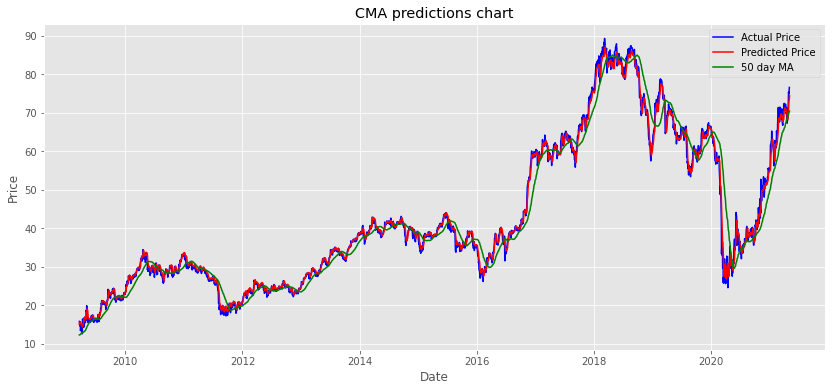

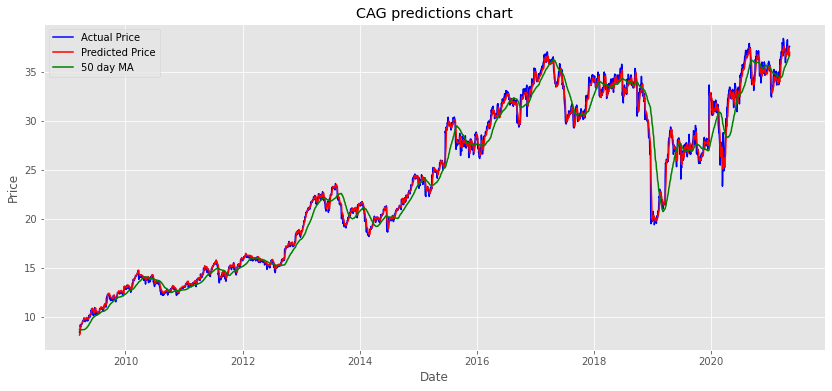

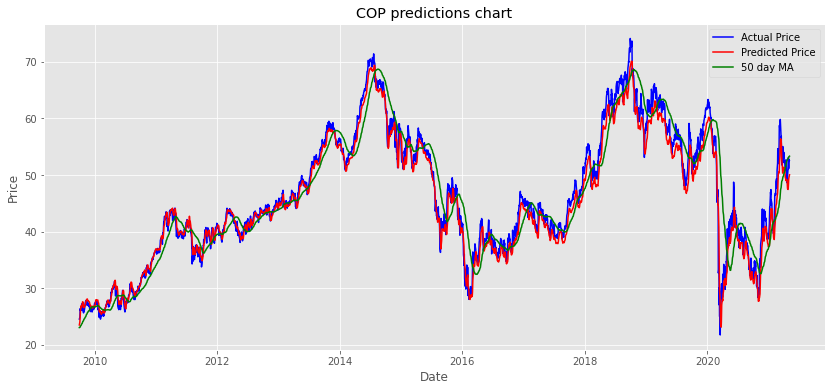

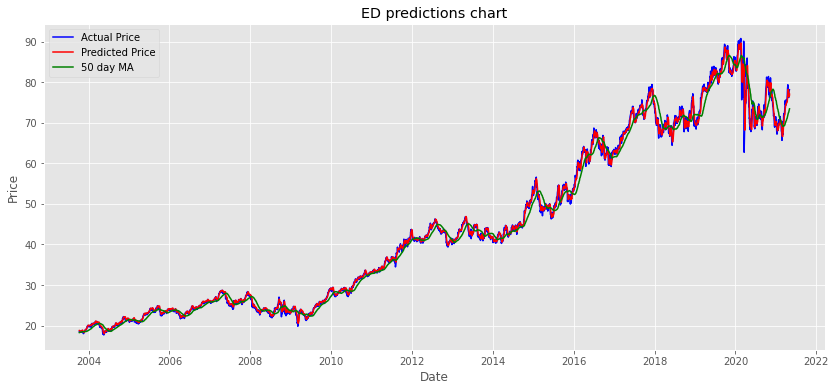

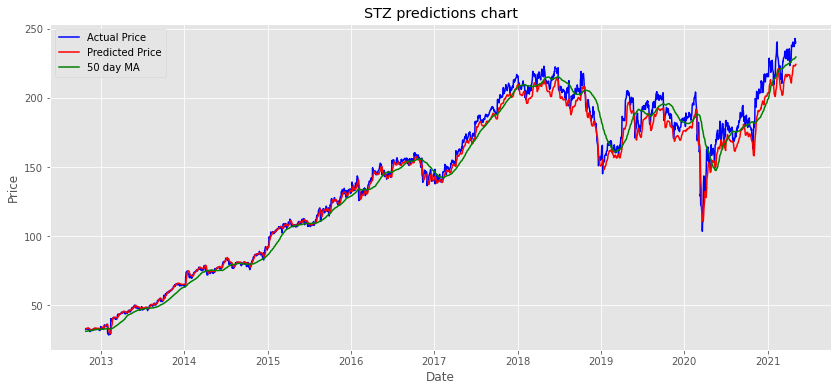

...

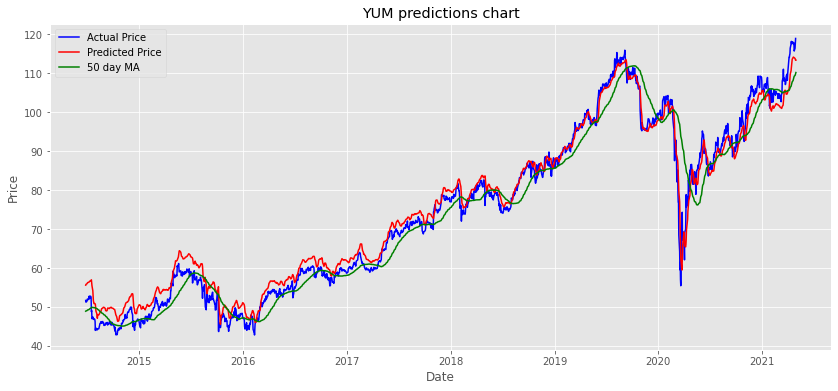

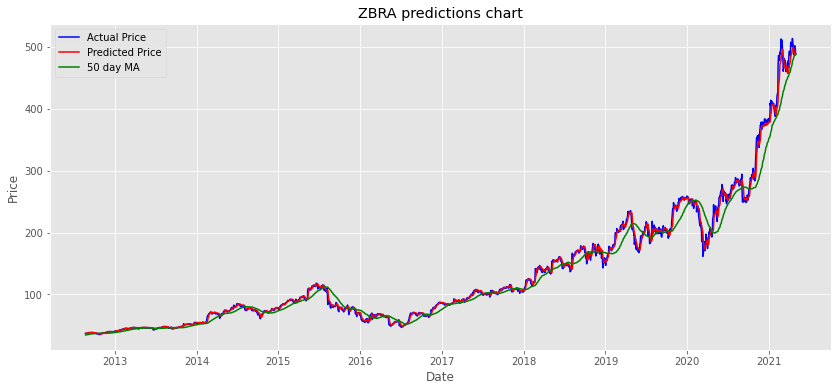

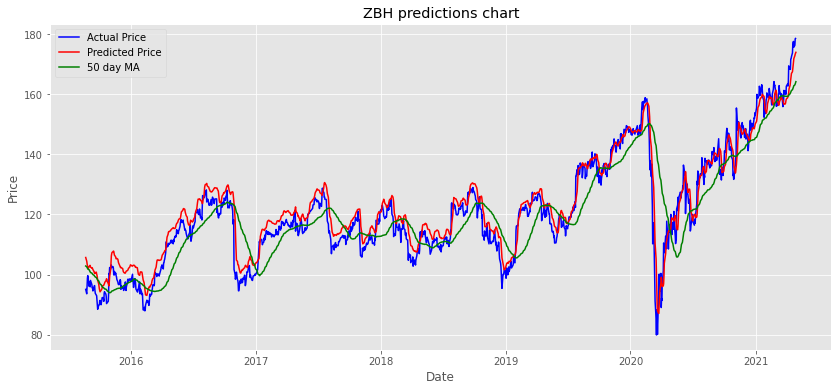

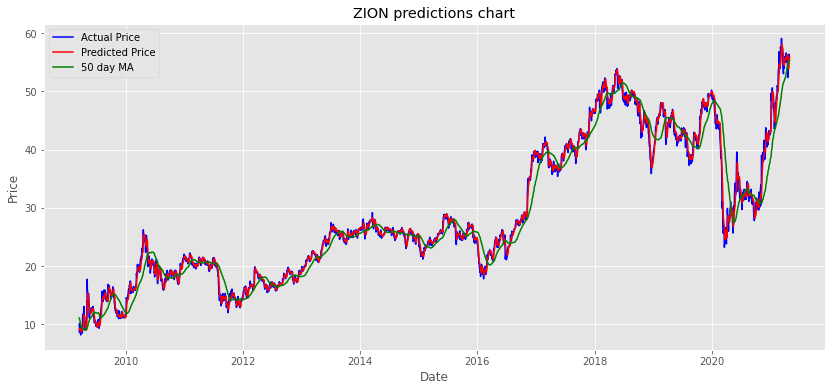

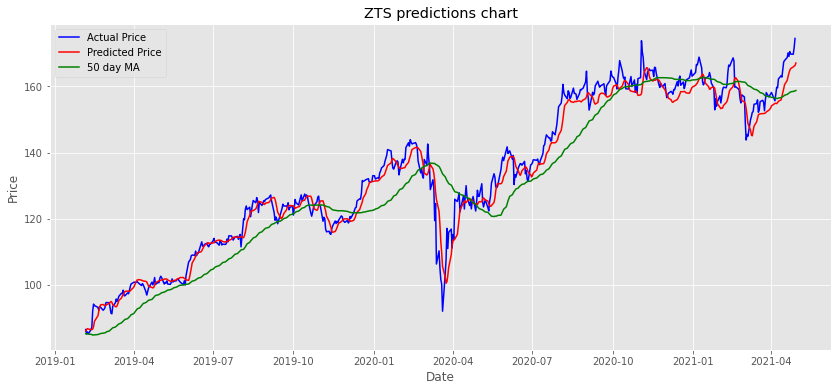

In [12]:
with concurrent.futures.ThreadPoolExecutor() as executor:
  train_model_master("sp500")